# Overview:

* AlexNet Training
* Saved models + saved tensors
* With tensor tools integration
* Streamlined workflow
* 3D neuron tensor
* 2D neuron tensor

References:

https://deeplearning.neuromatch.io/projects/Neuroscience/blurry_vision.html?highlight=alexnet

https://www.kaggle.com/asilvaigor/learning-alexnet

https://www.kaggle.com/drvaibhavkumar/alexnet-in-pytorch-cifar10-clas-83-test-accuracy

https://discuss.pytorch.org/t/how-to-extract-features-of-an-image-from-a-trained-model/119/3?u=klory

https://distill.pub/2017/feature-visualization/

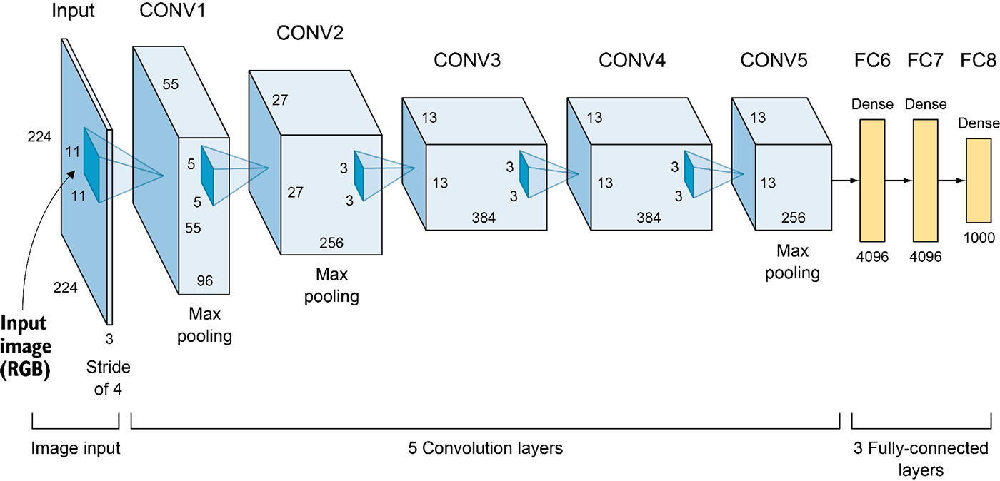

Note that in pytorch linear laryers are initialized in this way:

```
stdv = 1. / math.sqrt(self.weight.size(1))
self.weight.data.uniform_(-stdv, stdv)
if self.bias is not None:
    self.bias.data.uniform_(-stdv, stdv)
```



In [1]:
import tensorflow as tf
import numpy as np
import pathlib
import datetime
from scipy.io import savemat
from scipy.io import loadmat 
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import math
import time

In [2]:
from tensorflow.python.keras.layers import InputLayer, Input
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten
from tensorflow.python.keras import backend as K
# printout versions
print(f"Tensor Flow Version: {tf.__version__}")
print(f"numpy Version: {np.version.version}")

Tensor Flow Version: 2.8.0
numpy Version: 1.21.5


In [3]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
from torchvision.datasets import CIFAR10
from torch.utils.data import Subset
import torch.optim as optim

print(torch.__version__)
print(torchvision.__version__)

1.10.0+cu111
0.11.1+cu111


In [4]:
!pip install git+https://github.com/ahwillia/tensortools
import tensortools as tt
from scipy.ndimage import gaussian_filter

  Cloning https://github.com/ahwillia/tensortools to /tmp/pip-req-build-nl1x2_9v
  Running command git clone -q https://github.com/ahwillia/tensortools /tmp/pip-req-build-nl1x2_9v
  Created wheel for tensortools: filename=tensortools-0.3-py3-none-any.whl size=47993 sha256=e9518fd7e126e4ac57eba9942ba69c57e10e87975c79d34e633af67e335ac596
  Stored in directory: /tmp/pip-ephem-wheel-cache-vzs2xhm5/wheels/1c/a5/81/96b292bf9d9e3e00a29f59864a212f082de8221f254a82e159
Successfully built tensortools


# Set seed for reporducibility:

In [5]:
import numpy as np
import torch
import random 
import os

default_seed = 4142 
def seed_everything(seed = 1234):
  random.seed(seed)
  tseed = random.randint(1,1E6)
  tcseed = random.randint(1,1E6)
  npseed = random.randint(1,1E6)
  ospyseed = random.randint(1,1E6)
  torch.manual_seed(tseed)
  torch.cuda.manual_seed_all(tcseed)
  np.random.seed(npseed)
  os.environ['PYTHONHASHSEED'] = str(ospyseed)

seed_everything(default_seed)

# Load CIFAR-10 data:

In [6]:
transform = transforms.Compose([
    transforms.Resize(128),
    # transforms.Resize(256),
    # transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [7]:
train_data = CIFAR10(root='./data', train=True, download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(train_data, batch_size=4, shuffle=True, num_workers=2)

test_data = CIFAR10(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(test_data, batch_size=4, shuffle=False, num_workers=2)

classes = ('Airplane', 'Car', 'Bird', 'Cat', 'Deer', 'Dog', 'Frog', 'Horse', 'Ship', 'Truck')

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [8]:
train_data[1][0]

tensor([[[ 0.5193,  0.5193,  0.4679,  ..., -0.7479, -0.7650, -0.7650],
         [ 0.5193,  0.5193,  0.4679,  ..., -0.7479, -0.7650, -0.7650],
         [ 0.4851,  0.4851,  0.4508,  ..., -0.7650, -0.7822, -0.7822],
         ...,
         [ 0.6734,  0.6734,  0.6563,  ...,  0.2967,  0.3138,  0.3138],
         [ 0.6734,  0.6734,  0.6563,  ...,  0.3309,  0.3309,  0.3309],
         [ 0.6734,  0.6734,  0.6563,  ...,  0.3309,  0.3309,  0.3309]],

        [[ 1.0630,  1.0630,  0.9755,  ..., -0.6001, -0.6176, -0.6176],
         [ 1.0630,  1.0630,  0.9755,  ..., -0.6001, -0.6176, -0.6176],
         [ 1.0280,  1.0280,  0.9405,  ..., -0.6176, -0.6352, -0.6352],
         ...,
         [ 0.5728,  0.5728,  0.5728,  ...,  0.2577,  0.2752,  0.2752],
         [ 0.5553,  0.5553,  0.5553,  ...,  0.2927,  0.2927,  0.2927],
         [ 0.5553,  0.5553,  0.5553,  ...,  0.2927,  0.2927,  0.2927]],

        [[ 1.4548,  1.4548,  1.3502,  ..., -0.5844, -0.5844, -0.5844],
         [ 1.4548,  1.4548,  1.3502,  ..., -0

In [9]:
N_train = 50000
N_test = 10000
img_shape = (3, 32, 32) #use a tuple in the fomat: (n_channels, height, width)
n_classes = 10
print(N_train,N_test,img_shape,n_classes)

50000 10000 (3, 32, 32) 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


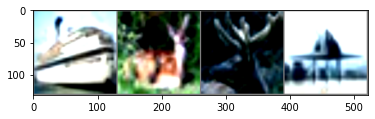

 Ship  Deer  Deer Airplane


In [10]:
def imshow(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# get some random training images
dataiter = iter(trainloader)
images, labels = dataiter.next()

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join('%5s' % classes[labels[j]] for j in range(4)))

# Define AlexNet Model:

In [11]:
# Define AlexNet with different modules representing different brain areas
class AlexNet(nn.Module):

  def __init__(self, num_classes=1000, downscale=1):
    """
    Args:
      num_classes: int
      downscale: int
    """
    super(AlexNet, self).__init__()

    ##torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None
    self.conv_layer1 = nn.Sequential(
        nn.Conv2d(3, 64//downscale, kernel_size=11, stride=4, padding=2),
        nn.ReLU(inplace=True),
        nn.BatchNorm2d(64//downscale),
        nn.MaxPool2d(kernel_size=3, stride=2),
    )
    self.conv_layer2 = nn.Sequential(
        nn.Conv2d(64//downscale, 192//downscale, kernel_size=5, padding=2),
        nn.ReLU(inplace=True),
        nn.BatchNorm2d(192//downscale),
        nn.MaxPool2d(kernel_size=3, stride=2),
    )
    self.conv_layer3 = nn.Sequential(
        nn.Conv2d(192//downscale, 384//downscale, kernel_size=3, padding=1),
        nn.ReLU(inplace=True),
        nn.BatchNorm2d(384//downscale),
    )
    self.conv_layer4 = nn.Sequential(
        nn.Conv2d(384//downscale, 256//downscale, kernel_size=3, padding=1),
        nn.ReLU(inplace=True),
        nn.BatchNorm2d(256//downscale),
    )
    self.conv_layer5 = nn.Sequential(
        nn.Conv2d(256//downscale, 256//downscale, kernel_size=3, padding=1),
        nn.ReLU(inplace=True),
        nn.BatchNorm2d(256//downscale),
        nn.MaxPool2d(kernel_size=3, stride=2),
    )
    self.avgpool = nn.AdaptiveAvgPool2d((6, 6))
    self.it = nn.Sequential(
        nn.Dropout(),
        nn.Linear(256//downscale * 6 * 6, 4096//downscale),
        nn.ReLU(inplace=True),
        nn.Dropout(),
        nn.Linear(4096//downscale, 4096//downscale),
        nn.ReLU(inplace=True)
    )
    self.classifier = nn.Linear(4096//downscale, num_classes)

  def forward(self, x):
    """
    Args:
      x: torch.Tensor
    Returns:
      x: torch.Tensor
    """
    x = self.conv_layer1(x)
    x = self.conv_layer2(x)
    x = self.conv_layer3(x)
    x = self.conv_layer4(x)
    x = self.conv_layer5(x)
    x = self.avgpool(x)
    x = torch.flatten(x, 1)
    x = self.it(x)
    x = self.classifier(x)
    return x

In [12]:
AlexNet_Model = AlexNet(num_classes=10, downscale=2)
AlexNet_Model.eval()

AlexNet(
  (conv_layer1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer2): Sequential(
    (0): Conv2d(32, 96, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer3): Sequential(
    (0): Conv2d(96, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer4): Sequential(
    (0): Conv2d(192, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Ba

In [144]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(AlexNet_Model.parameters(), lr=0.001, momentum=0.9)

In [14]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [15]:

print(device)

cuda:0


# Train and save model:

In [16]:
from google.colab import drive 
drive.mount('/content/drive/')
%cd '/content/drive/My Drive/Embeddings/code'

Mounted at /content/drive/
/content/drive/My Drive/Embeddings/code


In [148]:
AlexNet_Model_epoch10 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch10.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch10.pt')['state_dict'])
optimizer.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch10.pt')['optimizer'])
AlexNet_Model_epoch10.to(device)
AlexNet_Model = AlexNet_Model_epoch10
AlexNet_Model_epoch7 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch7.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch7.pt')['state_dict'])
AlexNet_Model_epoch7.to(device)
AlexNet_Model_epoch5 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch5.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch5.pt')['state_dict'])
AlexNet_Model_epoch5.to(device)
AlexNet_Model_epoch0 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch0.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch0.pt')['state_dict'])
AlexNet_Model_epoch0.to(device)
AlexNet_Model_epoch3 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch3.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch3.pt')['state_dict'])
AlexNet_Model_epoch3.to(device)
AlexNet_Model_epoch1 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch1.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch1.pt')['state_dict'])
AlexNet_Model_epoch1.to(device)
AlexNet_Model_epoch2 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch2.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch2.pt')['state_dict'])
AlexNet_Model_epoch2.to(device)
AlexNet_Model_epoch4 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch4.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch4.pt')['state_dict'])
AlexNet_Model_epoch4.to(device)
AlexNet_Model_epoch8 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch8.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch8.pt')['state_dict'])
AlexNet_Model_epoch8.to(device)
AlexNet_Model_epoch15 = AlexNet(num_classes=10, downscale=2)
AlexNet_Model_epoch15.load_state_dict(torch.load('/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch15.pt')['state_dict'])
AlexNet_Model_epoch15.to(device)

AlexNet(
  (conv_layer1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer2): Sequential(
    (0): Conv2d(32, 96, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer3): Sequential(
    (0): Conv2d(96, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer4): Sequential(
    (0): Conv2d(192, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Ba

In [ ]:
# torch.save({
#             'epoch': 0,
#             'state_dict': AlexNet_Model.state_dict(),
#             'optimizer' : optimizer.state_dict(),
#             }, '/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch0.pt')

In [146]:
for epoch in range(5):  # loop over the dataset multiple times

    running_loss = 0.0
    start_time = time.time()
    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data[0].to(device), data[1].to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        output = AlexNet_Model(inputs)
        loss = criterion(output, labels)
        loss.backward()
        optimizer.step()

        #Time
        end_time = time.time()
        time_taken = end_time - start_time

        # print statistics
        running_loss += loss.item()
        if i % 2000 == 1999:    # print every 2000 mini-batches
            print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss / 2000))
            print('Time:',time_taken)
            running_loss = 0.0

print('Finished Training of AlexNet: Epoch 10')

[1,  2000] loss: 2.241
Time: 28.6570942401886
[1,  4000] loss: 2.194
Time: 57.46821355819702
[1,  6000] loss: 2.193
Time: 86.00276231765747
[1,  8000] loss: 2.211
Time: 114.60443830490112
[1, 10000] loss: 2.195
Time: 143.76810550689697
[1, 12000] loss: 2.186
Time: 172.1193265914917
[2,  2000] loss: 2.209
Time: 28.85939598083496
[2,  4000] loss: 2.196
Time: 57.563191175460815
[2,  6000] loss: 2.199
Time: 86.21423077583313
[2,  8000] loss: 2.185
Time: 114.88108491897583
[2, 10000] loss: 2.175
Time: 143.48779916763306
[2, 12000] loss: 2.206
Time: 172.12266945838928
[3,  2000] loss: 2.199
Time: 28.698755979537964
[3,  4000] loss: 2.208
Time: 57.26159334182739
[3,  6000] loss: 2.221
Time: 86.74417424201965
[3,  8000] loss: 2.227
Time: 115.65007781982422
[3, 10000] loss: 2.190
Time: 144.5111494064331
[3, 12000] loss: 2.221
Time: 173.31385588645935
[4,  2000] loss: 2.168
Time: 28.800808668136597
[4,  4000] loss: 2.166
Time: 57.46362495422363
[4,  6000] loss: 2.221
Time: 86.25448608398438
[4, 

In [147]:
torch.save({
            'epoch': 15,
            'state_dict': AlexNet_Model.state_dict(),
            'optimizer' : optimizer.state_dict(),
            }, '/content/drive/My Drive/Embeddings/code/AlexNet_Model_epoch15.pt')

# Load saved tensors:

In [157]:
# N_epoch0_fix = loadmat("neuron_output_3D_epoch0.mat")['neuron_output_3D']
# N_epoch3_fix = loadmat("neuron_output_3D_epoch3.mat")['neuron_output_3D']
# N_epoch5_fix = loadmat("neuron_output_3D_epoch5.mat")['neuron_output_3D']
# N_epoch7_fix = loadmat("neuron_output_3D_epoch7.mat")['neuron_output_3D']
# N_epoch10_max = loadmat("neuron_output_3D_epoch10.mat")['neuron_output_3D']
# N_epoch10_conv4 = loadmat("neuron_output_3D_epoch10_conv4.mat")['neuron_output_3D']
# # N_epoch0_fix = loadmat("neuron_output_3D_epoch0.mat")['neuron_output_3D']
# N_epoch1_max = loadmat("neuron_output_3D_epoch1_max.mat")['neuron_output_3D']
# N_epoch5_max = loadmat("neuron_output_3D_epoch5_max.mat")['neuron_output_3D']
# N_epoch7_max = loadmat("neuron_output_3D_epoch7_max.mat")['neuron_output_3D']

N_epoch0_2D_max = loadmat("neuron_output_2D_epoch0_conv1_max.mat")['neuron_output_2D']
N_epoch1_2D_max = loadmat("neuron_output_2D_epoch1_conv1_max.mat")['neuron_output_2D']


N_epoch0_2D = loadmat("neuron_output_2D_epoch0_conv1.mat")['neuron_output_2D']
N_epoch1_2D = loadmat("neuron_output_2D_epoch1_conv1.mat")['neuron_output_2D']
N_epoch2_2D = loadmat("neuron_output_2D_epoch2_conv1.mat")['neuron_output_2D']
N_epoch3_2D = loadmat("neuron_output_2D_epoch3_conv1.mat")['neuron_output_2D']
N_epoch4_2D = loadmat("neuron_output_2D_epoch4_conv1.mat")['neuron_output_2D']
N_epoch5_2D = loadmat("neuron_output_2D_epoch5_conv1.mat")['neuron_output_2D']
N_epoch7_2D = loadmat("neuron_output_2D_epoch7_conv1.mat")['neuron_output_2D']
N_epoch8_2D = loadmat("neuron_output_2D_epoch8_conv1.mat")['neuron_output_2D']
N_epoch5_2D_max = loadmat("neuron_output_2D_epoch5_conv1_max.mat")['neuron_output_2D']
N_epoch10_2D = loadmat("neuron_output_2D_epoch10_conv1.mat")['neuron_output_2D']
N_epoch15_2D_max = loadmat("neuron_output_2D_epoch15_conv1_max.mat")['neuron_output_2D'] 
N_epoch15_2D = loadmat("neuron_output_2D_epoch15_conv1.mat")['neuron_output_2D'] 

# Streamline:

In [38]:
def get_tensor_factors(N, dim = 3, n_vertical_shifts = 22, ranks = [10, 20, 30], reps = 1):
## note that for 2D tensor (ie a matrix), rank + nullity = num_columns => rank <= num_columns
  if dim == 3:
    N_filtered = N 
    # N_filtered = np.empty(N.shape)
    # for i in range(N.shape[0]):
    #   for j in range(N.shape[1]):
    #     filtered = gaussian_filter(N[i,j,:].reshape((n_vertical_shifts, n_vertical_shifts)), sigma=1).reshape((n_vertical_shifts * n_vertical_shifts,))
    #     N_filtered[i,j,:] = filtered[:]
  else:
    N_filtered = N.reshape((N.shape[0], N.shape[1],1))

  # Fit ensembles of tensor decompositions:
  methods = (
    'ncp_hals',  # fits nonnegative tensor decomposition.
  )

  ensembles = {}
  for m in methods:
      ensembles[m] = tt.Ensemble(fit_method=m,  fit_options=dict(tol=1e-5))
      ensembles[m].fit(N_filtered, ranks=ranks, replicates=reps)
      ## replicates: int, number of models to fit at each rank

  ## plot objective, similarity, factors:
  """
  Customized plotting routines for CP decompositions
  """

  # Plotting options for the unconstrained and nonnegative models.
  plot_options = {
    'ncp_hals': {
      'line_kw': {
        'color': 'blue',
        'alpha': 1,
        'label': 'ncp_hals',
      },
      'scatter_kw': {
        'color': 'blue',
        'alpha': 1,
        's': 1,
      },
    },
  }

  def plot_objective(ensemble, partition='train', ax=None, jitter=0.1,
                    scatter_kw=dict(), line_kw=dict()):
      """Plots objective function as a function of model rank.
      Parameters
      ----------
      ensemble : Ensemble object
          holds optimization results across a range of model ranks
      partition : string, one of: {'train', 'test'}
          specifies whether to plot the objective function on the training
          data or the held-out test set.
      ax : matplotlib axis (optional)
          axis to plot on (defaults to current axis object)
      jitter : float (optional)
          amount of horizontal jitter added to scatterpoints (default=0.1)
      scatter_kw : dict (optional)
          keyword arguments for styling the scatterpoints
      line_kw : dict (optional)
          keyword arguments for styling the line
      """

      if ax is None:
          ax = plt.gca()

      if partition == 'train':
          pass
      elif partition == 'test':
          raise NotImplementedError('Cross-validation is on the TODO list.')
      else:
          raise ValueError("partition must be 'train' or 'test'.")

      # compile statistics for plotting
      x, obj, min_obj = [], [], []
      for rank in sorted(ensemble.results):
          # reconstruction errors for rank-r models
          o = ensemble.objectives(rank)
          obj.extend(o)
          x.extend(np.full(len(o), rank))
          min_obj.append(min(o))

      print(o)
      print(obj)
      print(x)
      # add horizontal jitter
      ux = np.unique(x)
      x = np.array(x) + (np.random.rand(len(x))-0.5)*jitter

      # make plot
      # customized: plot objectives for all iterations
      ax.scatter(x, obj, **scatter_kw)
      ax.plot(ux, min_obj, **line_kw)
      ax.set_xlabel('model rank')
      ax.set_ylabel('objective')

      return ax


  def plot_similarity(ensemble, ax=None, jitter=0.1,
                      scatter_kw=dict(), line_kw=dict()):
      """Plots similarity across optimization runs as a function of model rank.
      Parameters
      ----------
      ensemble : Ensemble object
          holds optimization results across a range of model ranks
      ax : matplotlib axis (optional)
          axis to plot on (defaults to current axis object)
      jitter : float (optional)
          amount of horizontal jitter added to scatterpoints (default=0.1)
      scatter_kw : dict (optional)
          keyword arguments for styling the scatterpoints
      line_kw : dict (optional)
          keyword arguments for styling the line
      References
      ----------
      Ulrike von Luxburg (2010). Clustering Stability: An Overview.
      Foundations and Trends in Machine Learning.
      https://arxiv.org/abs/1007.1075
      """

      if ax is None:
          ax = plt.gca()

      # compile statistics for plotting
      x, sim, mean_sim = [], [], []
      for rank in sorted(ensemble.results):
          # reconstruction errors for rank-r models
          s = ensemble.similarities(rank)[1:]
          sim.extend(s)
          x.extend(np.full(len(s), rank))
          mean_sim.append(np.mean(s))

      # add horizontal jitter
      ux = np.unique(x)
      x = np.array(x) + (np.random.rand(len(x))-0.5)*jitter

      # make plot
      # customized: plot similarities for all iterations
      ax.scatter(x, sim, **scatter_kw)
      ax.plot(ux, mean_sim, **line_kw)

      ax.set_xlabel('model rank')
      ax.set_ylabel('model similarity')
      ax.set_ylim([0, 1.1])

      return ax

  # Plot similarity and error plots.
  plt.figure()
  for m in methods:
      plot_objective(ensembles[m], **plot_options[m])
  plt.legend()

  # plt.figure()
  # for m in methods:
  #     plot_similarity(ensembles[m], **plot_options[m])
  # plt.legend()

  plt.show()

  return ensembles ## A LIST!

In [82]:
def get_embeddings_2D(tensor_factors_best_rank,neuron_labels,n_dim_PCA = 10): 
  neuron_factor = tensor_factors_best_rank[0]
  # PCA on tensor factors 
  pca = PCA(n_dim_PCA)
  neuron_output_highest_with_shifts_PCA = pca.fit_transform(neuron_factor)
  neuron_output_highest_with_shifts_PCA.shape
  vectors, lambdas = pca.components_, pca.explained_variance_
  plt.plot(pca.explained_variance_ratio_)
  plt.show()

  # plot embeddings:

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_output_highest_with_shifts_PCA
  print(data.shape)
  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels == label)
      print(mask.shape)
      print(label, sum(mask))
      traces.append(go.Scatter(
          x=data[mask,0],
          y=data[mask,1],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))

  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(
    
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))

  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,
                    # scene = dict(xaxis = dict(range=[-1.5,2.5],),
                    #              yaxis = dict(range=[-1.5,1.5],),
                    #              zaxis = dict(range=[-1.5,1.5],),),
                    )
  fig.show()
  return neuron_output_highest_with_shifts_PCA

In [40]:
def get_embeddings(tensor_factors_best_rank,neuron_labels,n_dim_PCA = 10): 
  neuron_factor = tensor_factors_best_rank[0]
  # PCA on tensor factors 
  pca = PCA(n_dim_PCA)
  neuron_output_highest_with_shifts_PCA = pca.fit_transform(neuron_factor)
  neuron_output_highest_with_shifts_PCA.shape
  vectors, lambdas = pca.components_, pca.explained_variance_
  plt.plot(pca.explained_variance_ratio_)
  plt.show()

  # plot embeddings:

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_output_highest_with_shifts_PCA
  print(data.shape)
  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels == label)
      print(mask.shape)
      print(label, sum(mask))
      traces.append(go.Scatter3d(
          x=data[mask,0],
          y=data[mask,1],
          z=data[mask,2],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))

  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(
    
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))

  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,
                    # scene = dict(xaxis = dict(range=[-1.5,2.5],),
                    #              yaxis = dict(range=[-1.5,1.5],),
                    #              zaxis = dict(range=[-1.5,1.5],),),
                    )
  fig.show()
  return neuron_output_highest_with_shifts_PCA

In [85]:
def colorFromUnivariateData(Z1, cmap1 = plt.cm.Reds):
    # Rescale values to fit into colormap range (0->255)
    Z1_plot = np.array(255*(Z1-Z1.min())/(Z1.max()-Z1.min()), dtype=np.int)

    Z1_color = cmap1(Z1_plot)

    # Color for each point
    Z_color = np.array(Z1_color[:,0:3])
    return Z_color

## ## https://stackoverflow.com/questions/49871436/scatterplot-with-continuous-bivariate-color-palette-in-python

def colorFromBivariateData(Z1,Z2,cmap1 = plt.cm.Blues, cmap2 = plt.cm.Reds):
    # Rescale values to fit into colormap range (0->255)
    Z1_plot = np.array(255*(Z1-Z1.min())/(Z1.max()-Z1.min()), dtype=np.int)
    Z2_plot = np.array(255*(Z2-Z2.min())/(Z2.max()-Z2.min()), dtype=np.int)

    Z1_color = cmap1(Z1_plot)
    Z2_color = cmap2(Z2_plot)

    # Color for each point
    Z_color = np.sum([Z1_color , Z2_color ], axis=0)/2.0
    Z_color = np.array(Z_color[:,0:3])
    return Z_color

def get_spatial_order_plot(cluster_index, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10):
  n_neurons = int(neuron_labels.shape[0]/n_max_feature_maps)
  neuron_cluster = neuron_output_highest_with_shifts_PCA[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  neuron_labels_cluster = neuron_labels[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  feature_map_side = int(np.sqrt(n_neurons))
  xs, ys = np.mgrid[0:feature_map_side,0:feature_map_side]
  xs = xs.reshape((n_neurons,))
  ys = ys.reshape((n_neurons,))

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_cluster

  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels_cluster == label)
      print(label, sum(mask))
      traces.append(go.Scatter3d(
          x=data[mask,0],
          y=data[mask,1],
          z=data[mask,2],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))
  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,)
  fig.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          data[:,2],
          c = colorFromUnivariateData(xs, cmap1 = plt.cm.Blues),
          s = 100,
          alpha= 1
          ) 
  plt.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          data[:,2],
          c = colorFromUnivariateData(ys, cmap1 = plt.cm.Reds),
          s = 100,
          alpha= 1
          ) 
  plt.show()

def get_spatial_order_plot_2D(cluster_index, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10):
  n_neurons = int(neuron_labels.shape[0]/n_max_feature_maps)
  neuron_cluster = neuron_output_highest_with_shifts_PCA[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  neuron_labels_cluster = neuron_labels[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  feature_map_side = int(np.sqrt(n_neurons))
  xs, ys = np.mgrid[0:feature_map_side,0:feature_map_side]
  xs = xs.reshape((n_neurons,))
  ys = ys.reshape((n_neurons,))

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_cluster

  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels_cluster == label)
      print(label, sum(mask))
      traces.append(go.Scatter(
          x=data[mask,0],
          y=data[mask,1],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))
  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,)
  fig.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          c = colorFromUnivariateData(xs, cmap1 = plt.cm.Blues),
          s = 100,
          alpha= 1
          ) 
  plt.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          c = colorFromUnivariateData(ys, cmap1 = plt.cm.Reds),
          s = 100,
          alpha= 1
          ) 
  plt.show()

In [42]:
def get_tensor_factors_plot(tensor_factors_best_rank, best_rank, n_max_feature_maps):
  ## neuron_factor shape: (#neuron, #factors=best_rank)
  neuron_factor = tensor_factors_best_rank[0]
  ## neuron_factor shape: (#shifts, #factors=best_rank)
  time_factor = tensor_factors_best_rank[2]
  
  # neuron_factor_first = neuron_factor[:,0]
  plt.plot(neuron_factor)
  plt.show()
  
  # time_factor_first = time_factor[:,0]
  plt.plot(time_factor)
  plt.show()

  n_neurons = neuron_factor.shape[0]
  feature_map_side = int(np.sqrt(n_neurons/n_max_feature_maps))
  for i in range(best_rank):
    neuron_factor_i_th = neuron_factor[:,i]
    vmin = neuron_factor_i_th.min()
    vmax = neuron_factor_i_th.max()
    print(neuron_factor.shape)
    f_i, axes = plt.subplots(1,n_max_feature_maps,figsize=(10,1))
    for f_i, ax in enumerate(axes):
      feature_map_matrix = neuron_factor_i_th[(f_i * feature_map_side ** 2): ((f_i+1) * feature_map_side ** 2)].reshape((feature_map_side, feature_map_side))
      ax.imshow(feature_map_matrix, vmin = vmin, vmax = vmax)
      ax.set(xticks = [], yticks = [])
    plt.show()

## For 3D epoch 0 fix:

Fitting rank-50 models:   0%|          | 0/1 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/tensortools/optimize/ncp_hals.py:185: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  Cp = factors[:, idx] @ grams[idx][:, p]
/usr/local/lib/python3.7/dist-packages/numba/core/typing/npydecl.py:930: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  warnings.warn(NumbaPerformanceWarning(msg))
                                                                     

Rank-50 models:  min obj, 0.41;  max obj, 0.41;  time to fit, 28.4s


Rank-75 models:  min obj, 0.39;  max obj, 0.39;  time to fit, 42.8s


Rank-100 models:  min obj, 0.39;  max obj, 0.39;  time to fit, 76.5s


Rank-125 models:  min obj, 0.38;  max obj, 0.38;  time to fit, 88.8s


[0.3783703128441253]
[0.40664145568687865, 0.3949949115761069, 0.3861721622913191, 0.3783703128441253]
[50, 75, 100, 125]


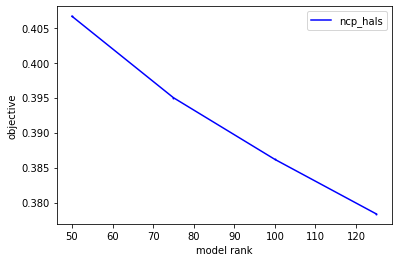

In [ ]:
ensembles_0 = get_tensor_factors(N_epoch0_fix, ranks = [100,150,200])

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_0}
mdic
savemat("ensembles_0.mat", mdic)

In [ ]:
rep = 0
ranks = [125]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_0['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

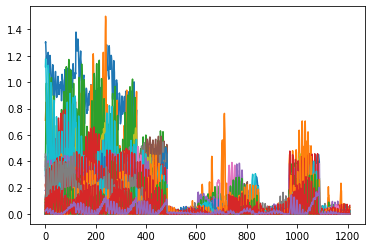

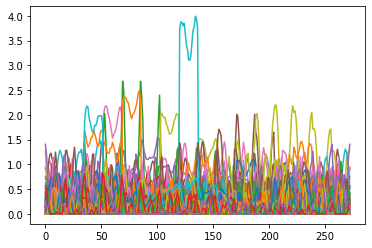

(1210, 125)


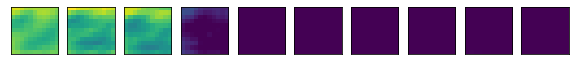

(1210, 125)


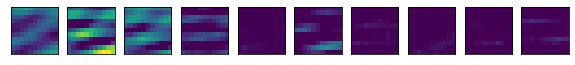

(1210, 125)


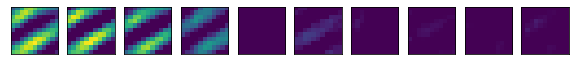

(1210, 125)


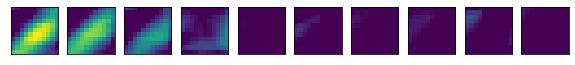

(1210, 125)


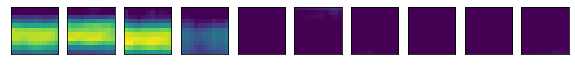

(1210, 125)


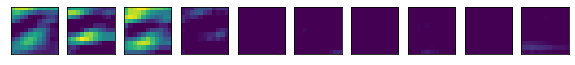

(1210, 125)


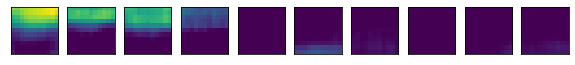

(1210, 125)


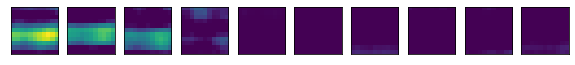

(1210, 125)


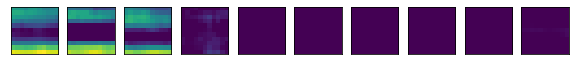

(1210, 125)


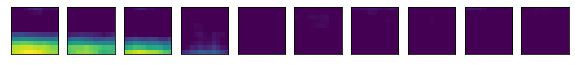

(1210, 125)


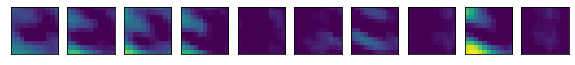

(1210, 125)


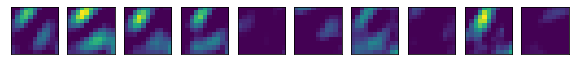

(1210, 125)


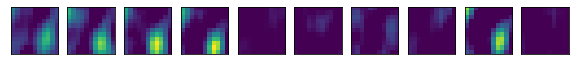

(1210, 125)


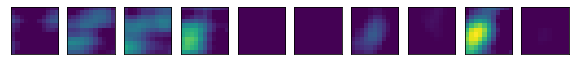

(1210, 125)


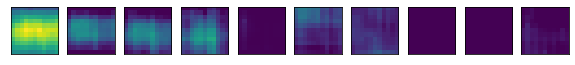

(1210, 125)


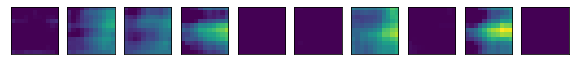

(1210, 125)


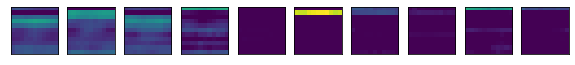

(1210, 125)


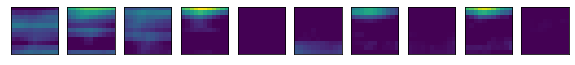

(1210, 125)


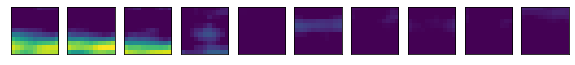

(1210, 125)


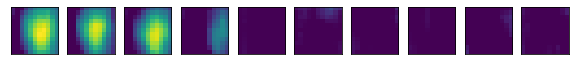

(1210, 125)


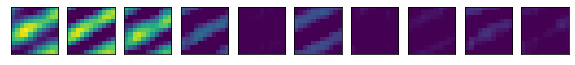

(1210, 125)


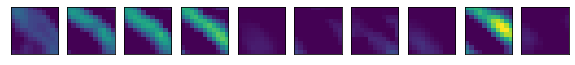

(1210, 125)


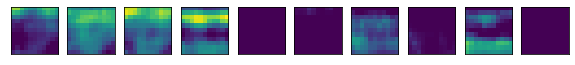

(1210, 125)


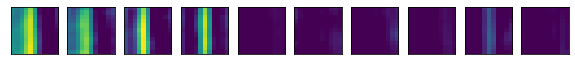

(1210, 125)


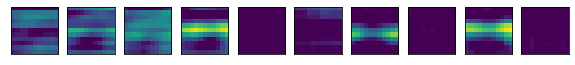

(1210, 125)


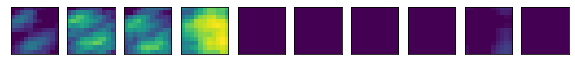

(1210, 125)


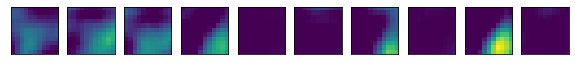

(1210, 125)


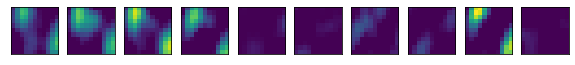

(1210, 125)


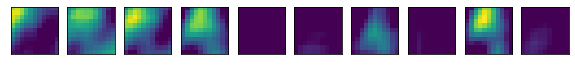

(1210, 125)


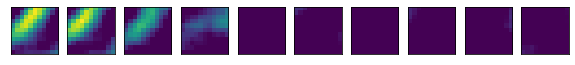

(1210, 125)


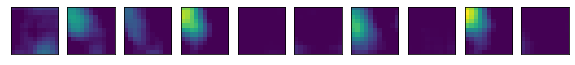

(1210, 125)


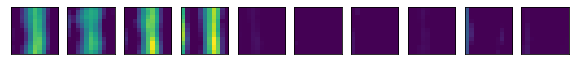

(1210, 125)


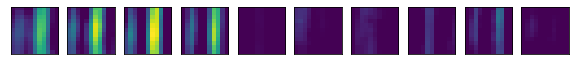

(1210, 125)


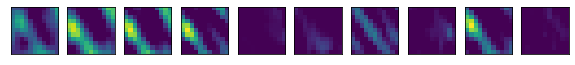

(1210, 125)


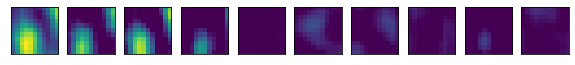

(1210, 125)


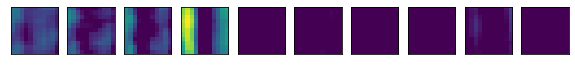

(1210, 125)


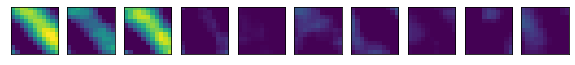

(1210, 125)


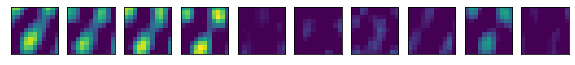

(1210, 125)


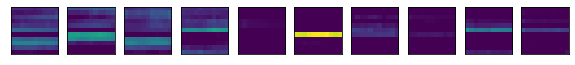

(1210, 125)


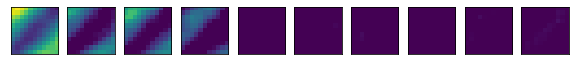

(1210, 125)


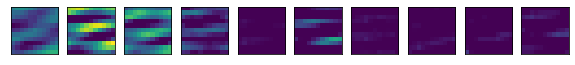

(1210, 125)


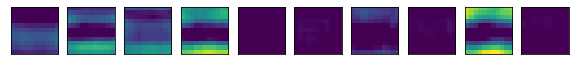

(1210, 125)


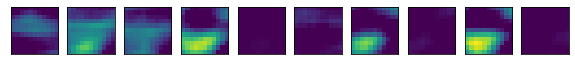

(1210, 125)


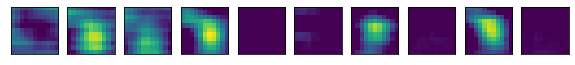

(1210, 125)


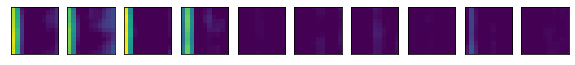

(1210, 125)


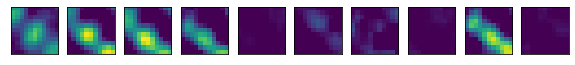

(1210, 125)


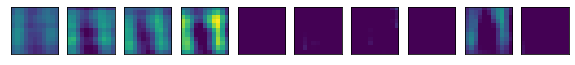

(1210, 125)


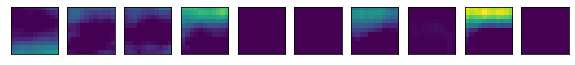

(1210, 125)


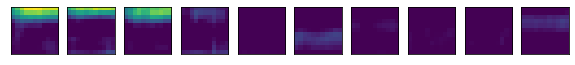

(1210, 125)


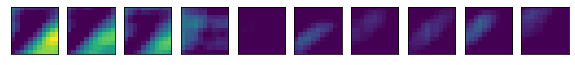

(1210, 125)


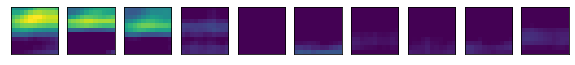

(1210, 125)


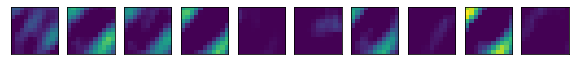

(1210, 125)


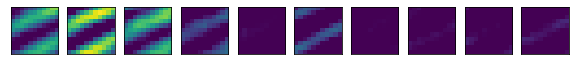

(1210, 125)


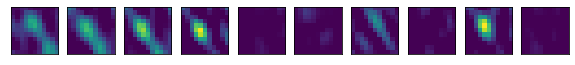

(1210, 125)


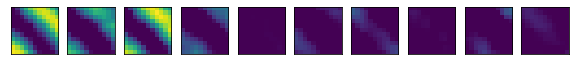

(1210, 125)


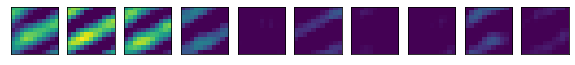

(1210, 125)


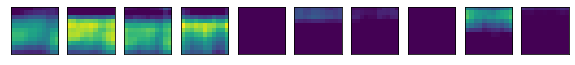

(1210, 125)


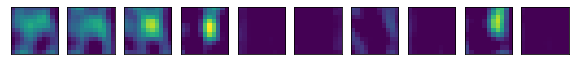

(1210, 125)


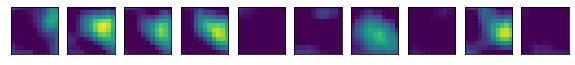

(1210, 125)


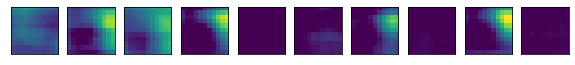

(1210, 125)


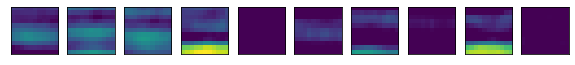

(1210, 125)


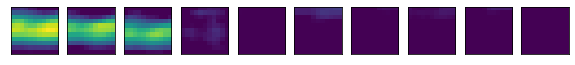

(1210, 125)


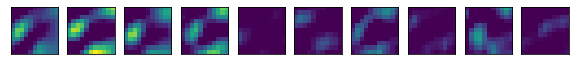

(1210, 125)


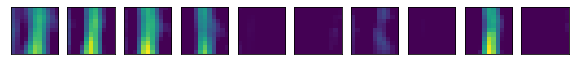

(1210, 125)


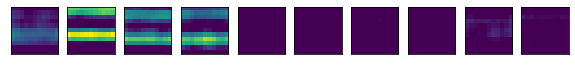

(1210, 125)


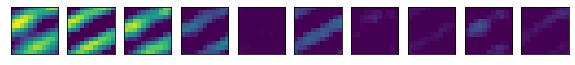

(1210, 125)


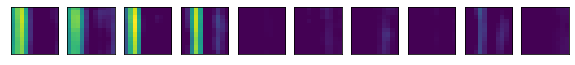

(1210, 125)


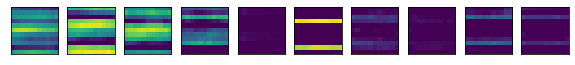

(1210, 125)


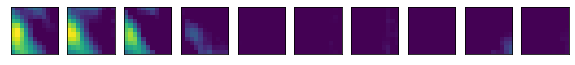

(1210, 125)


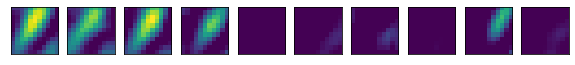

(1210, 125)


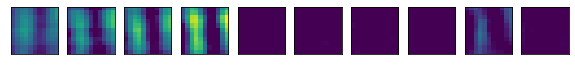

(1210, 125)


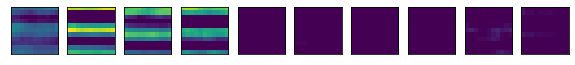

(1210, 125)


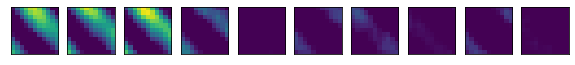

(1210, 125)


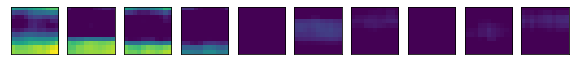

(1210, 125)


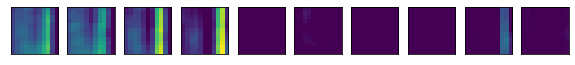

(1210, 125)


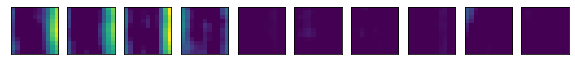

(1210, 125)


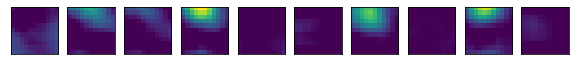

(1210, 125)


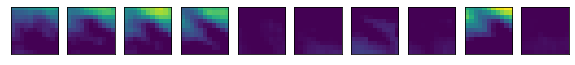

(1210, 125)


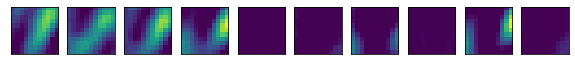

(1210, 125)


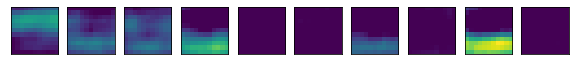

(1210, 125)


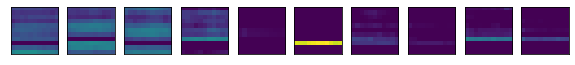

(1210, 125)


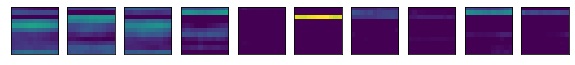

(1210, 125)


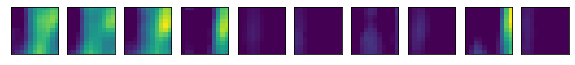

(1210, 125)


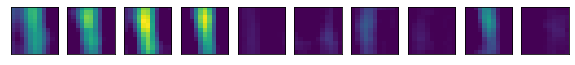

(1210, 125)


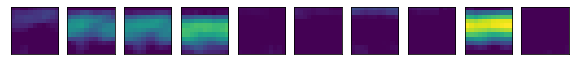

(1210, 125)


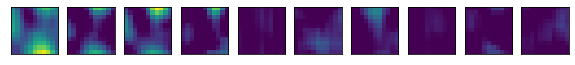

(1210, 125)


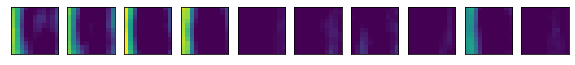

(1210, 125)


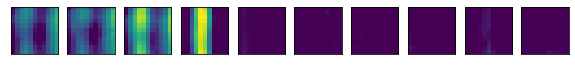

(1210, 125)


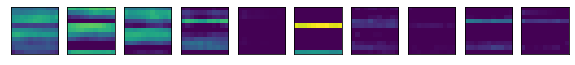

(1210, 125)


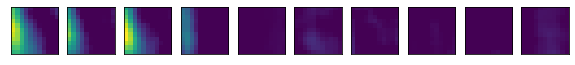

(1210, 125)


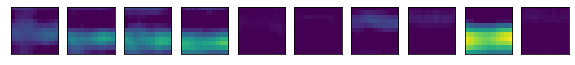

(1210, 125)


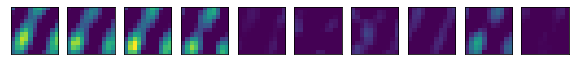

(1210, 125)


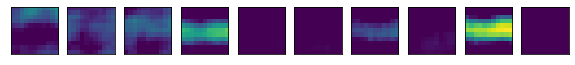

(1210, 125)


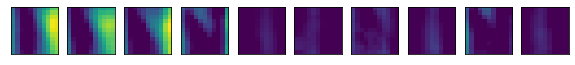

(1210, 125)


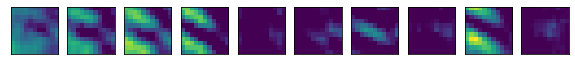

(1210, 125)


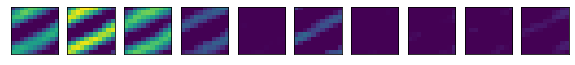

(1210, 125)


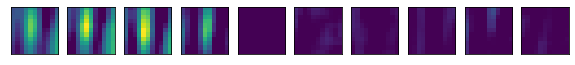

(1210, 125)


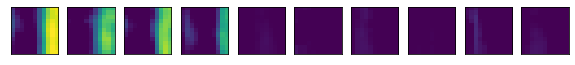

(1210, 125)


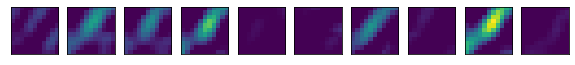

(1210, 125)


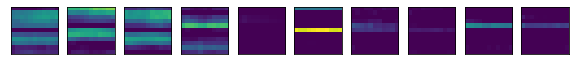

(1210, 125)


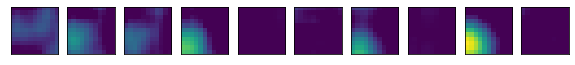

(1210, 125)


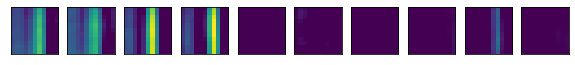

(1210, 125)


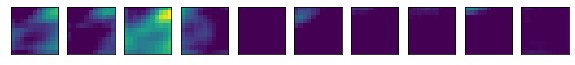

(1210, 125)


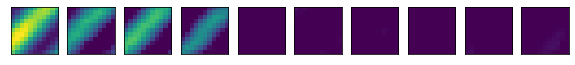

(1210, 125)


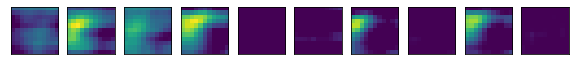

(1210, 125)


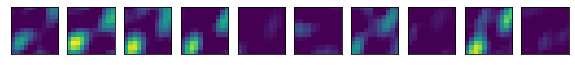

(1210, 125)


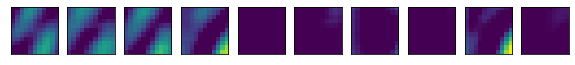

(1210, 125)


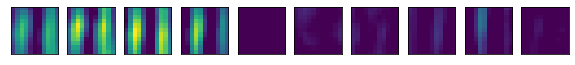

(1210, 125)


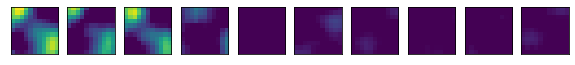

(1210, 125)


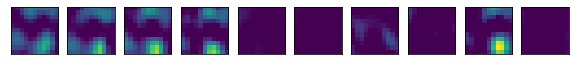

(1210, 125)


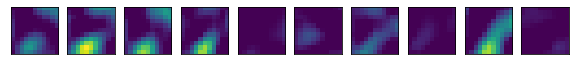

(1210, 125)


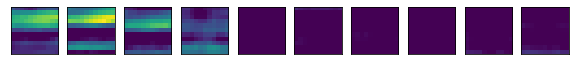

(1210, 125)


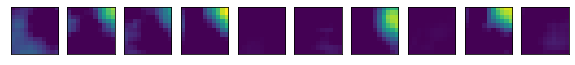

(1210, 125)


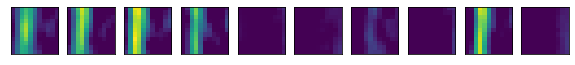

(1210, 125)


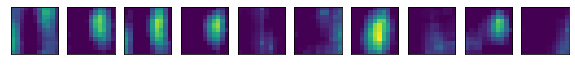

(1210, 125)


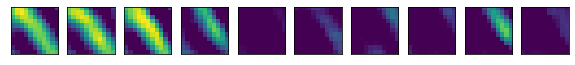

(1210, 125)


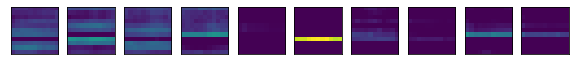

(1210, 125)


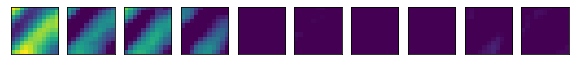

(1210, 125)


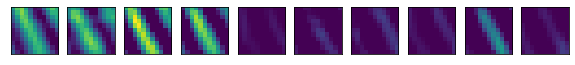

(1210, 125)


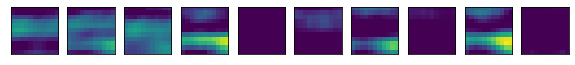

(1210, 125)


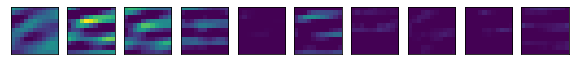

(1210, 125)


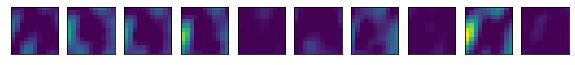

(1210, 125)


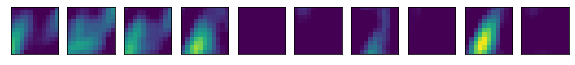

(1210, 125)


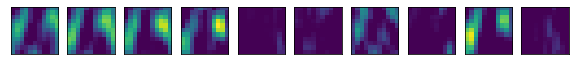

(1210, 125)


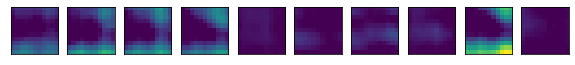

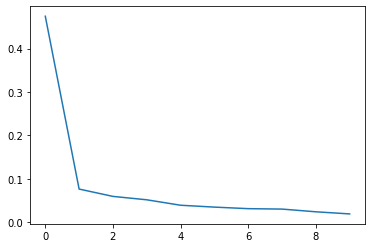

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



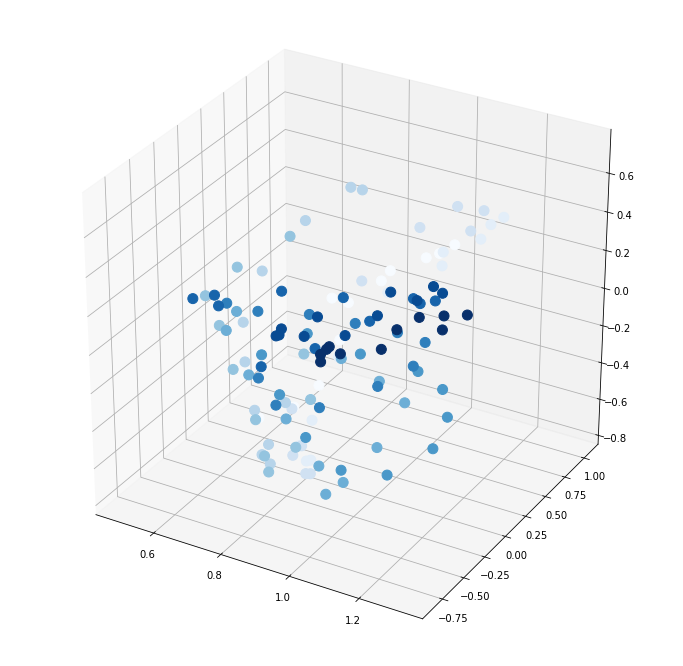

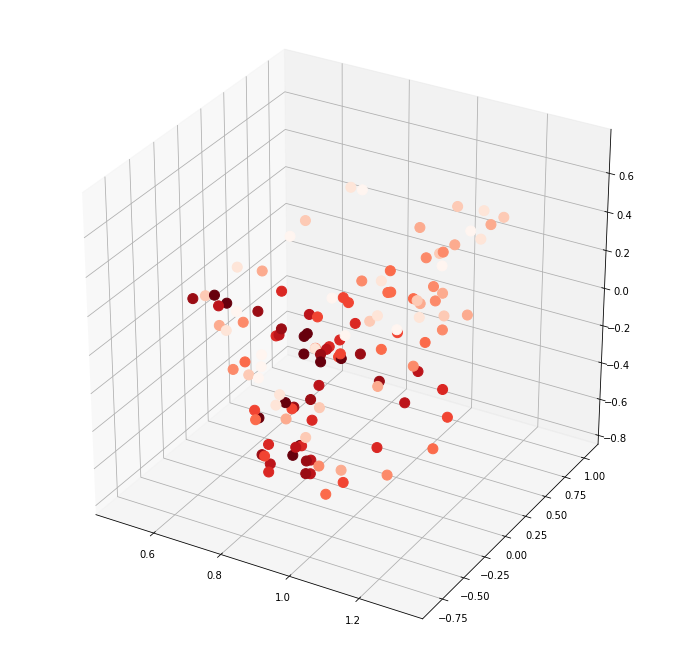

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=125, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

Rank-100 models:  min obj, 0.47;  max obj, 0.47;  time to fit, 69.5s


Rank-150 models:  min obj, 0.44;  max obj, 0.44;  time to fit, 111.9s


Rank-200 models:  min obj, 0.43;  max obj, 0.43;  time to fit, 162.5s


[0.42557694424715636]
[0.4652826301257056, 0.44499662900789594, 0.42557694424715636]
[100, 150, 200]


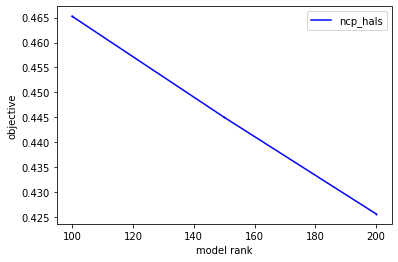

In [ ]:
ensembles_1 = get_tensor_factors(N_epoch1_max, ranks = [100,150,200])

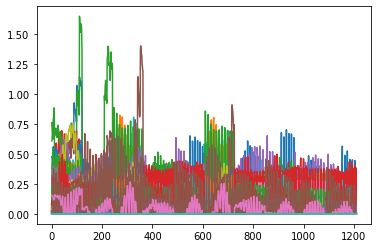

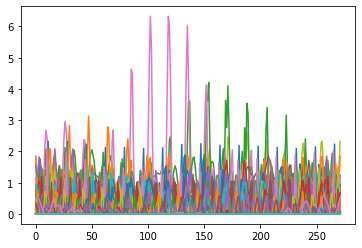

(1210, 200)


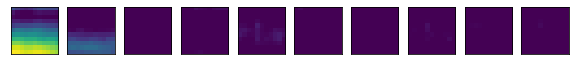

(1210, 200)


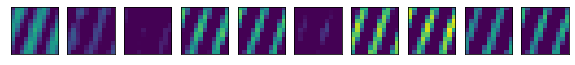

(1210, 200)


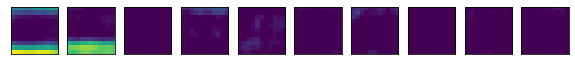

(1210, 200)


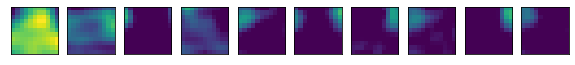

(1210, 200)


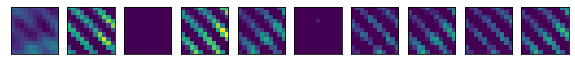

(1210, 200)


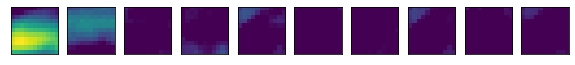

(1210, 200)


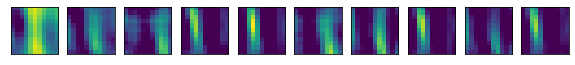

(1210, 200)


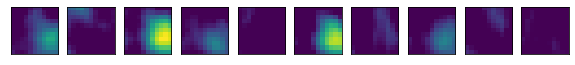

(1210, 200)


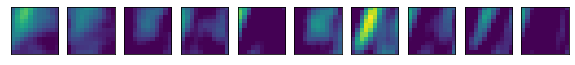

(1210, 200)


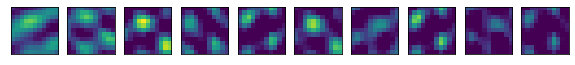

(1210, 200)


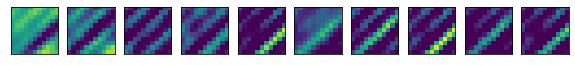

(1210, 200)


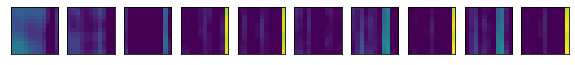

(1210, 200)


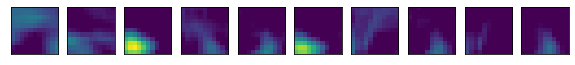

(1210, 200)


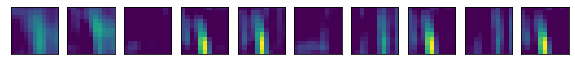

(1210, 200)


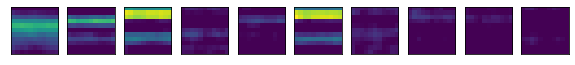

(1210, 200)


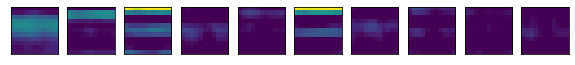

(1210, 200)


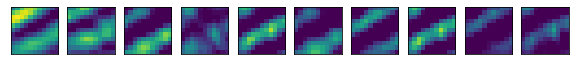

(1210, 200)


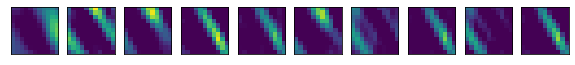

(1210, 200)


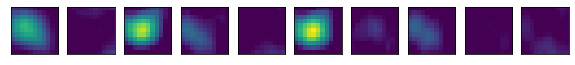

(1210, 200)


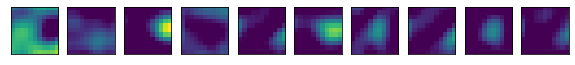

(1210, 200)


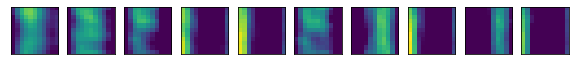

(1210, 200)


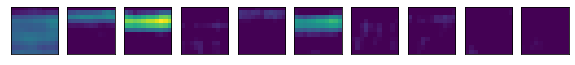

(1210, 200)


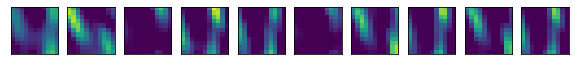

(1210, 200)


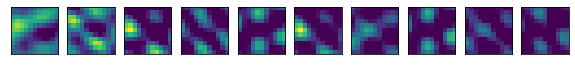

(1210, 200)


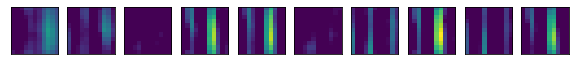

(1210, 200)


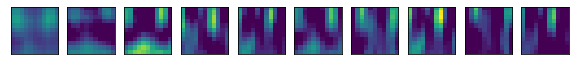

(1210, 200)


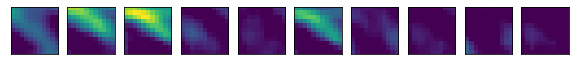

(1210, 200)


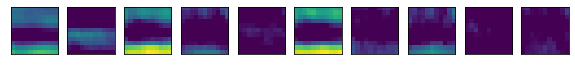

(1210, 200)


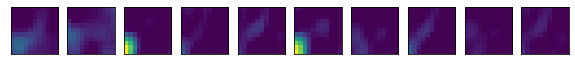

(1210, 200)


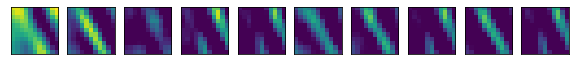

(1210, 200)


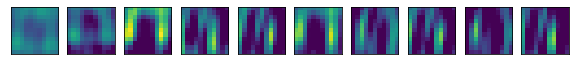

(1210, 200)


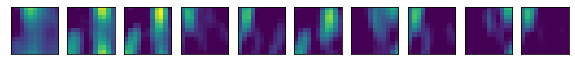

(1210, 200)


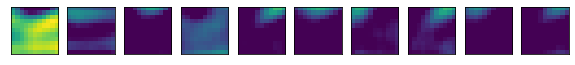

(1210, 200)


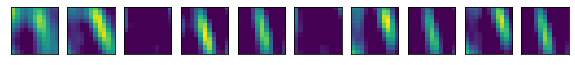

(1210, 200)


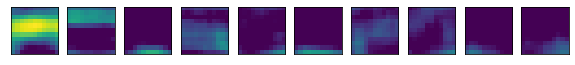

(1210, 200)


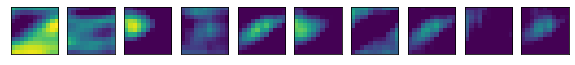

(1210, 200)


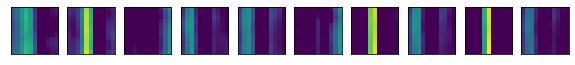

(1210, 200)


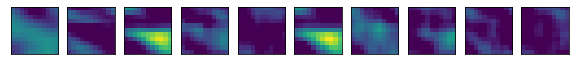

(1210, 200)


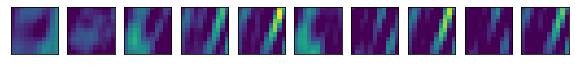

(1210, 200)


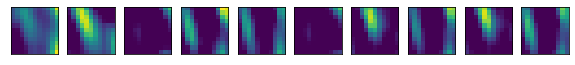

(1210, 200)


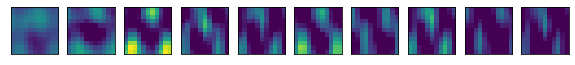

(1210, 200)


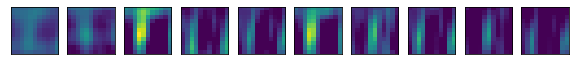

(1210, 200)


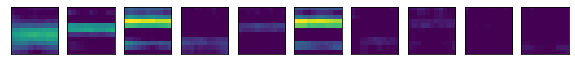

(1210, 200)


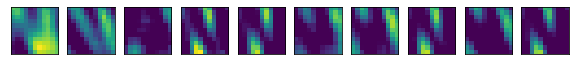

(1210, 200)


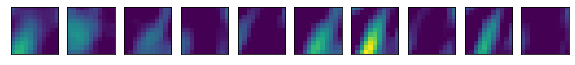

(1210, 200)


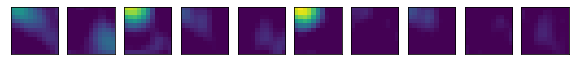

(1210, 200)


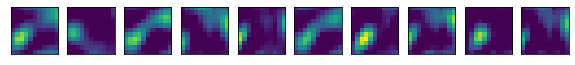

(1210, 200)


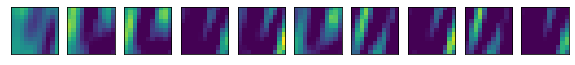

(1210, 200)


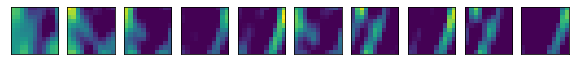

(1210, 200)


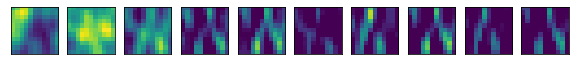

(1210, 200)


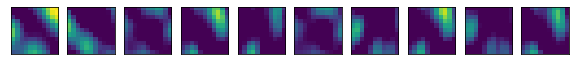

(1210, 200)


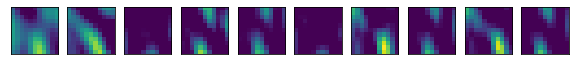

(1210, 200)


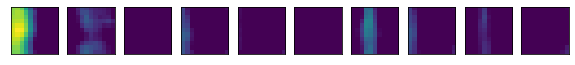

(1210, 200)


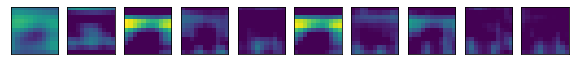

(1210, 200)


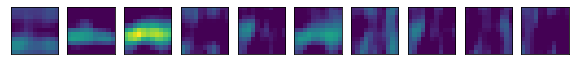

(1210, 200)


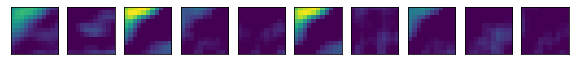

(1210, 200)


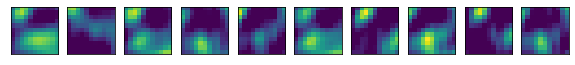

(1210, 200)


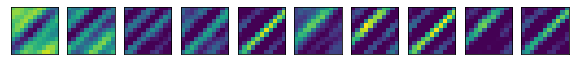

(1210, 200)


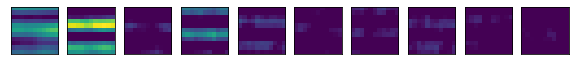

(1210, 200)


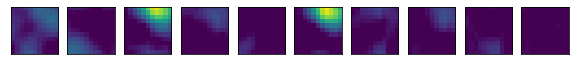

(1210, 200)


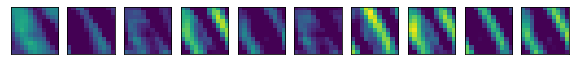

(1210, 200)


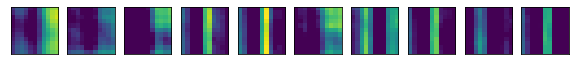

(1210, 200)


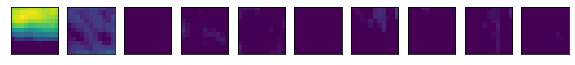

(1210, 200)


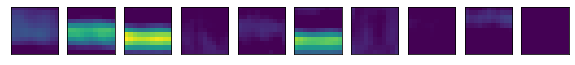

(1210, 200)


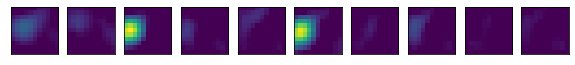

(1210, 200)


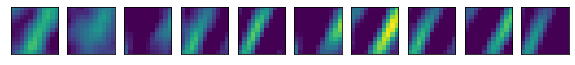

(1210, 200)


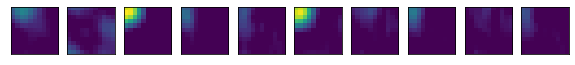

(1210, 200)


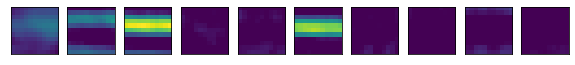

(1210, 200)


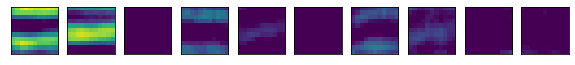

(1210, 200)


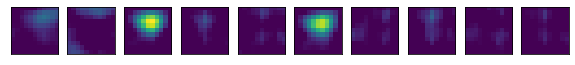

(1210, 200)


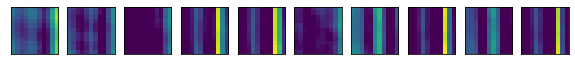

(1210, 200)


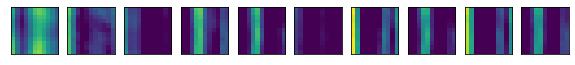

(1210, 200)


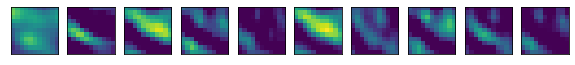

(1210, 200)


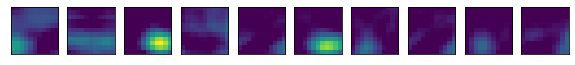

(1210, 200)


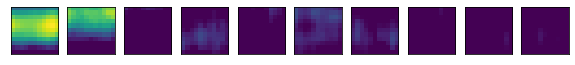

(1210, 200)


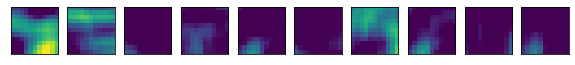

(1210, 200)


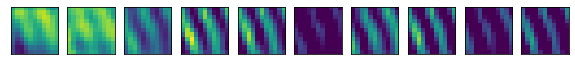

(1210, 200)


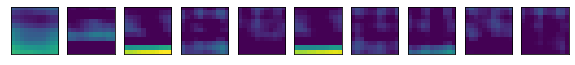

(1210, 200)


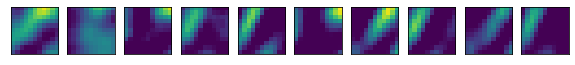

(1210, 200)


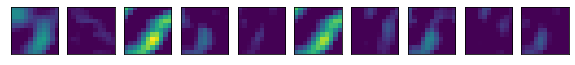

(1210, 200)


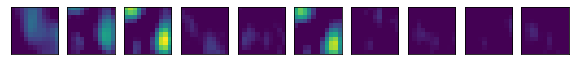

(1210, 200)


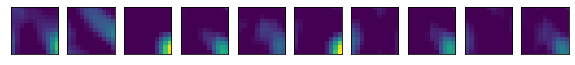

(1210, 200)


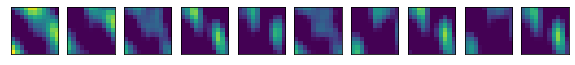

(1210, 200)


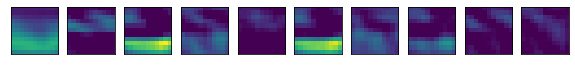

(1210, 200)


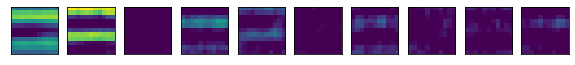

(1210, 200)


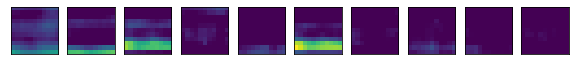

(1210, 200)


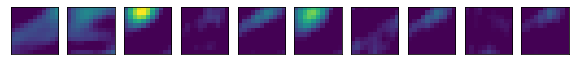

(1210, 200)


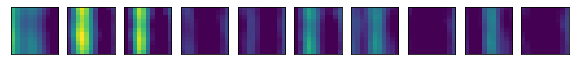

(1210, 200)


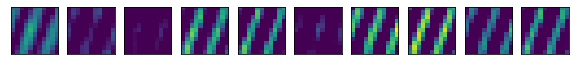

(1210, 200)


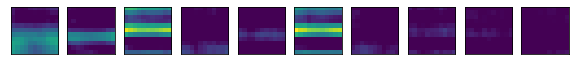

(1210, 200)


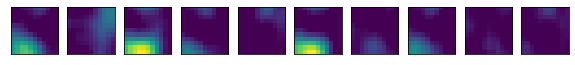

(1210, 200)


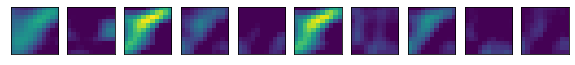

(1210, 200)


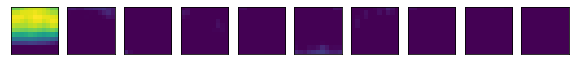

(1210, 200)


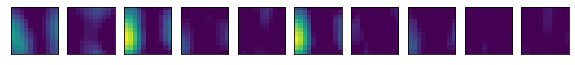

(1210, 200)


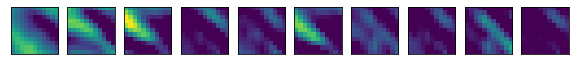

(1210, 200)


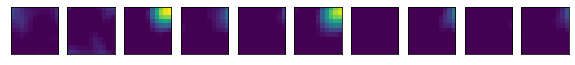

(1210, 200)


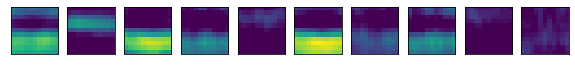

(1210, 200)


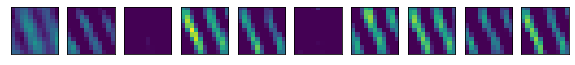

(1210, 200)


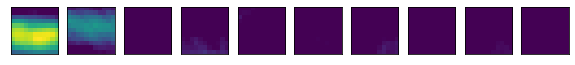

(1210, 200)


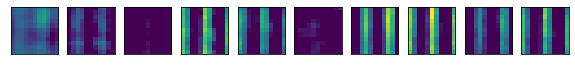

(1210, 200)


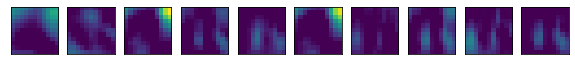

(1210, 200)


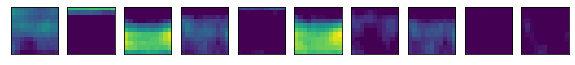

(1210, 200)


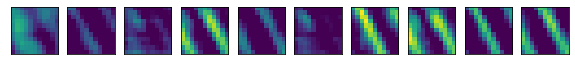

(1210, 200)


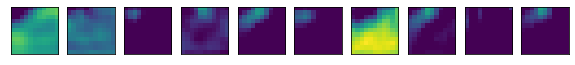

(1210, 200)


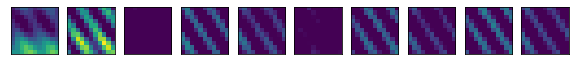

(1210, 200)


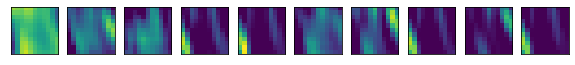

(1210, 200)


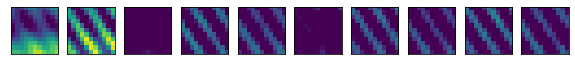

(1210, 200)


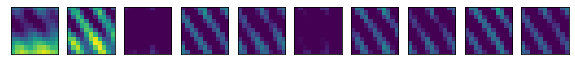

(1210, 200)


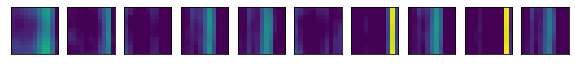

(1210, 200)


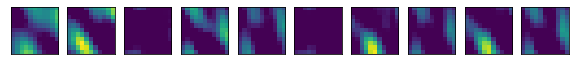

(1210, 200)


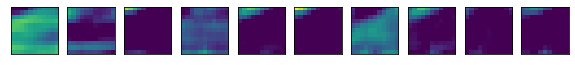

(1210, 200)


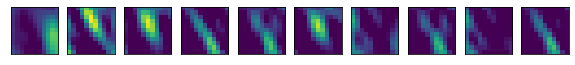

(1210, 200)


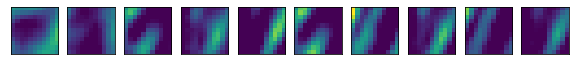

(1210, 200)


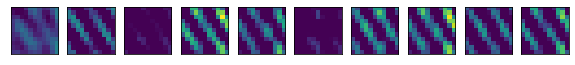

(1210, 200)


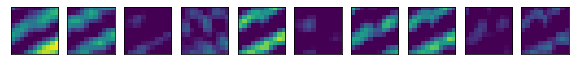

(1210, 200)


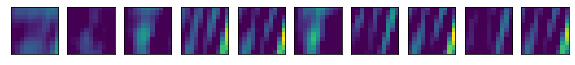

(1210, 200)


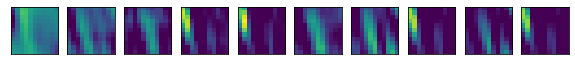

(1210, 200)


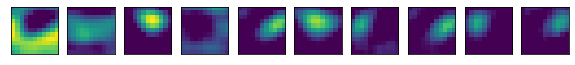

(1210, 200)


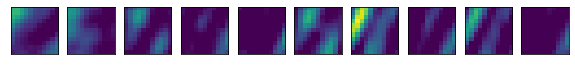

(1210, 200)


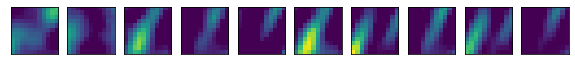

(1210, 200)


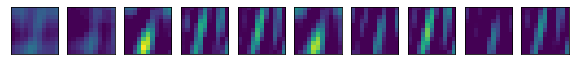

(1210, 200)


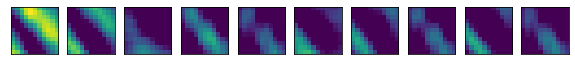

(1210, 200)


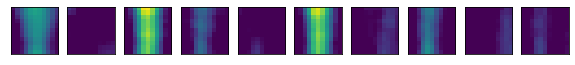

(1210, 200)


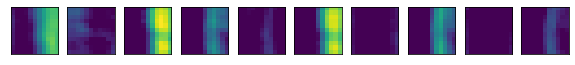

(1210, 200)


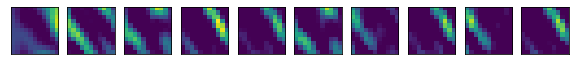

(1210, 200)


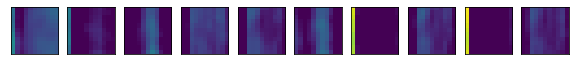

(1210, 200)


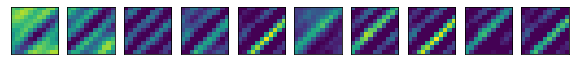

(1210, 200)


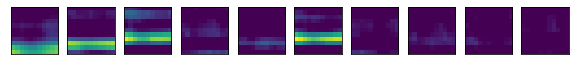

(1210, 200)


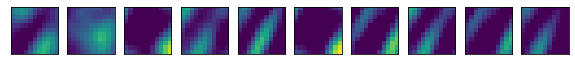

(1210, 200)


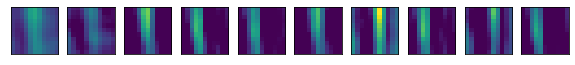

(1210, 200)


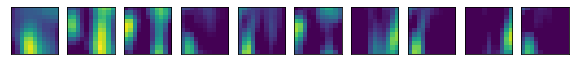

(1210, 200)


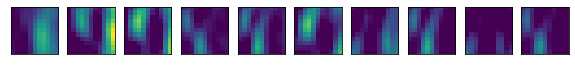

(1210, 200)


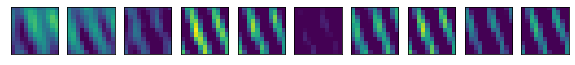

(1210, 200)


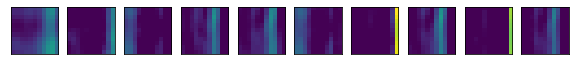

(1210, 200)


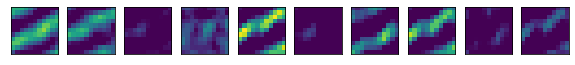

(1210, 200)


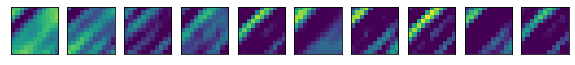

(1210, 200)


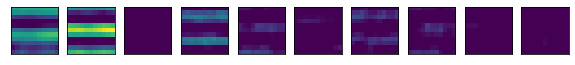

(1210, 200)


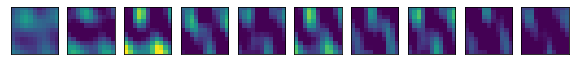

(1210, 200)


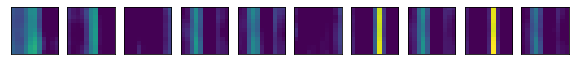

(1210, 200)


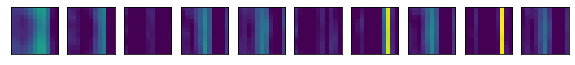

(1210, 200)


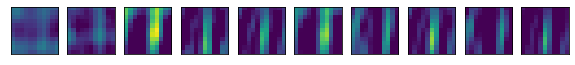

(1210, 200)


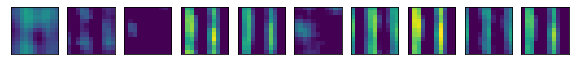

(1210, 200)


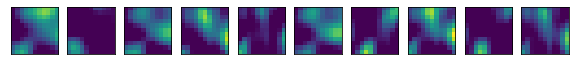

(1210, 200)


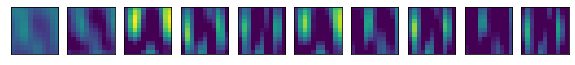

(1210, 200)


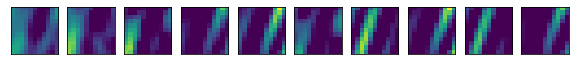

(1210, 200)


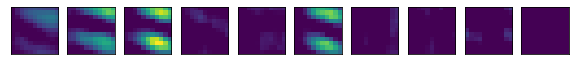

(1210, 200)


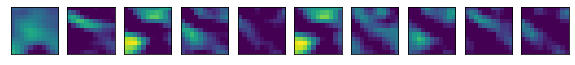

(1210, 200)


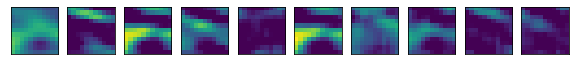

(1210, 200)


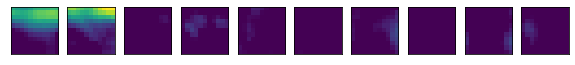

(1210, 200)


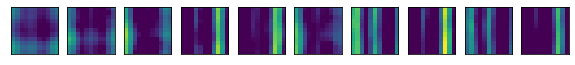

(1210, 200)


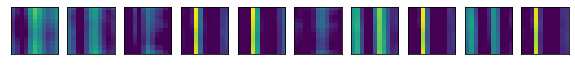

(1210, 200)


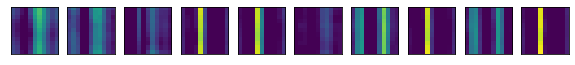

(1210, 200)


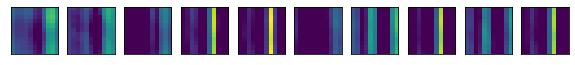

(1210, 200)


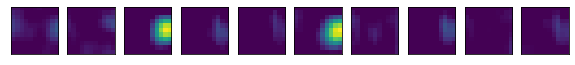

(1210, 200)


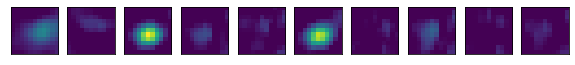

(1210, 200)


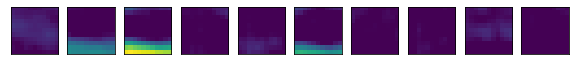

(1210, 200)


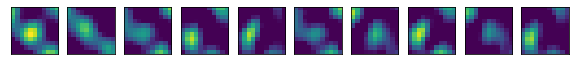

(1210, 200)


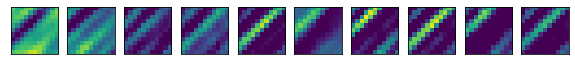

(1210, 200)


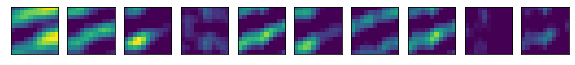

(1210, 200)


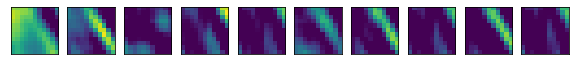

(1210, 200)


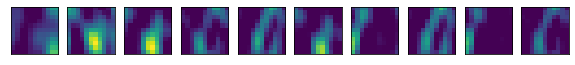

(1210, 200)


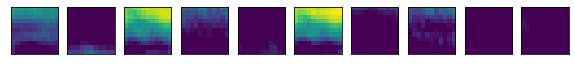

(1210, 200)


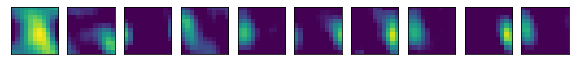

(1210, 200)


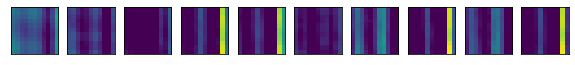

(1210, 200)


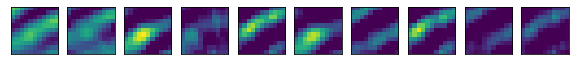

(1210, 200)


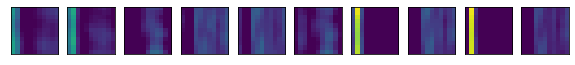

(1210, 200)


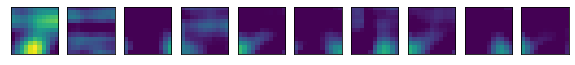

(1210, 200)


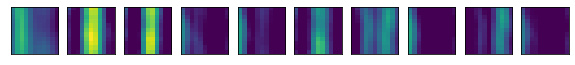

(1210, 200)


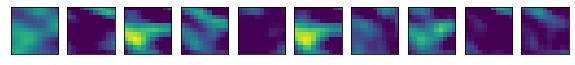

(1210, 200)


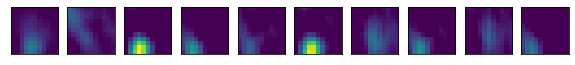

(1210, 200)


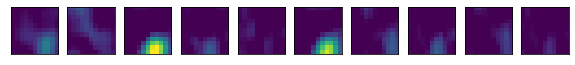

(1210, 200)


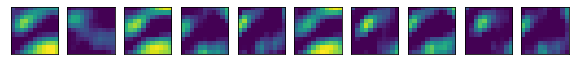

(1210, 200)


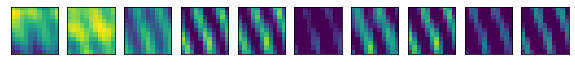

(1210, 200)


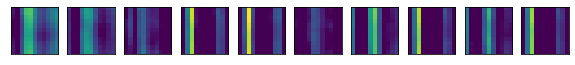

(1210, 200)


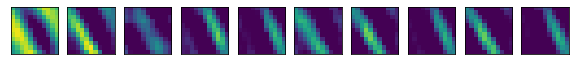

(1210, 200)


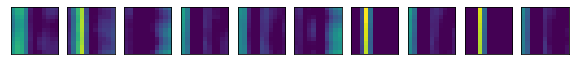

(1210, 200)


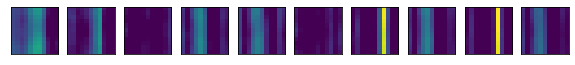

(1210, 200)


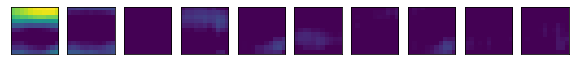

(1210, 200)


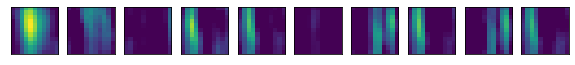

(1210, 200)


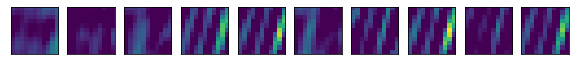

(1210, 200)


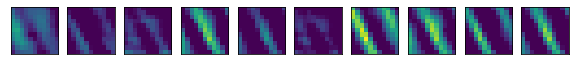

(1210, 200)


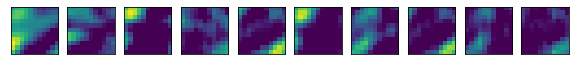

(1210, 200)


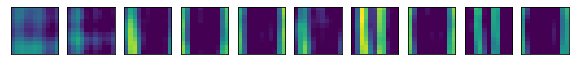

(1210, 200)


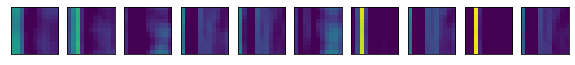

(1210, 200)


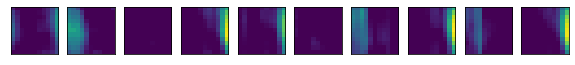

(1210, 200)


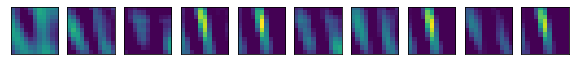

(1210, 200)


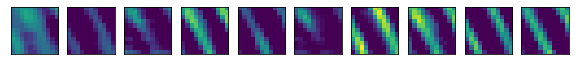

(1210, 200)


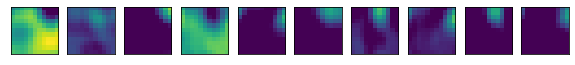

(1210, 200)


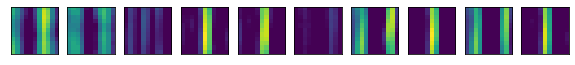

(1210, 200)


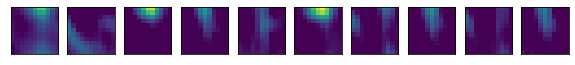

(1210, 200)


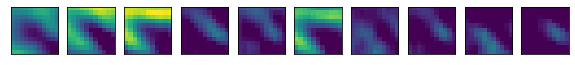

(1210, 200)


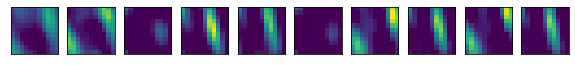

(1210, 200)


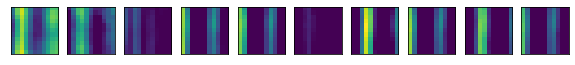

(1210, 200)


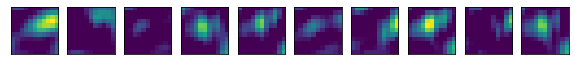

(1210, 200)


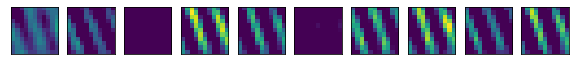

(1210, 200)


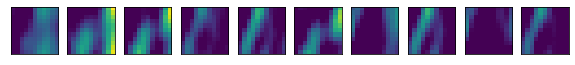

(1210, 200)


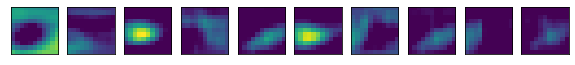

(1210, 200)


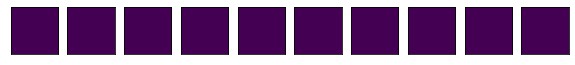

(1210, 200)


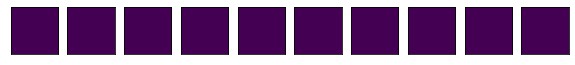

(1210, 200)


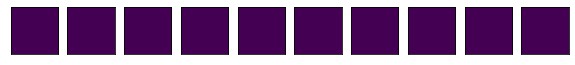

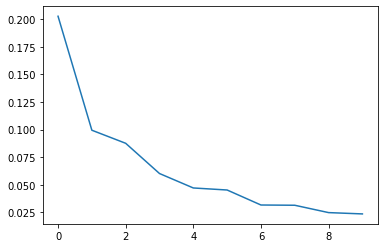

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



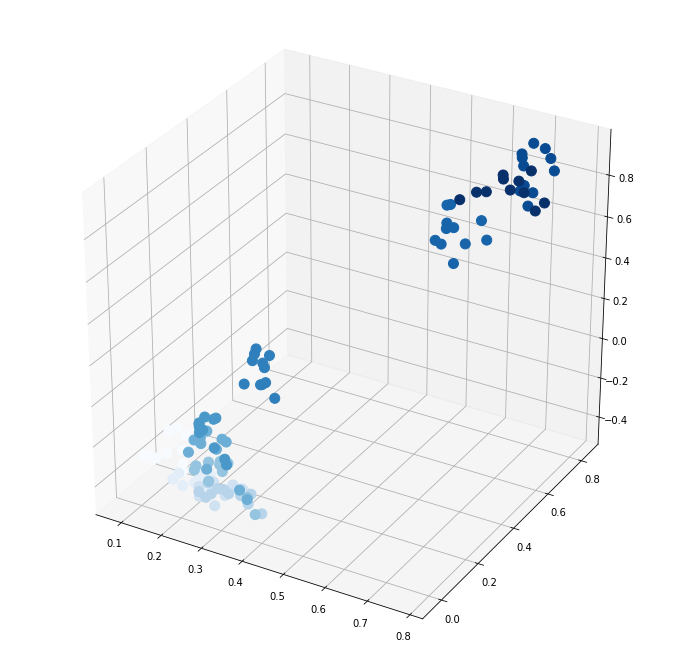

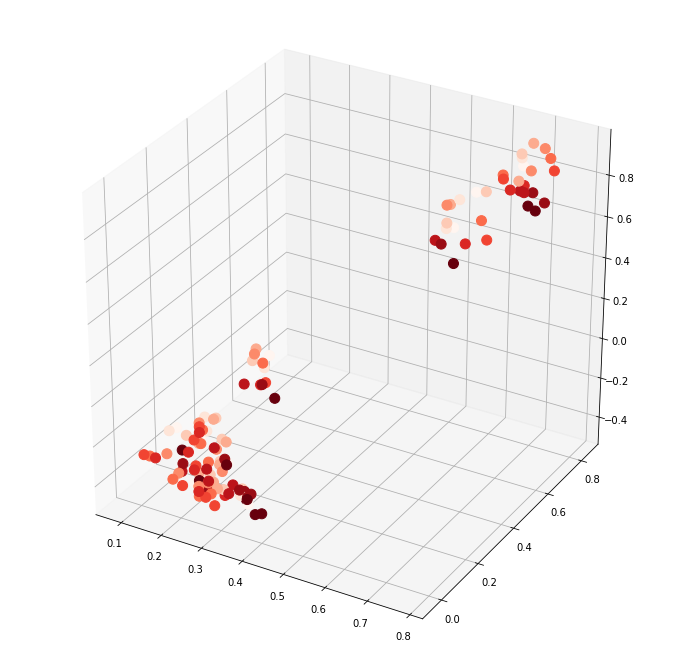

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_1['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

## For 3D epoch3 fix:

Rank-100 models:  min obj, 0.49;  max obj, 0.49;  time to fit, 60.0s


Rank-150 models:  min obj, 0.47;  max obj, 0.47;  time to fit, 119.6s


Rank-200 models:  min obj, 0.46;  max obj, 0.46;  time to fit, 171.7s


[0.4568036972542534]
[0.4917394698297232, 0.4726918933888364, 0.4568036972542534]
[100, 150, 200]


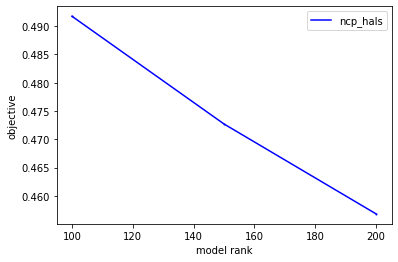

In [ ]:
ensembles_3 = get_tensor_factors(N_epoch3_fix, ranks = [100,150,200])

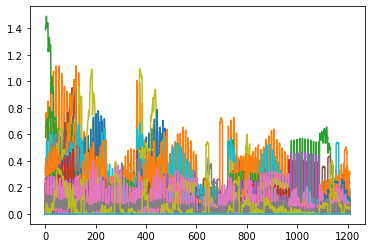

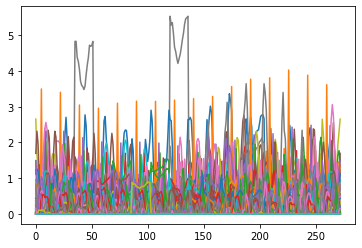

(1210, 200)


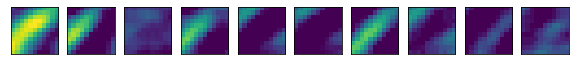

(1210, 200)


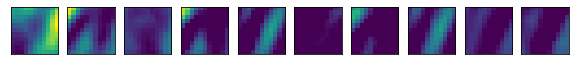

(1210, 200)


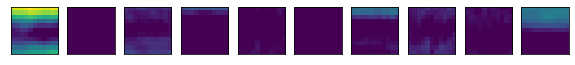

(1210, 200)


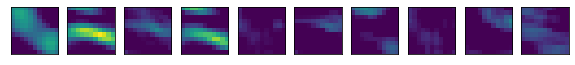

(1210, 200)


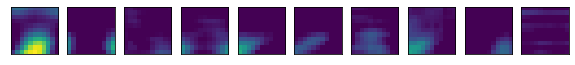

(1210, 200)


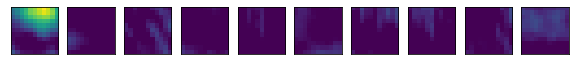

(1210, 200)


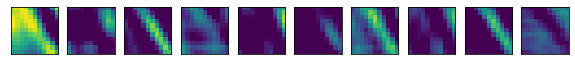

(1210, 200)


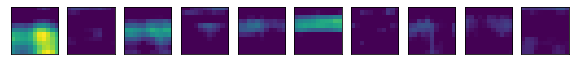

(1210, 200)


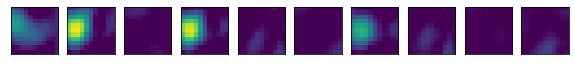

(1210, 200)


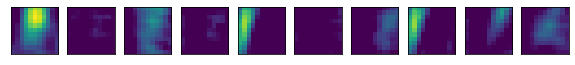

(1210, 200)


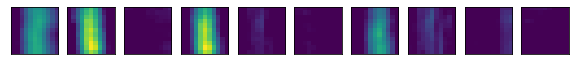

(1210, 200)


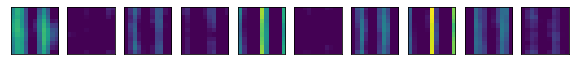

(1210, 200)


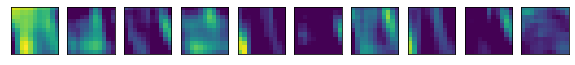

(1210, 200)


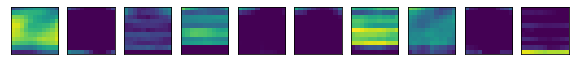

(1210, 200)


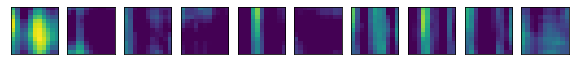

(1210, 200)


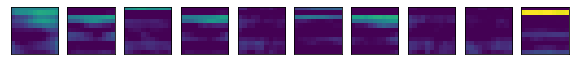

(1210, 200)


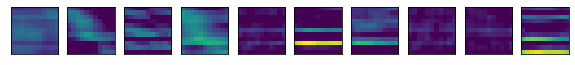

(1210, 200)


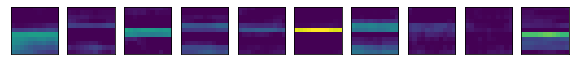

(1210, 200)


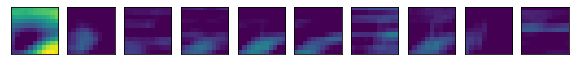

(1210, 200)


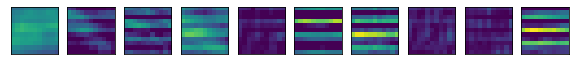

(1210, 200)


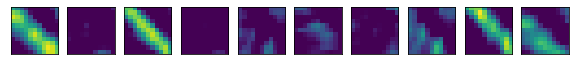

(1210, 200)


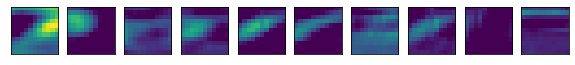

(1210, 200)


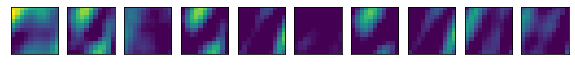

(1210, 200)


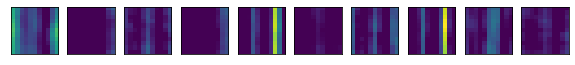

(1210, 200)


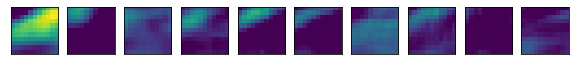

(1210, 200)


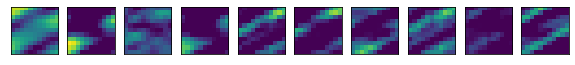

(1210, 200)


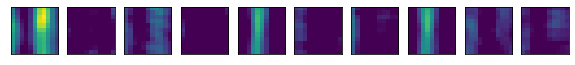

(1210, 200)


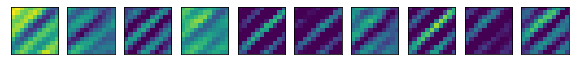

(1210, 200)


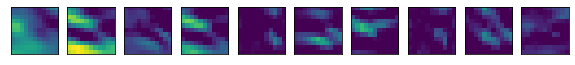

(1210, 200)


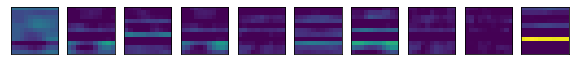

(1210, 200)


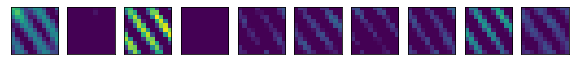

(1210, 200)


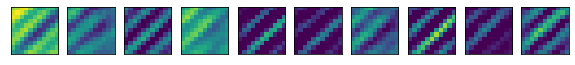

(1210, 200)


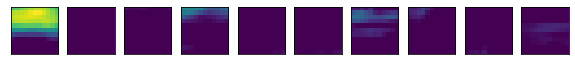

(1210, 200)


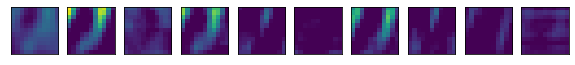

(1210, 200)


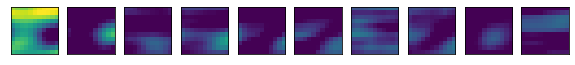

(1210, 200)


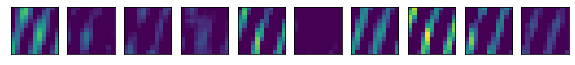

(1210, 200)


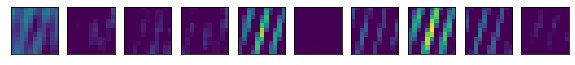

(1210, 200)


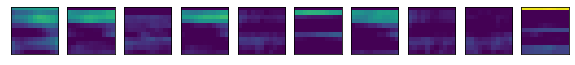

(1210, 200)


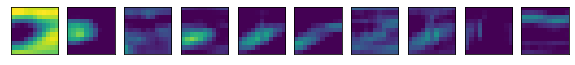

(1210, 200)


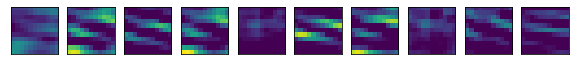

(1210, 200)


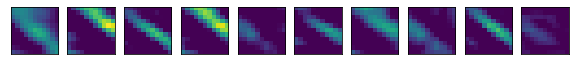

(1210, 200)


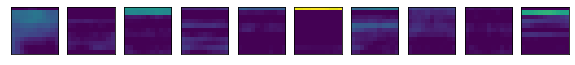

(1210, 200)


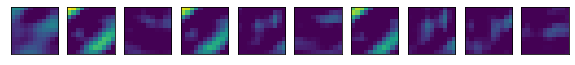

(1210, 200)


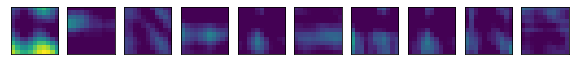

(1210, 200)


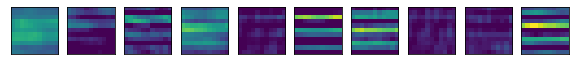

(1210, 200)


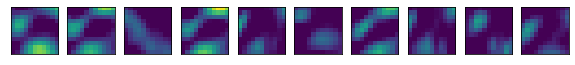

(1210, 200)


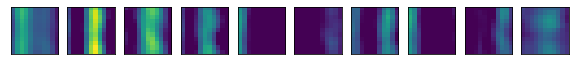

(1210, 200)


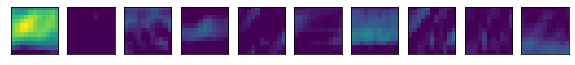

(1210, 200)


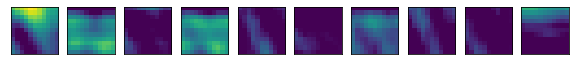

(1210, 200)


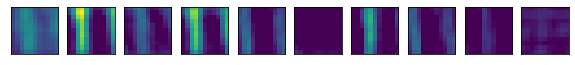

(1210, 200)


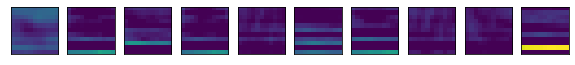

(1210, 200)


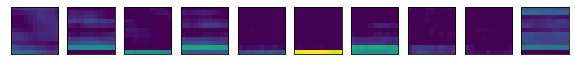

(1210, 200)


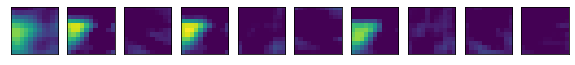

(1210, 200)


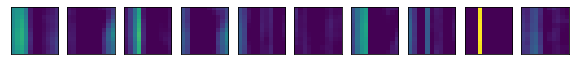

(1210, 200)


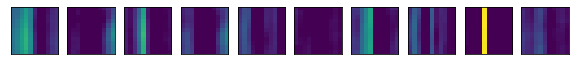

(1210, 200)


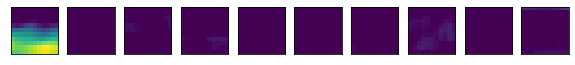

(1210, 200)


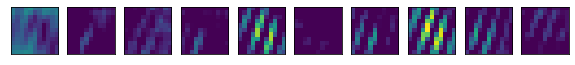

(1210, 200)


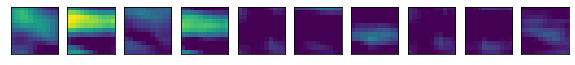

(1210, 200)


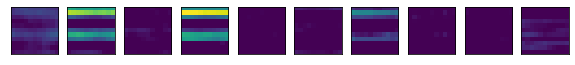

(1210, 200)


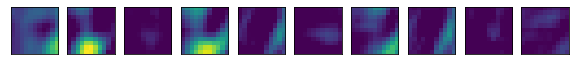

(1210, 200)


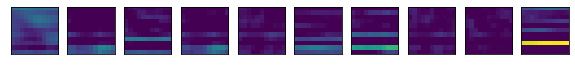

(1210, 200)


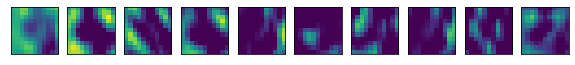

(1210, 200)


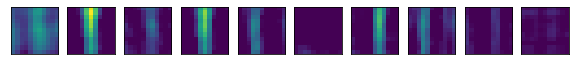

(1210, 200)


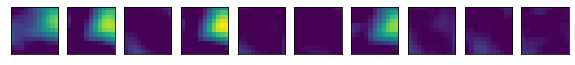

(1210, 200)


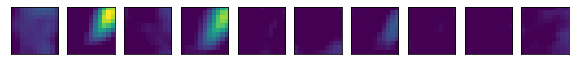

(1210, 200)


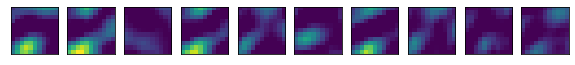

(1210, 200)


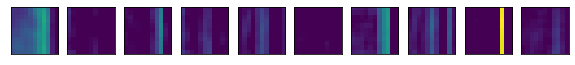

(1210, 200)


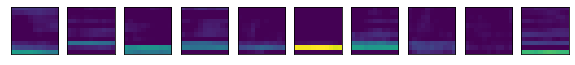

(1210, 200)


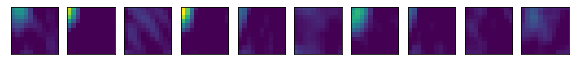

(1210, 200)


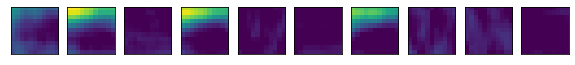

(1210, 200)


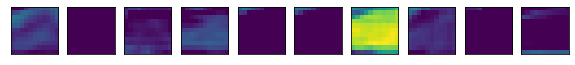

(1210, 200)


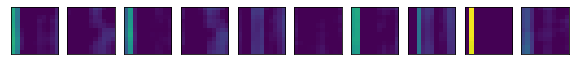

(1210, 200)


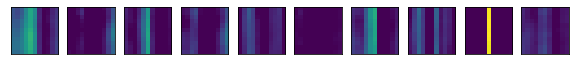

(1210, 200)


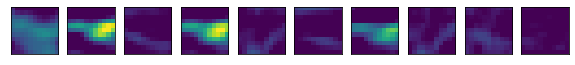

(1210, 200)


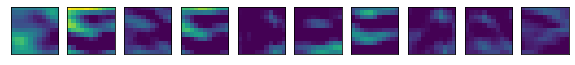

(1210, 200)


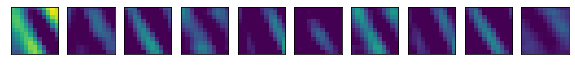

(1210, 200)


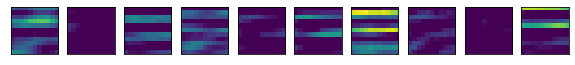

(1210, 200)


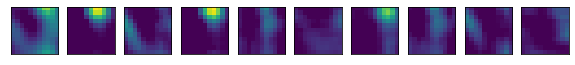

(1210, 200)


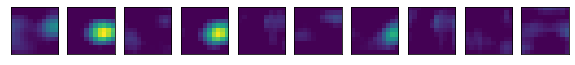

(1210, 200)


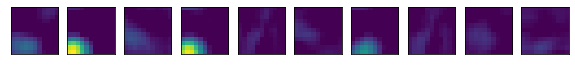

(1210, 200)


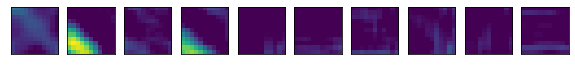

(1210, 200)


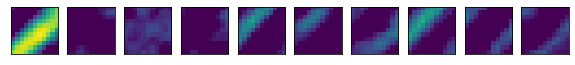

(1210, 200)


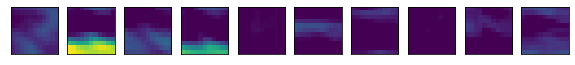

(1210, 200)


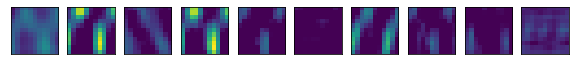

(1210, 200)


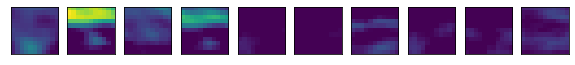

(1210, 200)


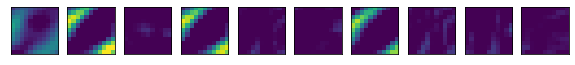

(1210, 200)


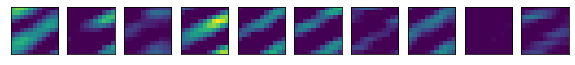

(1210, 200)


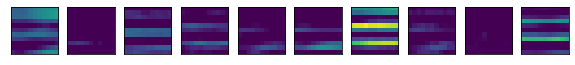

(1210, 200)


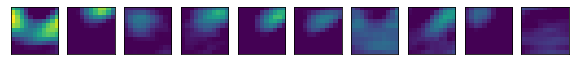

(1210, 200)


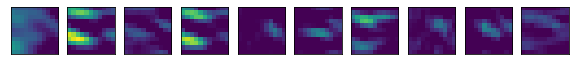

(1210, 200)


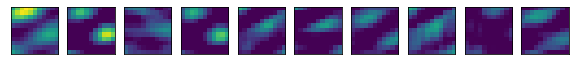

(1210, 200)


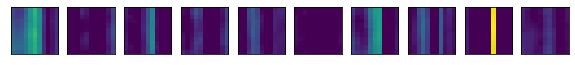

(1210, 200)


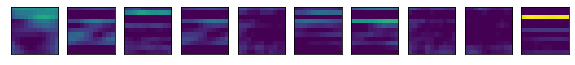

(1210, 200)


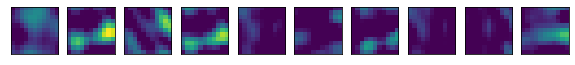

(1210, 200)


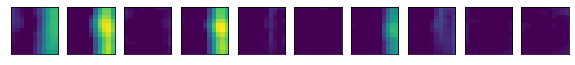

(1210, 200)


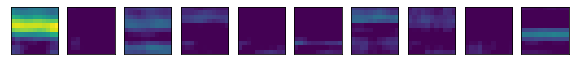

(1210, 200)


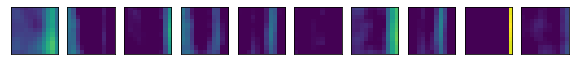

(1210, 200)


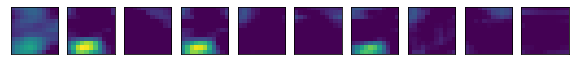

(1210, 200)


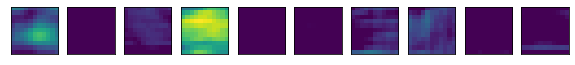

(1210, 200)


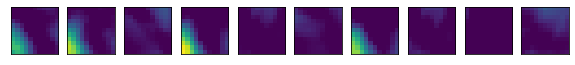

(1210, 200)


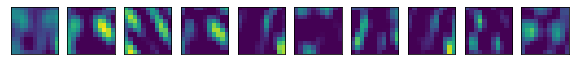

(1210, 200)


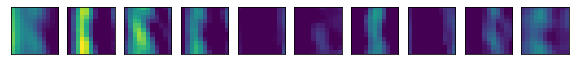

(1210, 200)


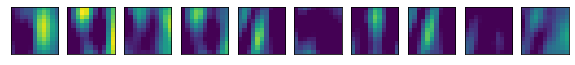

(1210, 200)


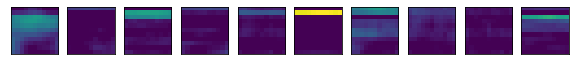

(1210, 200)


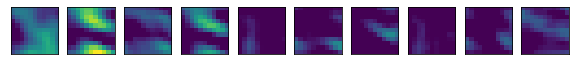

(1210, 200)


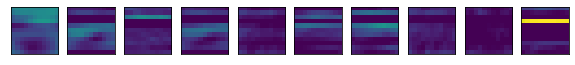

(1210, 200)


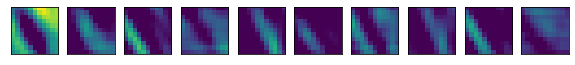

(1210, 200)


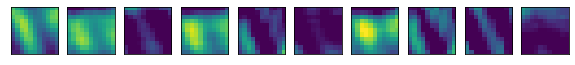

(1210, 200)


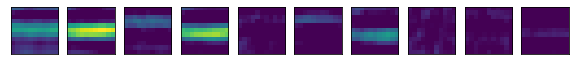

(1210, 200)


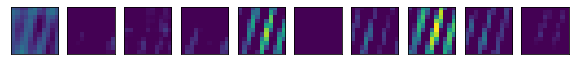

(1210, 200)


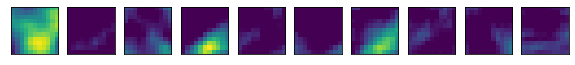

(1210, 200)


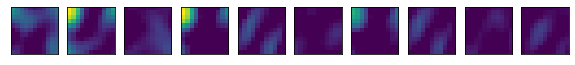

(1210, 200)


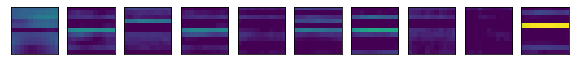

(1210, 200)


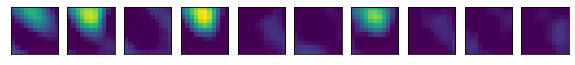

(1210, 200)


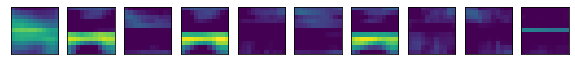

(1210, 200)


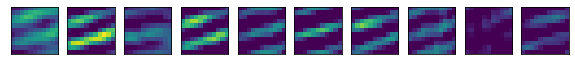

(1210, 200)


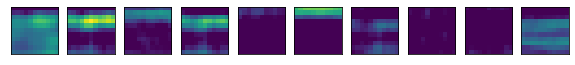

(1210, 200)


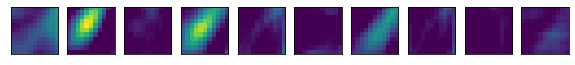

(1210, 200)


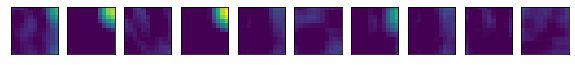

(1210, 200)


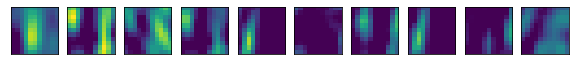

(1210, 200)


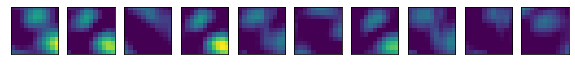

(1210, 200)


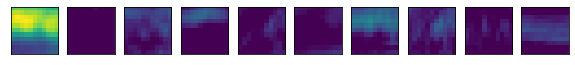

(1210, 200)


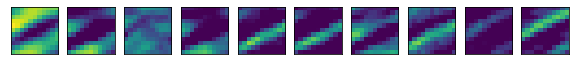

(1210, 200)


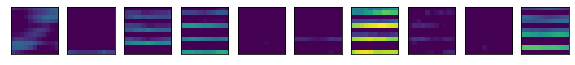

(1210, 200)


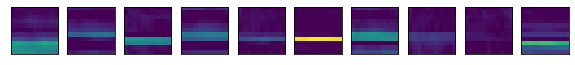

(1210, 200)


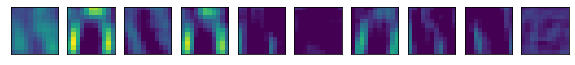

(1210, 200)


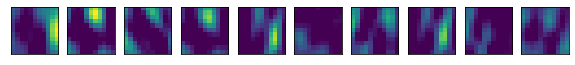

(1210, 200)


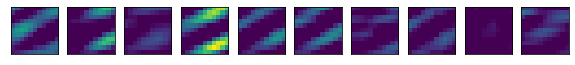

(1210, 200)


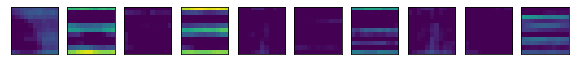

(1210, 200)


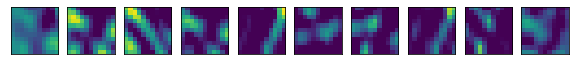

(1210, 200)


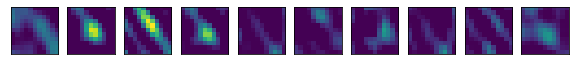

(1210, 200)


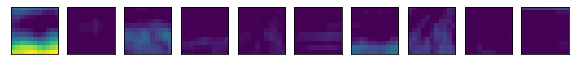

(1210, 200)


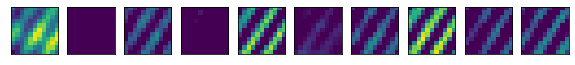

(1210, 200)


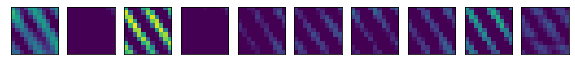

(1210, 200)


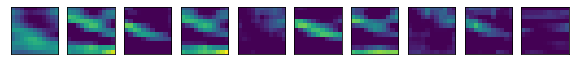

(1210, 200)


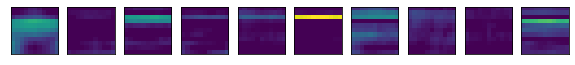

(1210, 200)


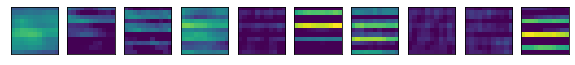

(1210, 200)


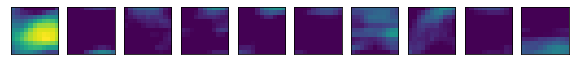

(1210, 200)


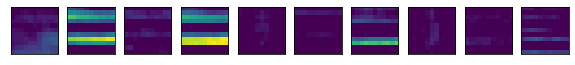

(1210, 200)


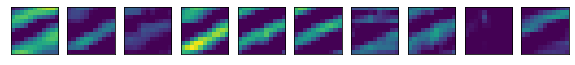

(1210, 200)


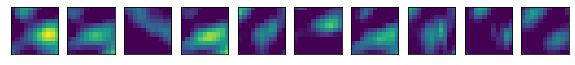

(1210, 200)


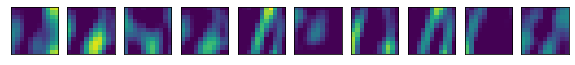

(1210, 200)


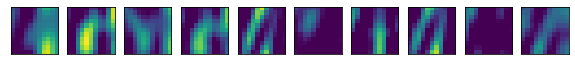

(1210, 200)


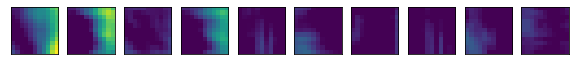

(1210, 200)


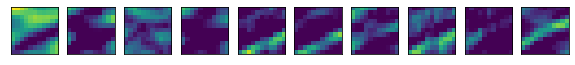

(1210, 200)


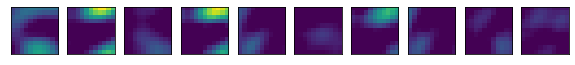

(1210, 200)


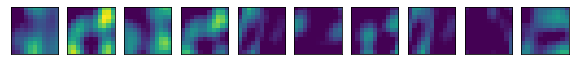

(1210, 200)


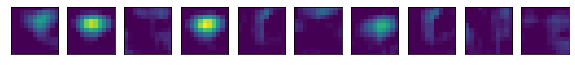

(1210, 200)


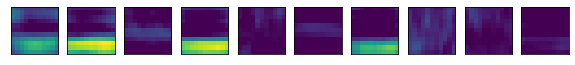

(1210, 200)


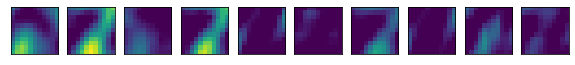

(1210, 200)


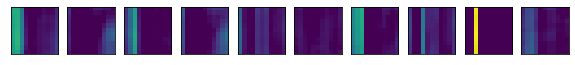

(1210, 200)


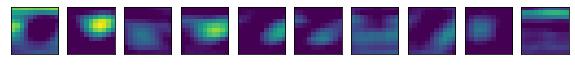

(1210, 200)


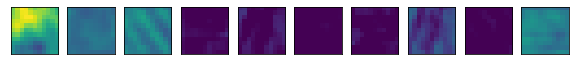

(1210, 200)


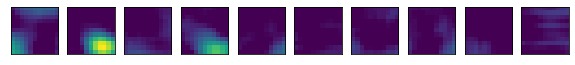

(1210, 200)


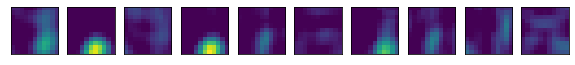

(1210, 200)


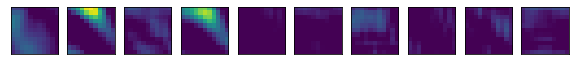

(1210, 200)


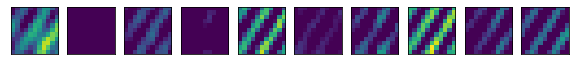

(1210, 200)


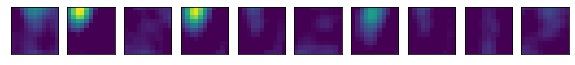

(1210, 200)


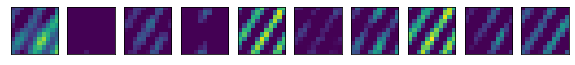

(1210, 200)


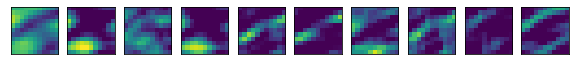

(1210, 200)


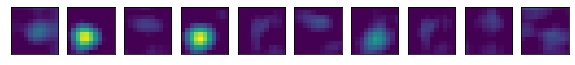

(1210, 200)


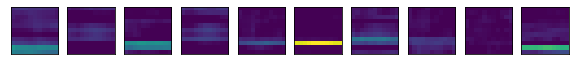

(1210, 200)


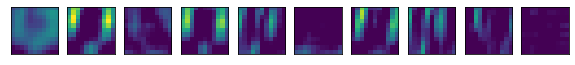

(1210, 200)


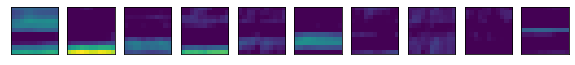

(1210, 200)


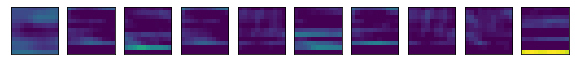

(1210, 200)


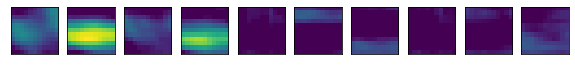

(1210, 200)


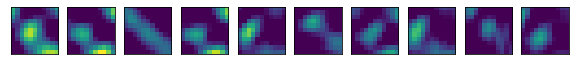

(1210, 200)


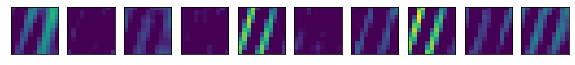

(1210, 200)


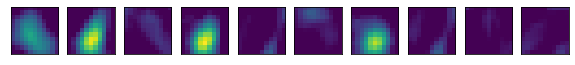

(1210, 200)


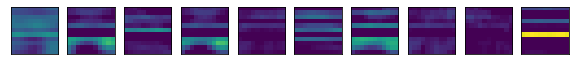

(1210, 200)


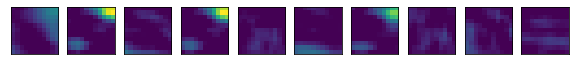

(1210, 200)


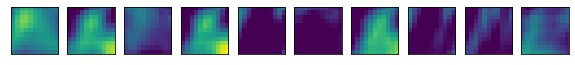

(1210, 200)


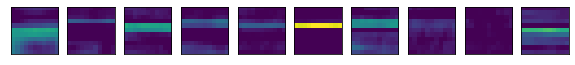

(1210, 200)


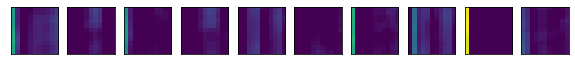

(1210, 200)


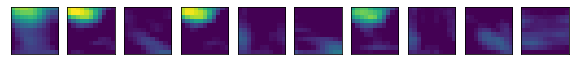

(1210, 200)


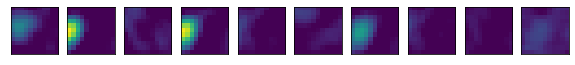

(1210, 200)


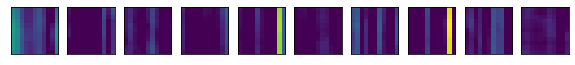

(1210, 200)


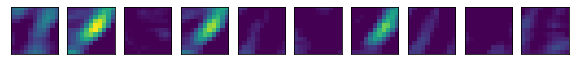

(1210, 200)


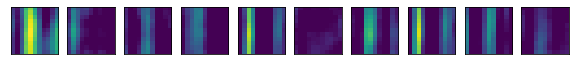

(1210, 200)


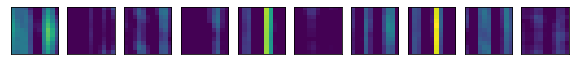

(1210, 200)


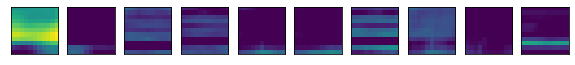

(1210, 200)


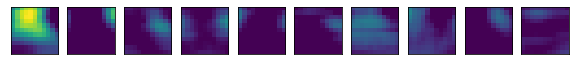

(1210, 200)


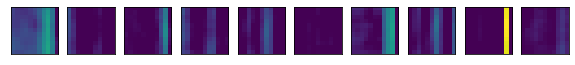

(1210, 200)


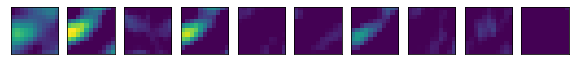

(1210, 200)


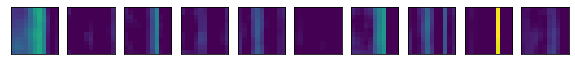

(1210, 200)


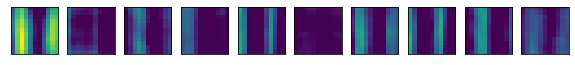

(1210, 200)


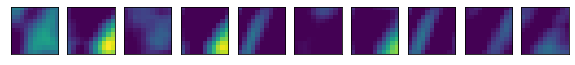

(1210, 200)


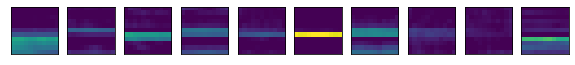

(1210, 200)


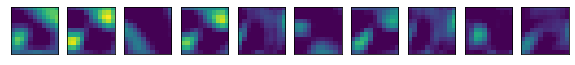

(1210, 200)


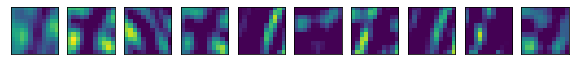

(1210, 200)


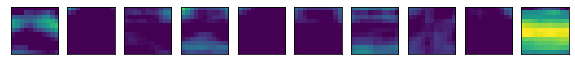

(1210, 200)


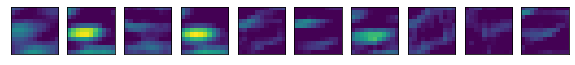

(1210, 200)


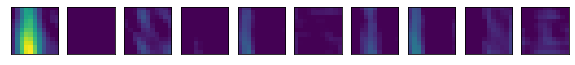

(1210, 200)


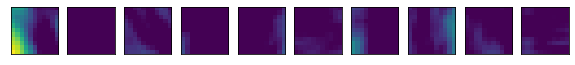

(1210, 200)


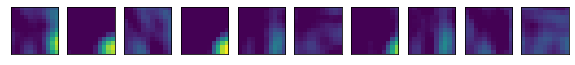

(1210, 200)


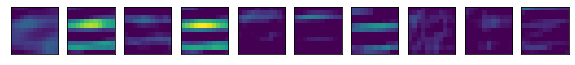

(1210, 200)


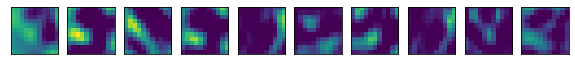

(1210, 200)


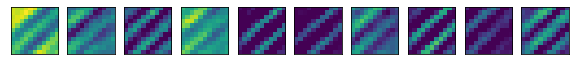

(1210, 200)


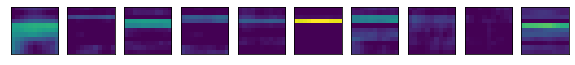

(1210, 200)


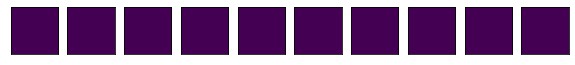

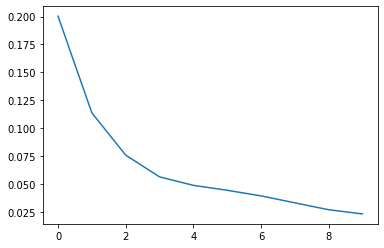

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



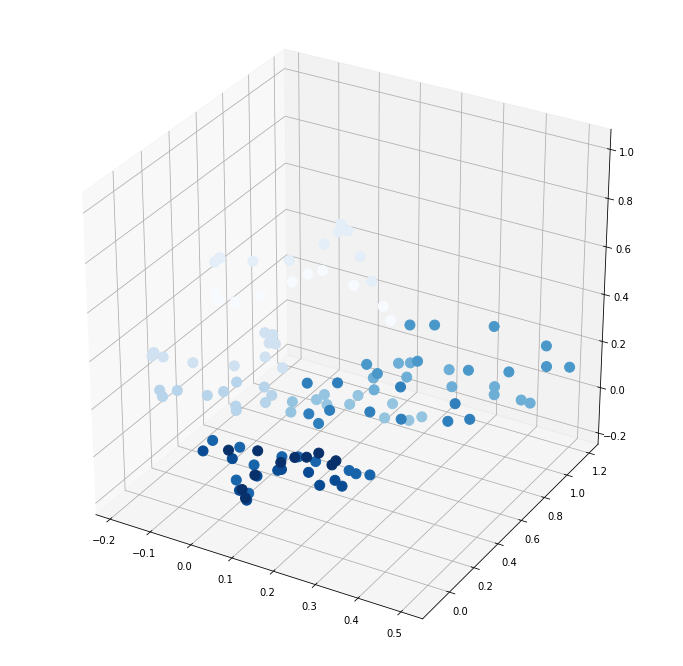

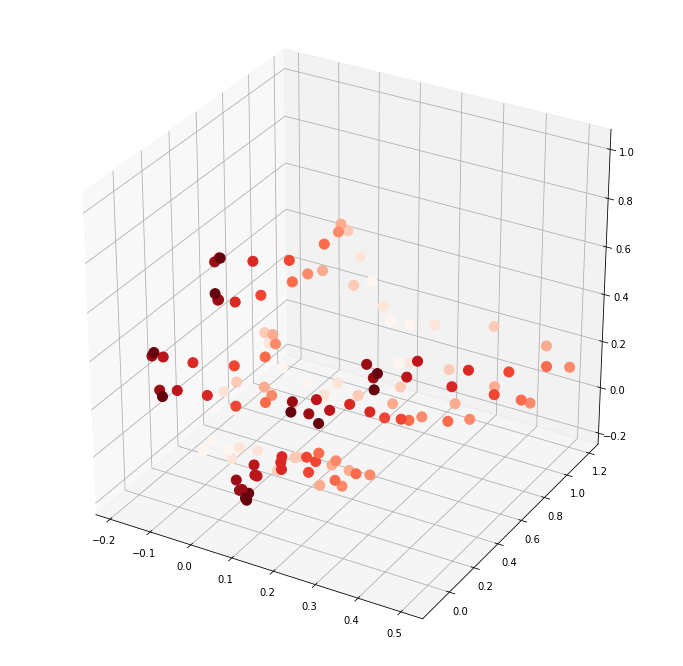

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_3}
mdic
savemat("ensembles_3.mat", mdic)

rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_3['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

## For 3D epoch 5 fix:

Rank-100 models:  min obj, 0.51;  max obj, 0.51;  time to fit, 82.8s


Rank-150 models:  min obj, 0.50;  max obj, 0.50;  time to fit, 100.0s


Rank-200 models:  min obj, 0.48;  max obj, 0.48;  time to fit, 185.9s


[0.47994085900623895]
[0.5146713490133894, 0.49538401934894927, 0.47994085900623895]
[100, 150, 200]


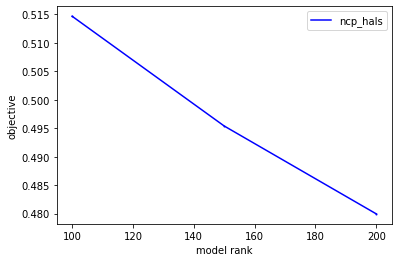

In [ ]:
ensembles_5 = get_tensor_factors(N_epoch5_fix, ranks = [100,150,200])

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_5}
mdic
savemat("ensembles_5.mat", mdic)

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_5['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

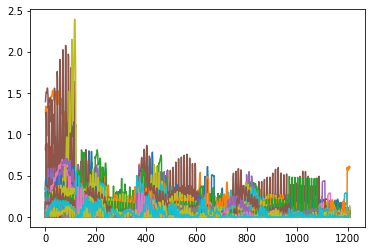

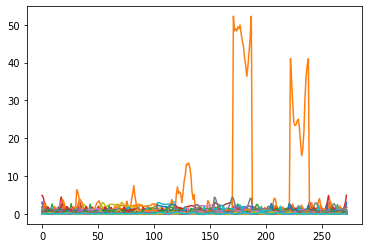

(1210, 200)


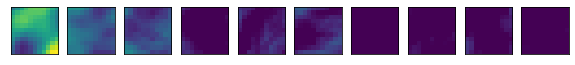

(1210, 200)


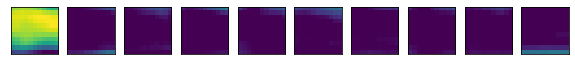

(1210, 200)


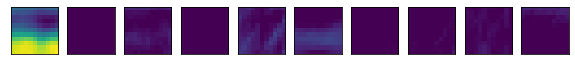

(1210, 200)


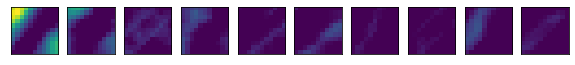

(1210, 200)


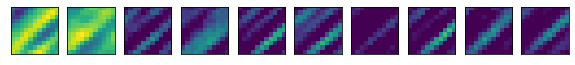

(1210, 200)


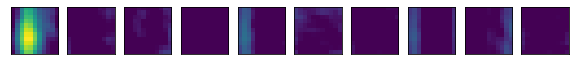

(1210, 200)


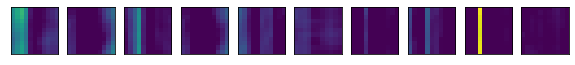

(1210, 200)


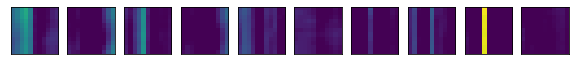

(1210, 200)


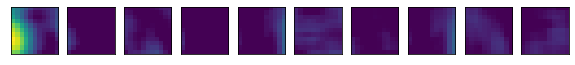

(1210, 200)


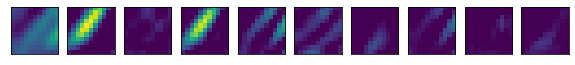

(1210, 200)


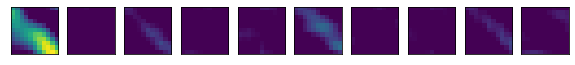

(1210, 200)


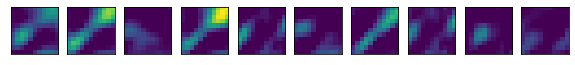

(1210, 200)


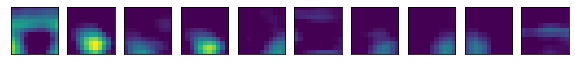

(1210, 200)


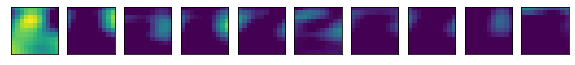

(1210, 200)


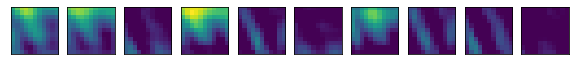

(1210, 200)


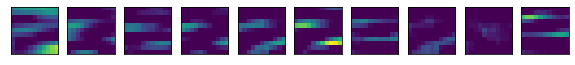

(1210, 200)


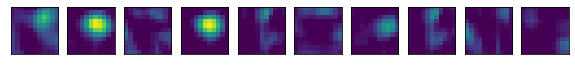

(1210, 200)


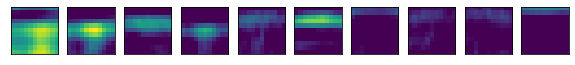

(1210, 200)


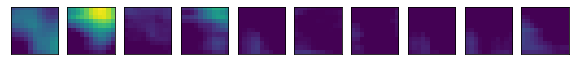

(1210, 200)


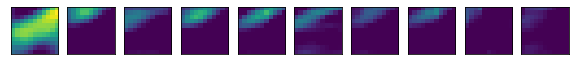

(1210, 200)


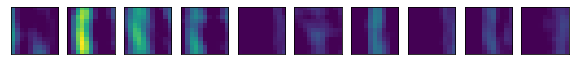

(1210, 200)


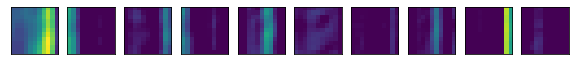

(1210, 200)


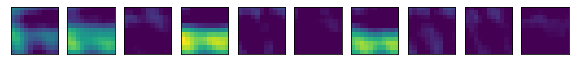

(1210, 200)


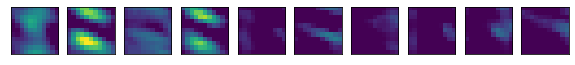

(1210, 200)


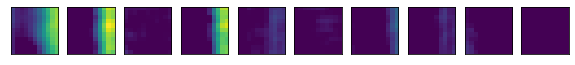

(1210, 200)


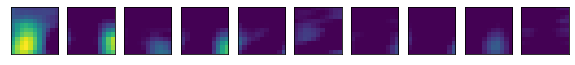

(1210, 200)


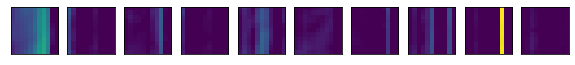

(1210, 200)


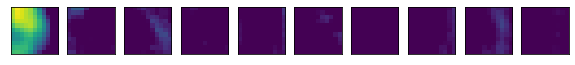

(1210, 200)


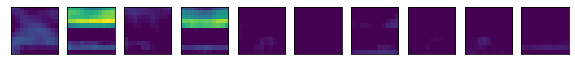

(1210, 200)


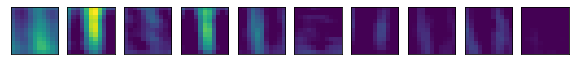

(1210, 200)


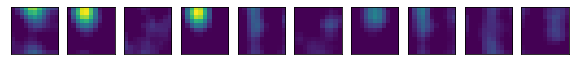

(1210, 200)


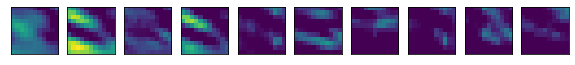

(1210, 200)


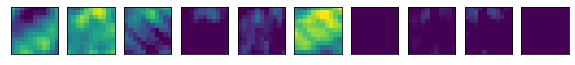

(1210, 200)


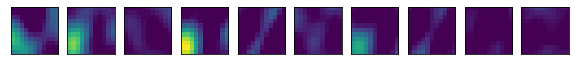

(1210, 200)


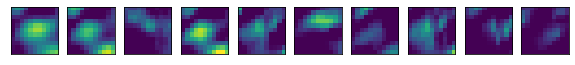

(1210, 200)


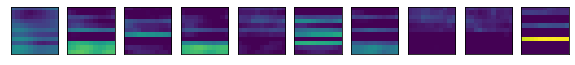

(1210, 200)


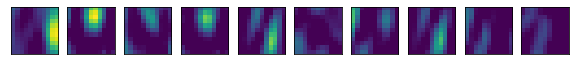

(1210, 200)


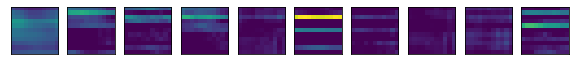

(1210, 200)


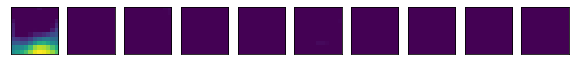

(1210, 200)


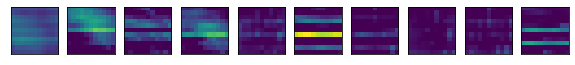

(1210, 200)


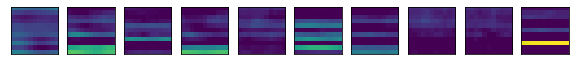

(1210, 200)


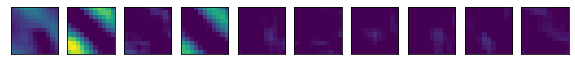

(1210, 200)


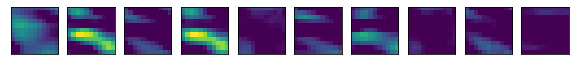

(1210, 200)


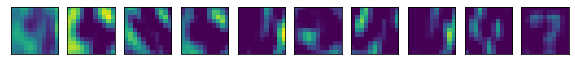

(1210, 200)


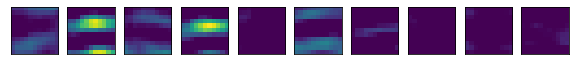

(1210, 200)


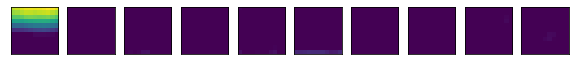

(1210, 200)


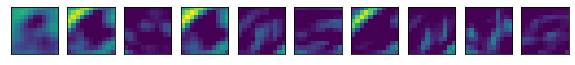

(1210, 200)


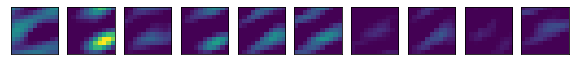

(1210, 200)


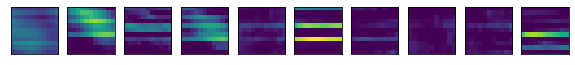

(1210, 200)


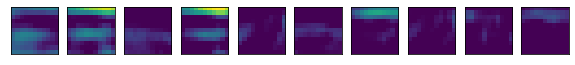

(1210, 200)


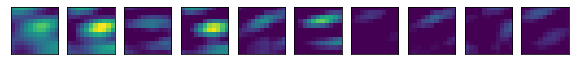

(1210, 200)


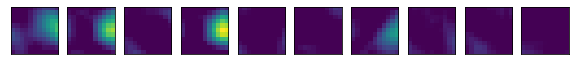

(1210, 200)


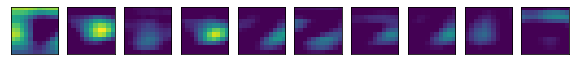

(1210, 200)


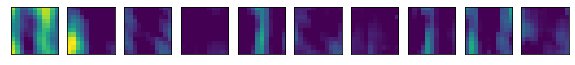

(1210, 200)


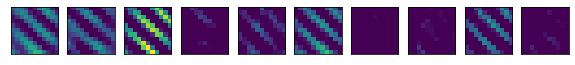

(1210, 200)


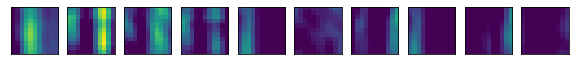

(1210, 200)


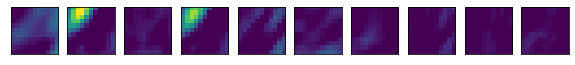

(1210, 200)


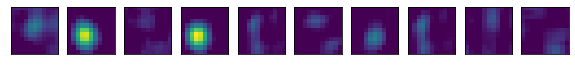

(1210, 200)


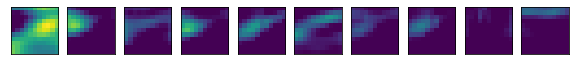

(1210, 200)


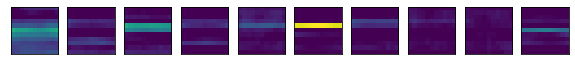

(1210, 200)


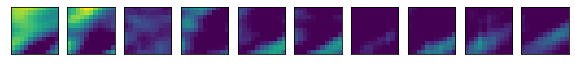

(1210, 200)


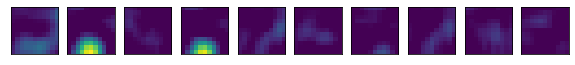

(1210, 200)


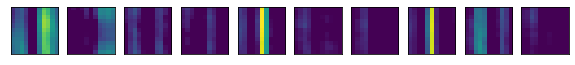

(1210, 200)


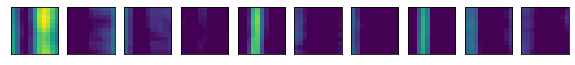

(1210, 200)


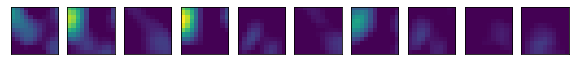

(1210, 200)


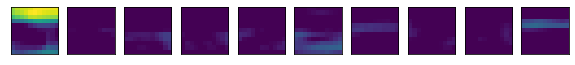

(1210, 200)


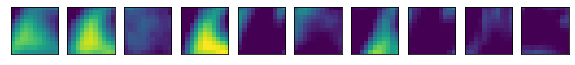

(1210, 200)


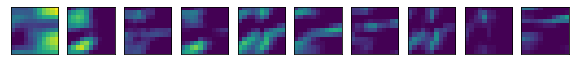

(1210, 200)


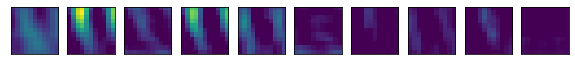

(1210, 200)


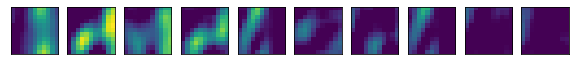

(1210, 200)


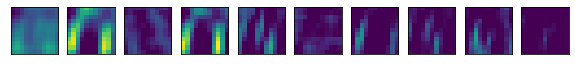

(1210, 200)


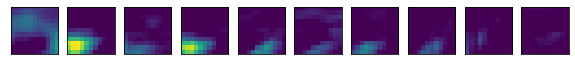

(1210, 200)


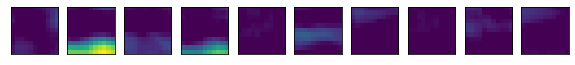

(1210, 200)


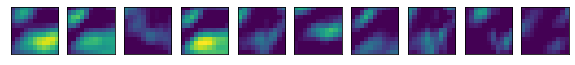

(1210, 200)


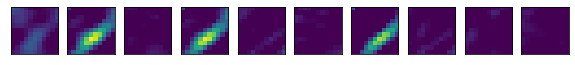

(1210, 200)


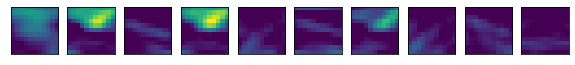

(1210, 200)


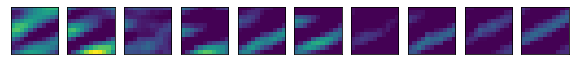

(1210, 200)


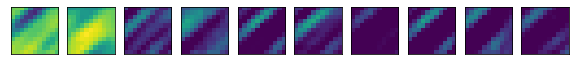

(1210, 200)


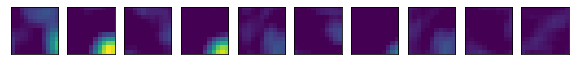

(1210, 200)


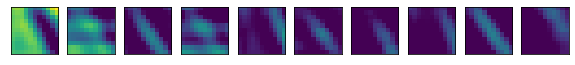

(1210, 200)


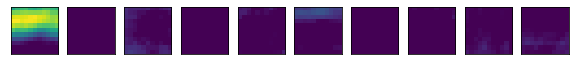

(1210, 200)


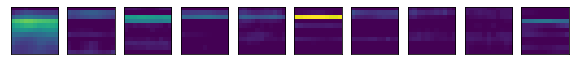

(1210, 200)


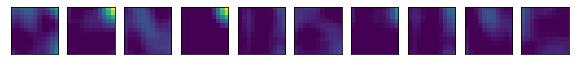

(1210, 200)


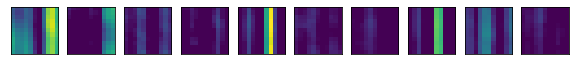

(1210, 200)


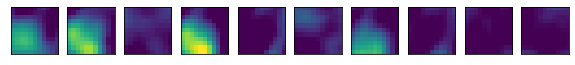

(1210, 200)


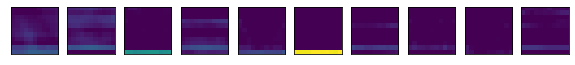

(1210, 200)


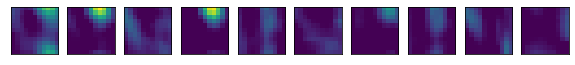

(1210, 200)


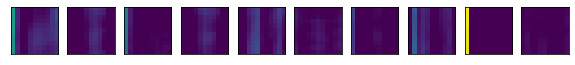

(1210, 200)


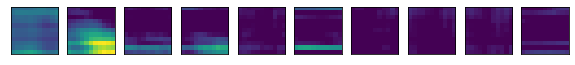

(1210, 200)


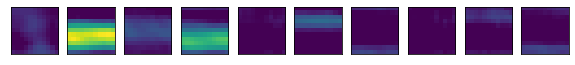

(1210, 200)


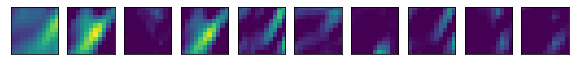

(1210, 200)


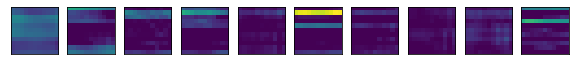

(1210, 200)


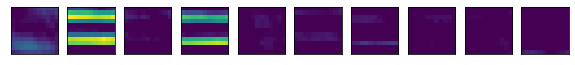

(1210, 200)


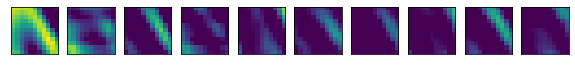

(1210, 200)


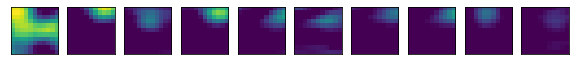

(1210, 200)


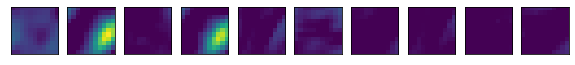

(1210, 200)


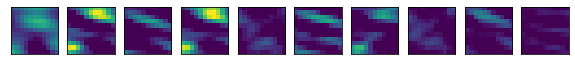

(1210, 200)


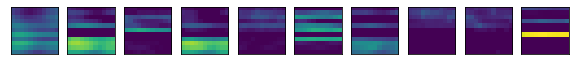

(1210, 200)


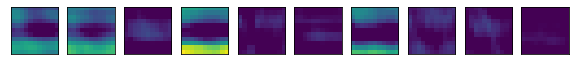

(1210, 200)


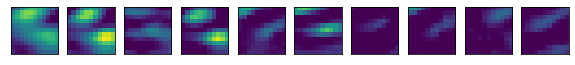

(1210, 200)


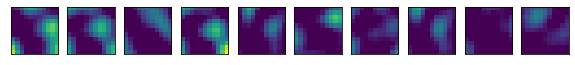

(1210, 200)


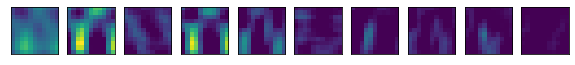

(1210, 200)


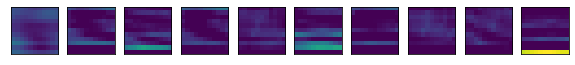

(1210, 200)


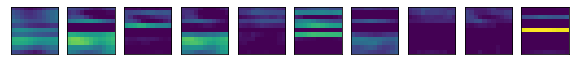

(1210, 200)


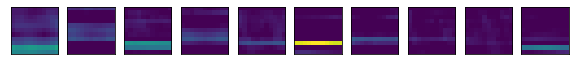

(1210, 200)


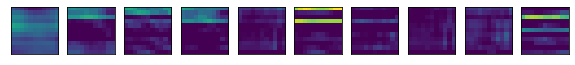

(1210, 200)


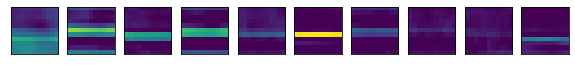

(1210, 200)


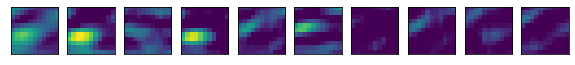

(1210, 200)


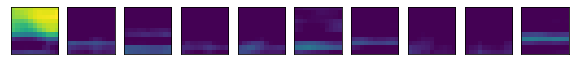

(1210, 200)


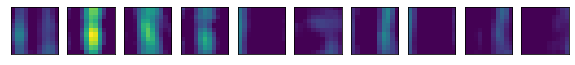

(1210, 200)


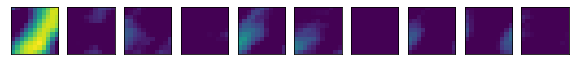

(1210, 200)


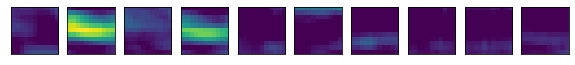

(1210, 200)


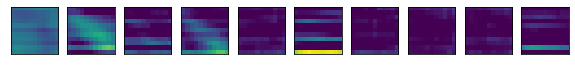

(1210, 200)


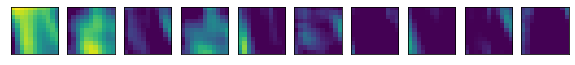

(1210, 200)


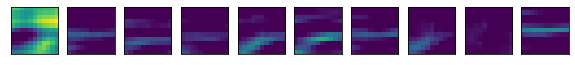

(1210, 200)


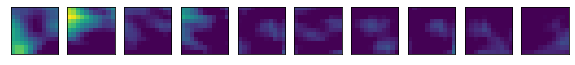

(1210, 200)


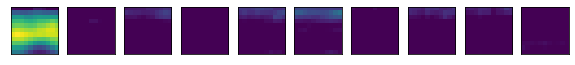

(1210, 200)


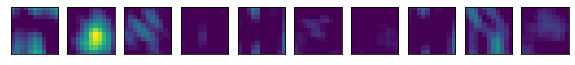

(1210, 200)


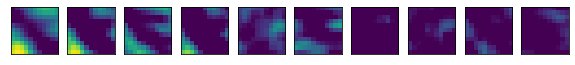

(1210, 200)


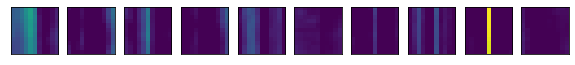

(1210, 200)


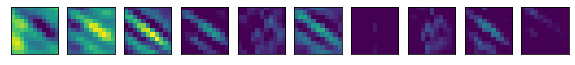

(1210, 200)


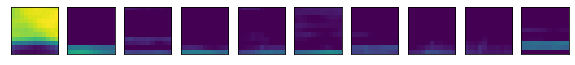

(1210, 200)


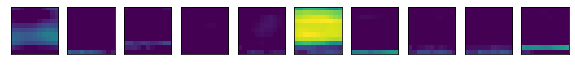

(1210, 200)


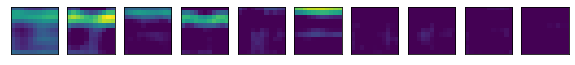

(1210, 200)


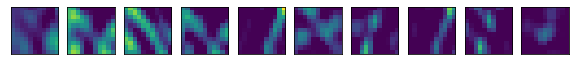

(1210, 200)


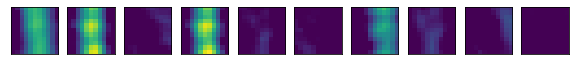

(1210, 200)


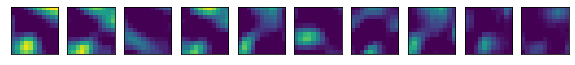

(1210, 200)


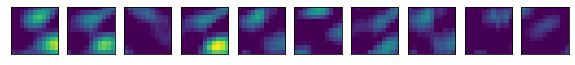

(1210, 200)


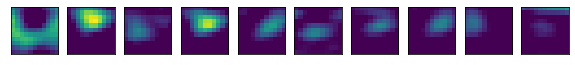

(1210, 200)


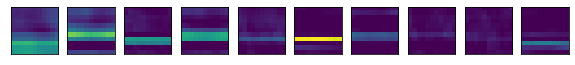

(1210, 200)


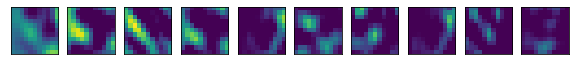

(1210, 200)


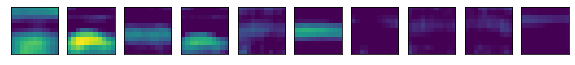

(1210, 200)


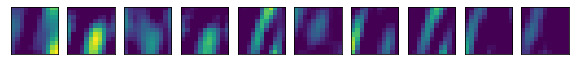

(1210, 200)


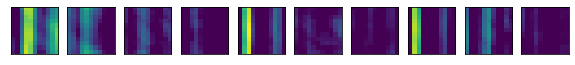

(1210, 200)


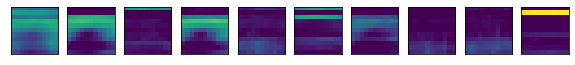

(1210, 200)


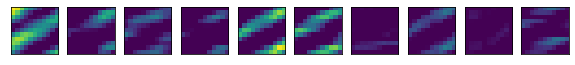

(1210, 200)


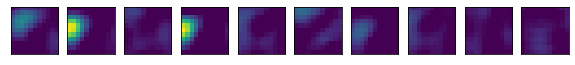

(1210, 200)


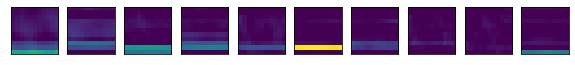

(1210, 200)


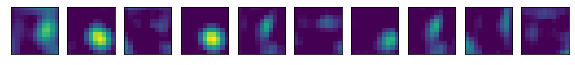

(1210, 200)


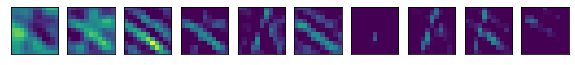

(1210, 200)


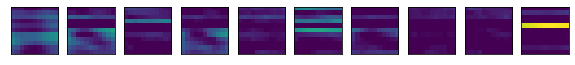

(1210, 200)


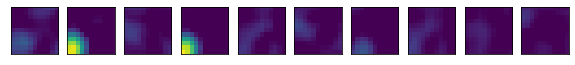

(1210, 200)


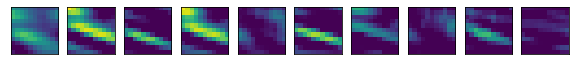

(1210, 200)


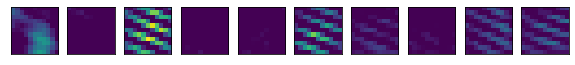

(1210, 200)


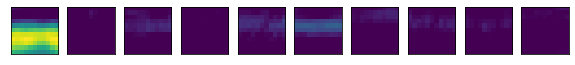

(1210, 200)


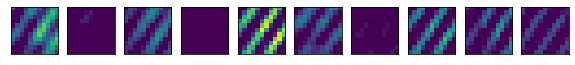

(1210, 200)


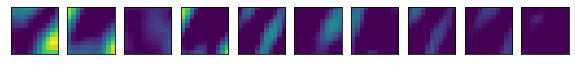

(1210, 200)


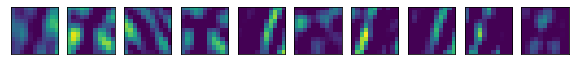

(1210, 200)


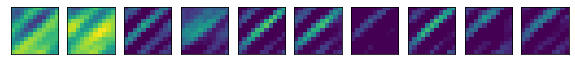

(1210, 200)


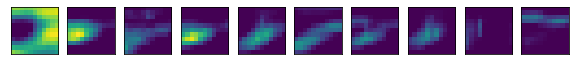

(1210, 200)


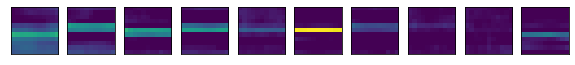

(1210, 200)


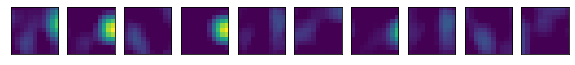

(1210, 200)


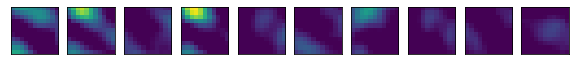

(1210, 200)


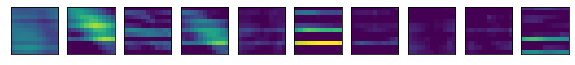

(1210, 200)


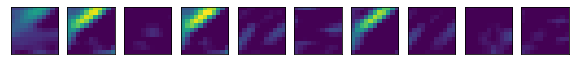

(1210, 200)


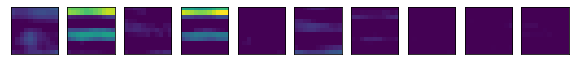

(1210, 200)


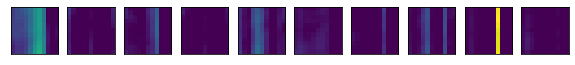

(1210, 200)


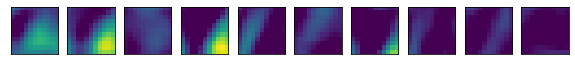

(1210, 200)


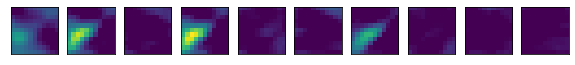

(1210, 200)


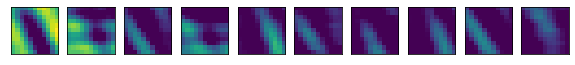

(1210, 200)


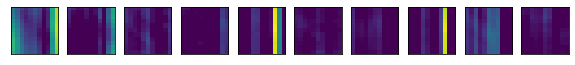

(1210, 200)


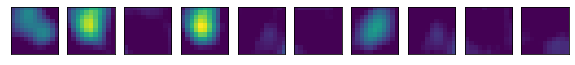

(1210, 200)


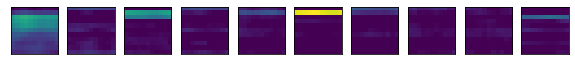

(1210, 200)


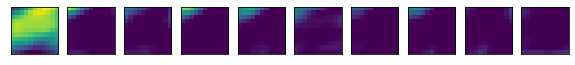

(1210, 200)


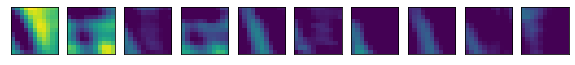

(1210, 200)


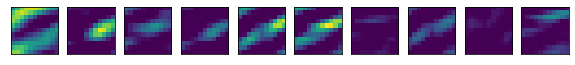

(1210, 200)


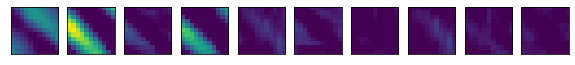

(1210, 200)


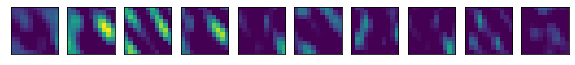

(1210, 200)


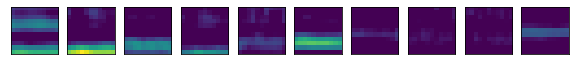

(1210, 200)


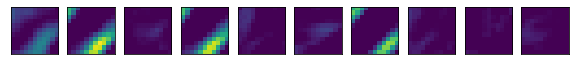

(1210, 200)


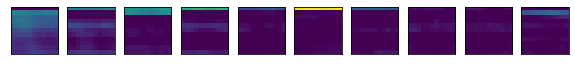

(1210, 200)


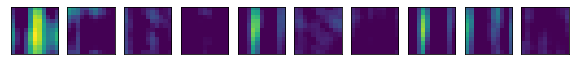

(1210, 200)


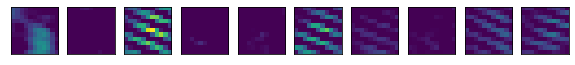

(1210, 200)


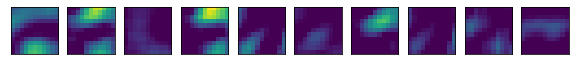

(1210, 200)


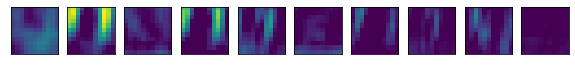

(1210, 200)


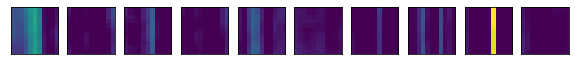

(1210, 200)


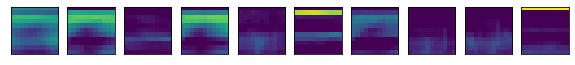

(1210, 200)


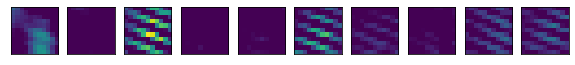

(1210, 200)


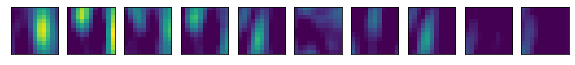

(1210, 200)


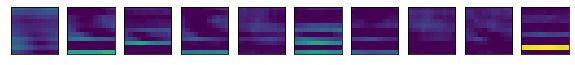

(1210, 200)


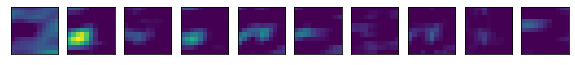

(1210, 200)


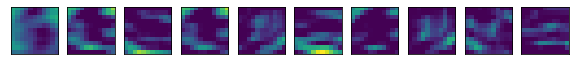

(1210, 200)


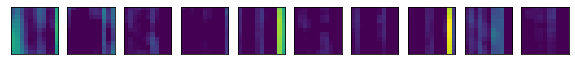

(1210, 200)


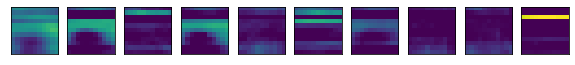

(1210, 200)


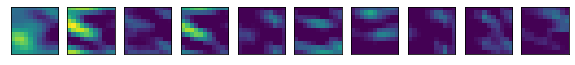

(1210, 200)


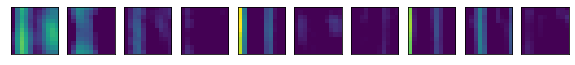

(1210, 200)


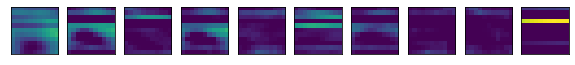

(1210, 200)


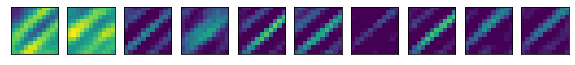

(1210, 200)


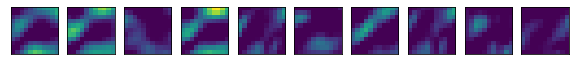

(1210, 200)


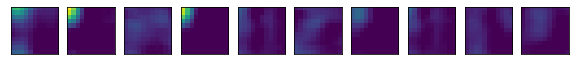

(1210, 200)


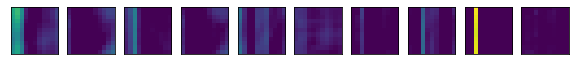

(1210, 200)


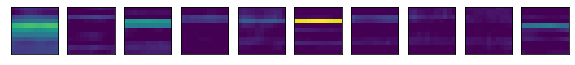

(1210, 200)


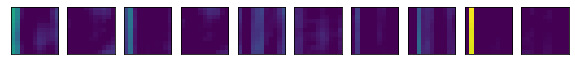

(1210, 200)


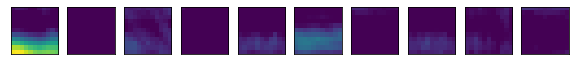

(1210, 200)


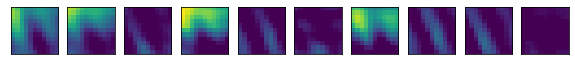

(1210, 200)


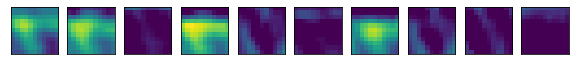

(1210, 200)


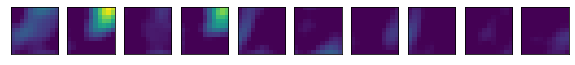

(1210, 200)


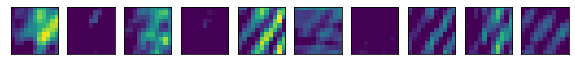

(1210, 200)


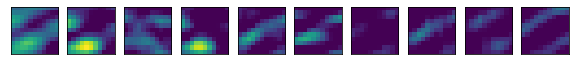

(1210, 200)


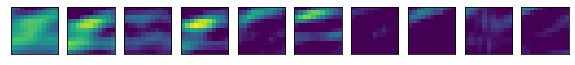

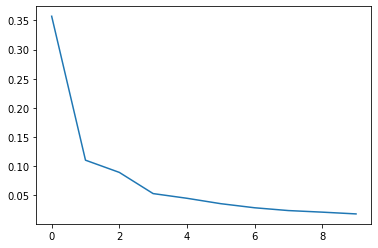

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



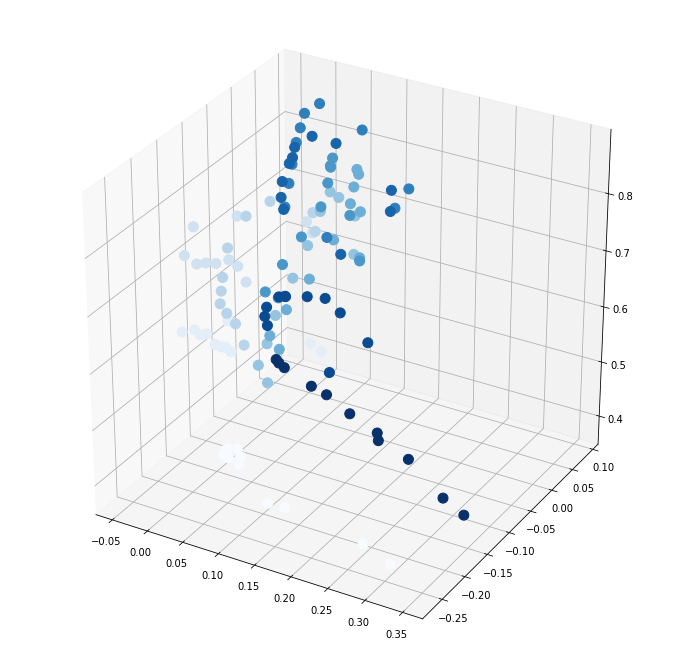

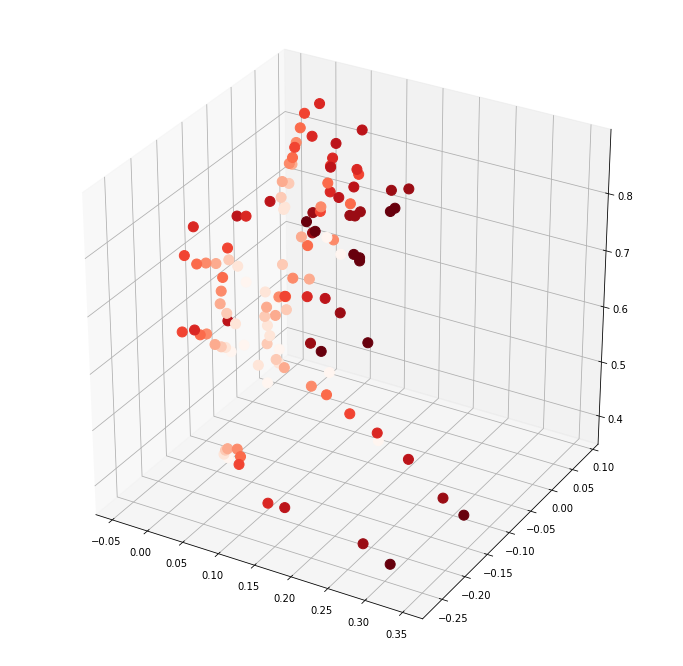

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

Rank-100 models:  min obj, 0.48;  max obj, 0.48;  time to fit, 65.8s


Rank-150 models:  min obj, 0.46;  max obj, 0.46;  time to fit, 108.1s


Rank-200 models:  min obj, 0.45;  max obj, 0.45;  time to fit, 229.0s


[0.4450435336731575]
[0.4781391588988063, 0.45905129211025647, 0.4450435336731575]
[100, 150, 200]


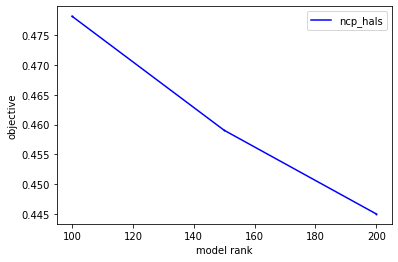

In [ ]:
ensembles_5 = get_tensor_factors(N_epoch5_max, ranks = [100,150,200])

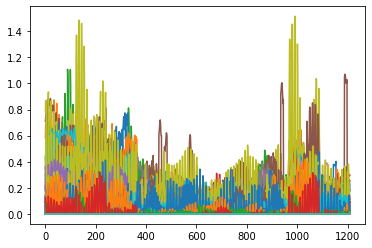

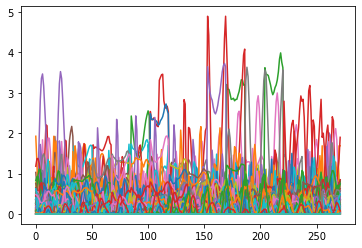

(1210, 200)


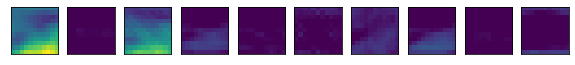

(1210, 200)


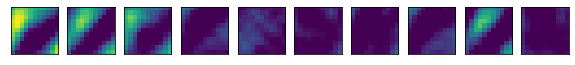

(1210, 200)


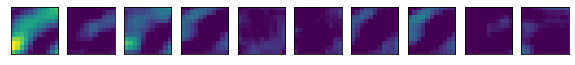

(1210, 200)


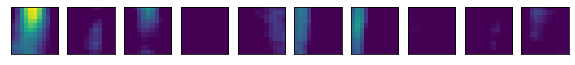

(1210, 200)


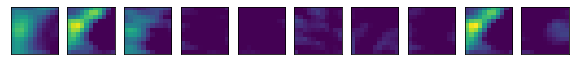

(1210, 200)


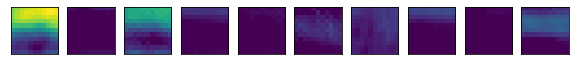

(1210, 200)


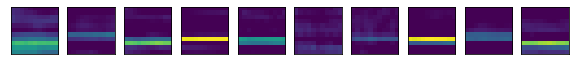

(1210, 200)


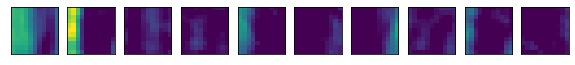

(1210, 200)


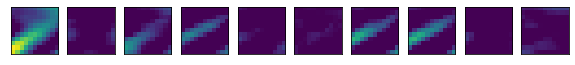

(1210, 200)


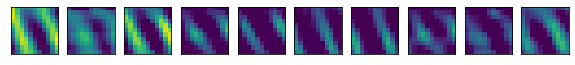

(1210, 200)


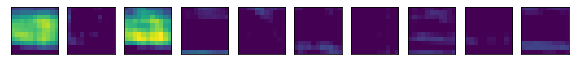

(1210, 200)


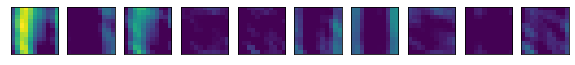

(1210, 200)


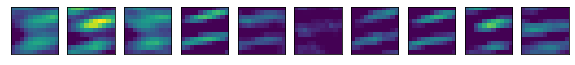

(1210, 200)


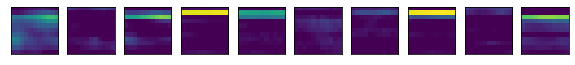

(1210, 200)


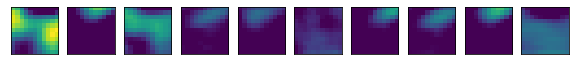

(1210, 200)


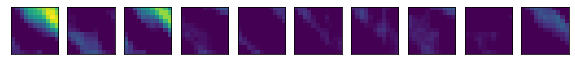

(1210, 200)


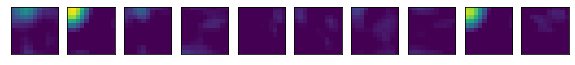

(1210, 200)


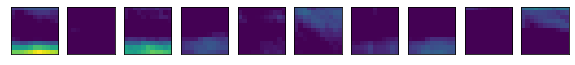

(1210, 200)


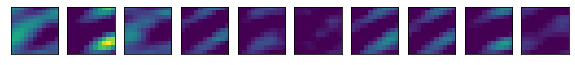

(1210, 200)


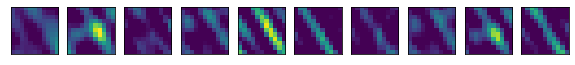

(1210, 200)


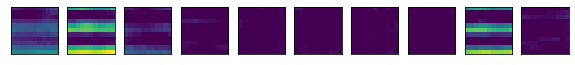

(1210, 200)


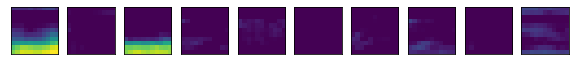

(1210, 200)


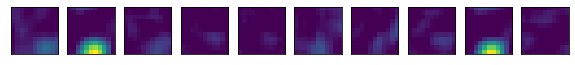

(1210, 200)


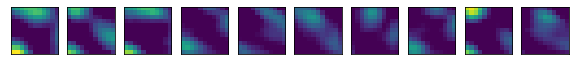

(1210, 200)


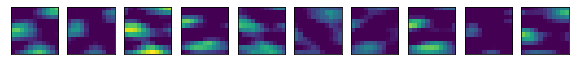

(1210, 200)


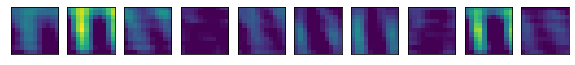

(1210, 200)


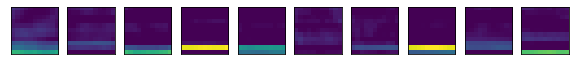

(1210, 200)


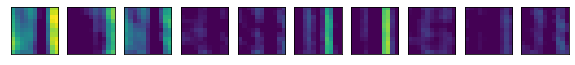

(1210, 200)


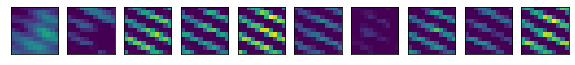

(1210, 200)


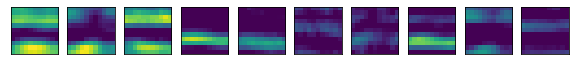

(1210, 200)


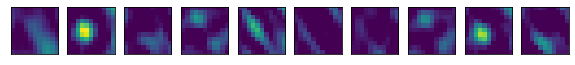

(1210, 200)


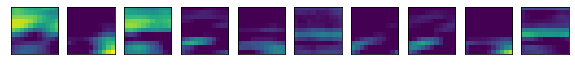

(1210, 200)


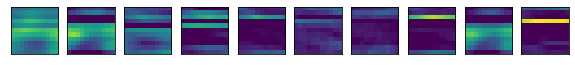

(1210, 200)


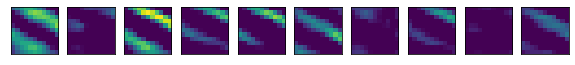

(1210, 200)


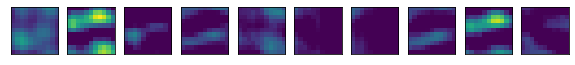

(1210, 200)


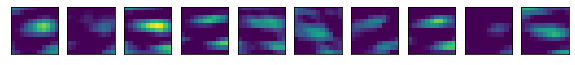

(1210, 200)


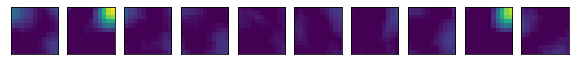

(1210, 200)


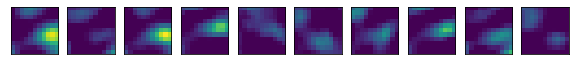

(1210, 200)


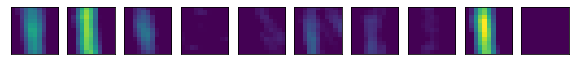

(1210, 200)


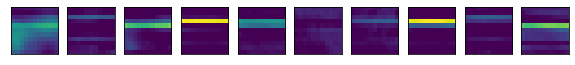

(1210, 200)


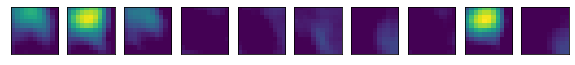

(1210, 200)


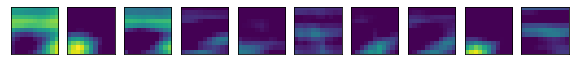

(1210, 200)


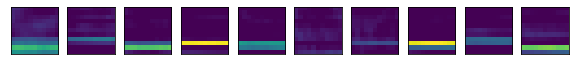

(1210, 200)


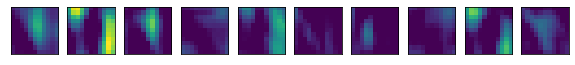

(1210, 200)


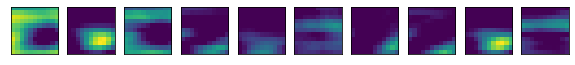

(1210, 200)


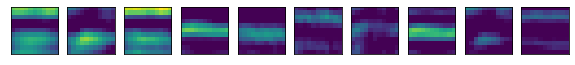

(1210, 200)


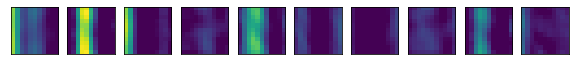

(1210, 200)


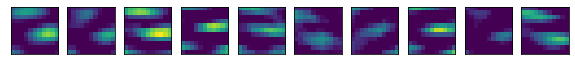

(1210, 200)


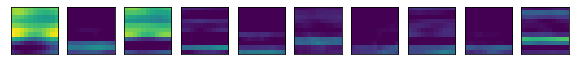

(1210, 200)


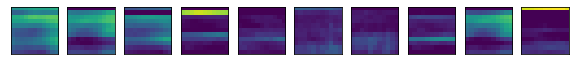

(1210, 200)


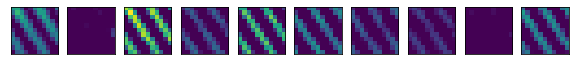

(1210, 200)


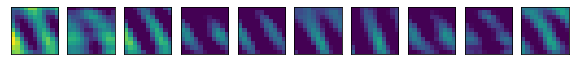

(1210, 200)


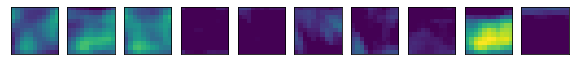

(1210, 200)


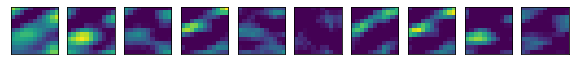

(1210, 200)


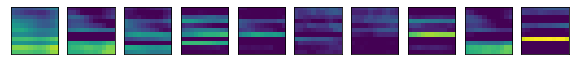

(1210, 200)


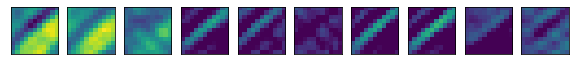

(1210, 200)


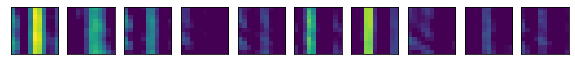

(1210, 200)


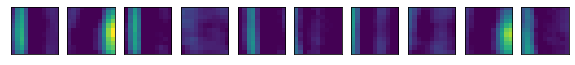

(1210, 200)


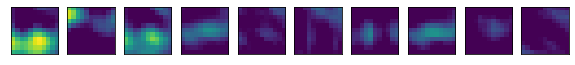

(1210, 200)


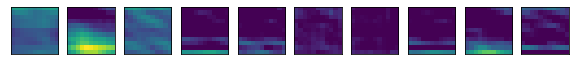

(1210, 200)


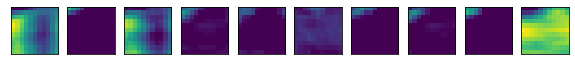

(1210, 200)


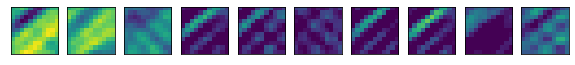

(1210, 200)


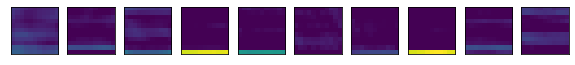

(1210, 200)


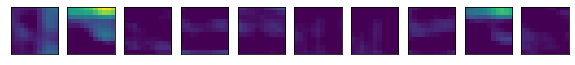

(1210, 200)


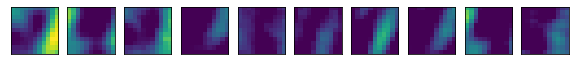

(1210, 200)


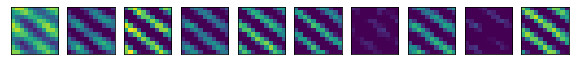

(1210, 200)


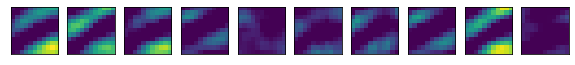

(1210, 200)


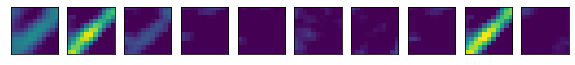

(1210, 200)


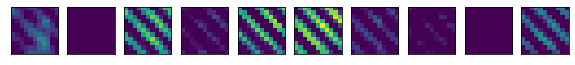

(1210, 200)


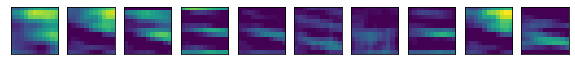

(1210, 200)


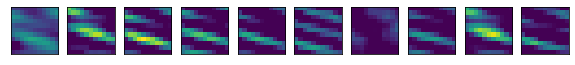

(1210, 200)


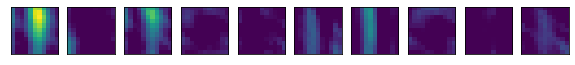

(1210, 200)


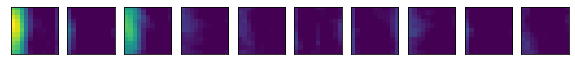

(1210, 200)


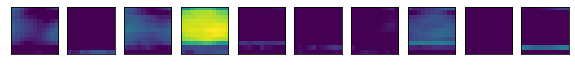

(1210, 200)


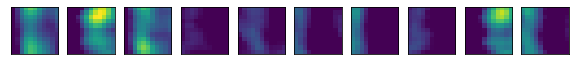

(1210, 200)


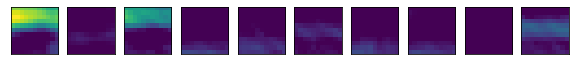

(1210, 200)


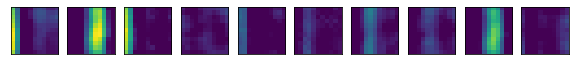

(1210, 200)


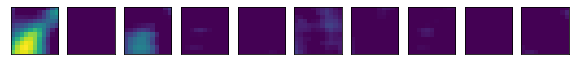

(1210, 200)


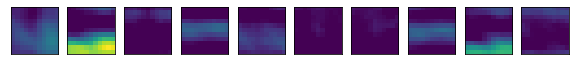

(1210, 200)


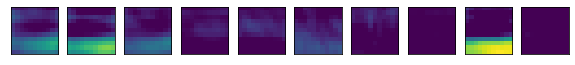

(1210, 200)


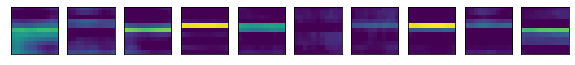

(1210, 200)


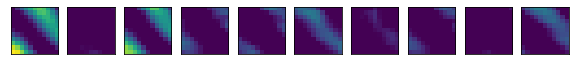

(1210, 200)


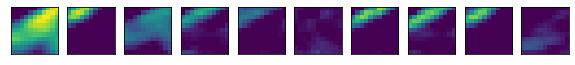

(1210, 200)


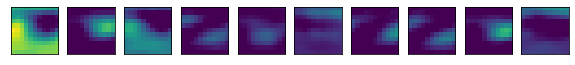

(1210, 200)


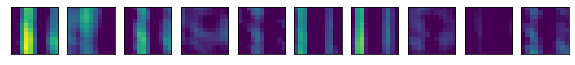

(1210, 200)


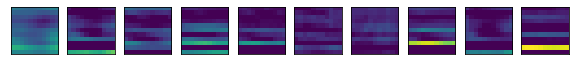

(1210, 200)


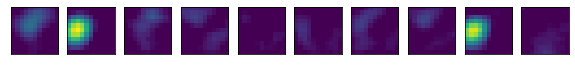

(1210, 200)


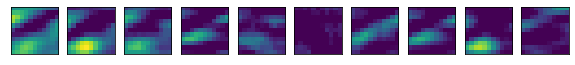

(1210, 200)


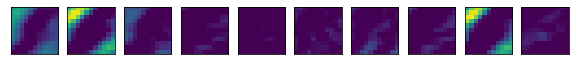

(1210, 200)


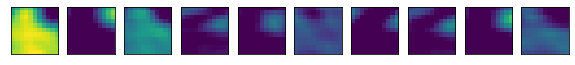

(1210, 200)


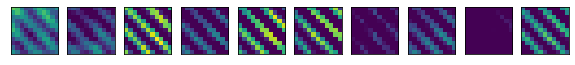

(1210, 200)


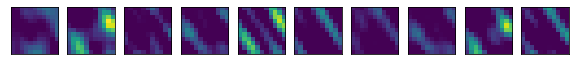

(1210, 200)


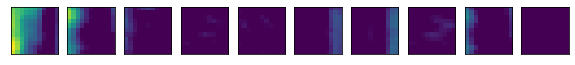

(1210, 200)


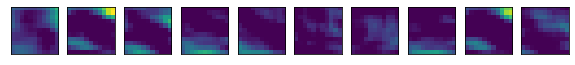

(1210, 200)


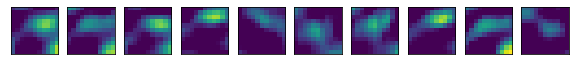

(1210, 200)


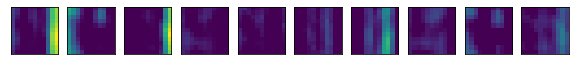

(1210, 200)


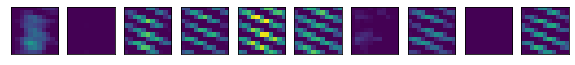

(1210, 200)


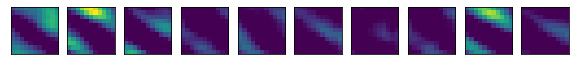

(1210, 200)


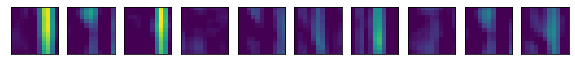

(1210, 200)


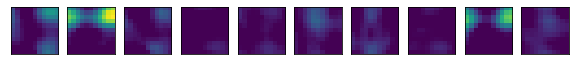

(1210, 200)


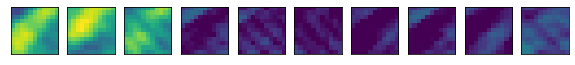

(1210, 200)


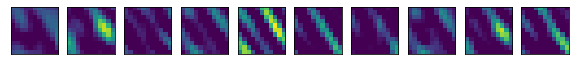

(1210, 200)


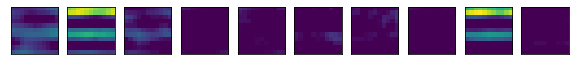

(1210, 200)


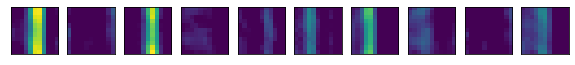

(1210, 200)


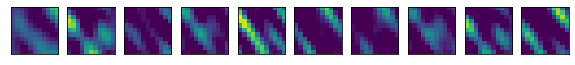

(1210, 200)


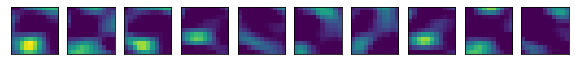

(1210, 200)


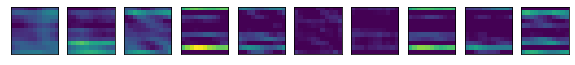

(1210, 200)


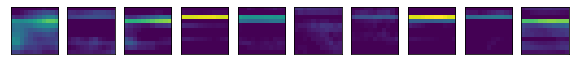

(1210, 200)


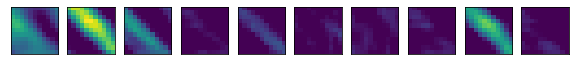

(1210, 200)


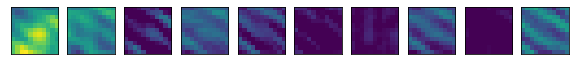

(1210, 200)


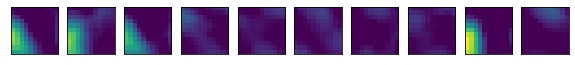

(1210, 200)


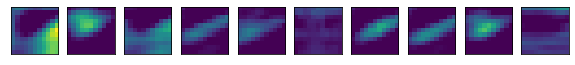

(1210, 200)


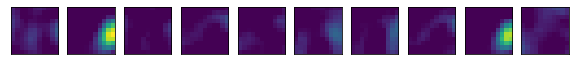

(1210, 200)


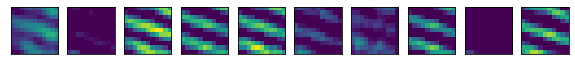

(1210, 200)


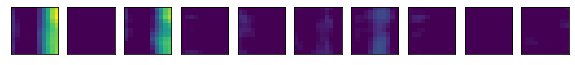

(1210, 200)


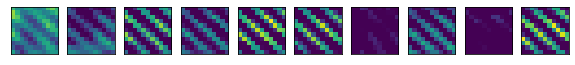

(1210, 200)


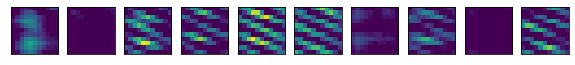

(1210, 200)


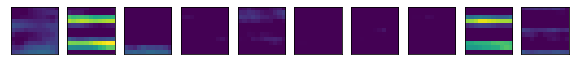

(1210, 200)


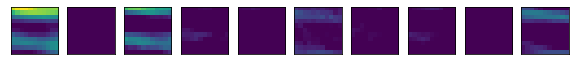

(1210, 200)


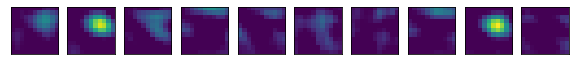

(1210, 200)


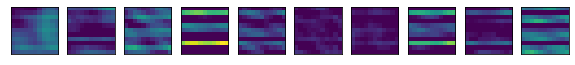

(1210, 200)


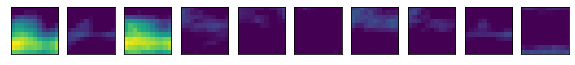

(1210, 200)


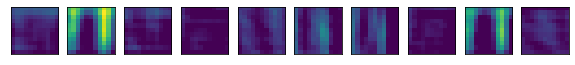

(1210, 200)


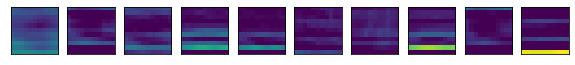

(1210, 200)


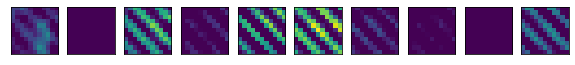

(1210, 200)


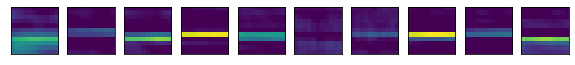

(1210, 200)


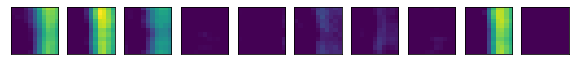

(1210, 200)


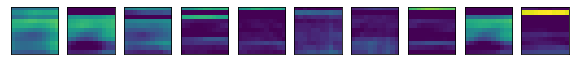

(1210, 200)


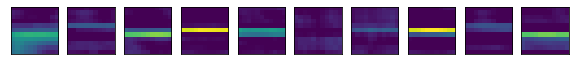

(1210, 200)


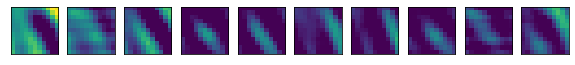

(1210, 200)


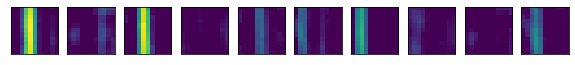

(1210, 200)


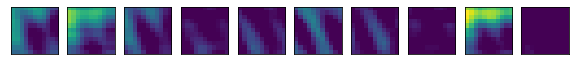

(1210, 200)


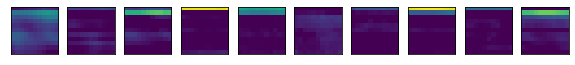

(1210, 200)


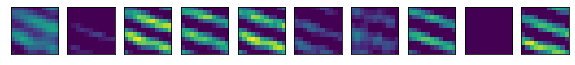

(1210, 200)


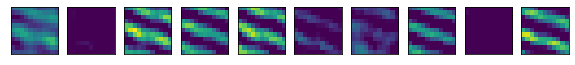

(1210, 200)


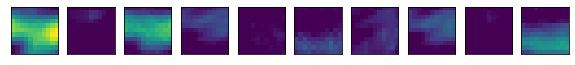

(1210, 200)


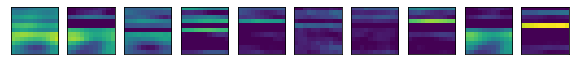

(1210, 200)


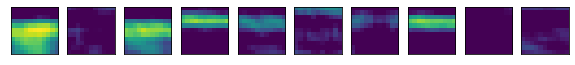

(1210, 200)


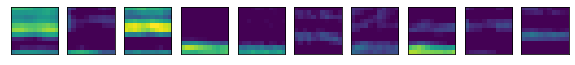

(1210, 200)


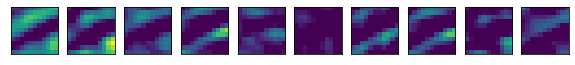

(1210, 200)


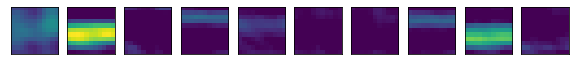

(1210, 200)


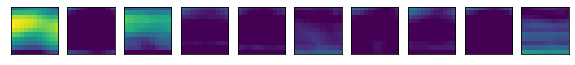

(1210, 200)


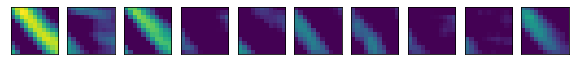

(1210, 200)


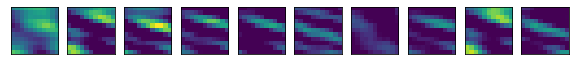

(1210, 200)


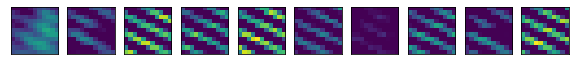

(1210, 200)


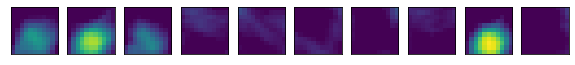

(1210, 200)


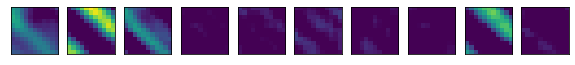

(1210, 200)


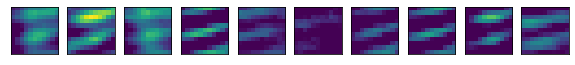

(1210, 200)


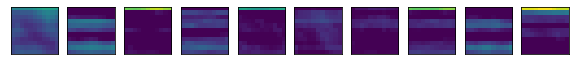

(1210, 200)


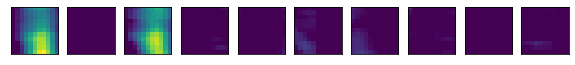

(1210, 200)


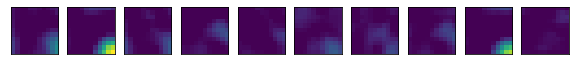

(1210, 200)


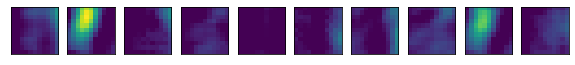

(1210, 200)


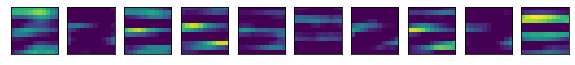

(1210, 200)


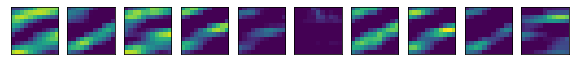

(1210, 200)


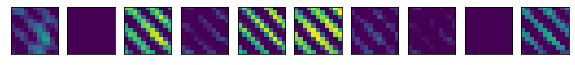

(1210, 200)


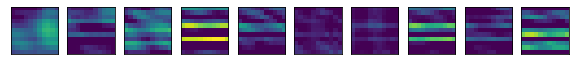

(1210, 200)


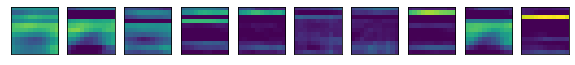

(1210, 200)


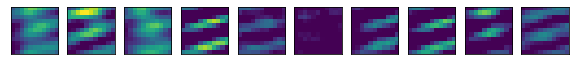

(1210, 200)


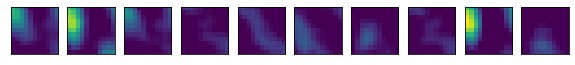

(1210, 200)


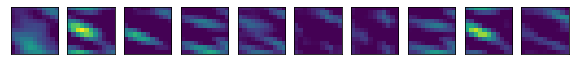

(1210, 200)


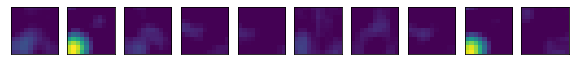

(1210, 200)


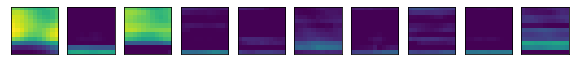

(1210, 200)


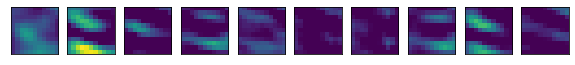

(1210, 200)


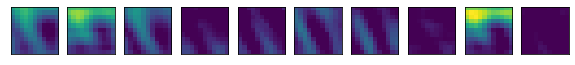

(1210, 200)


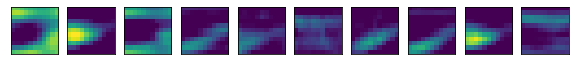

(1210, 200)


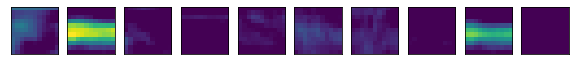

(1210, 200)


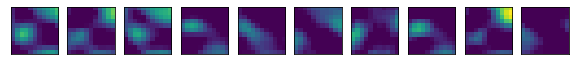

(1210, 200)


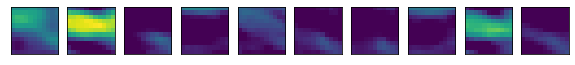

(1210, 200)


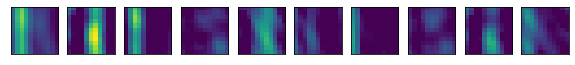

(1210, 200)


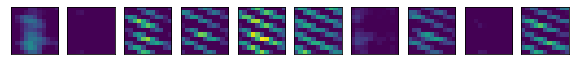

(1210, 200)


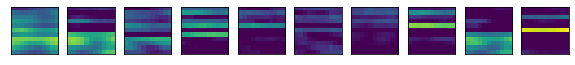

(1210, 200)


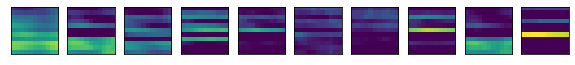

(1210, 200)


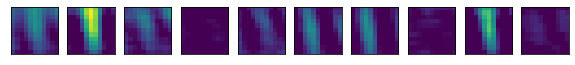

(1210, 200)


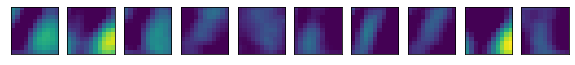

(1210, 200)


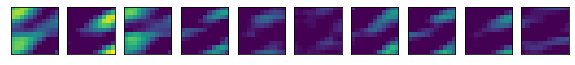

(1210, 200)


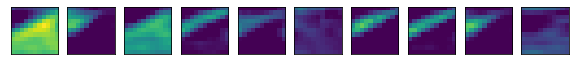

(1210, 200)


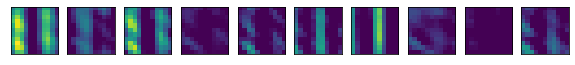

(1210, 200)


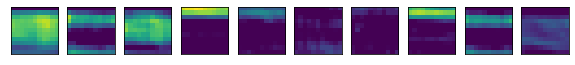

(1210, 200)


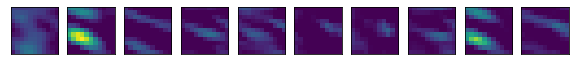

(1210, 200)


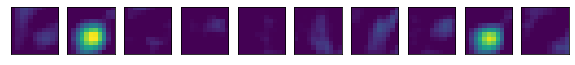

(1210, 200)


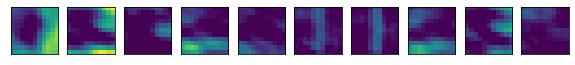

(1210, 200)


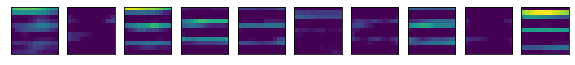

(1210, 200)


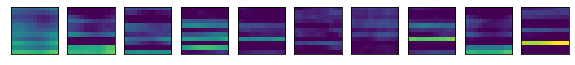

(1210, 200)


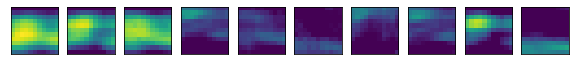

(1210, 200)


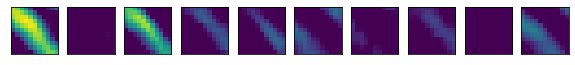

(1210, 200)


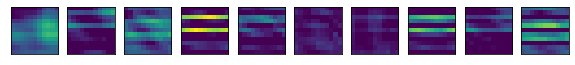

(1210, 200)


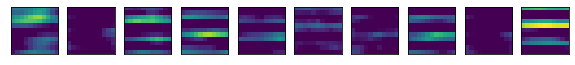

(1210, 200)


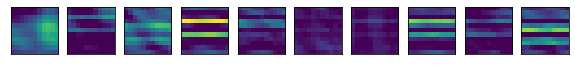

(1210, 200)


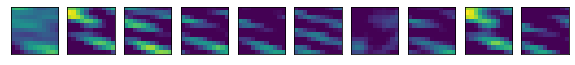

(1210, 200)


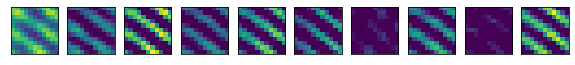

(1210, 200)


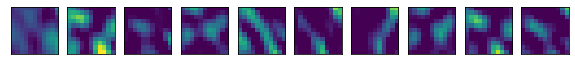

(1210, 200)


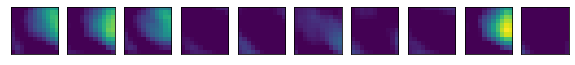

(1210, 200)


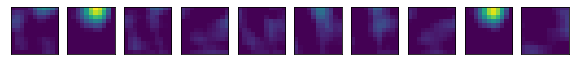

(1210, 200)


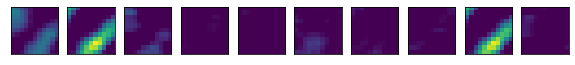

(1210, 200)


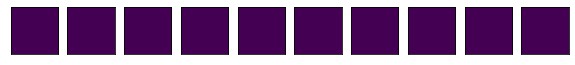

(1210, 200)


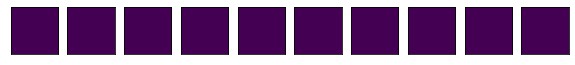

(1210, 200)


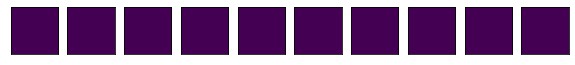

(1210, 200)


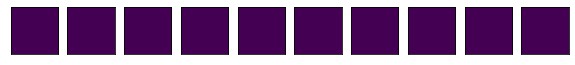

(1210, 200)


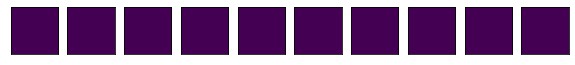

(1210, 200)


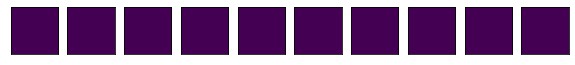

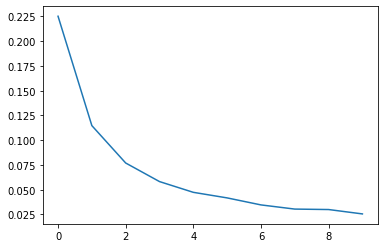

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



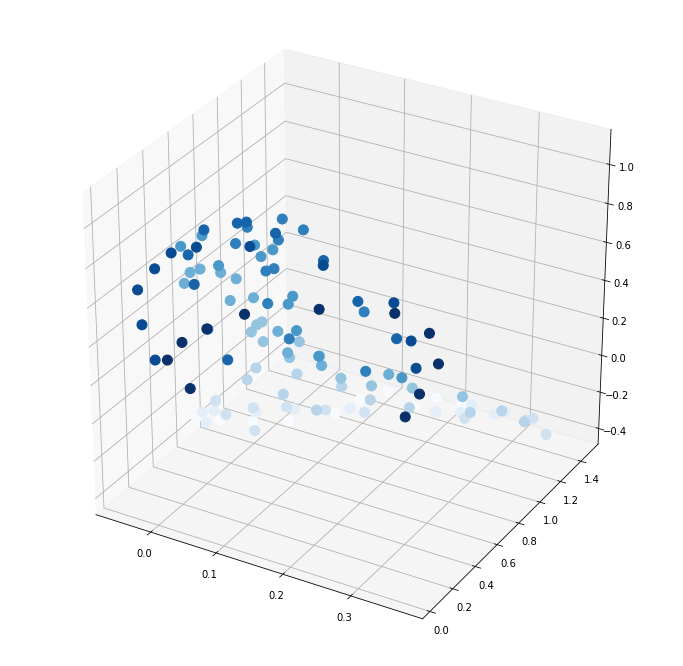

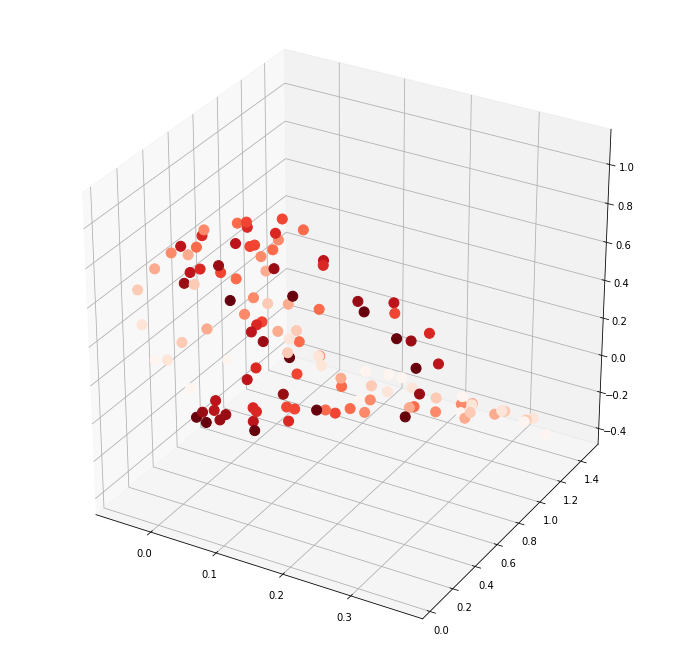

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_5['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

## For 3D epoch 7 fix:

Rank-100 models:  min obj, 0.53;  max obj, 0.53;  time to fit, 62.8s


Rank-150 models:  min obj, 0.51;  max obj, 0.51;  time to fit, 124.0s


Rank-200 models:  min obj, 0.50;  max obj, 0.50;  time to fit, 144.2s


[0.49885622329584633]
[0.5341957648544635, 0.5149894540654201, 0.49885622329584633]
[100, 150, 200]


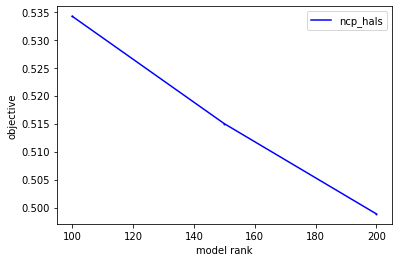

In [ ]:
ensembles_7 = get_tensor_factors(N_epoch7_fix, ranks = [100,150,200])

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_7}
mdic
savemat("ensembles_7.mat", mdic)

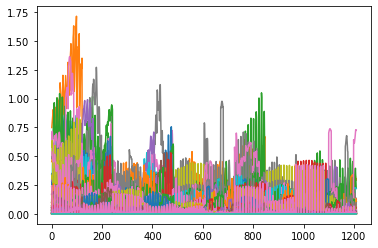

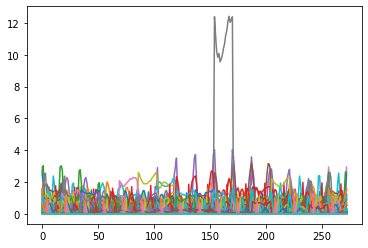

(1210, 200)


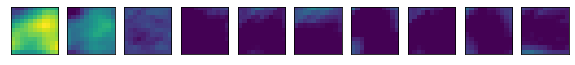

(1210, 200)


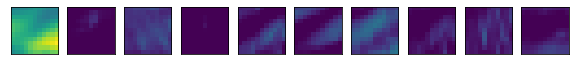

(1210, 200)


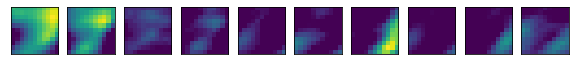

(1210, 200)


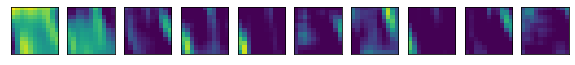

(1210, 200)


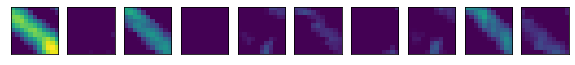

(1210, 200)


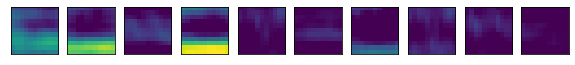

(1210, 200)


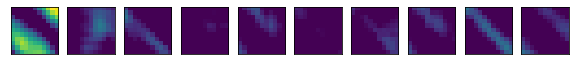

(1210, 200)


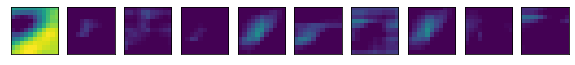

(1210, 200)


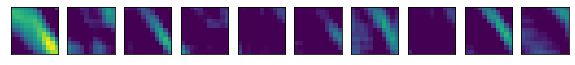

(1210, 200)


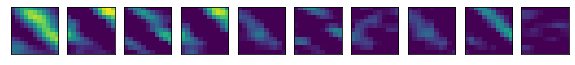

(1210, 200)


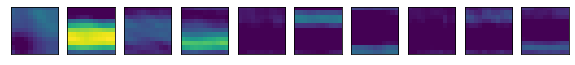

(1210, 200)


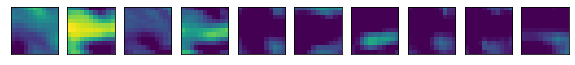

(1210, 200)


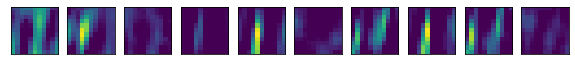

(1210, 200)


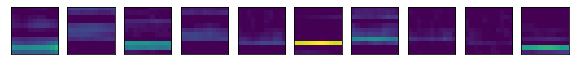

(1210, 200)


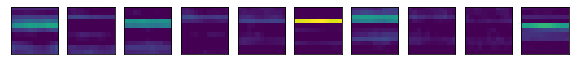

(1210, 200)


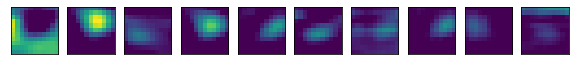

(1210, 200)


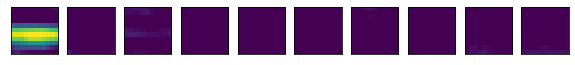

(1210, 200)


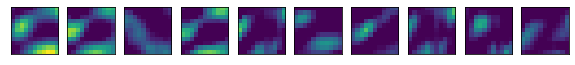

(1210, 200)


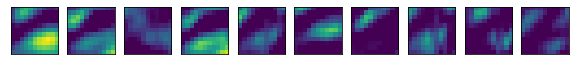

(1210, 200)


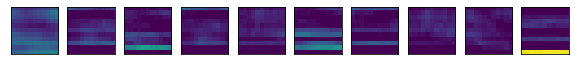

(1210, 200)


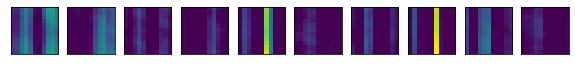

(1210, 200)


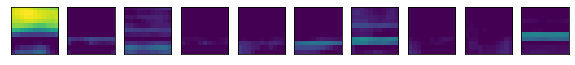

(1210, 200)


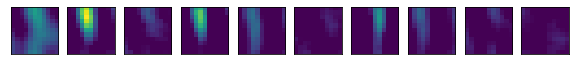

(1210, 200)


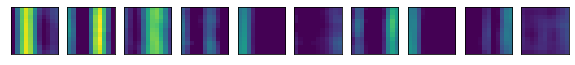

(1210, 200)


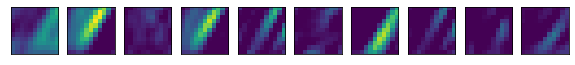

(1210, 200)


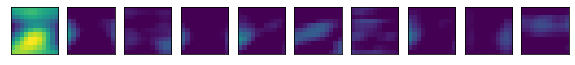

(1210, 200)


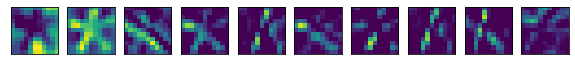

(1210, 200)


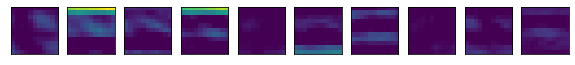

(1210, 200)


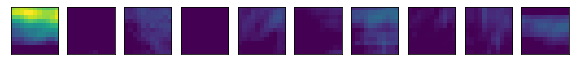

(1210, 200)


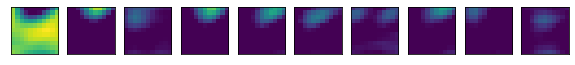

(1210, 200)


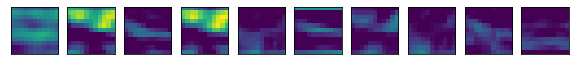

(1210, 200)


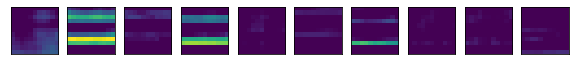

(1210, 200)


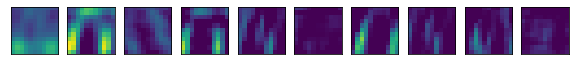

(1210, 200)


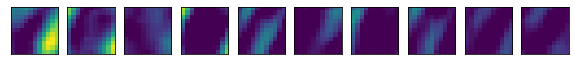

(1210, 200)


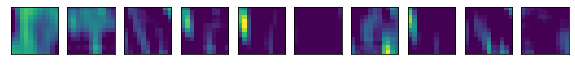

(1210, 200)


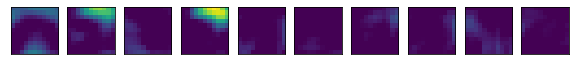

(1210, 200)


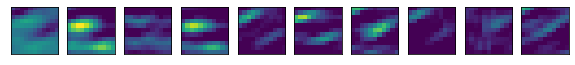

(1210, 200)


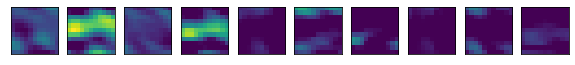

(1210, 200)


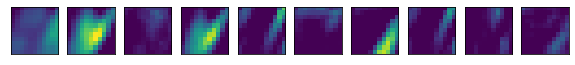

(1210, 200)


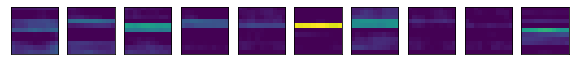

(1210, 200)


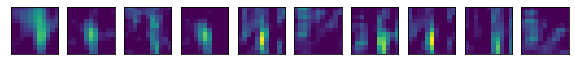

(1210, 200)


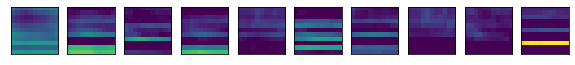

(1210, 200)


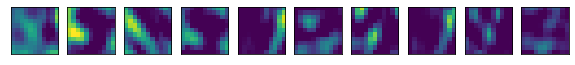

(1210, 200)


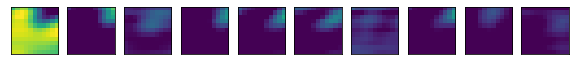

(1210, 200)


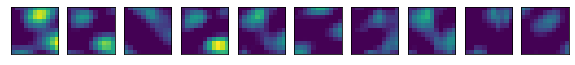

(1210, 200)


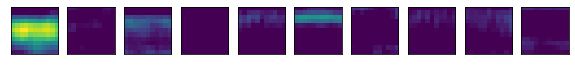

(1210, 200)


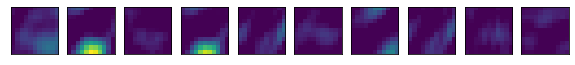

(1210, 200)


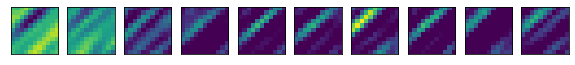

(1210, 200)


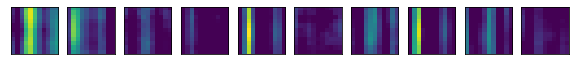

(1210, 200)


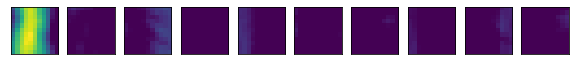

(1210, 200)


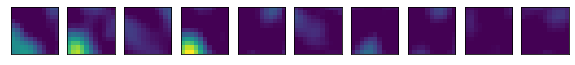

(1210, 200)


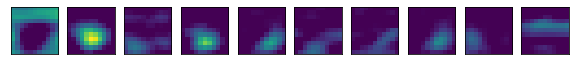

(1210, 200)


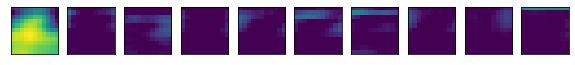

(1210, 200)


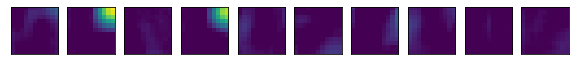

(1210, 200)


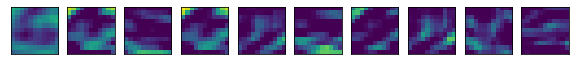

(1210, 200)


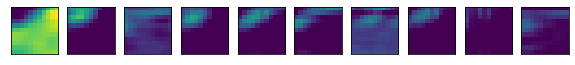

(1210, 200)


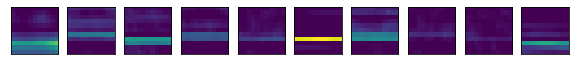

(1210, 200)


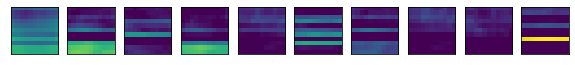

(1210, 200)


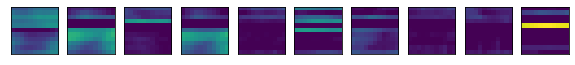

(1210, 200)


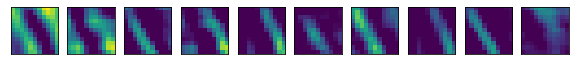

(1210, 200)


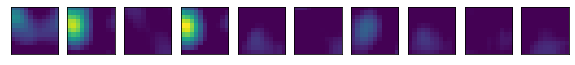

(1210, 200)


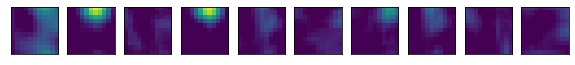

(1210, 200)


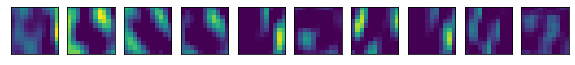

(1210, 200)


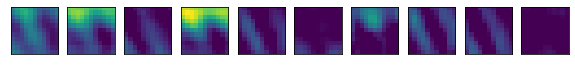

(1210, 200)


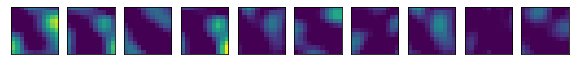

(1210, 200)


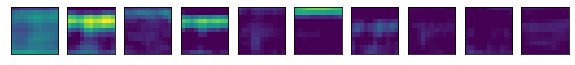

(1210, 200)


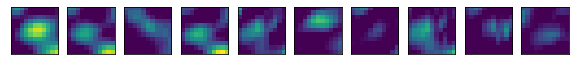

(1210, 200)


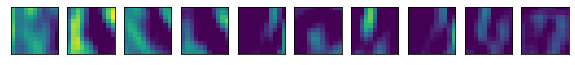

(1210, 200)


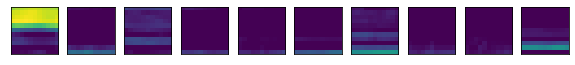

(1210, 200)


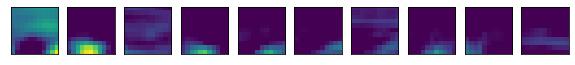

(1210, 200)


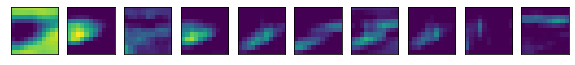

(1210, 200)


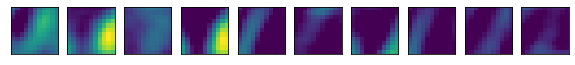

(1210, 200)


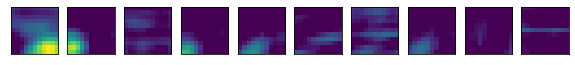

(1210, 200)


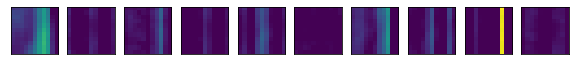

(1210, 200)


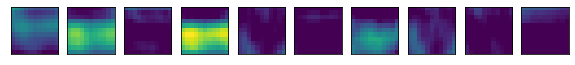

(1210, 200)


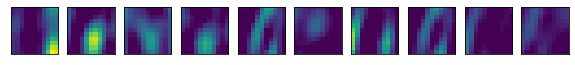

(1210, 200)


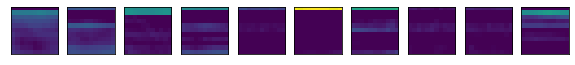

(1210, 200)


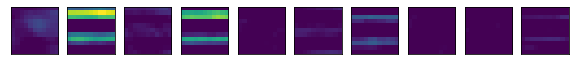

(1210, 200)


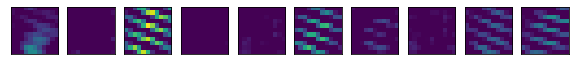

(1210, 200)


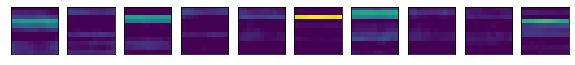

(1210, 200)


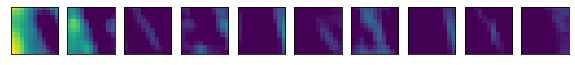

(1210, 200)


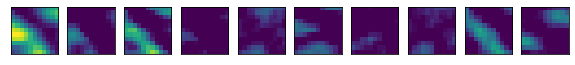

(1210, 200)


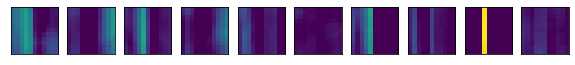

(1210, 200)


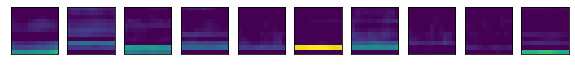

(1210, 200)


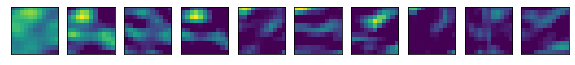

(1210, 200)


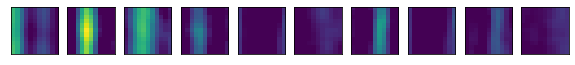

(1210, 200)


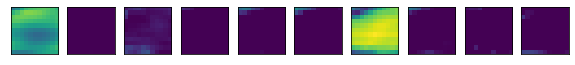

(1210, 200)


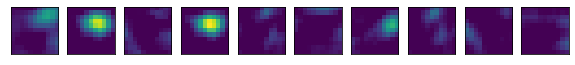

(1210, 200)


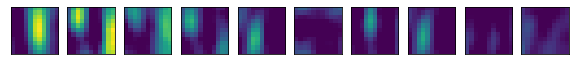

(1210, 200)


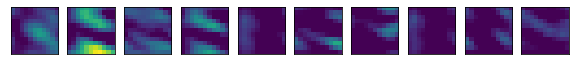

(1210, 200)


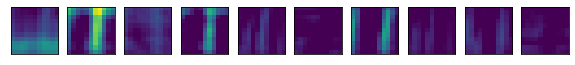

(1210, 200)


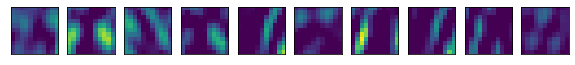

(1210, 200)


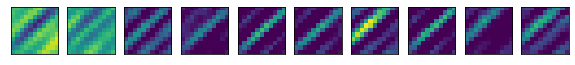

(1210, 200)


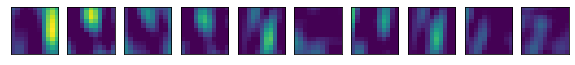

(1210, 200)


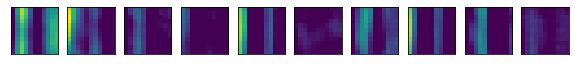

(1210, 200)


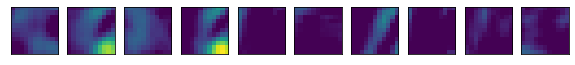

(1210, 200)


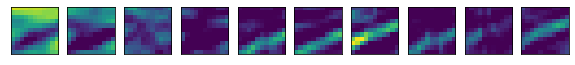

(1210, 200)


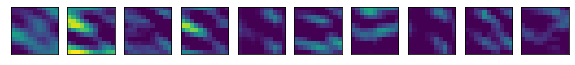

(1210, 200)


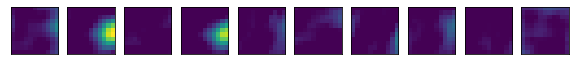

(1210, 200)


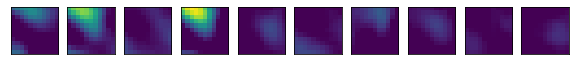

(1210, 200)


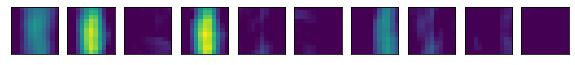

(1210, 200)


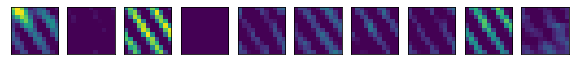

(1210, 200)


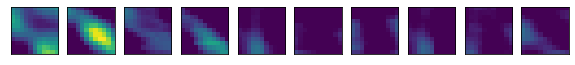

(1210, 200)


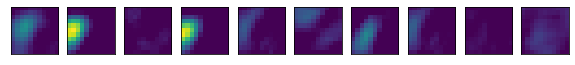

(1210, 200)


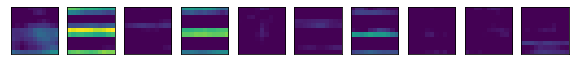

(1210, 200)


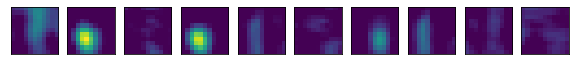

(1210, 200)


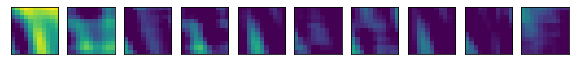

(1210, 200)


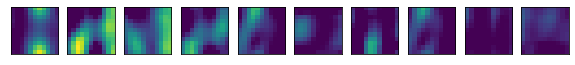

(1210, 200)


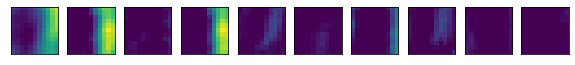

(1210, 200)


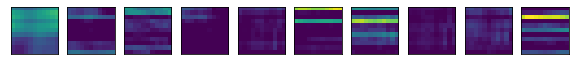

(1210, 200)


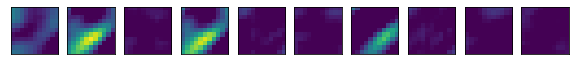

(1210, 200)


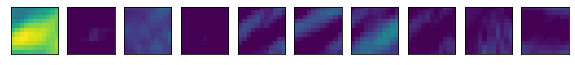

(1210, 200)


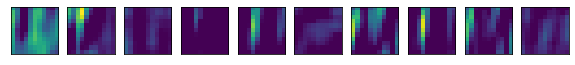

(1210, 200)


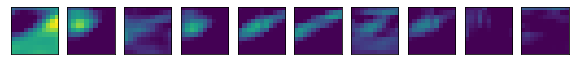

(1210, 200)


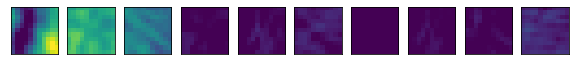

(1210, 200)


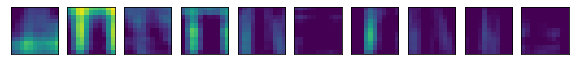

(1210, 200)


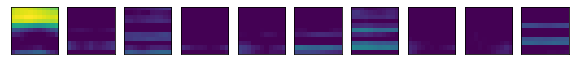

(1210, 200)


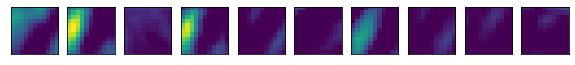

(1210, 200)


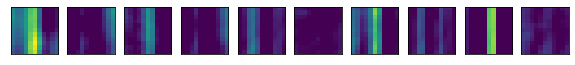

(1210, 200)


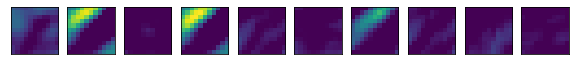

(1210, 200)


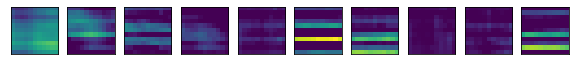

(1210, 200)


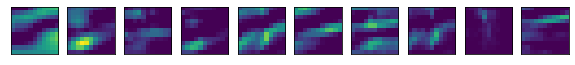

(1210, 200)


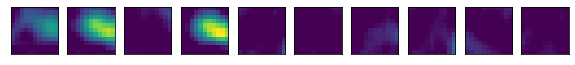

(1210, 200)


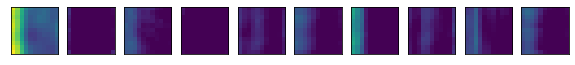

(1210, 200)


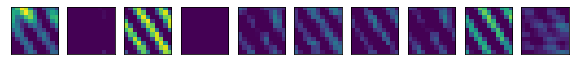

(1210, 200)


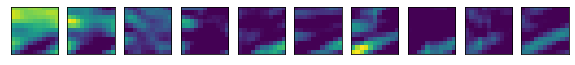

(1210, 200)


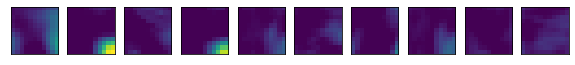

(1210, 200)


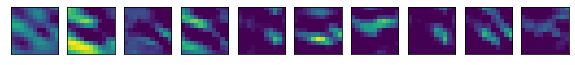

(1210, 200)


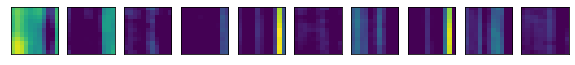

(1210, 200)


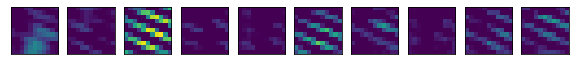

(1210, 200)


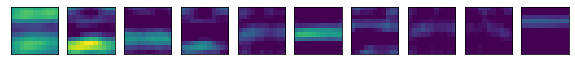

(1210, 200)


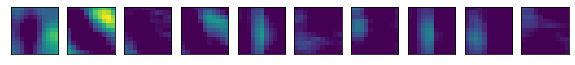

(1210, 200)


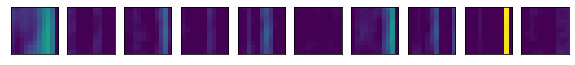

(1210, 200)


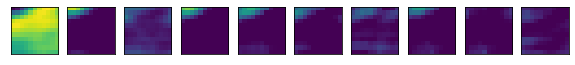

(1210, 200)


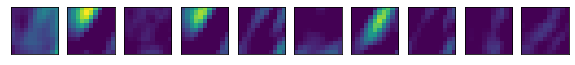

(1210, 200)


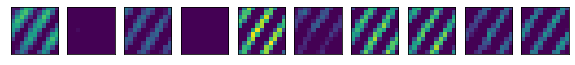

(1210, 200)


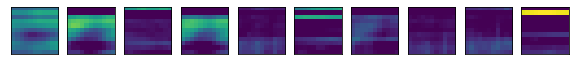

(1210, 200)


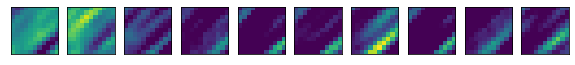

(1210, 200)


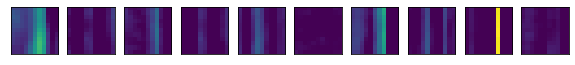

(1210, 200)


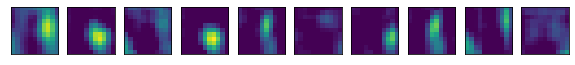

(1210, 200)


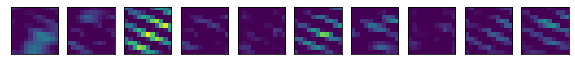

(1210, 200)


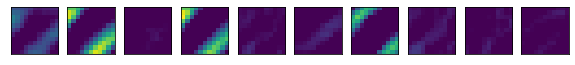

(1210, 200)


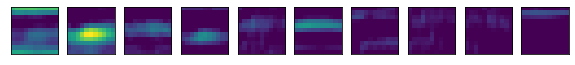

(1210, 200)


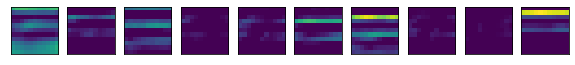

(1210, 200)


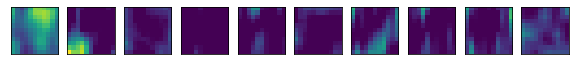

(1210, 200)


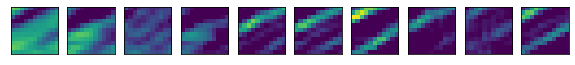

(1210, 200)


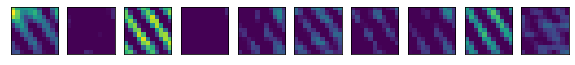

(1210, 200)


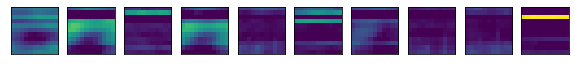

(1210, 200)


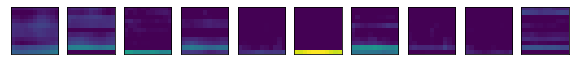

(1210, 200)


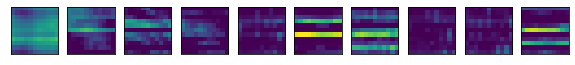

(1210, 200)


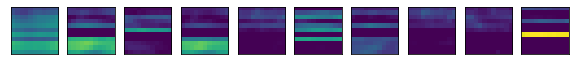

(1210, 200)


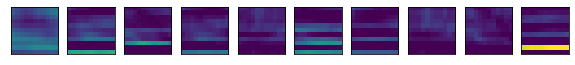

(1210, 200)


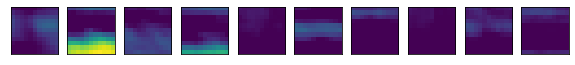

(1210, 200)


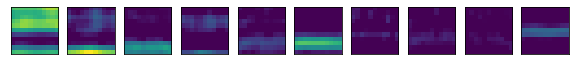

(1210, 200)


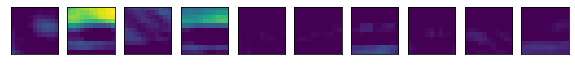

(1210, 200)


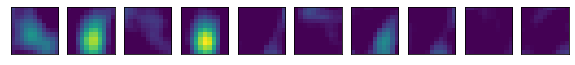

(1210, 200)


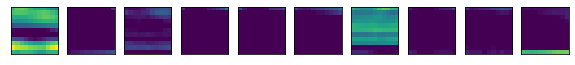

(1210, 200)


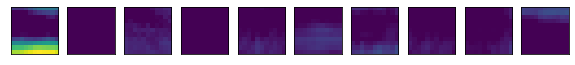

(1210, 200)


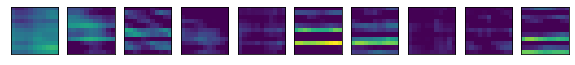

(1210, 200)


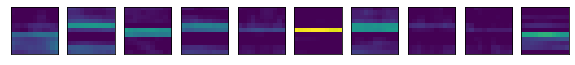

(1210, 200)


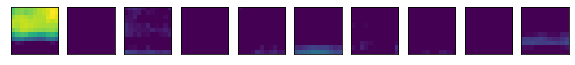

(1210, 200)


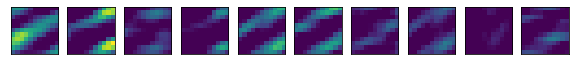

(1210, 200)


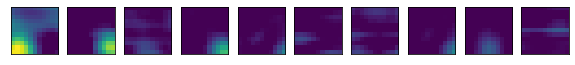

(1210, 200)


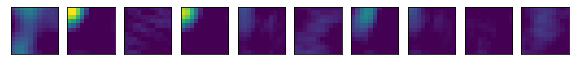

(1210, 200)


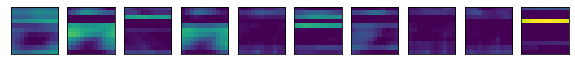

(1210, 200)


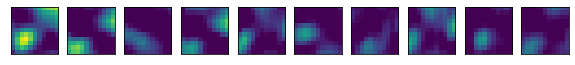

(1210, 200)


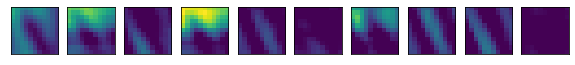

(1210, 200)


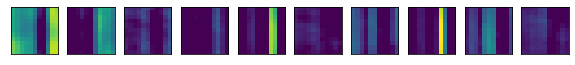

(1210, 200)


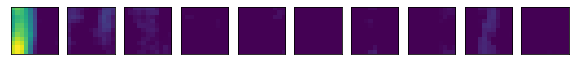

(1210, 200)


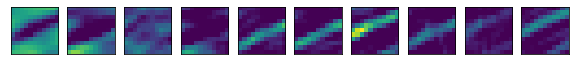

(1210, 200)


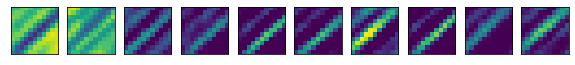

(1210, 200)


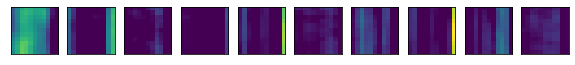

(1210, 200)


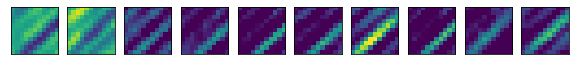

(1210, 200)


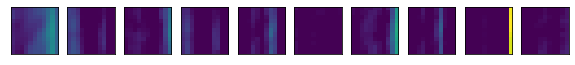

(1210, 200)


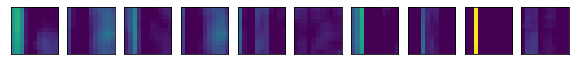

(1210, 200)


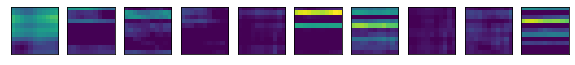

(1210, 200)


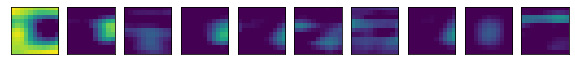

(1210, 200)


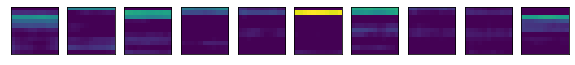

(1210, 200)


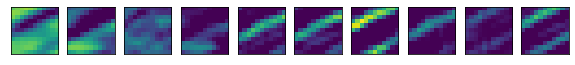

(1210, 200)


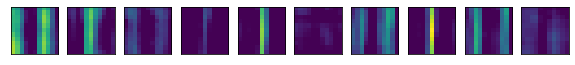

(1210, 200)


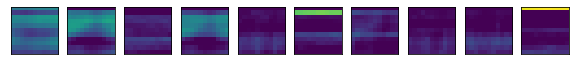

(1210, 200)


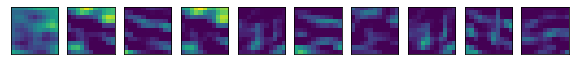

(1210, 200)


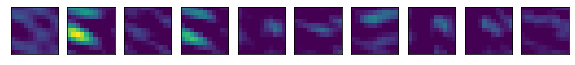

(1210, 200)


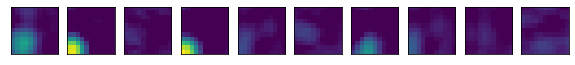

(1210, 200)


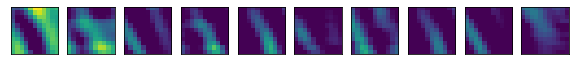

(1210, 200)


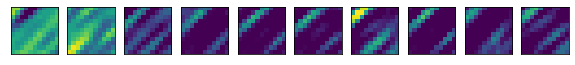

(1210, 200)


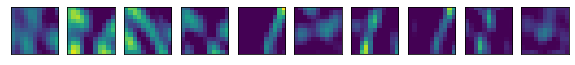

(1210, 200)


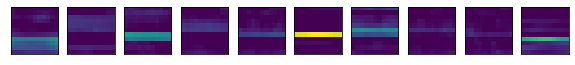

(1210, 200)


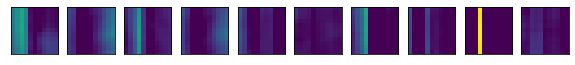

(1210, 200)


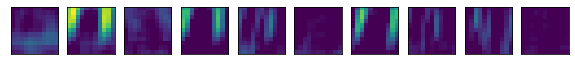

(1210, 200)


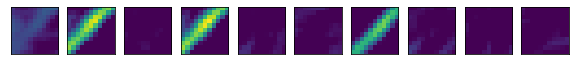

(1210, 200)


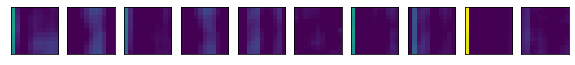

(1210, 200)


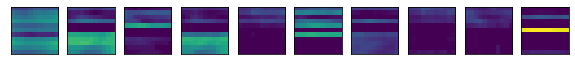

(1210, 200)


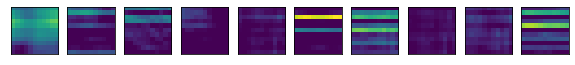

(1210, 200)


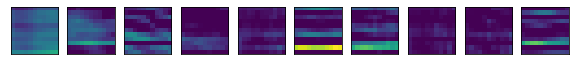

(1210, 200)


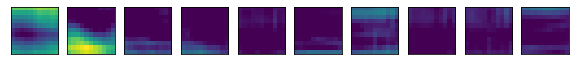

(1210, 200)


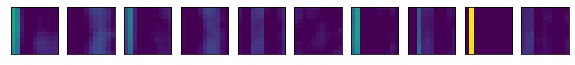

(1210, 200)


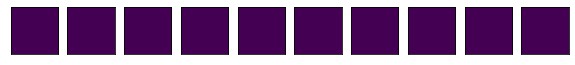

(1210, 200)


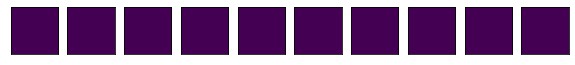

(1210, 200)


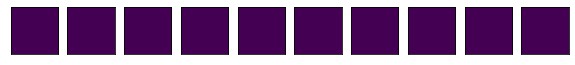

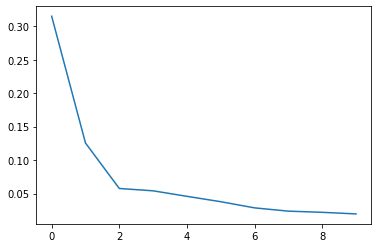

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



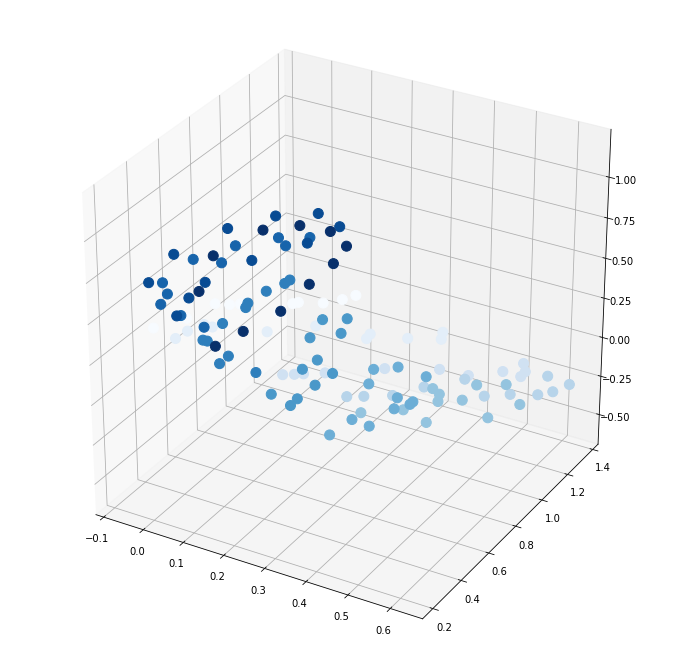

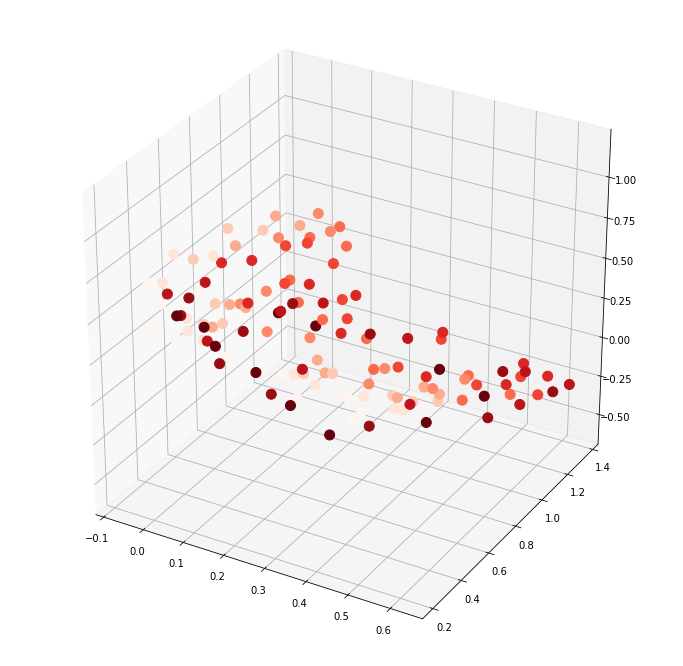

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_7['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

Rank-100 models:  min obj, 0.51;  max obj, 0.51;  time to fit, 117.1s


Rank-150 models:  min obj, 0.49;  max obj, 0.49;  time to fit, 102.5s


Rank-200 models:  min obj, 0.48;  max obj, 0.48;  time to fit, 203.1s


[0.4766391760798005]
[0.5111505565560156, 0.49227686977728635, 0.4766391760798005]
[100, 150, 200]


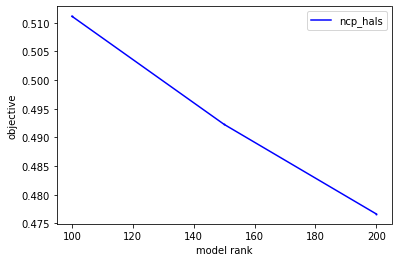

In [ ]:
ensembles_7 = get_tensor_factors(N_epoch7_max, ranks = [100,150,200])

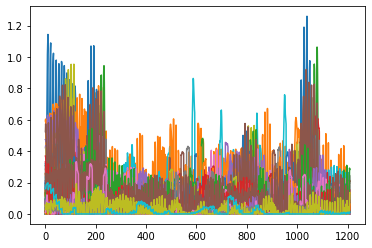

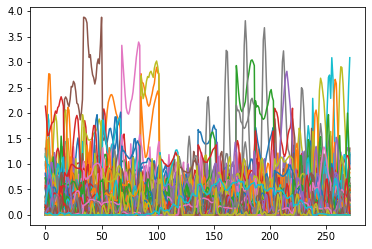

(1210, 200)


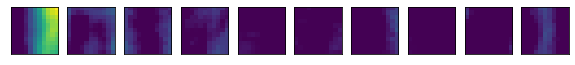

(1210, 200)


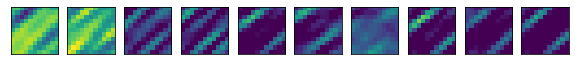

(1210, 200)


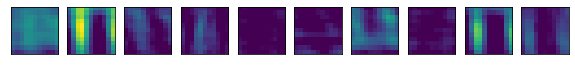

(1210, 200)


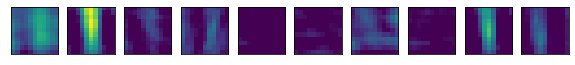

(1210, 200)


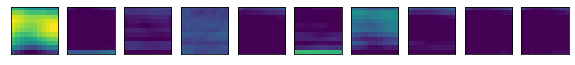

(1210, 200)


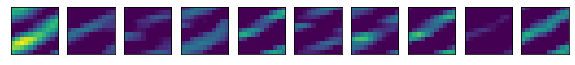

(1210, 200)


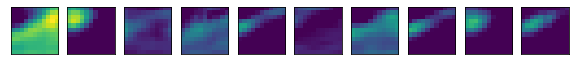

(1210, 200)


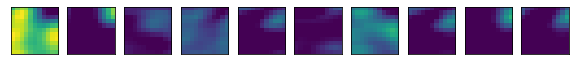

(1210, 200)


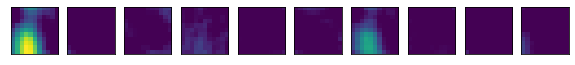

(1210, 200)


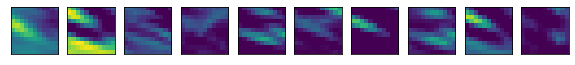

(1210, 200)


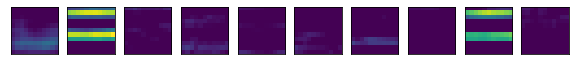

(1210, 200)


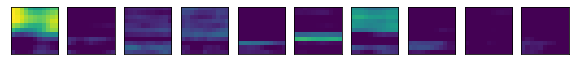

(1210, 200)


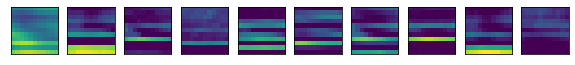

(1210, 200)


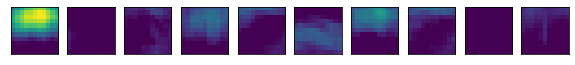

(1210, 200)


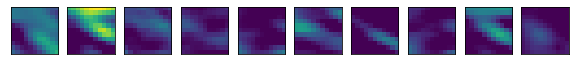

(1210, 200)


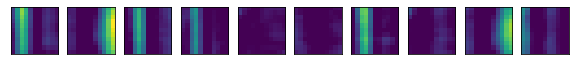

(1210, 200)


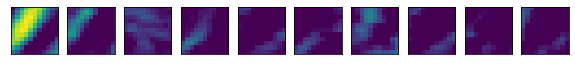

(1210, 200)


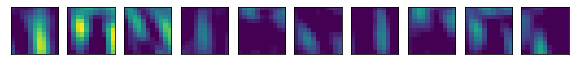

(1210, 200)


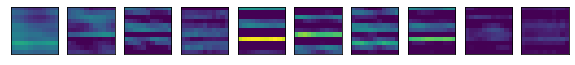

(1210, 200)


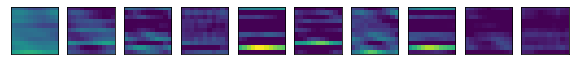

(1210, 200)


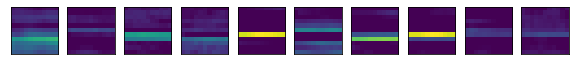

(1210, 200)


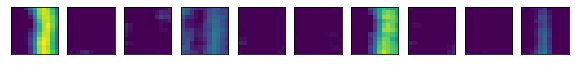

(1210, 200)


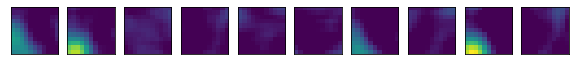

(1210, 200)


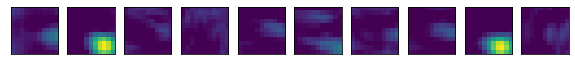

(1210, 200)


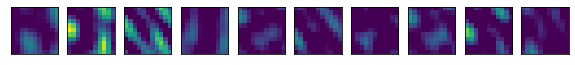

(1210, 200)


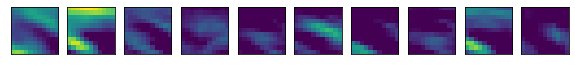

(1210, 200)


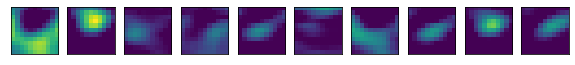

(1210, 200)


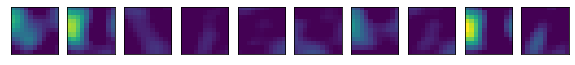

(1210, 200)


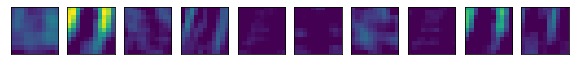

(1210, 200)


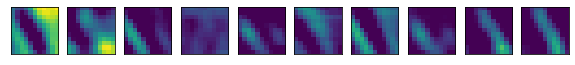

(1210, 200)


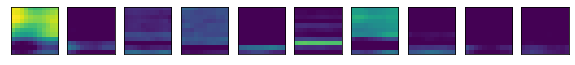

(1210, 200)


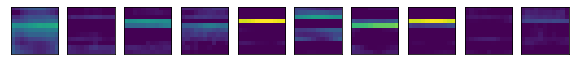

(1210, 200)


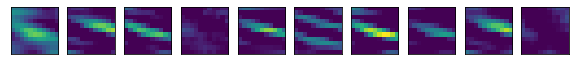

(1210, 200)


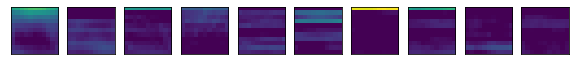

(1210, 200)


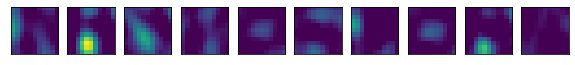

(1210, 200)


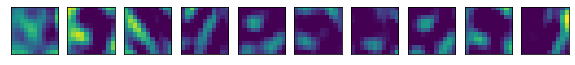

(1210, 200)


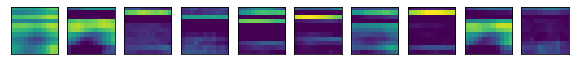

(1210, 200)


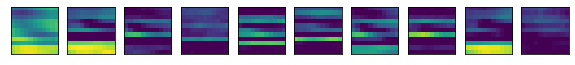

(1210, 200)


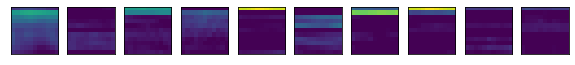

(1210, 200)


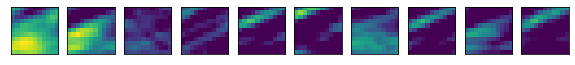

(1210, 200)


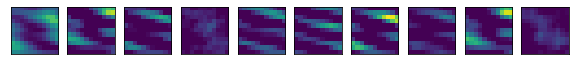

(1210, 200)


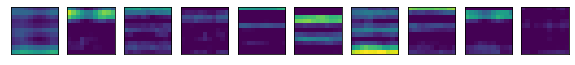

(1210, 200)


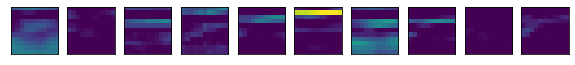

(1210, 200)


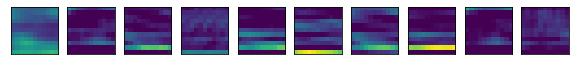

(1210, 200)


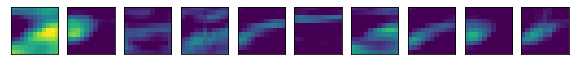

(1210, 200)


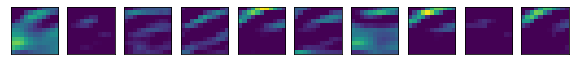

(1210, 200)


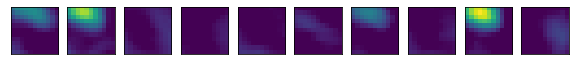

(1210, 200)


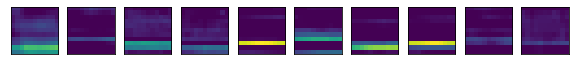

(1210, 200)


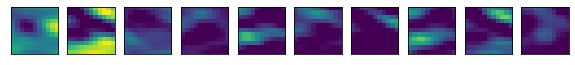

(1210, 200)


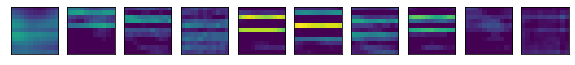

(1210, 200)


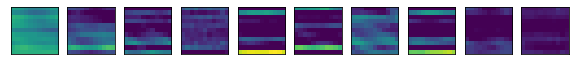

(1210, 200)


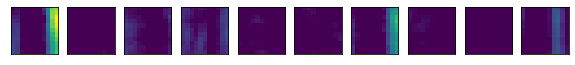

(1210, 200)


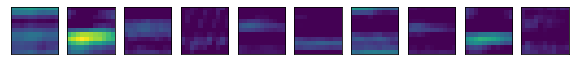

(1210, 200)


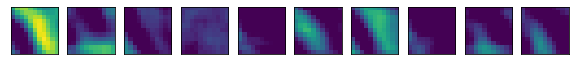

(1210, 200)


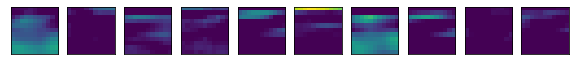

(1210, 200)


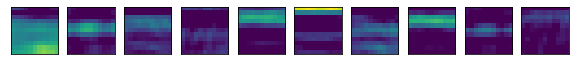

(1210, 200)


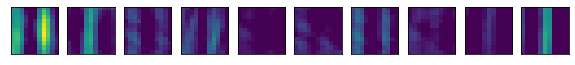

(1210, 200)


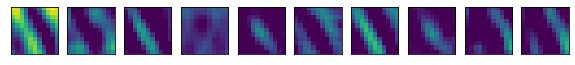

(1210, 200)


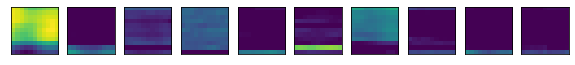

(1210, 200)


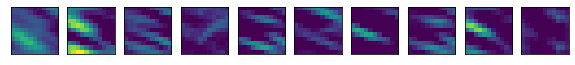

(1210, 200)


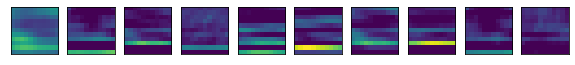

(1210, 200)


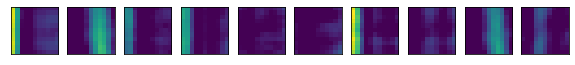

(1210, 200)


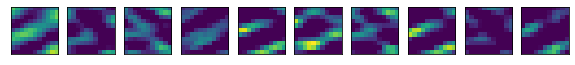

(1210, 200)


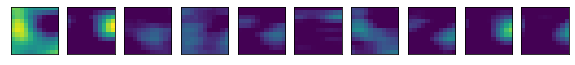

(1210, 200)


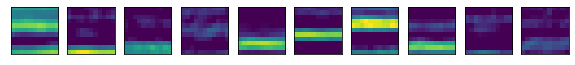

(1210, 200)


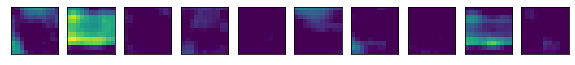

(1210, 200)


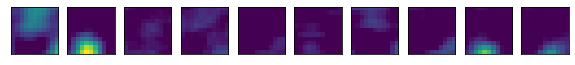

(1210, 200)


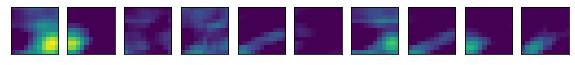

(1210, 200)


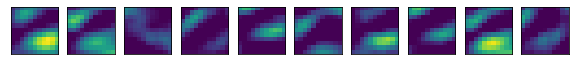

(1210, 200)


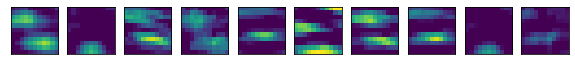

(1210, 200)


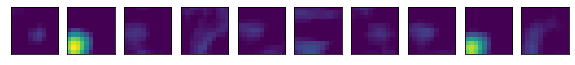

(1210, 200)


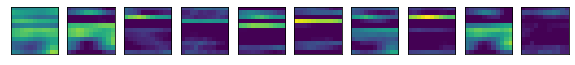

(1210, 200)


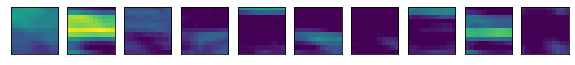

(1210, 200)


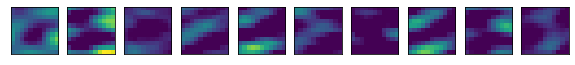

(1210, 200)


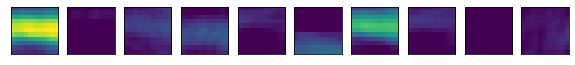

(1210, 200)


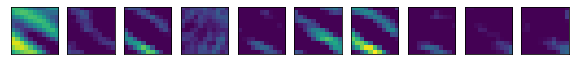

(1210, 200)


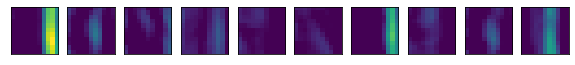

(1210, 200)


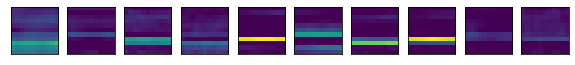

(1210, 200)


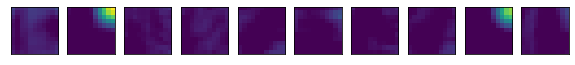

(1210, 200)


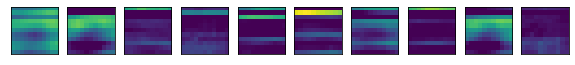

(1210, 200)


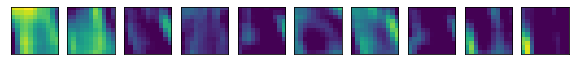

(1210, 200)


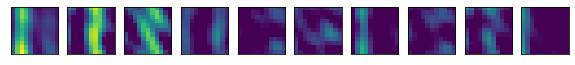

(1210, 200)


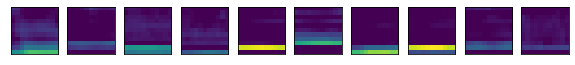

(1210, 200)


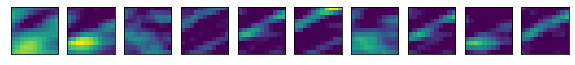

(1210, 200)


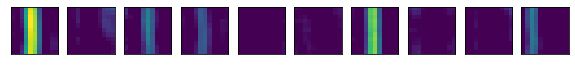

(1210, 200)


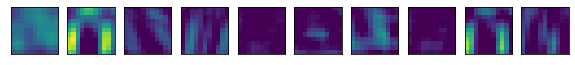

(1210, 200)


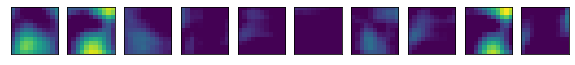

(1210, 200)


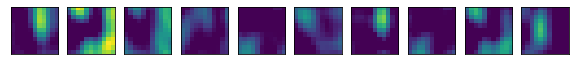

(1210, 200)


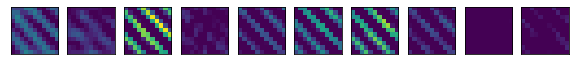

(1210, 200)


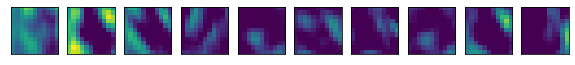

(1210, 200)


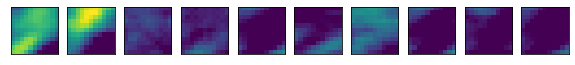

(1210, 200)


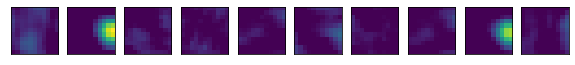

(1210, 200)


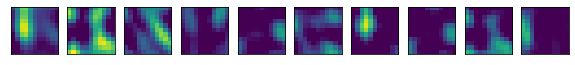

(1210, 200)


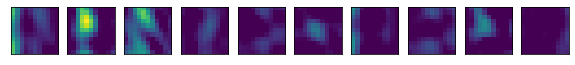

(1210, 200)


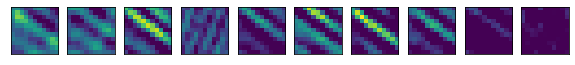

(1210, 200)


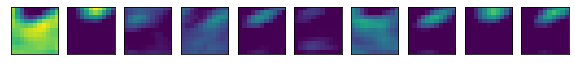

(1210, 200)


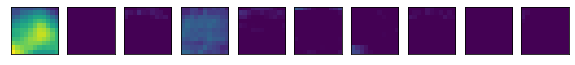

(1210, 200)


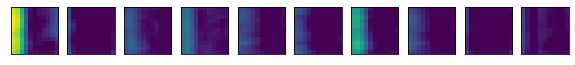

(1210, 200)


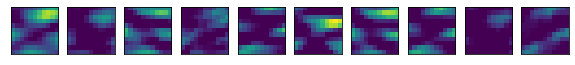

(1210, 200)


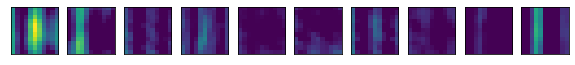

(1210, 200)


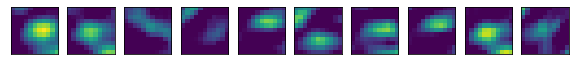

(1210, 200)


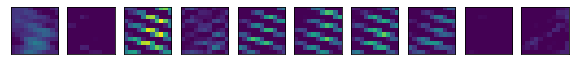

(1210, 200)


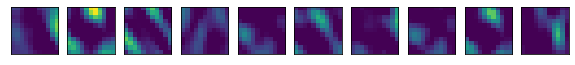

(1210, 200)


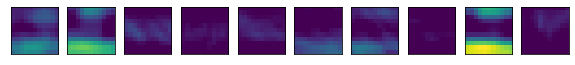

(1210, 200)


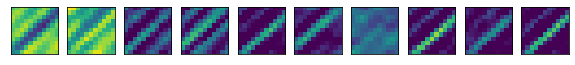

(1210, 200)


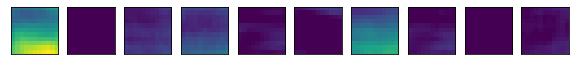

(1210, 200)


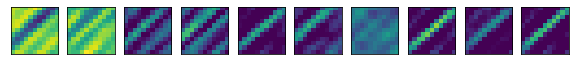

(1210, 200)


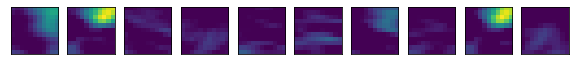

(1210, 200)


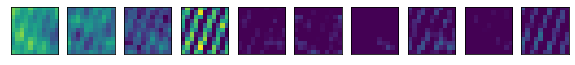

(1210, 200)


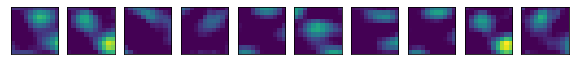

(1210, 200)


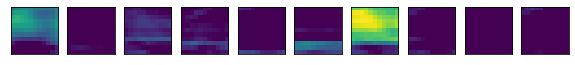

(1210, 200)


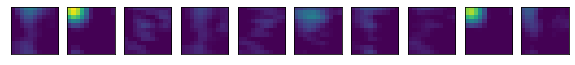

(1210, 200)


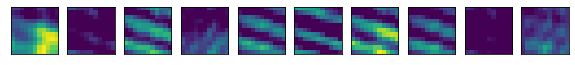

(1210, 200)


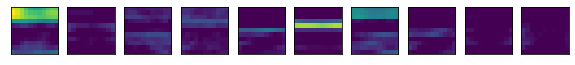

(1210, 200)


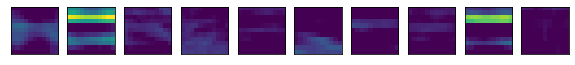

(1210, 200)


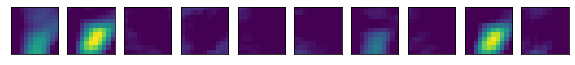

(1210, 200)


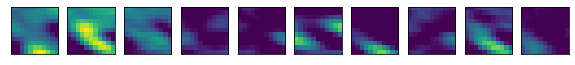

(1210, 200)


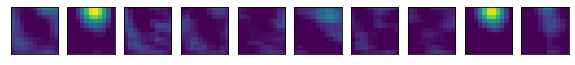

(1210, 200)


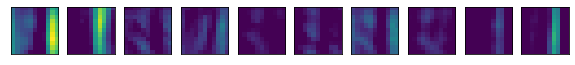

(1210, 200)


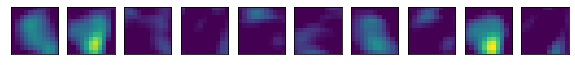

(1210, 200)


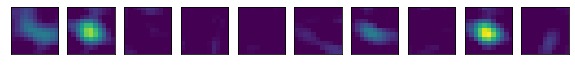

(1210, 200)


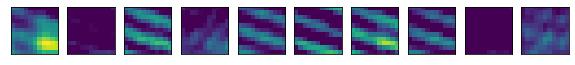

(1210, 200)


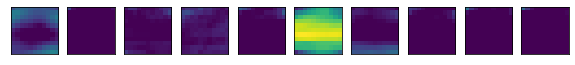

(1210, 200)


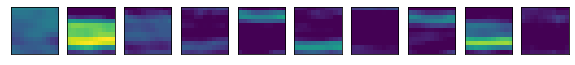

(1210, 200)


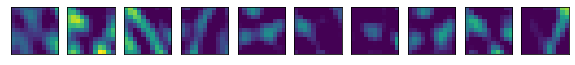

(1210, 200)


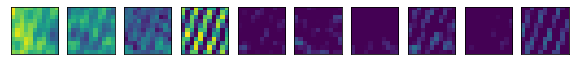

(1210, 200)


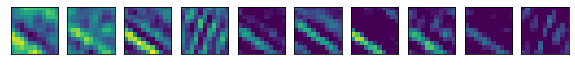

(1210, 200)


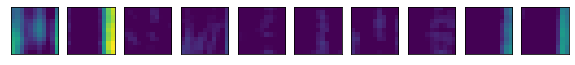

(1210, 200)


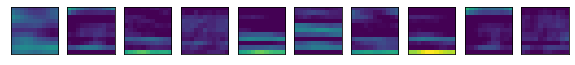

(1210, 200)


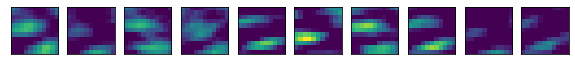

(1210, 200)


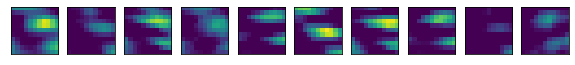

(1210, 200)


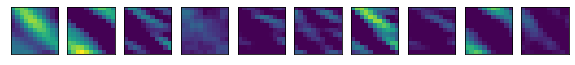

(1210, 200)


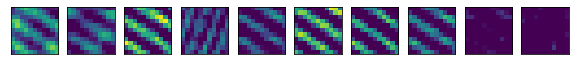

(1210, 200)


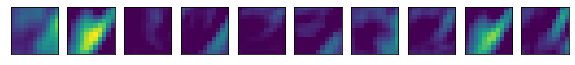

(1210, 200)


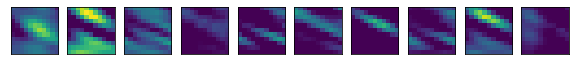

(1210, 200)


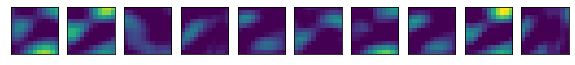

(1210, 200)


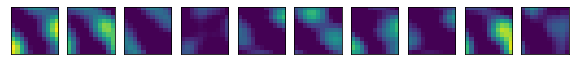

(1210, 200)


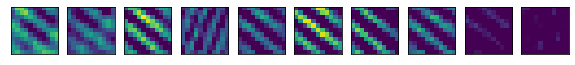

(1210, 200)


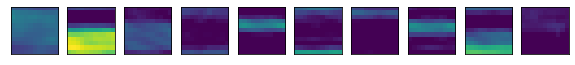

(1210, 200)


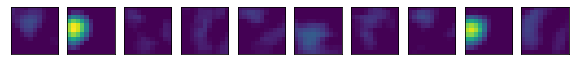

(1210, 200)


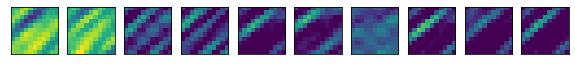

(1210, 200)


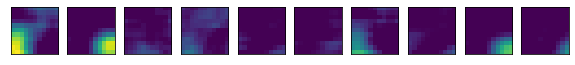

(1210, 200)


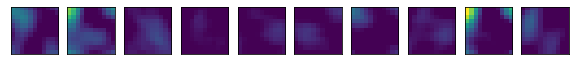

(1210, 200)


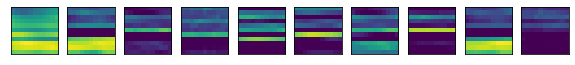

(1210, 200)


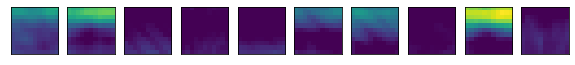

(1210, 200)


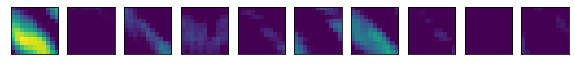

(1210, 200)


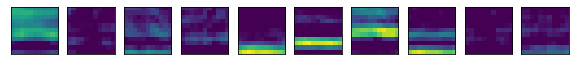

(1210, 200)


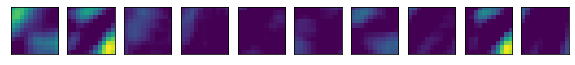

(1210, 200)


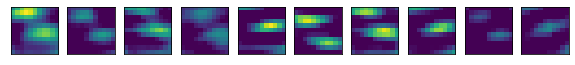

(1210, 200)


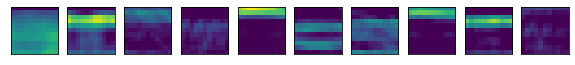

(1210, 200)


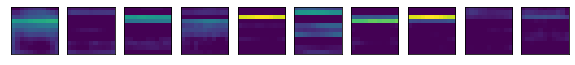

(1210, 200)


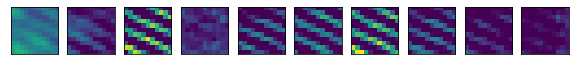

(1210, 200)


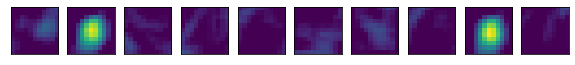

(1210, 200)


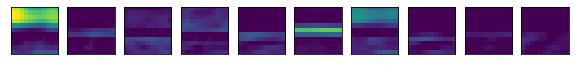

(1210, 200)


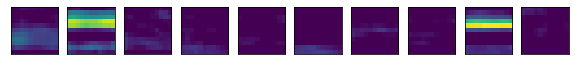

(1210, 200)


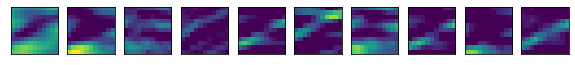

(1210, 200)


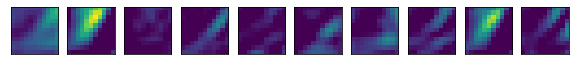

(1210, 200)


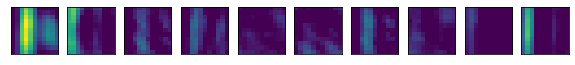

(1210, 200)


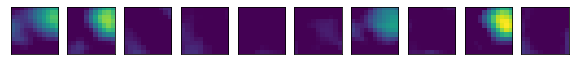

(1210, 200)


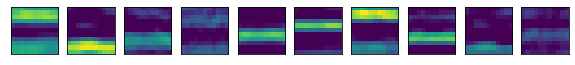

(1210, 200)


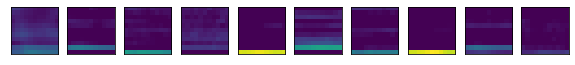

(1210, 200)


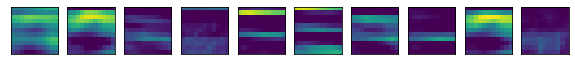

(1210, 200)


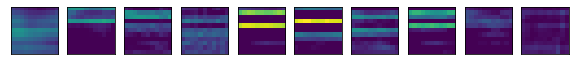

(1210, 200)


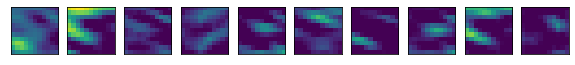

(1210, 200)


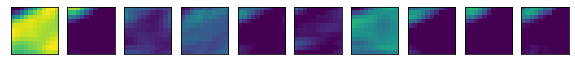

(1210, 200)


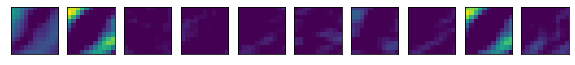

(1210, 200)


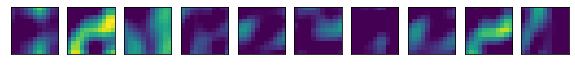

(1210, 200)


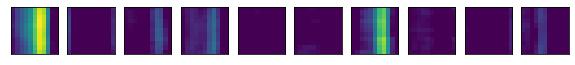

(1210, 200)


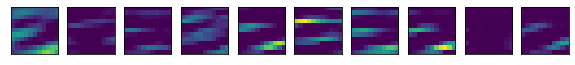

(1210, 200)


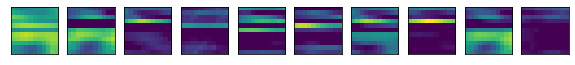

(1210, 200)


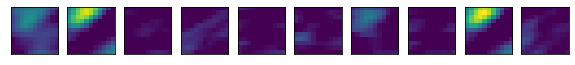

(1210, 200)


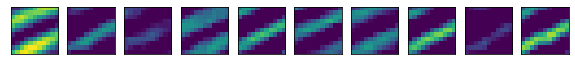

(1210, 200)


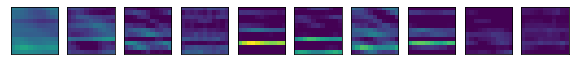

(1210, 200)


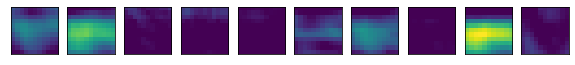

(1210, 200)


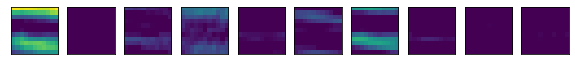

(1210, 200)


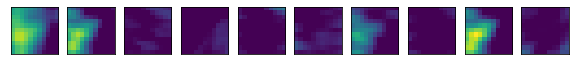

(1210, 200)


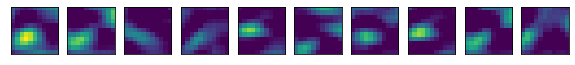

(1210, 200)


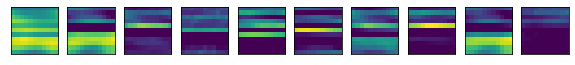

(1210, 200)


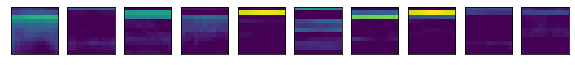

(1210, 200)


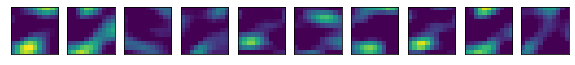

(1210, 200)


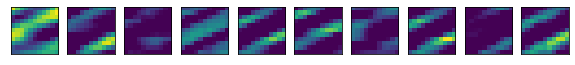

(1210, 200)


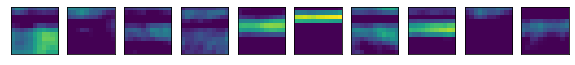

(1210, 200)


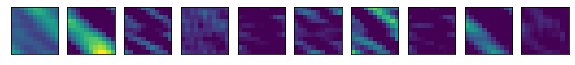

(1210, 200)


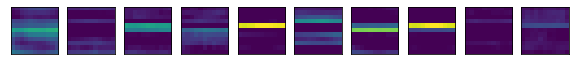

(1210, 200)


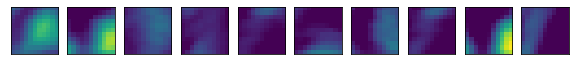

(1210, 200)


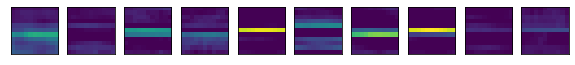

(1210, 200)


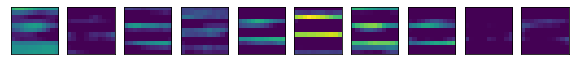

(1210, 200)


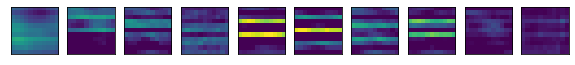

(1210, 200)


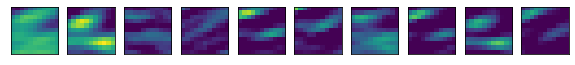

(1210, 200)


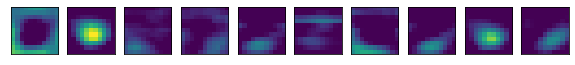

(1210, 200)


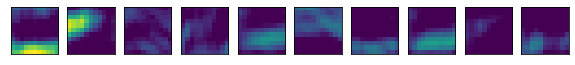

(1210, 200)


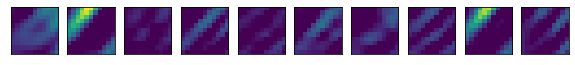

(1210, 200)


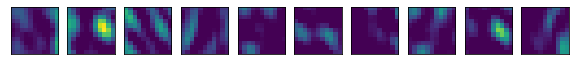

(1210, 200)


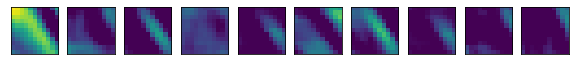

(1210, 200)


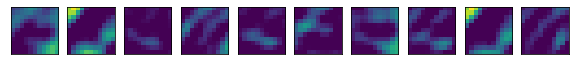

(1210, 200)


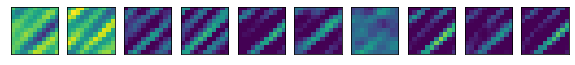

(1210, 200)


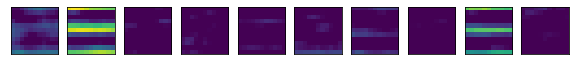

(1210, 200)


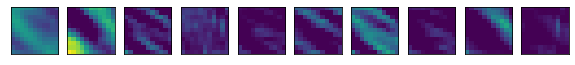

(1210, 200)


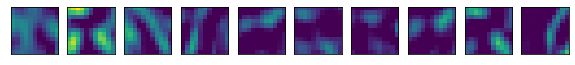

(1210, 200)


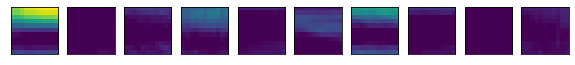

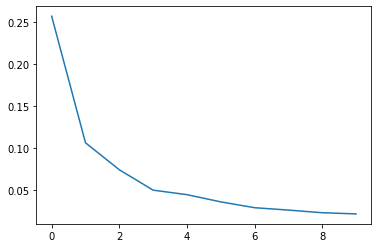

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



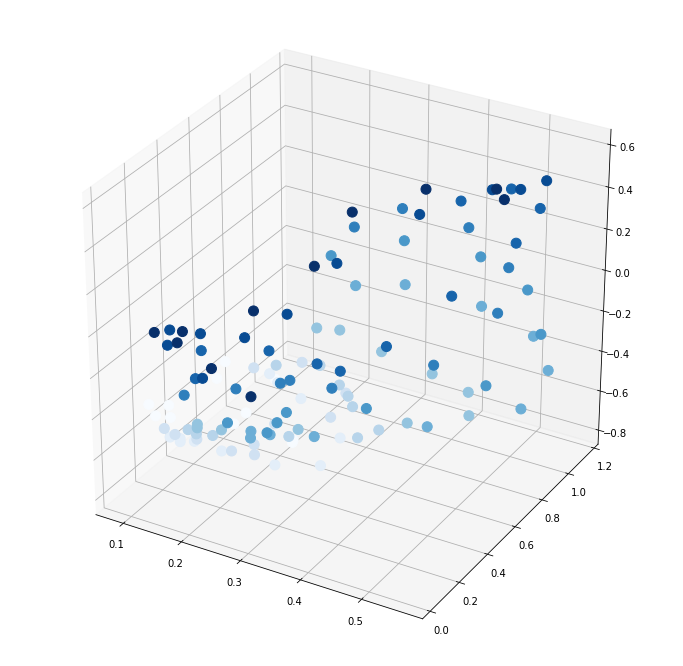

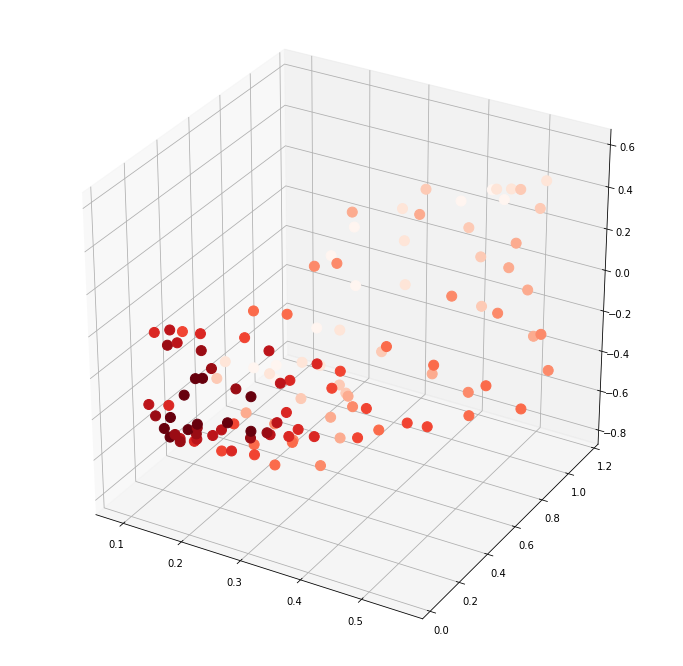

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_7['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

## For 3D epoch 10 max:

Rank-100 models:  min obj, 0.51;  max obj, 0.51;  time to fit, 71.0s


Rank-150 models:  min obj, 0.49;  max obj, 0.49;  time to fit, 104.1s


Rank-200 models:  min obj, 0.48;  max obj, 0.48;  time to fit, 154.4s


[0.4762702284237748]
[0.5126234683781904, 0.49170252595490255, 0.4762702284237748]
[100, 150, 200]


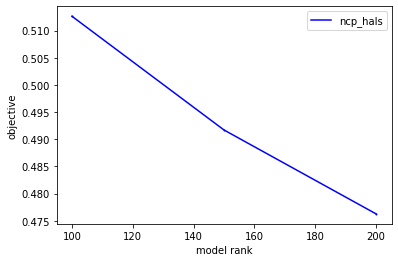

In [ ]:
ensembles_10 = get_tensor_factors(N_epoch10_conv4, ranks = [100,150,200])

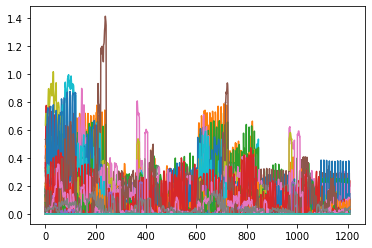

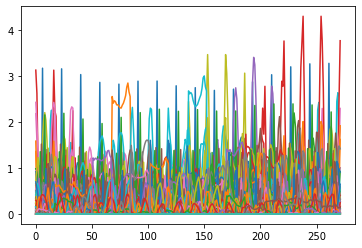

(1210, 200)


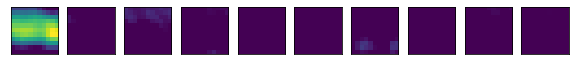

(1210, 200)


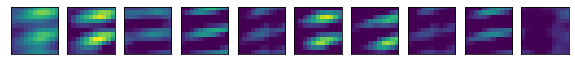

(1210, 200)


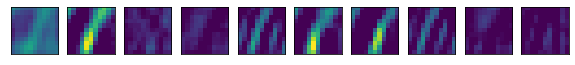

(1210, 200)


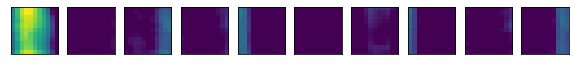

(1210, 200)


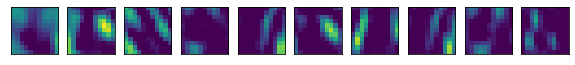

(1210, 200)


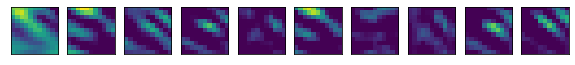

(1210, 200)


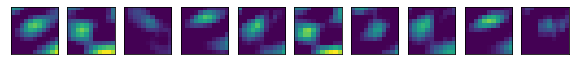

(1210, 200)


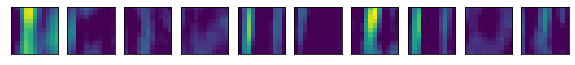

(1210, 200)


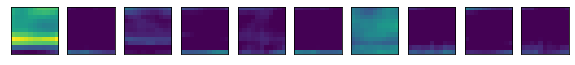

(1210, 200)


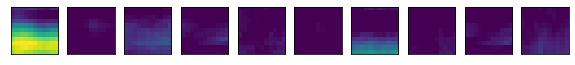

(1210, 200)


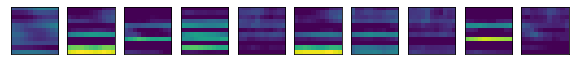

(1210, 200)


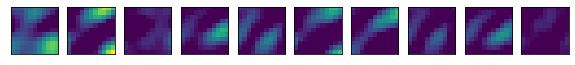

(1210, 200)


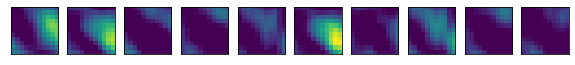

(1210, 200)


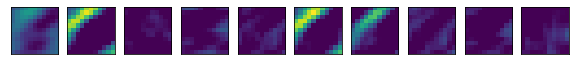

(1210, 200)


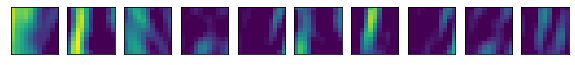

(1210, 200)


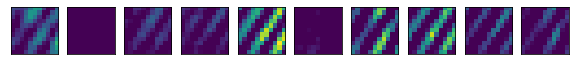

(1210, 200)


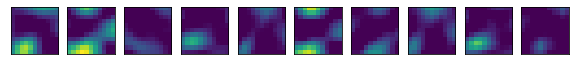

(1210, 200)


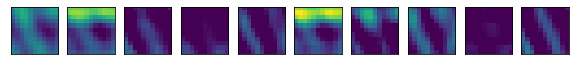

(1210, 200)


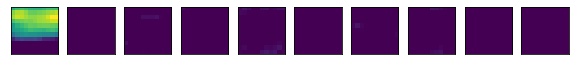

(1210, 200)


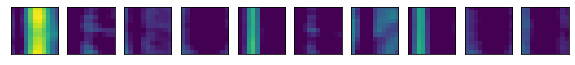

(1210, 200)


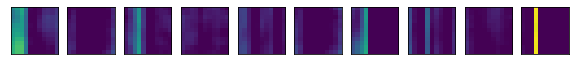

(1210, 200)


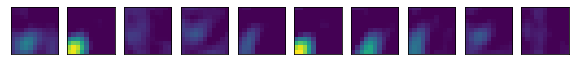

(1210, 200)


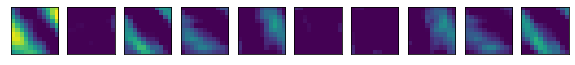

(1210, 200)


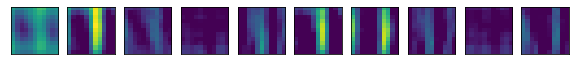

(1210, 200)


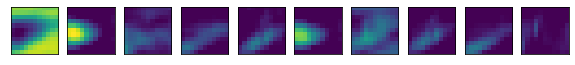

(1210, 200)


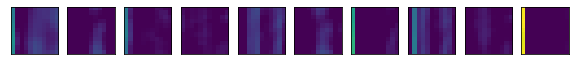

(1210, 200)


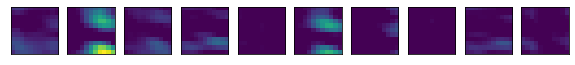

(1210, 200)


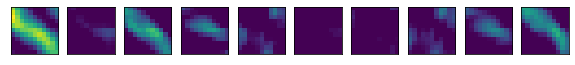

(1210, 200)


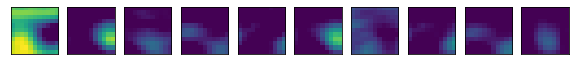

(1210, 200)


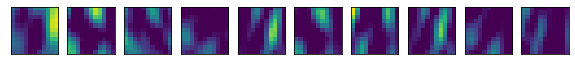

(1210, 200)


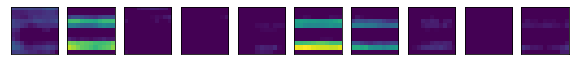

(1210, 200)


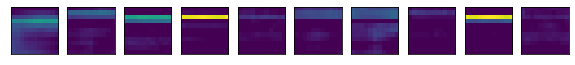

(1210, 200)


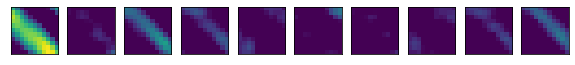

(1210, 200)


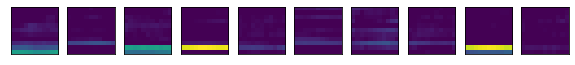

(1210, 200)


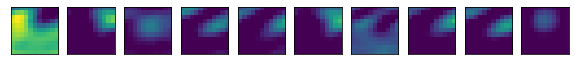

(1210, 200)


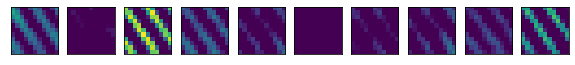

(1210, 200)


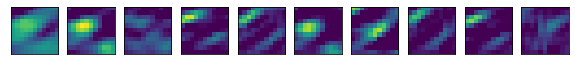

(1210, 200)


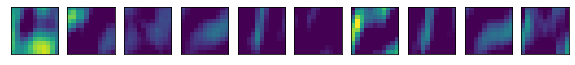

(1210, 200)


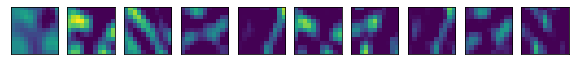

(1210, 200)


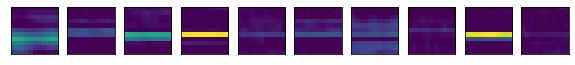

(1210, 200)


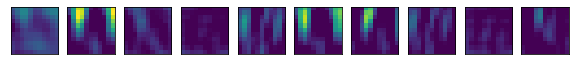

(1210, 200)


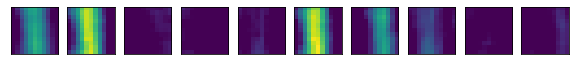

(1210, 200)


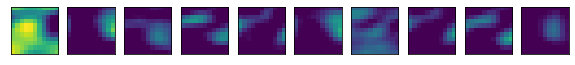

(1210, 200)


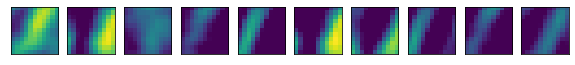

(1210, 200)


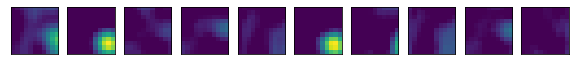

(1210, 200)


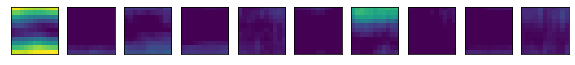

(1210, 200)


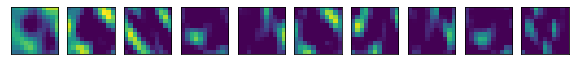

(1210, 200)


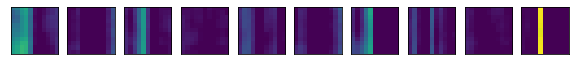

(1210, 200)


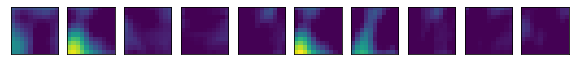

(1210, 200)


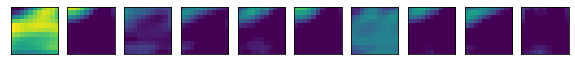

(1210, 200)


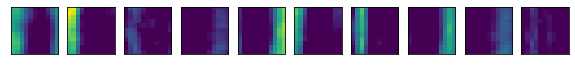

(1210, 200)


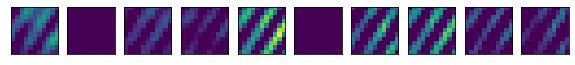

(1210, 200)


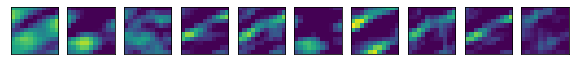

(1210, 200)


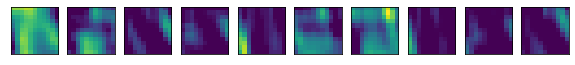

(1210, 200)


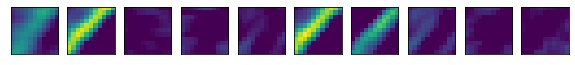

(1210, 200)


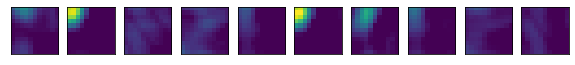

(1210, 200)


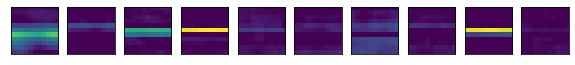

(1210, 200)


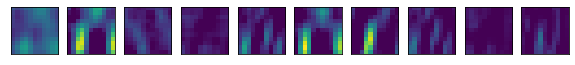

(1210, 200)


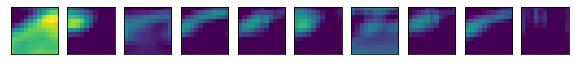

(1210, 200)


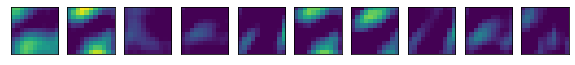

(1210, 200)


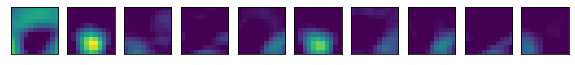

(1210, 200)


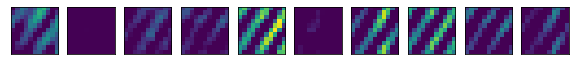

(1210, 200)


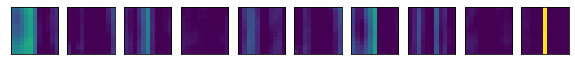

(1210, 200)


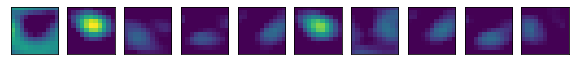

(1210, 200)


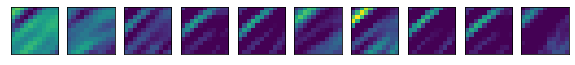

(1210, 200)


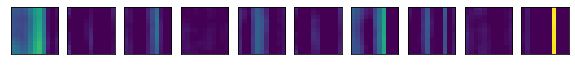

(1210, 200)


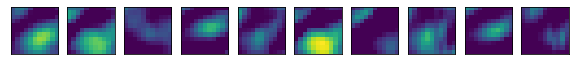

(1210, 200)


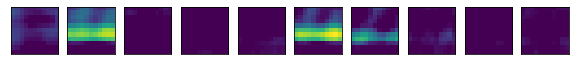

(1210, 200)


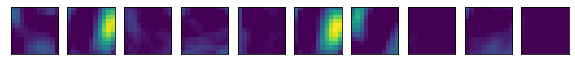

(1210, 200)


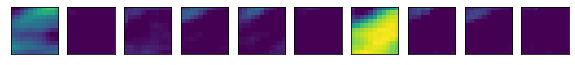

(1210, 200)


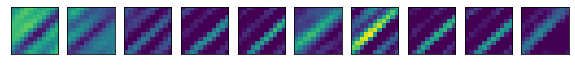

(1210, 200)


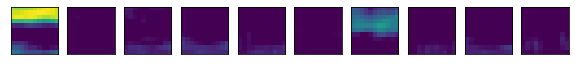

(1210, 200)


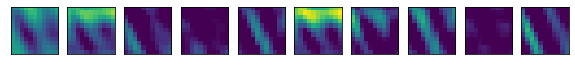

(1210, 200)


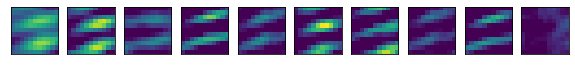

(1210, 200)


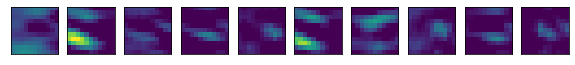

(1210, 200)


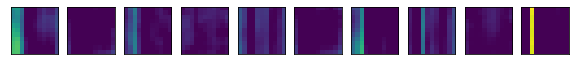

(1210, 200)


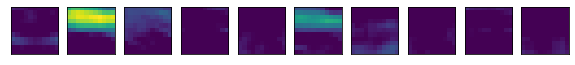

(1210, 200)


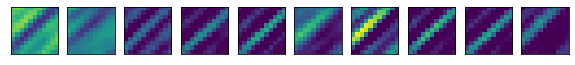

(1210, 200)


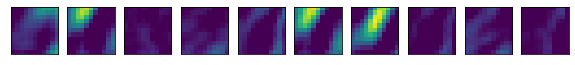

(1210, 200)


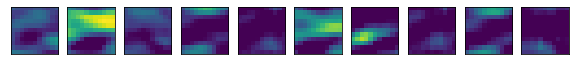

(1210, 200)


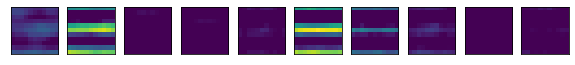

(1210, 200)


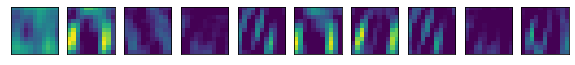

(1210, 200)


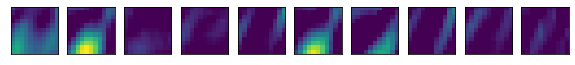

(1210, 200)


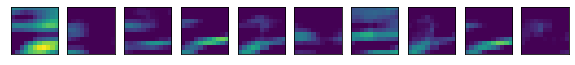

(1210, 200)


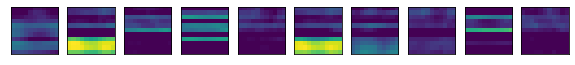

(1210, 200)


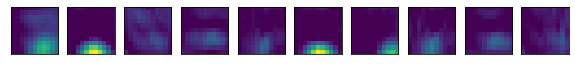

(1210, 200)


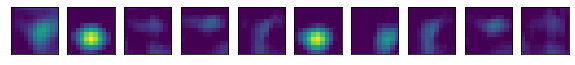

(1210, 200)


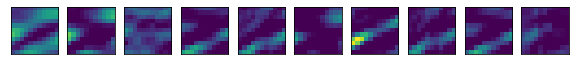

(1210, 200)


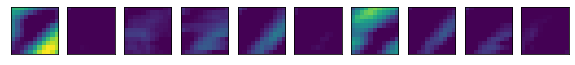

(1210, 200)


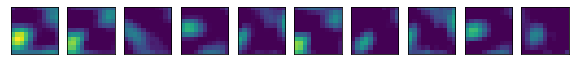

(1210, 200)


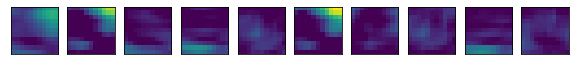

(1210, 200)


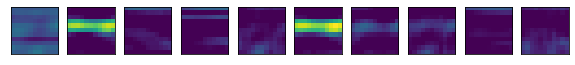

(1210, 200)


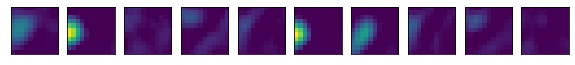

(1210, 200)


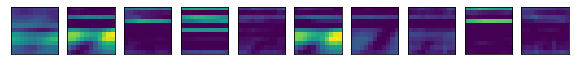

(1210, 200)


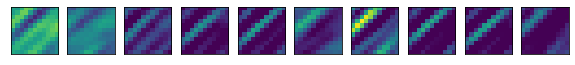

(1210, 200)


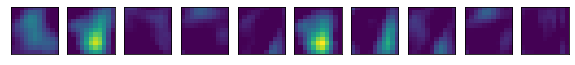

(1210, 200)


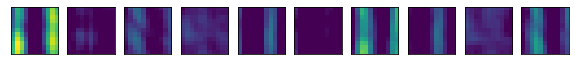

(1210, 200)


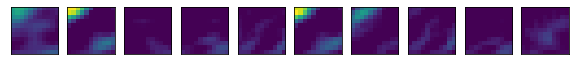

(1210, 200)


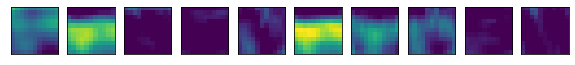

(1210, 200)


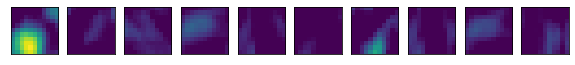

(1210, 200)


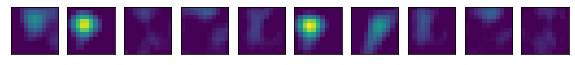

(1210, 200)


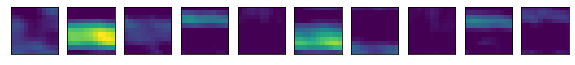

(1210, 200)


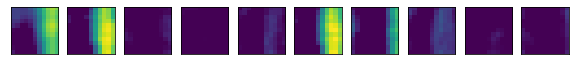

(1210, 200)


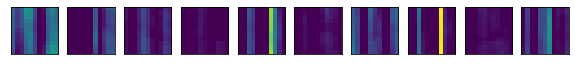

(1210, 200)


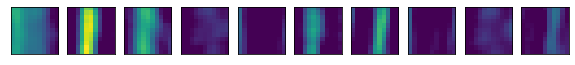

(1210, 200)


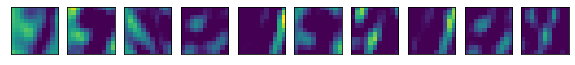

(1210, 200)


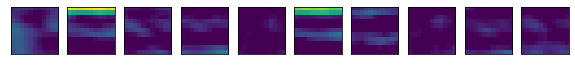

(1210, 200)


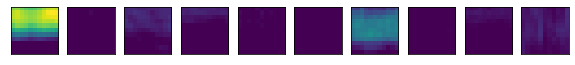

(1210, 200)


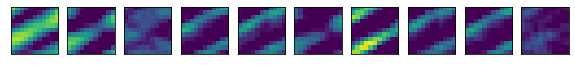

(1210, 200)


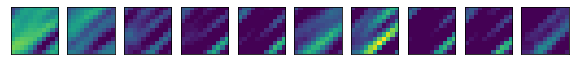

(1210, 200)


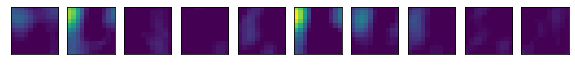

(1210, 200)


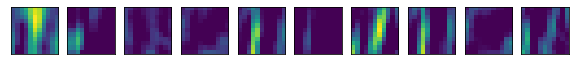

(1210, 200)


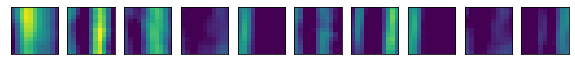

(1210, 200)


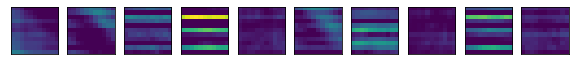

(1210, 200)


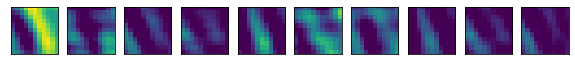

(1210, 200)


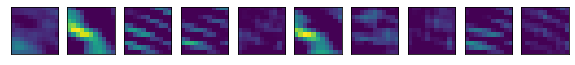

(1210, 200)


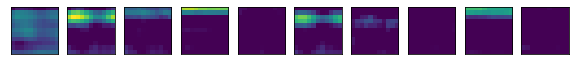

(1210, 200)


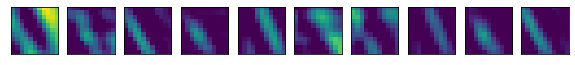

(1210, 200)


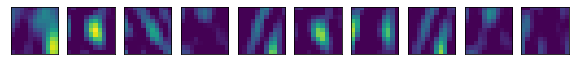

(1210, 200)


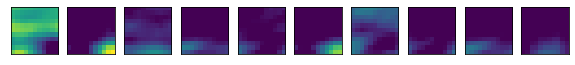

(1210, 200)


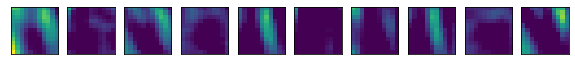

(1210, 200)


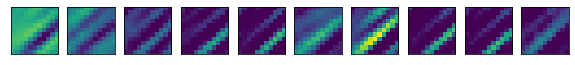

(1210, 200)


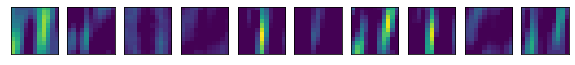

(1210, 200)


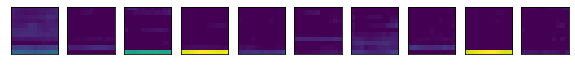

(1210, 200)


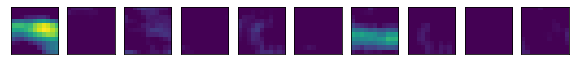

(1210, 200)


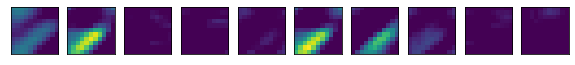

(1210, 200)


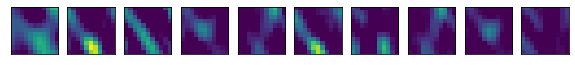

(1210, 200)


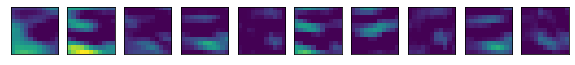

(1210, 200)


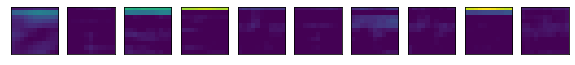

(1210, 200)


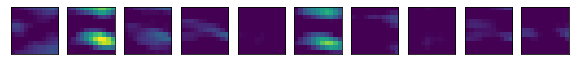

(1210, 200)


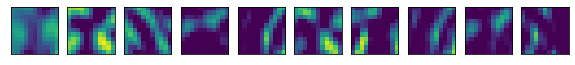

(1210, 200)


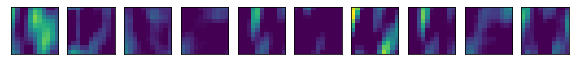

(1210, 200)


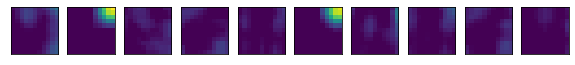

(1210, 200)


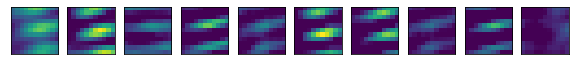

(1210, 200)


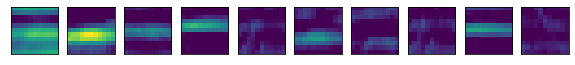

(1210, 200)


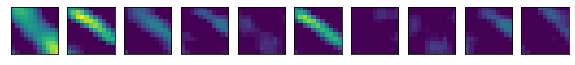

(1210, 200)


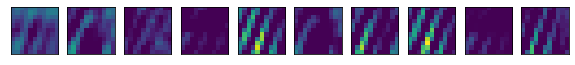

(1210, 200)


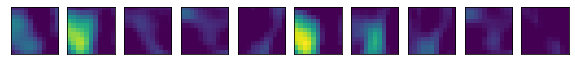

(1210, 200)


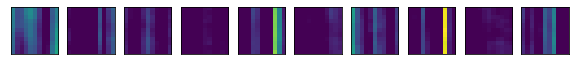

(1210, 200)


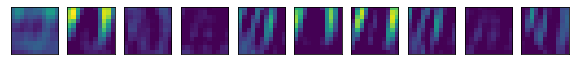

(1210, 200)


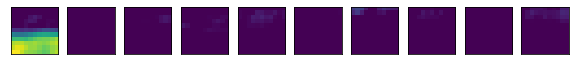

(1210, 200)


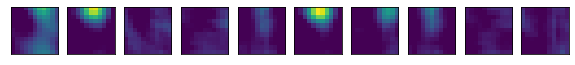

(1210, 200)


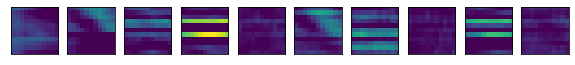

(1210, 200)


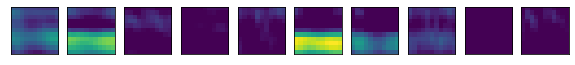

(1210, 200)


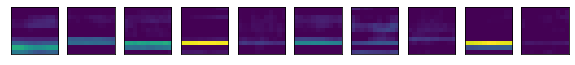

(1210, 200)


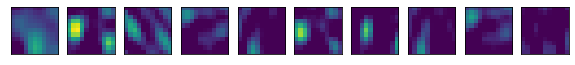

(1210, 200)


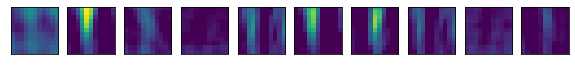

(1210, 200)


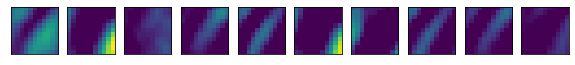

(1210, 200)


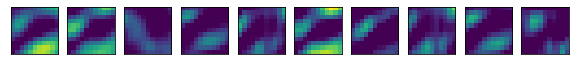

(1210, 200)


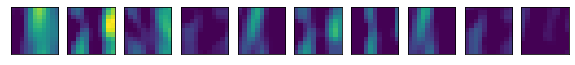

(1210, 200)


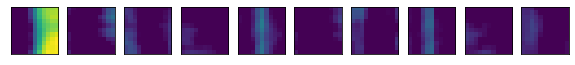

(1210, 200)


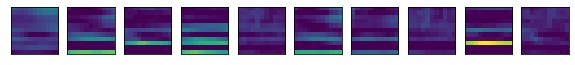

(1210, 200)


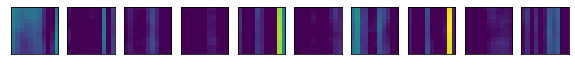

(1210, 200)


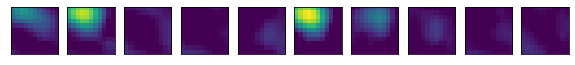

(1210, 200)


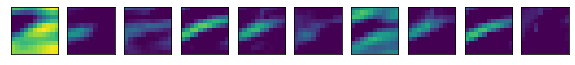

(1210, 200)


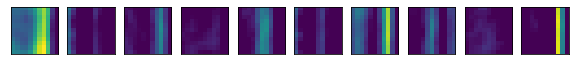

(1210, 200)


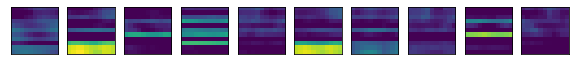

(1210, 200)


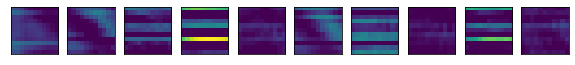

(1210, 200)


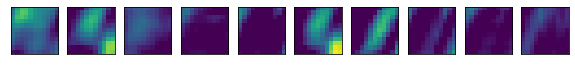

(1210, 200)


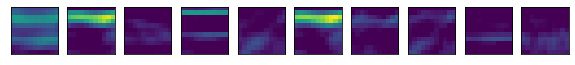

(1210, 200)


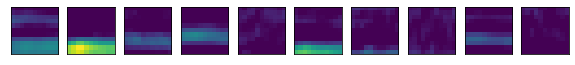

(1210, 200)


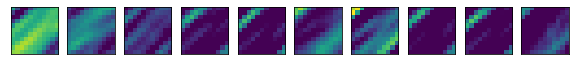

(1210, 200)


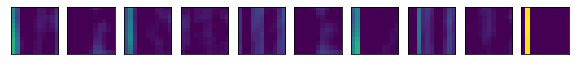

(1210, 200)


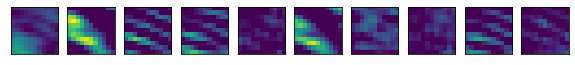

(1210, 200)


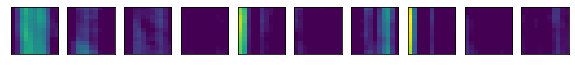

(1210, 200)


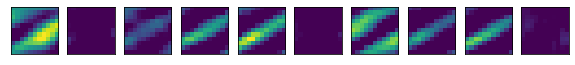

(1210, 200)


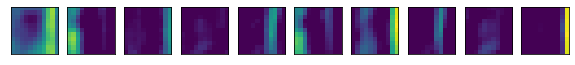

(1210, 200)


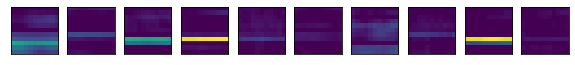

(1210, 200)


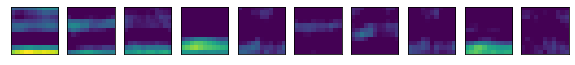

(1210, 200)


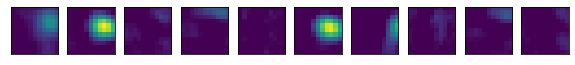

(1210, 200)


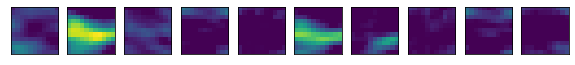

(1210, 200)


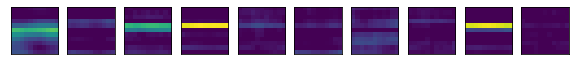

(1210, 200)


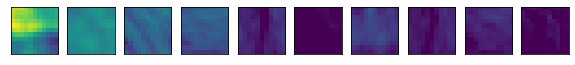

(1210, 200)


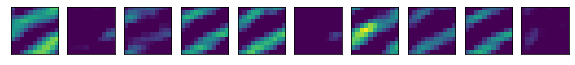

(1210, 200)


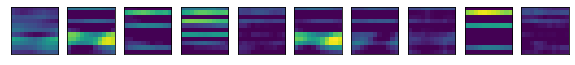

(1210, 200)


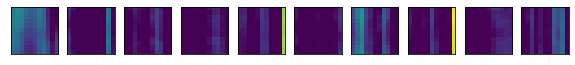

(1210, 200)


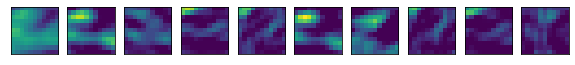

(1210, 200)


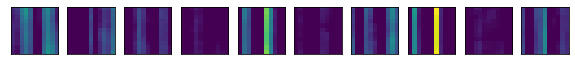

(1210, 200)


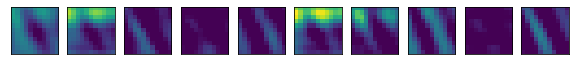

(1210, 200)


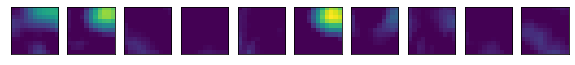

(1210, 200)


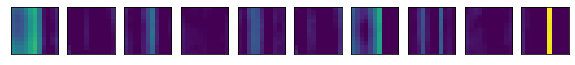

(1210, 200)


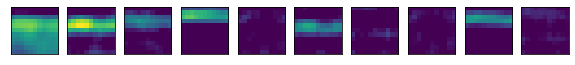

(1210, 200)


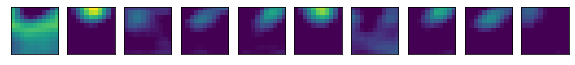

(1210, 200)


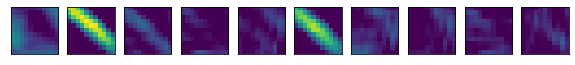

(1210, 200)


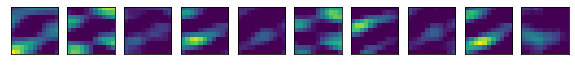

(1210, 200)


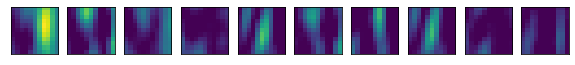

(1210, 200)


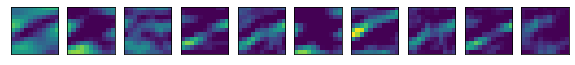

(1210, 200)


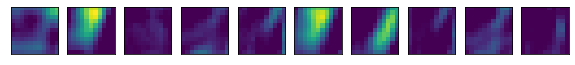

(1210, 200)


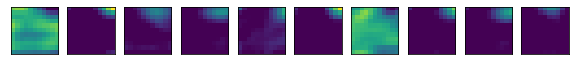

(1210, 200)


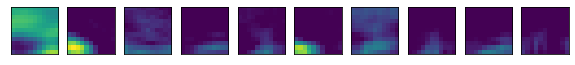

(1210, 200)


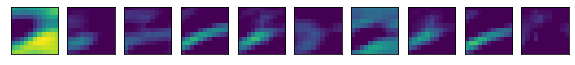

(1210, 200)


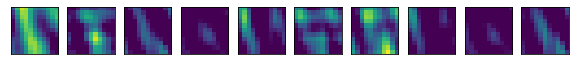

(1210, 200)


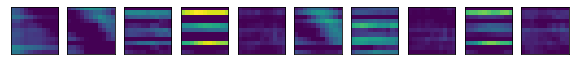

(1210, 200)


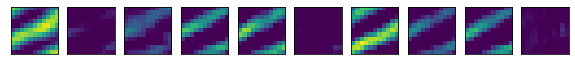

(1210, 200)


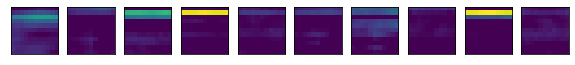

(1210, 200)


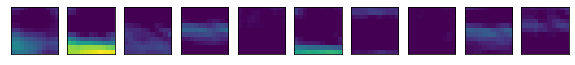

(1210, 200)


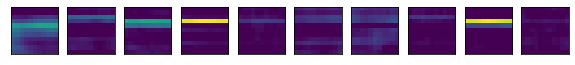

(1210, 200)


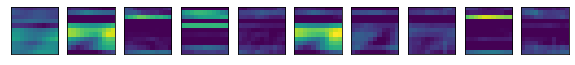

(1210, 200)


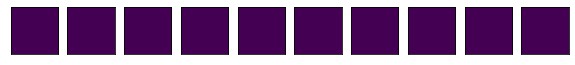

(1210, 200)


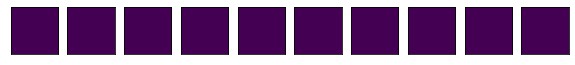

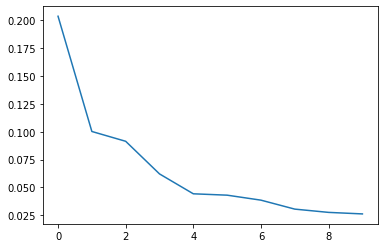

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



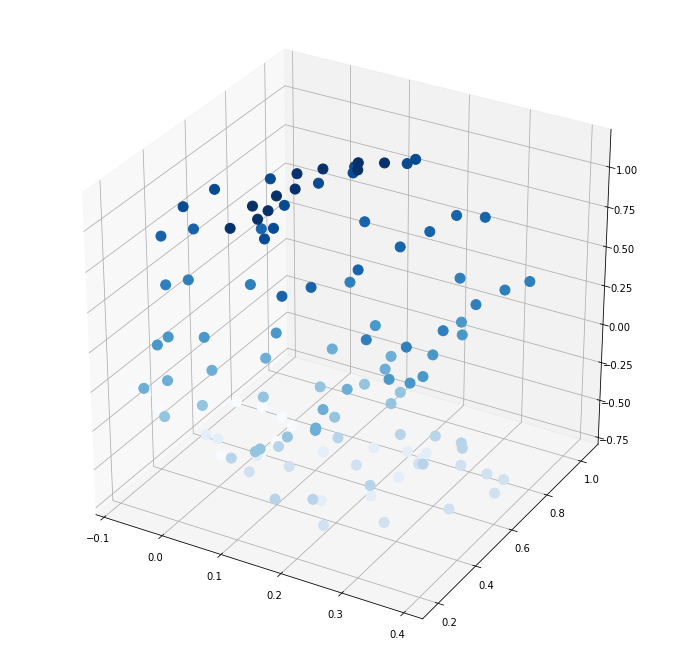

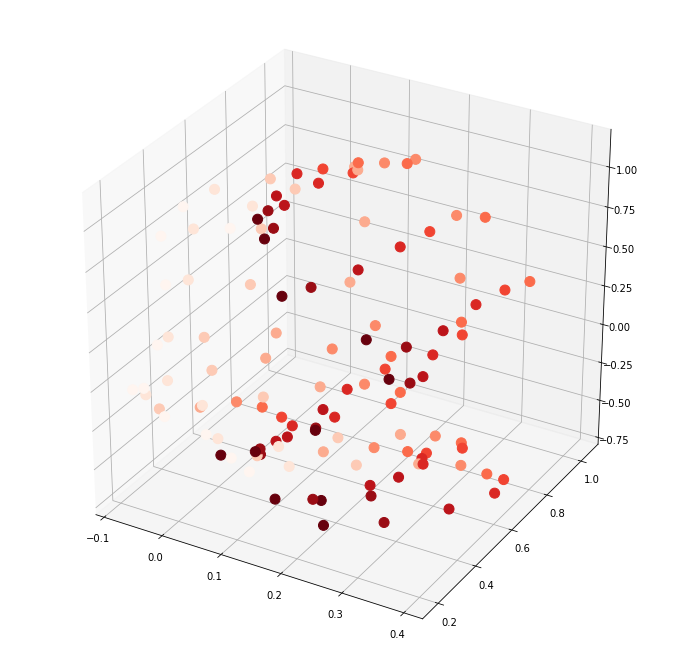

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_10['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

Fitting rank-100 models:   0%|          | 0/1 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/tensortools/optimize/ncp_hals.py:185: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  Cp = factors[:, idx] @ grams[idx][:, p]
/usr/local/lib/python3.7/dist-packages/numba/core/typing/npydecl.py:930: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  warnings.warn(NumbaPerformanceWarning(msg))
                                                                       

Rank-100 models:  min obj, 0.51;  max obj, 0.51;  time to fit, 130.1s


Rank-150 models:  min obj, 0.49;  max obj, 0.49;  time to fit, 153.5s


Rank-200 models:  min obj, 0.48;  max obj, 0.48;  time to fit, 191.1s


[0.4754504534335042]
[0.5106376619619468, 0.4915681718565692, 0.4754504534335042]
[100, 150, 200]


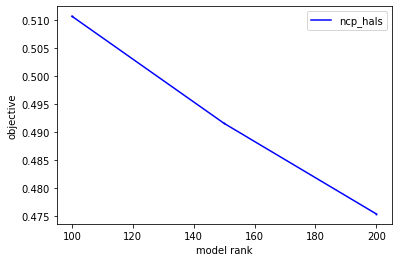

In [ ]:
ensembles_10 = get_tensor_factors(N_epoch10_max, ranks = [100,150,200])

In [ ]:
rep = 0
ranks = [200]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_10['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

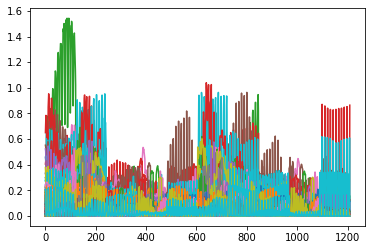

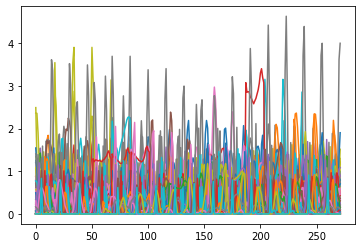

(1210, 200)


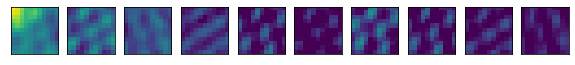

(1210, 200)


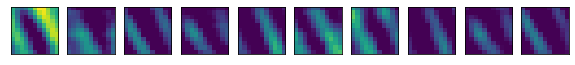

(1210, 200)


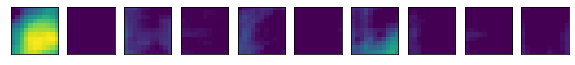

(1210, 200)


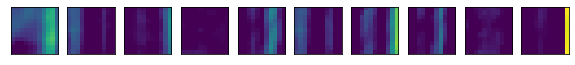

(1210, 200)


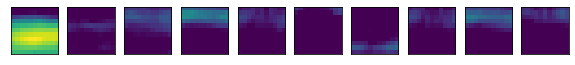

(1210, 200)


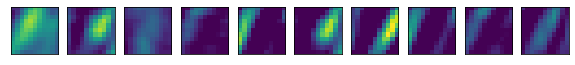

(1210, 200)


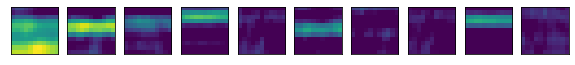

(1210, 200)


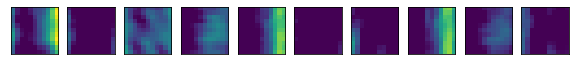

(1210, 200)


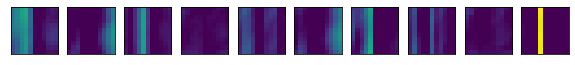

(1210, 200)


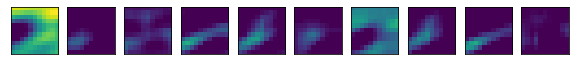

(1210, 200)


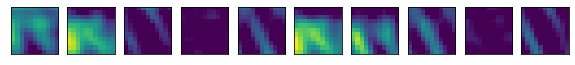

(1210, 200)


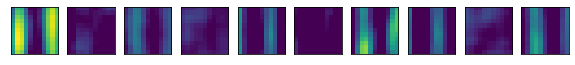

(1210, 200)


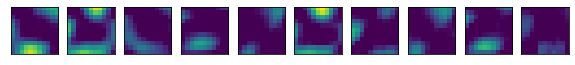

(1210, 200)


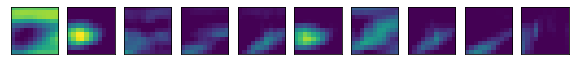

(1210, 200)


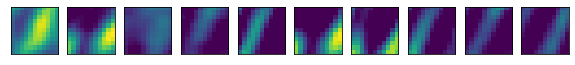

(1210, 200)


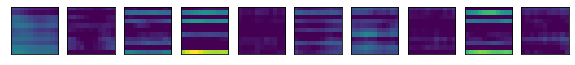

(1210, 200)


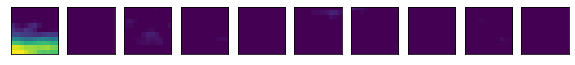

(1210, 200)


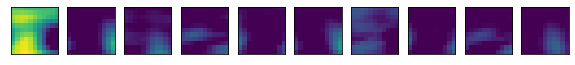

(1210, 200)


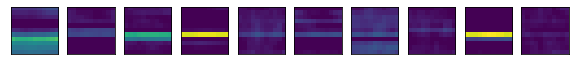

(1210, 200)


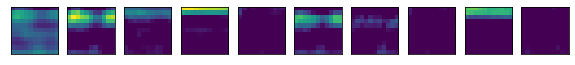

(1210, 200)


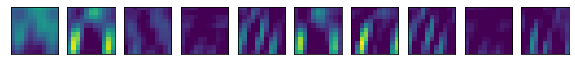

(1210, 200)


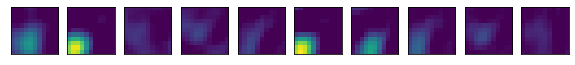

(1210, 200)


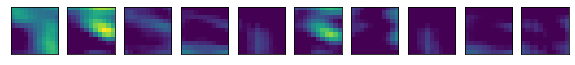

(1210, 200)


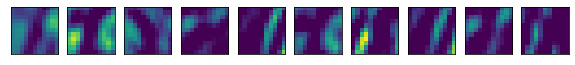

(1210, 200)


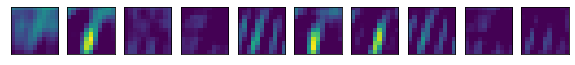

(1210, 200)


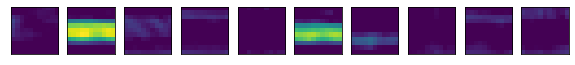

(1210, 200)


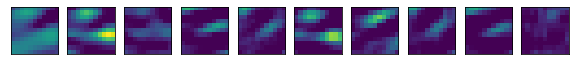

(1210, 200)


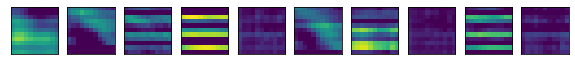

(1210, 200)


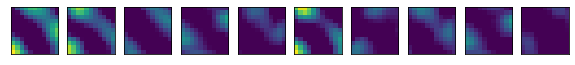

(1210, 200)


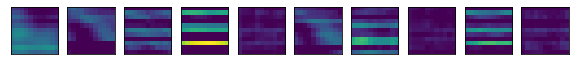

(1210, 200)


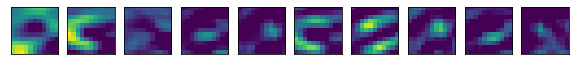

(1210, 200)


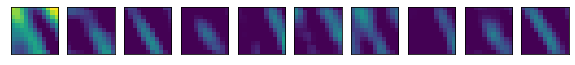

(1210, 200)


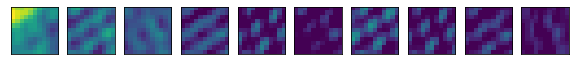

(1210, 200)


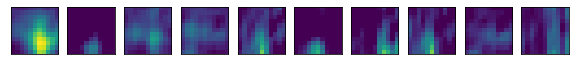

(1210, 200)


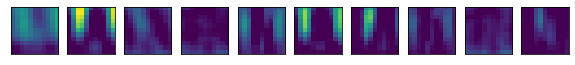

(1210, 200)


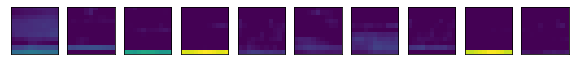

(1210, 200)


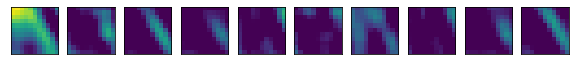

(1210, 200)


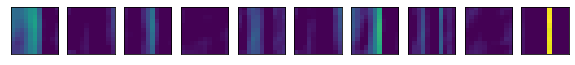

(1210, 200)


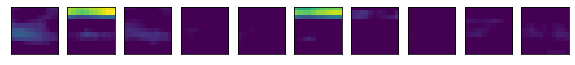

(1210, 200)


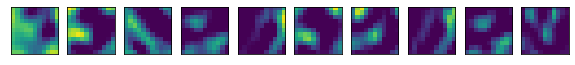

(1210, 200)


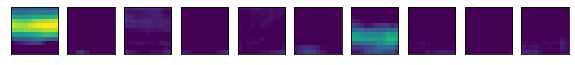

(1210, 200)


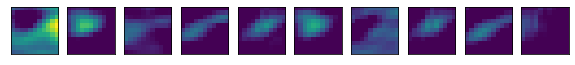

(1210, 200)


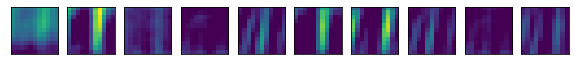

(1210, 200)


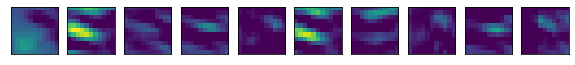

(1210, 200)


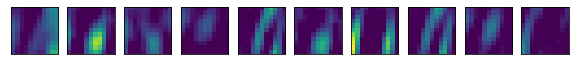

(1210, 200)


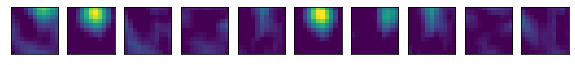

(1210, 200)


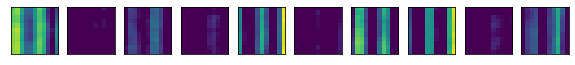

(1210, 200)


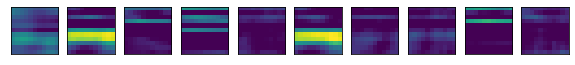

(1210, 200)


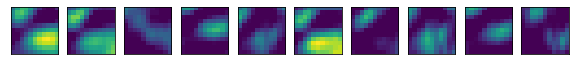

(1210, 200)


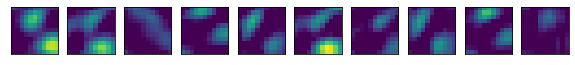

(1210, 200)


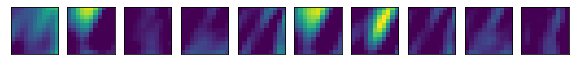

(1210, 200)


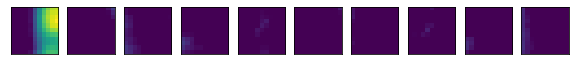

(1210, 200)


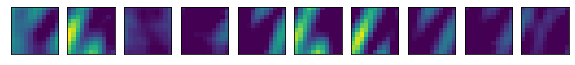

(1210, 200)


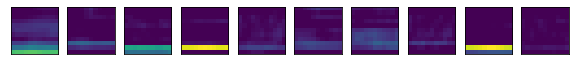

(1210, 200)


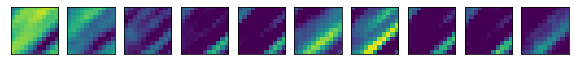

(1210, 200)


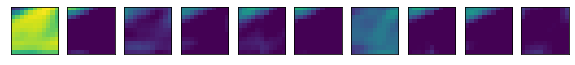

(1210, 200)


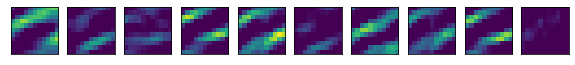

(1210, 200)


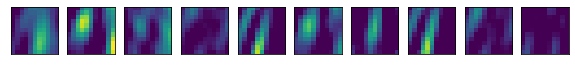

(1210, 200)


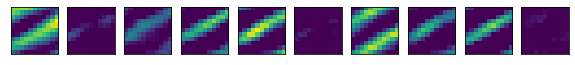

(1210, 200)


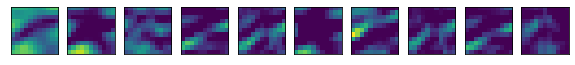

(1210, 200)


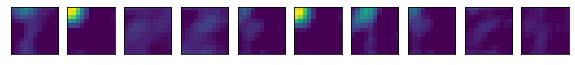

(1210, 200)


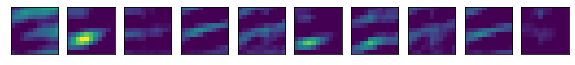

(1210, 200)


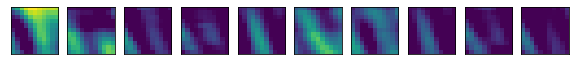

(1210, 200)


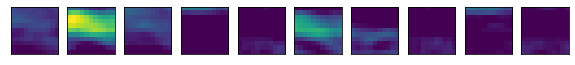

(1210, 200)


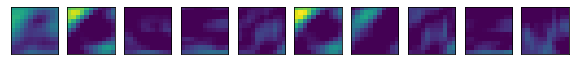

(1210, 200)


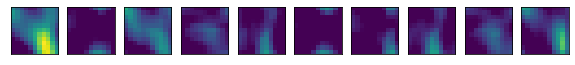

(1210, 200)


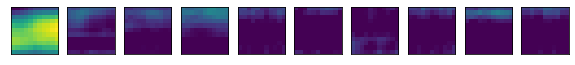

(1210, 200)


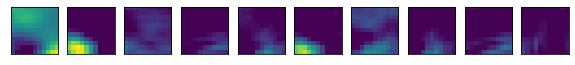

(1210, 200)


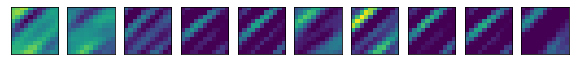

(1210, 200)


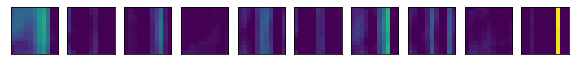

(1210, 200)


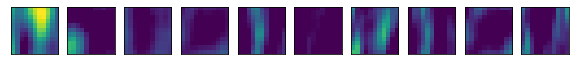

(1210, 200)


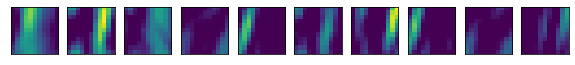

(1210, 200)


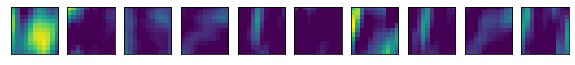

(1210, 200)


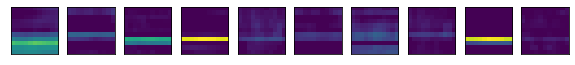

(1210, 200)


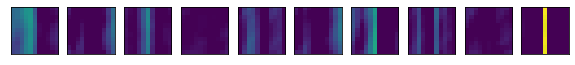

(1210, 200)


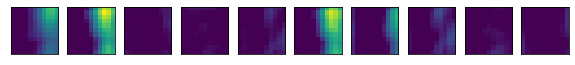

(1210, 200)


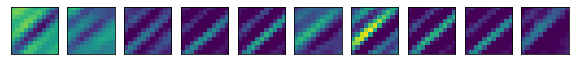

(1210, 200)


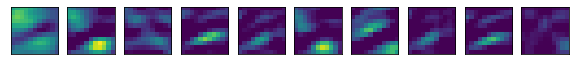

(1210, 200)


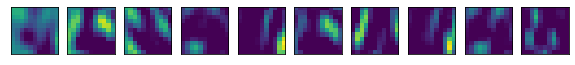

(1210, 200)


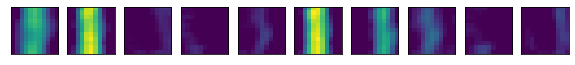

(1210, 200)


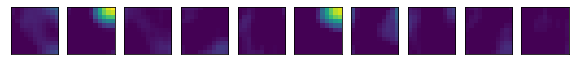

(1210, 200)


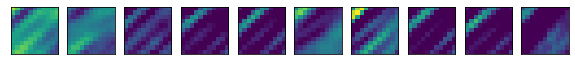

(1210, 200)


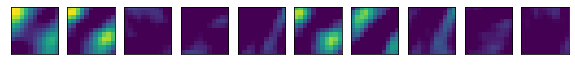

(1210, 200)


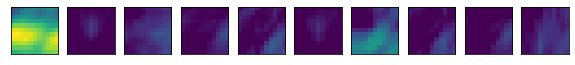

(1210, 200)


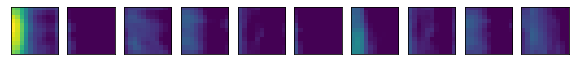

(1210, 200)


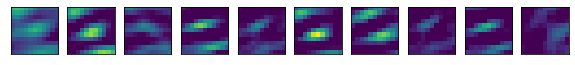

(1210, 200)


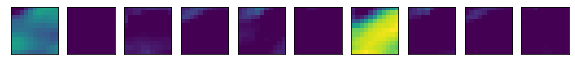

(1210, 200)


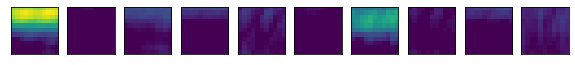

(1210, 200)


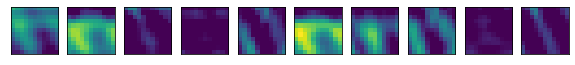

(1210, 200)


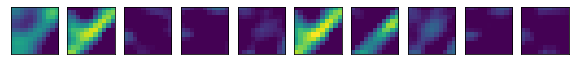

(1210, 200)


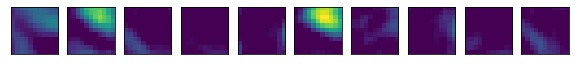

(1210, 200)


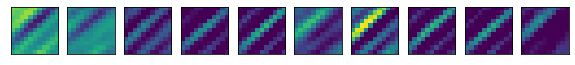

(1210, 200)


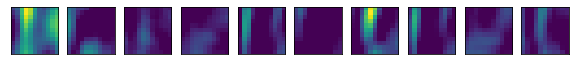

(1210, 200)


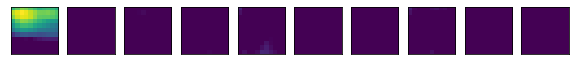

(1210, 200)


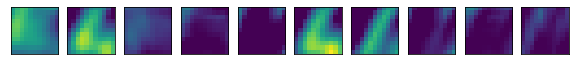

(1210, 200)


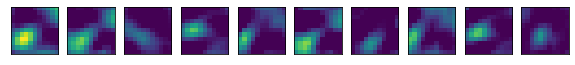

(1210, 200)


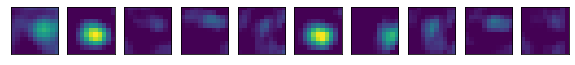

(1210, 200)


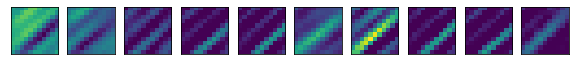

(1210, 200)


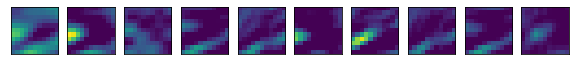

(1210, 200)


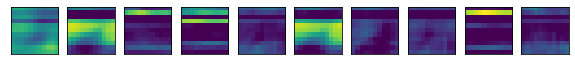

(1210, 200)


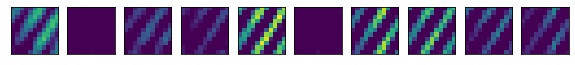

(1210, 200)


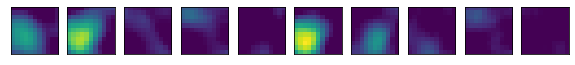

(1210, 200)


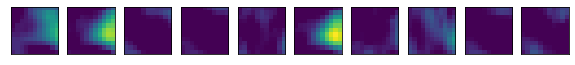

(1210, 200)


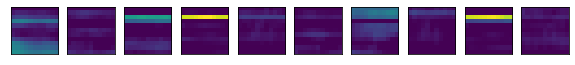

(1210, 200)


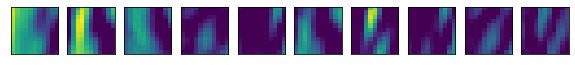

(1210, 200)


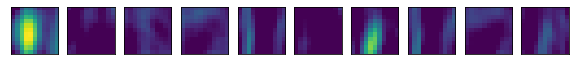

(1210, 200)


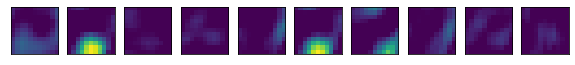

(1210, 200)


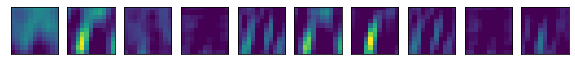

(1210, 200)


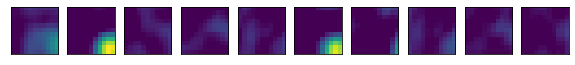

(1210, 200)


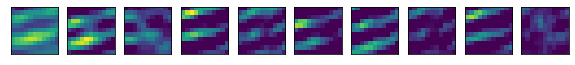

(1210, 200)


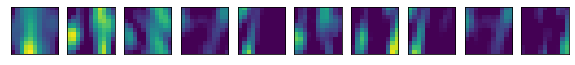

(1210, 200)


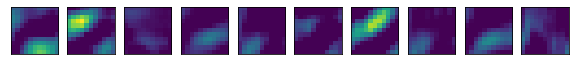

(1210, 200)


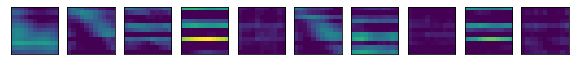

(1210, 200)


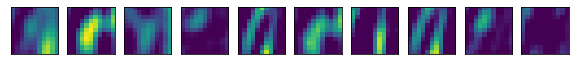

(1210, 200)


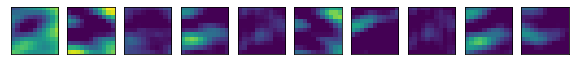

(1210, 200)


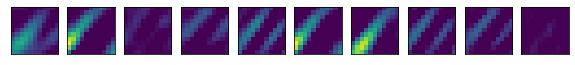

(1210, 200)


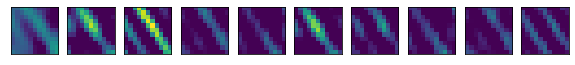

(1210, 200)


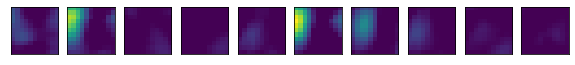

(1210, 200)


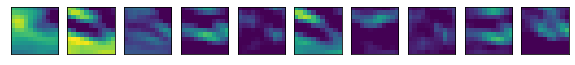

(1210, 200)


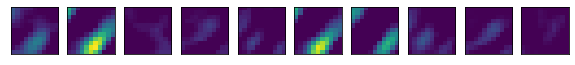

(1210, 200)


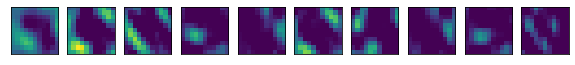

(1210, 200)


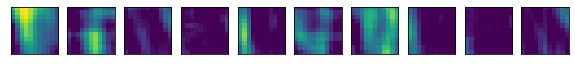

(1210, 200)


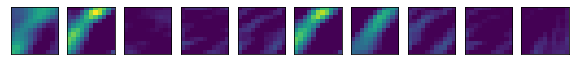

(1210, 200)


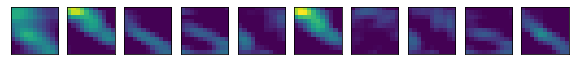

(1210, 200)


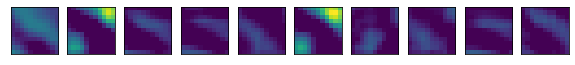

(1210, 200)


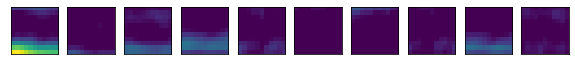

(1210, 200)


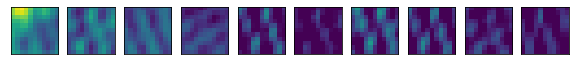

(1210, 200)


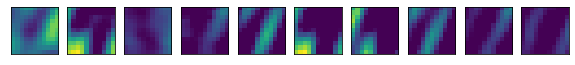

(1210, 200)


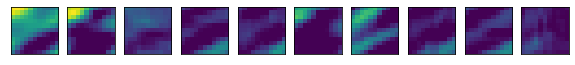

(1210, 200)


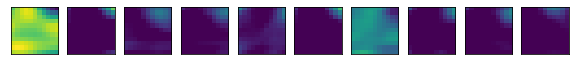

(1210, 200)


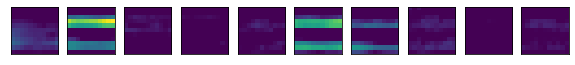

(1210, 200)


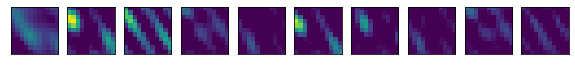

(1210, 200)


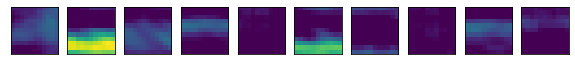

(1210, 200)


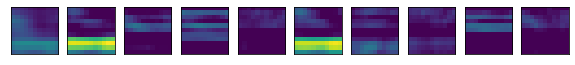

(1210, 200)


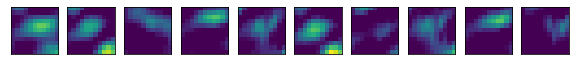

(1210, 200)


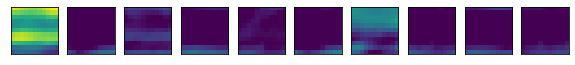

(1210, 200)


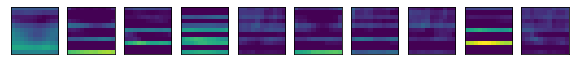

(1210, 200)


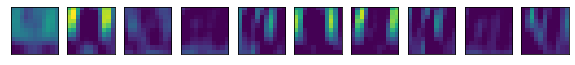

(1210, 200)


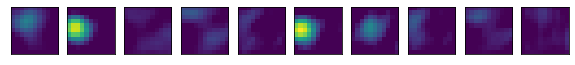

(1210, 200)


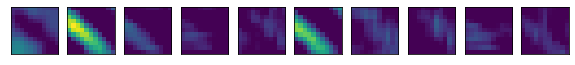

(1210, 200)


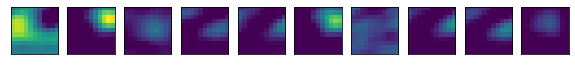

(1210, 200)


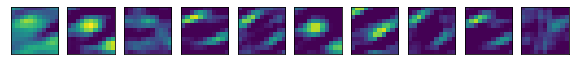

(1210, 200)


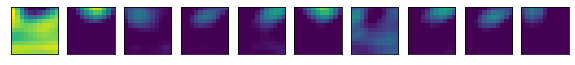

(1210, 200)


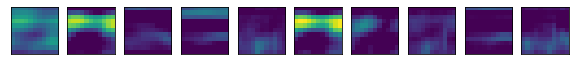

(1210, 200)


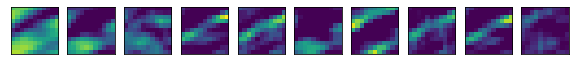

(1210, 200)


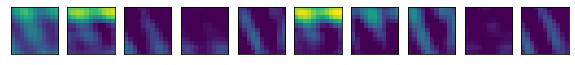

(1210, 200)


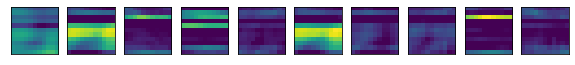

(1210, 200)


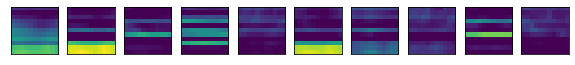

(1210, 200)


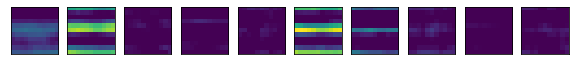

(1210, 200)


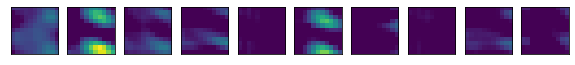

(1210, 200)


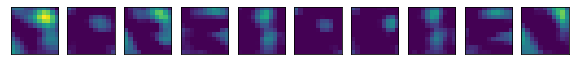

(1210, 200)


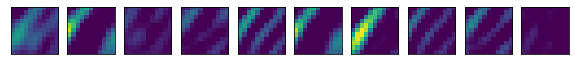

(1210, 200)


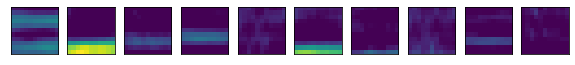

(1210, 200)


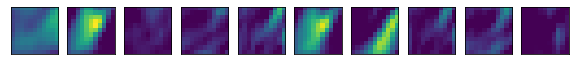

(1210, 200)


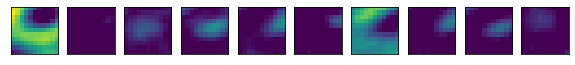

(1210, 200)


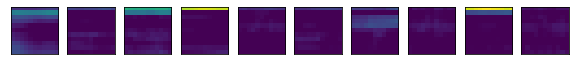

(1210, 200)


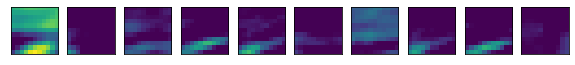

(1210, 200)


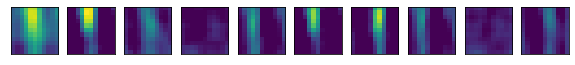

(1210, 200)


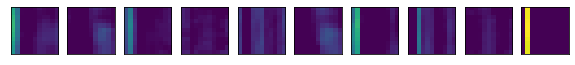

(1210, 200)


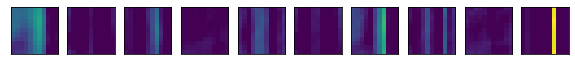

(1210, 200)


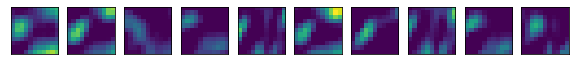

(1210, 200)


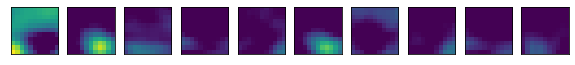

(1210, 200)


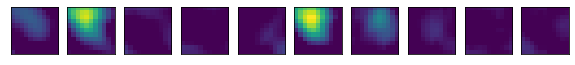

(1210, 200)


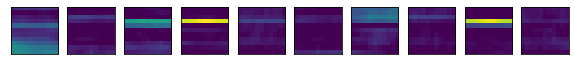

(1210, 200)


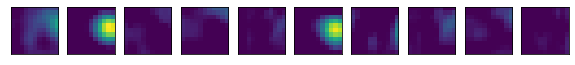

(1210, 200)


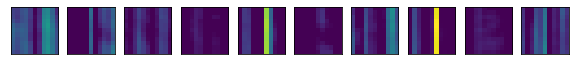

(1210, 200)


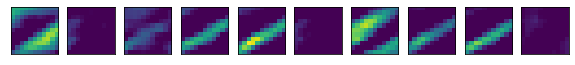

(1210, 200)


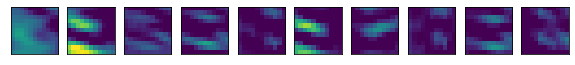

(1210, 200)


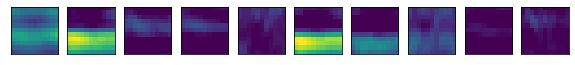

(1210, 200)


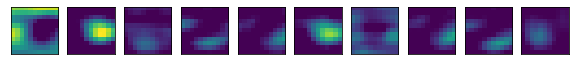

(1210, 200)


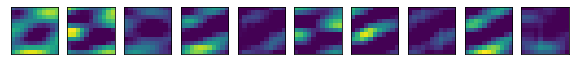

(1210, 200)


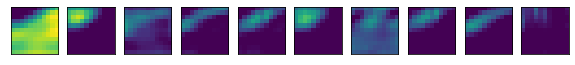

(1210, 200)


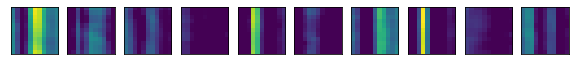

(1210, 200)


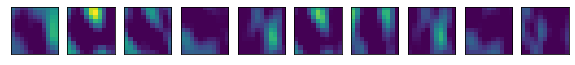

(1210, 200)


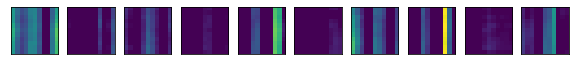

(1210, 200)


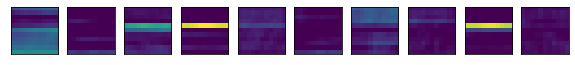

(1210, 200)


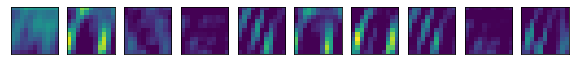

(1210, 200)


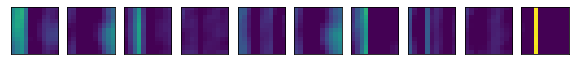

(1210, 200)


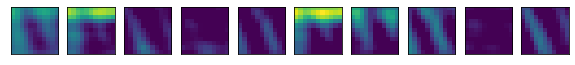

(1210, 200)


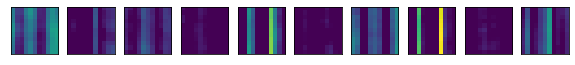

(1210, 200)


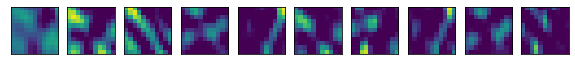

(1210, 200)


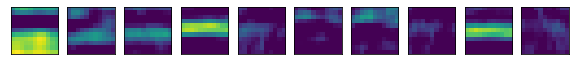

(1210, 200)


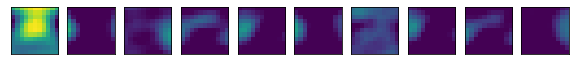

(1210, 200)


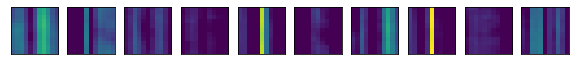

(1210, 200)


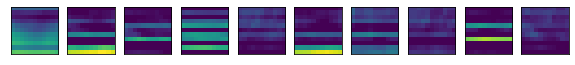

(1210, 200)


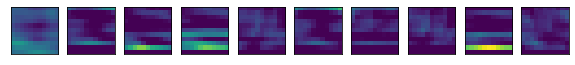

(1210, 200)


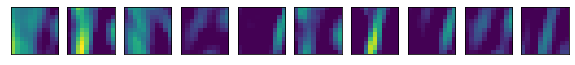

(1210, 200)


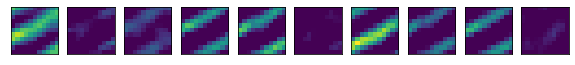

(1210, 200)


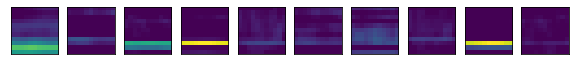

(1210, 200)


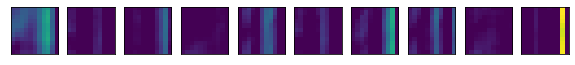

(1210, 200)


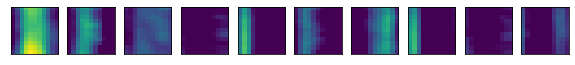

(1210, 200)


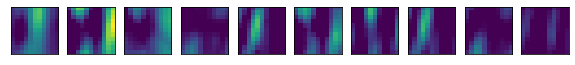

(1210, 200)


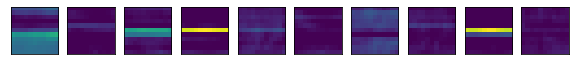

(1210, 200)


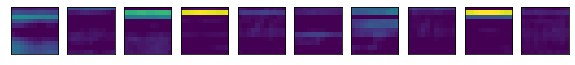

(1210, 200)


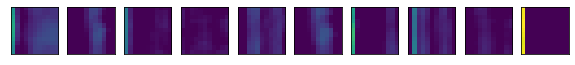

(1210, 200)


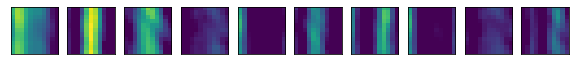

(1210, 200)


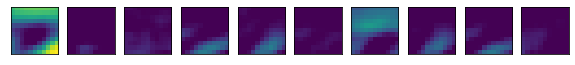

(1210, 200)


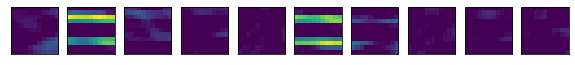

(1210, 200)


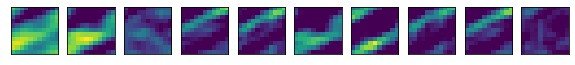

(1210, 200)


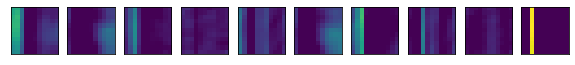

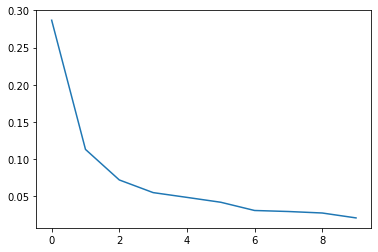

(1210, 10)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



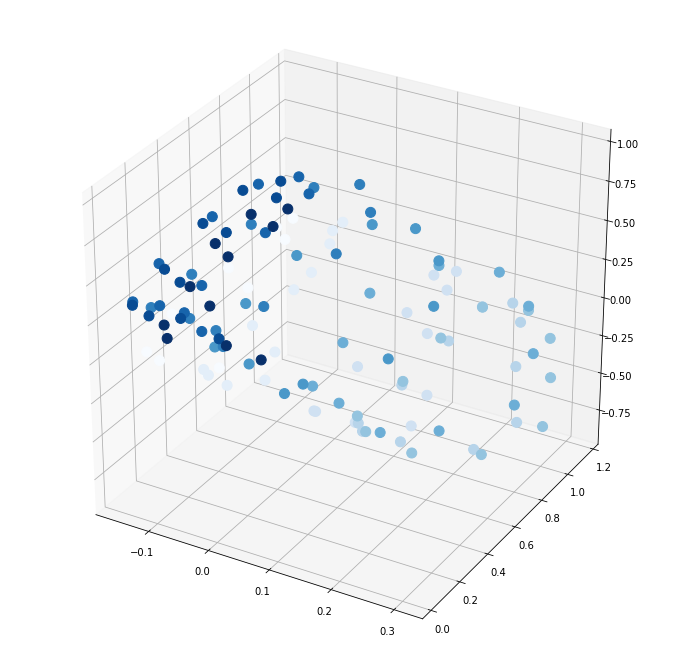

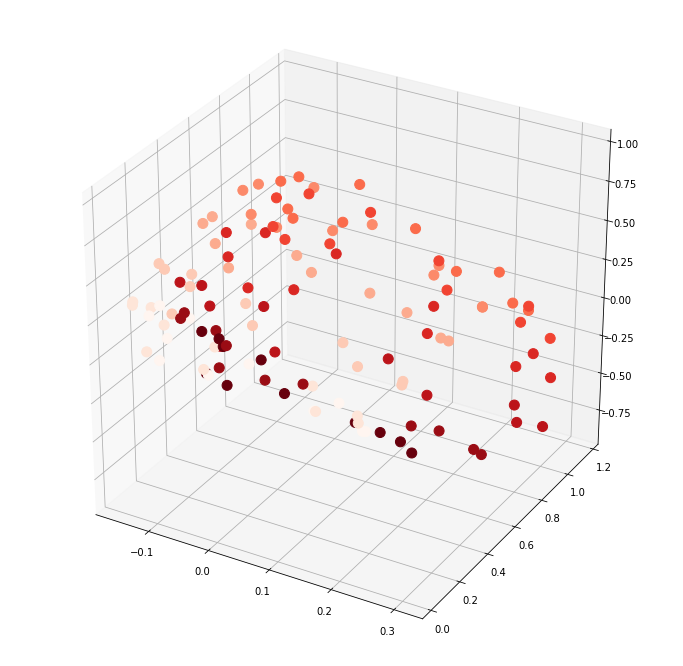

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=200, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=10)

## For 3D epoch 12 fix:

In [ ]:
N_epoch12_fix.shape

(845, 20, 256)

Rank-50 models:  min obj, 0.42;  max obj, 0.42;  time to fit, 24.2s


Rank-75 models:  min obj, 0.41;  max obj, 0.41;  time to fit, 26.6s


Rank-100 models:  min obj, 0.39;  max obj, 0.39;  time to fit, 37.2s


Rank-125 models:  min obj, 0.38;  max obj, 0.38;  time to fit, 75.0s


[0.38008540615660197]
[0.4185638763346941, 0.4054939898592136, 0.3939943238441237, 0.38008540615660197]
[50, 75, 100, 125]


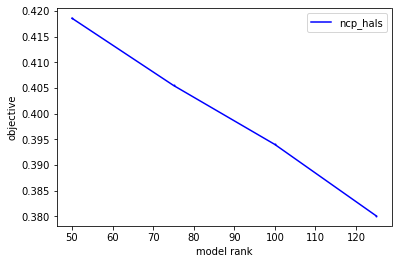

In [ ]:
ensembles_12 = get_tensor_factors(N_epoch12_fix, ranks = [50, 75,100,125])

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_12}
mdic
savemat("ensembles_12.mat", mdic)

In [ ]:
rep = 0
ranks = [125]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_12['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

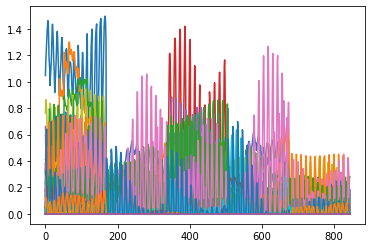

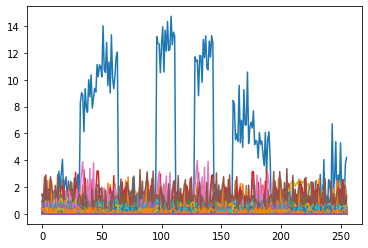

(845, 125)


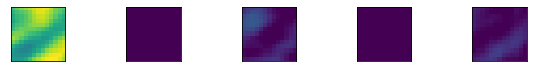

(845, 125)


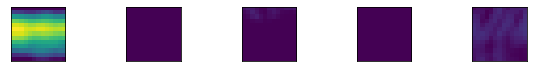

(845, 125)


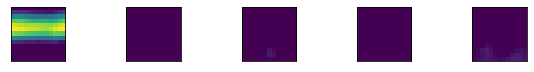

(845, 125)


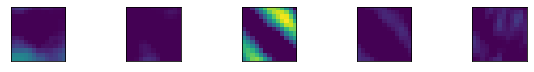

(845, 125)


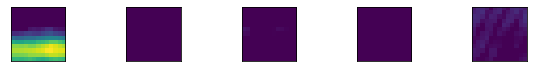

(845, 125)


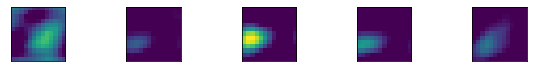

(845, 125)


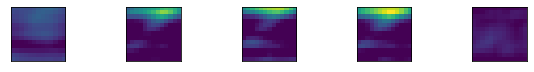

(845, 125)


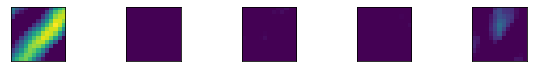

(845, 125)


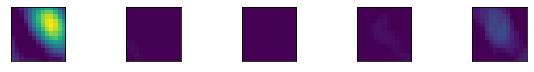

(845, 125)


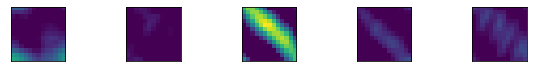

(845, 125)


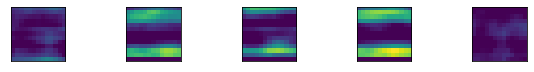

(845, 125)


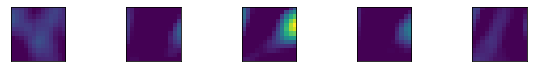

(845, 125)


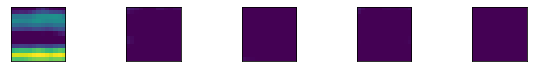

(845, 125)


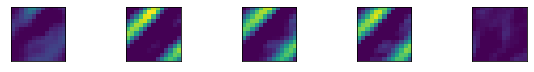

(845, 125)


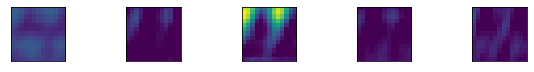

(845, 125)


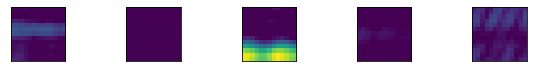

(845, 125)


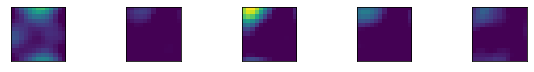

(845, 125)


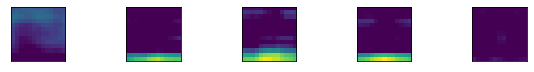

(845, 125)


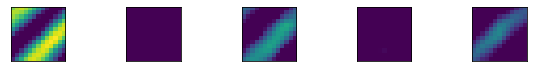

(845, 125)


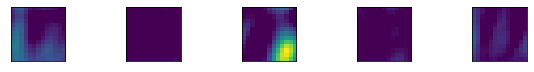

(845, 125)


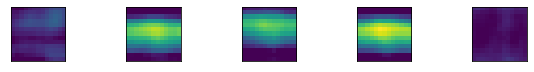

(845, 125)


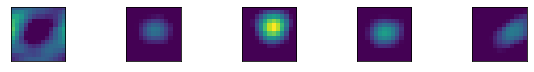

(845, 125)


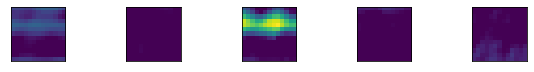

(845, 125)


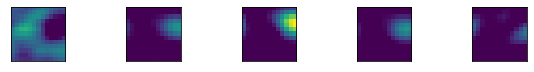

(845, 125)


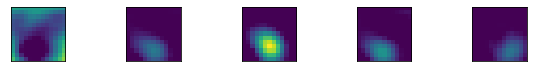

(845, 125)


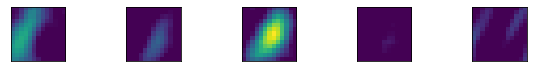

(845, 125)


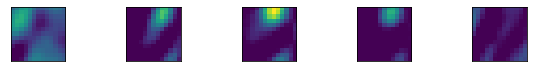

(845, 125)


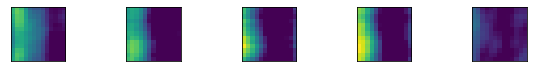

(845, 125)


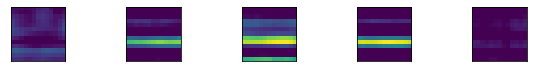

(845, 125)


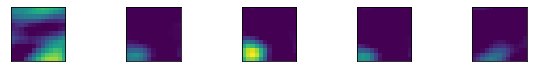

(845, 125)


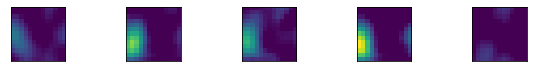

(845, 125)


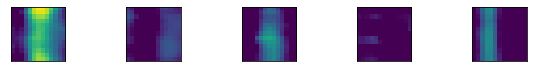

(845, 125)


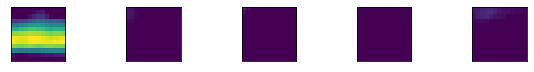

(845, 125)


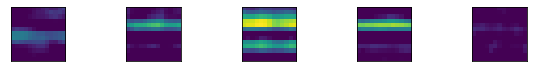

(845, 125)


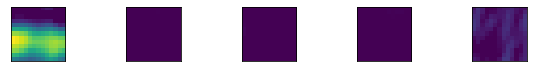

(845, 125)


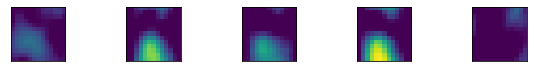

(845, 125)


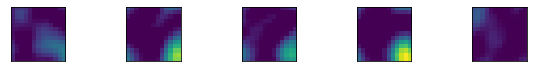

(845, 125)


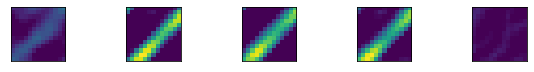

(845, 125)


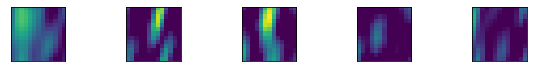

(845, 125)


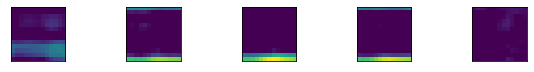

(845, 125)


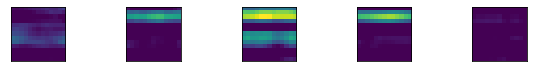

(845, 125)


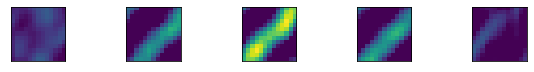

(845, 125)


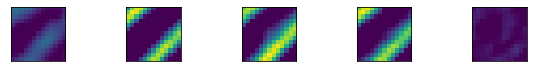

(845, 125)


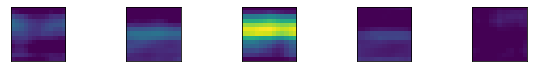

(845, 125)


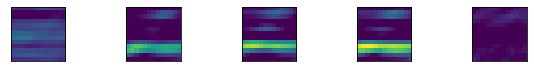

(845, 125)


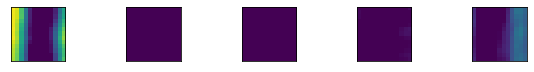

(845, 125)


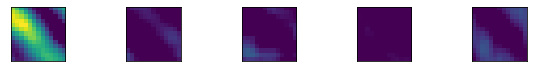

(845, 125)


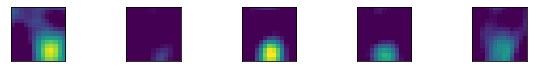

(845, 125)


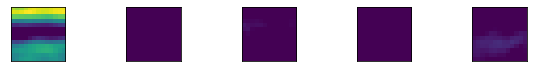

(845, 125)


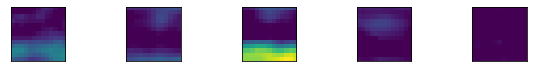

(845, 125)


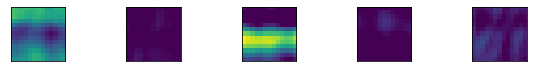

(845, 125)


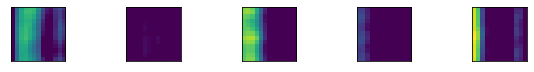

(845, 125)


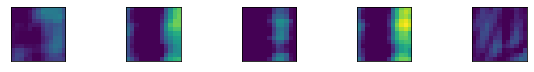

(845, 125)


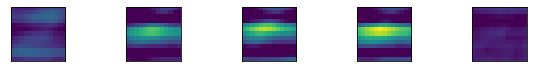

(845, 125)


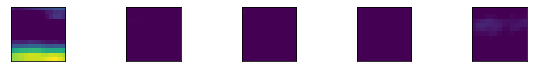

(845, 125)


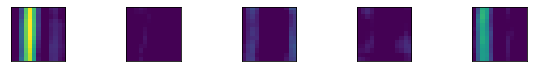

(845, 125)


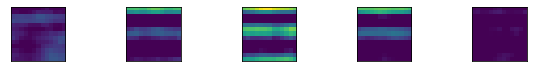

(845, 125)


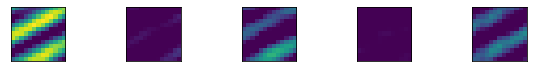

(845, 125)


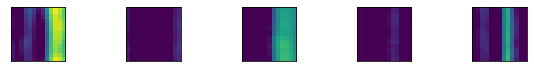

(845, 125)


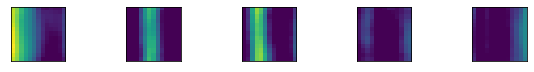

(845, 125)


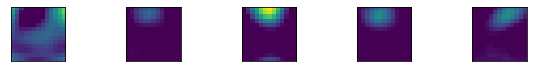

(845, 125)


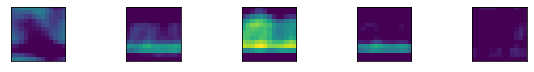

(845, 125)


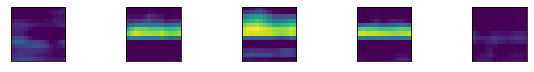

(845, 125)


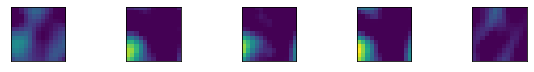

(845, 125)


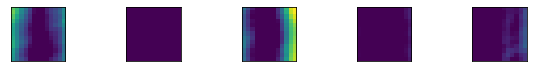

(845, 125)


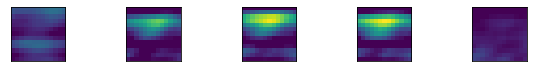

(845, 125)


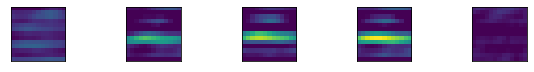

(845, 125)


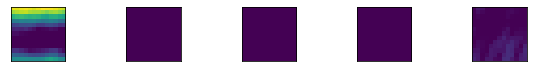

(845, 125)


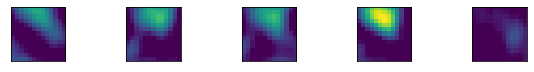

(845, 125)


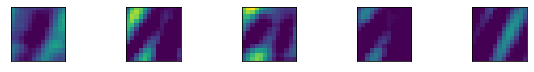

(845, 125)


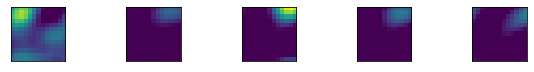

(845, 125)


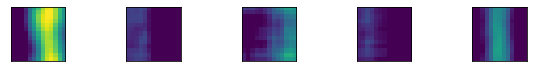

(845, 125)


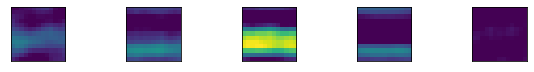

(845, 125)


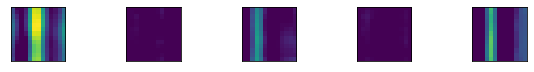

(845, 125)


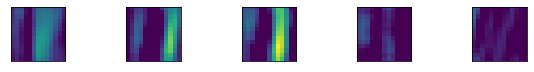

(845, 125)


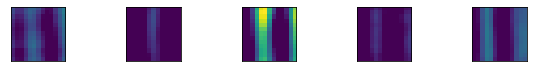

(845, 125)


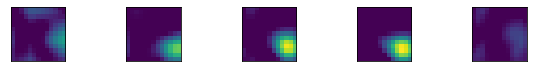

(845, 125)


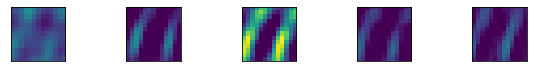

(845, 125)


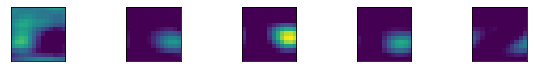

(845, 125)


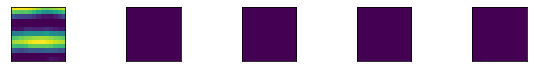

(845, 125)


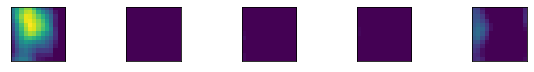

(845, 125)


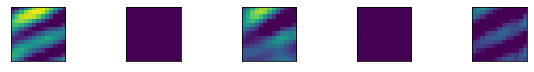

(845, 125)


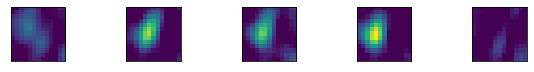

(845, 125)


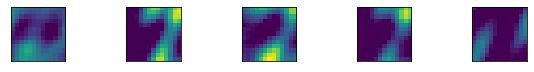

(845, 125)


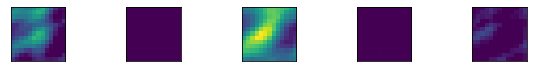

(845, 125)


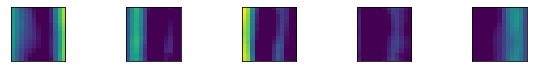

(845, 125)


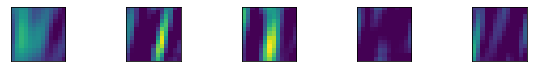

(845, 125)


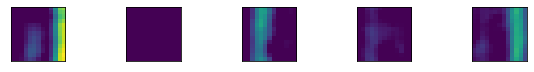

(845, 125)


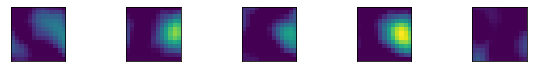

(845, 125)


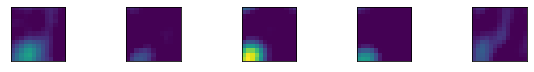

(845, 125)


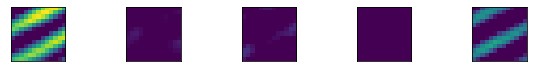

(845, 125)


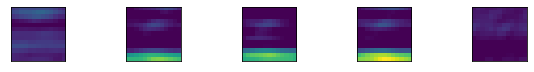

(845, 125)


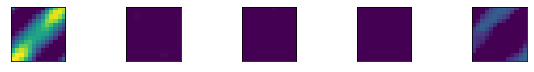

(845, 125)


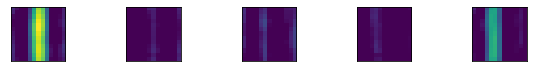

(845, 125)


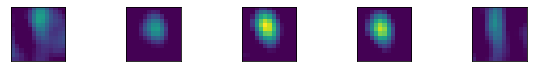

(845, 125)


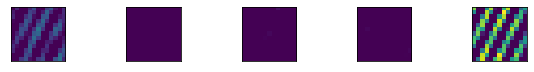

(845, 125)


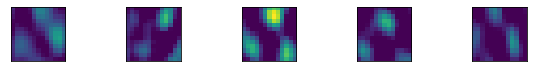

(845, 125)


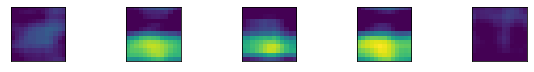

(845, 125)


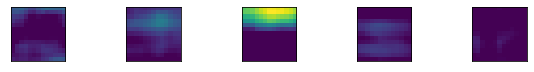

(845, 125)


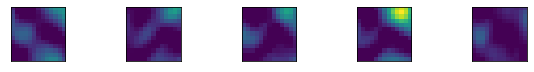

(845, 125)


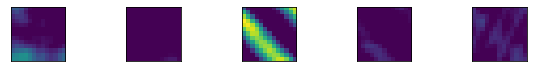

(845, 125)


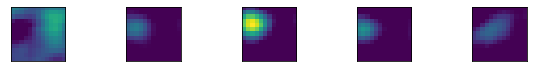

(845, 125)


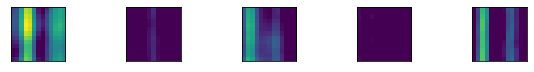

(845, 125)


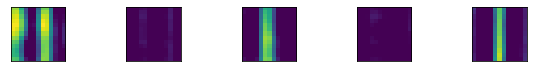

(845, 125)


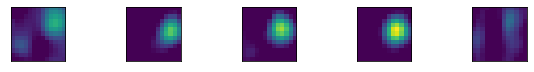

(845, 125)


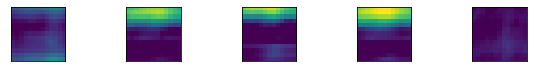

(845, 125)


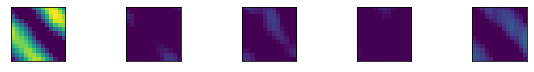

(845, 125)


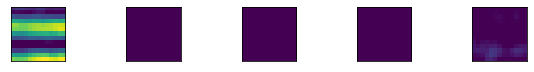

(845, 125)


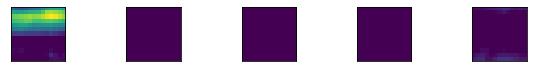

(845, 125)


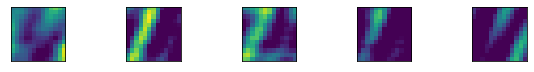

(845, 125)


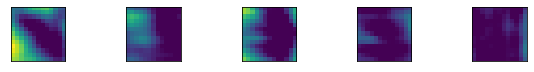

(845, 125)


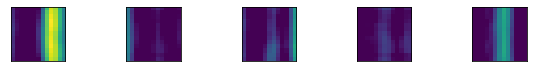

(845, 125)


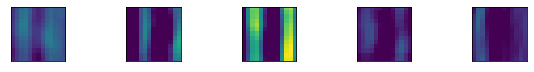

(845, 125)


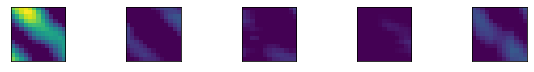

(845, 125)


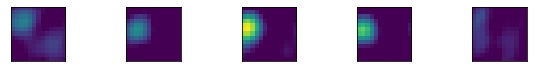

(845, 125)


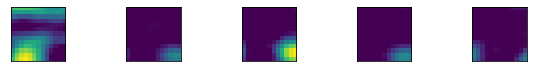

(845, 125)


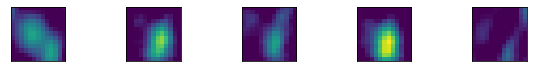

(845, 125)


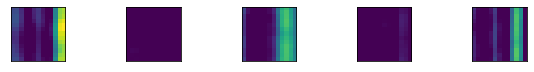

(845, 125)


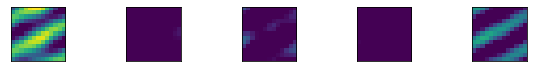

(845, 125)


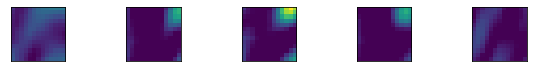

(845, 125)


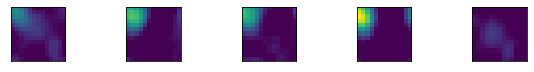

(845, 125)


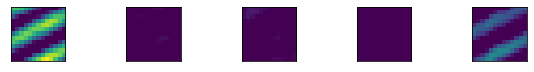

(845, 125)


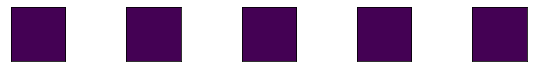

(845, 125)


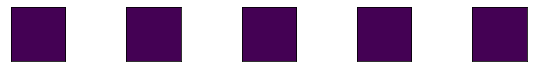

(845, 125)


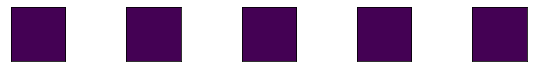

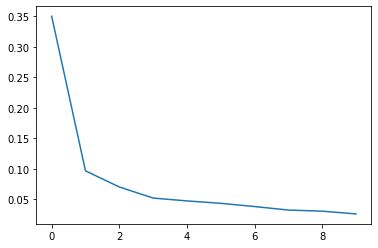

(845, 10)
(845,)
0 169
(845,)
1 169
(845,)
2 169
(845,)
3 169
(845,)
4 169


0 0
1 169
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



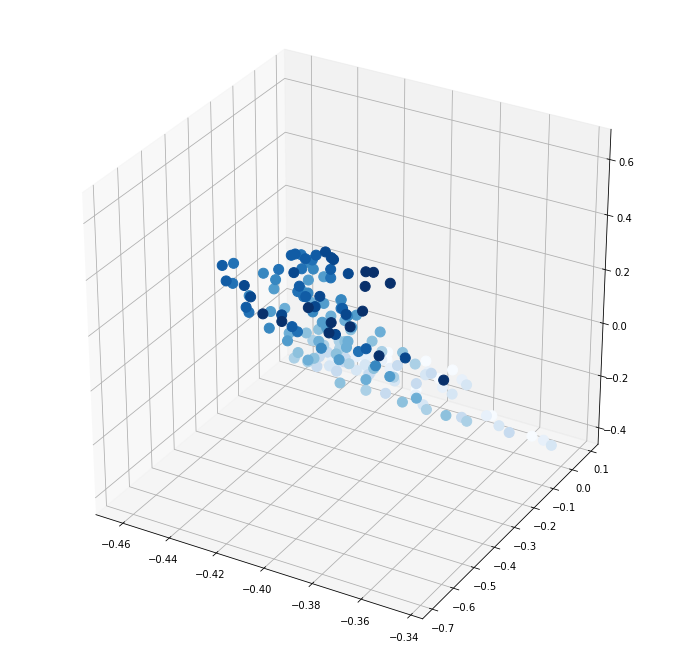

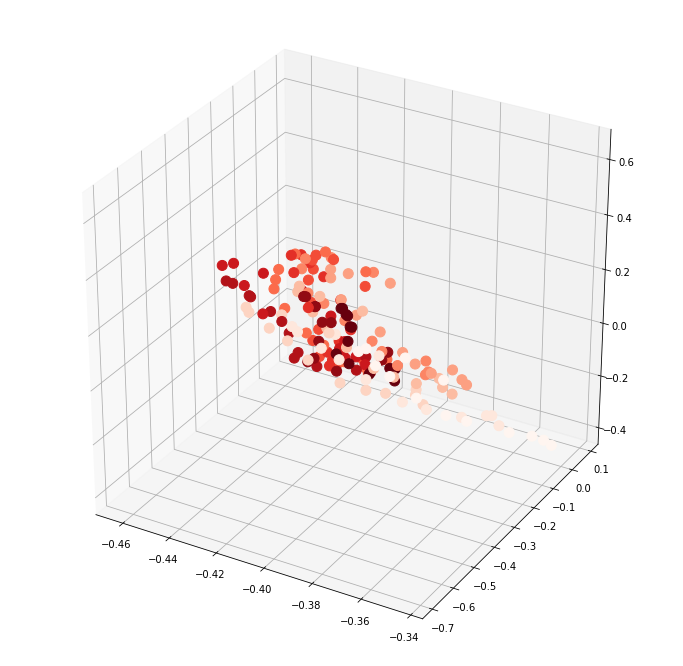

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=125, n_max_feature_maps=5, feature_map_side=13)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=5)

## For 3D epoch 14 fix:

In [ ]:
N_epoch14_fix.shape

(845, 20, 256)

Rank-50 models:  min obj, 0.43;  max obj, 0.43;  time to fit, 26.9s


Rank-75 models:  min obj, 0.42;  max obj, 0.42;  time to fit, 32.4s


Rank-100 models:  min obj, 0.40;  max obj, 0.40;  time to fit, 71.8s


Rank-125 models:  min obj, 0.40;  max obj, 0.40;  time to fit, 53.4s


[0.39516008808864383]
[0.4334889805341758, 0.41950414961046856, 0.4036908810868141, 0.39516008808864383]
[50, 75, 100, 125]


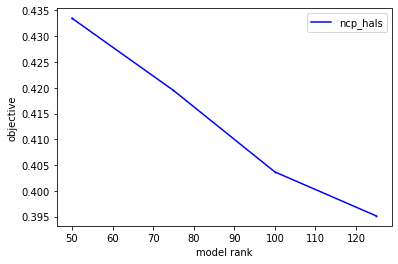

In [ ]:
ensembles_14 = get_tensor_factors(N_epoch14_fix, ranks = [50, 75,100,125])

In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_14}
mdic
savemat("ensembles_14.mat", mdic)

In [ ]:
rep = 0
ranks = [125]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_14['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

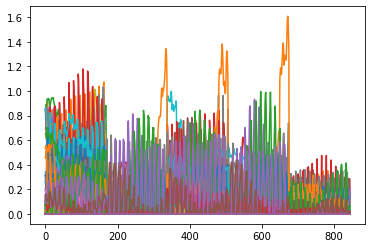

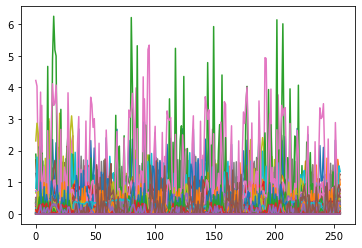

(845, 125)


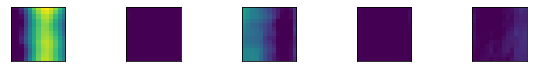

(845, 125)


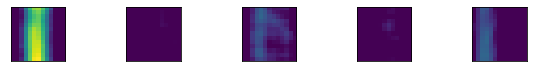

(845, 125)


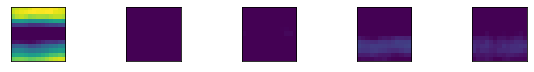

(845, 125)


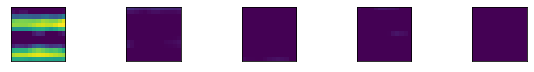

(845, 125)


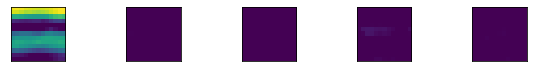

(845, 125)


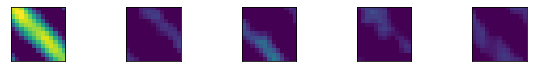

(845, 125)


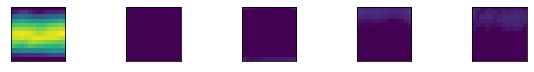

(845, 125)


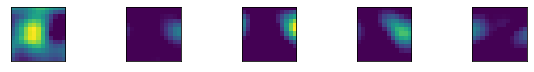

(845, 125)


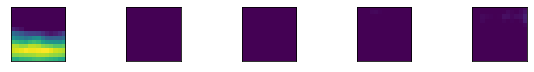

(845, 125)


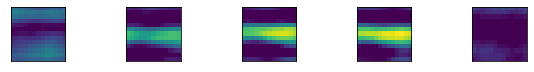

(845, 125)


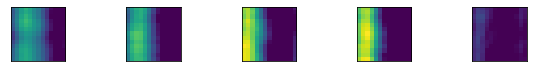

(845, 125)


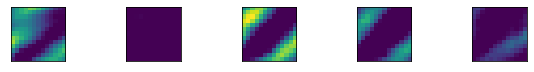

(845, 125)


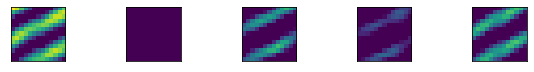

(845, 125)


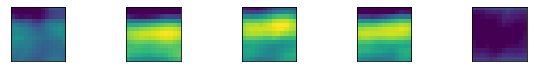

(845, 125)


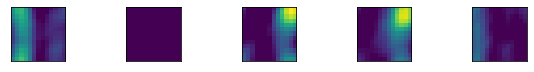

(845, 125)


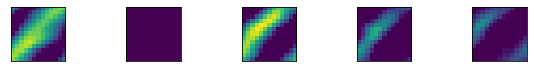

(845, 125)


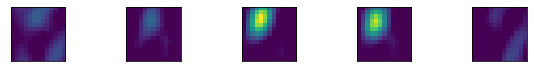

(845, 125)


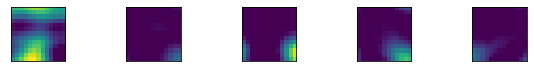

(845, 125)


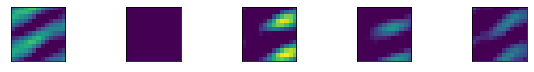

(845, 125)


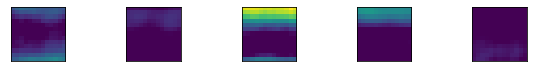

(845, 125)


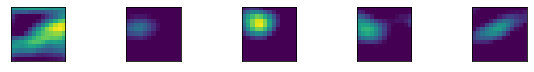

(845, 125)


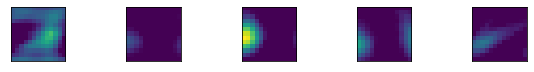

(845, 125)


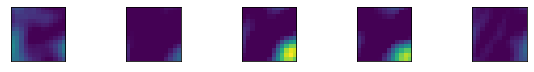

(845, 125)


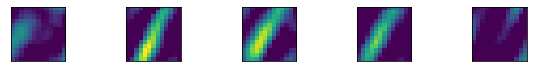

(845, 125)


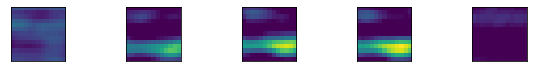

(845, 125)


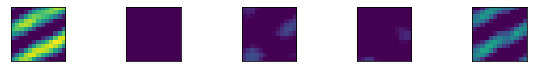

(845, 125)


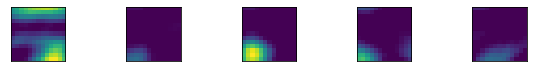

(845, 125)


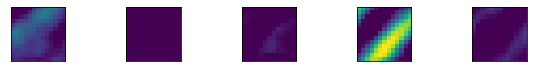

(845, 125)


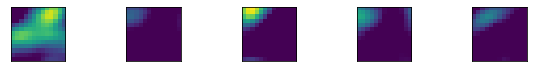

(845, 125)


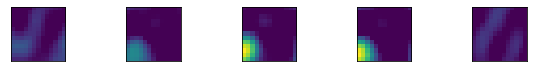

(845, 125)


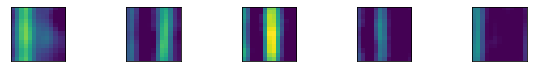

(845, 125)


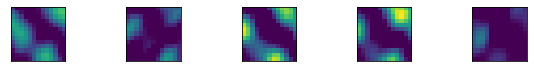

(845, 125)


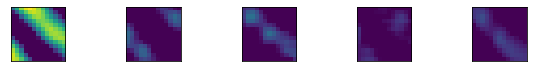

(845, 125)


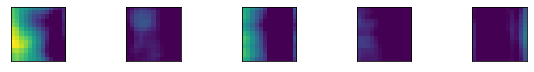

(845, 125)


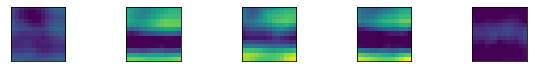

(845, 125)


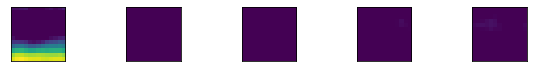

(845, 125)


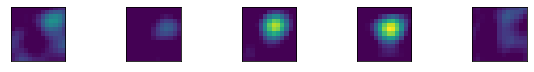

(845, 125)


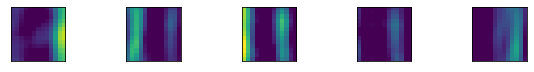

(845, 125)


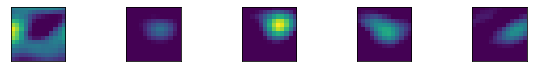

(845, 125)


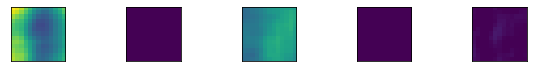

(845, 125)


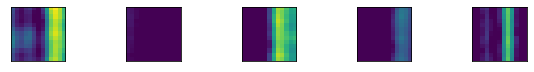

(845, 125)


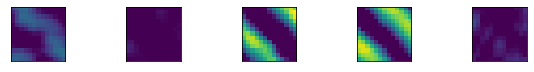

(845, 125)


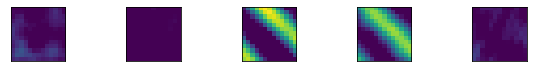

(845, 125)


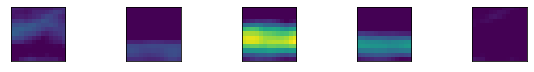

(845, 125)


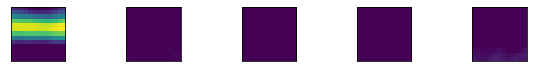

(845, 125)


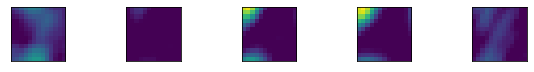

(845, 125)


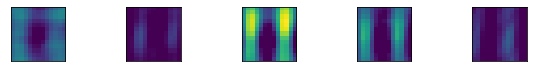

(845, 125)


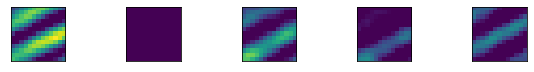

(845, 125)


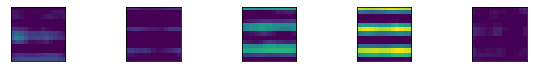

(845, 125)


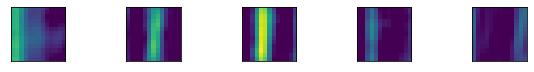

(845, 125)


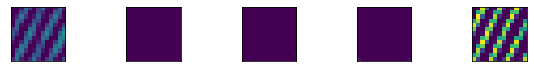

(845, 125)


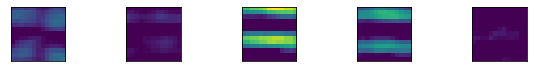

(845, 125)


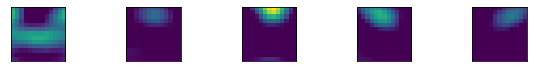

(845, 125)


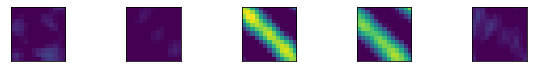

(845, 125)


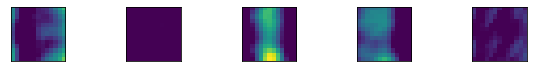

(845, 125)


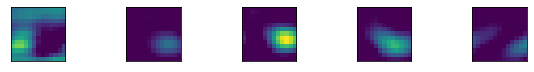

(845, 125)


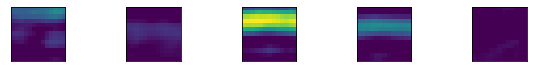

(845, 125)


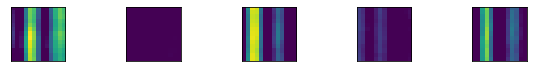

(845, 125)


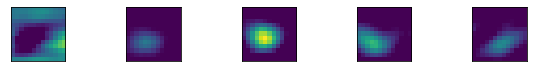

(845, 125)


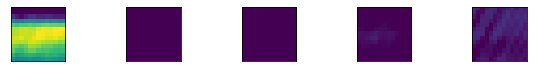

(845, 125)


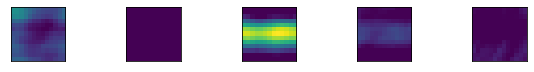

(845, 125)


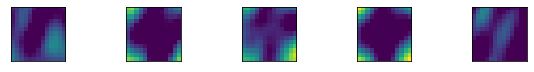

(845, 125)


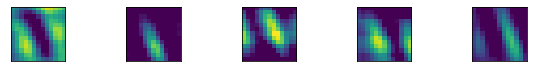

(845, 125)


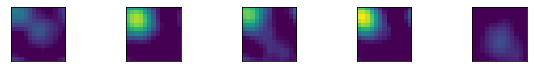

(845, 125)


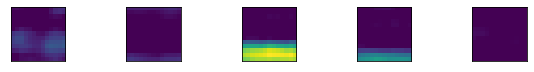

(845, 125)


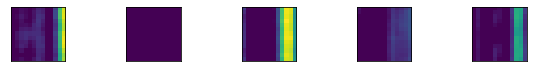

(845, 125)


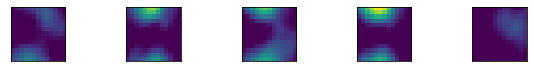

(845, 125)


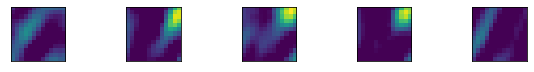

(845, 125)


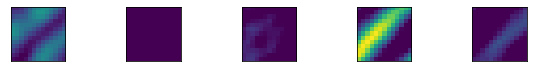

(845, 125)


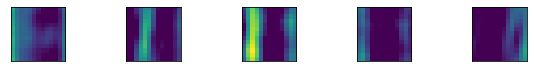

(845, 125)


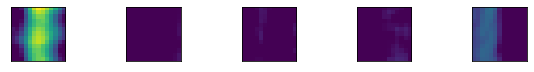

(845, 125)


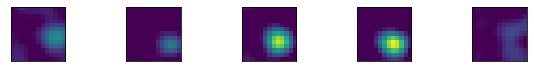

(845, 125)


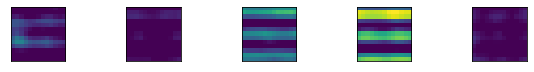

(845, 125)


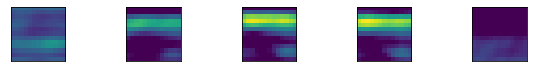

(845, 125)


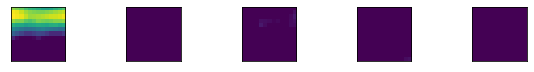

(845, 125)


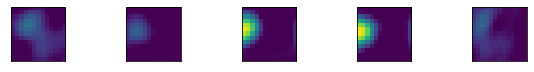

(845, 125)


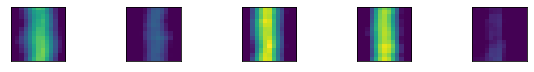

(845, 125)


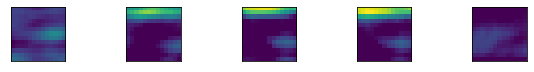

(845, 125)


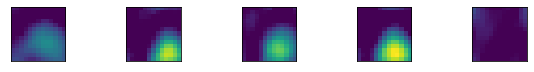

(845, 125)


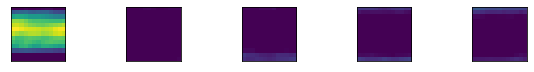

(845, 125)


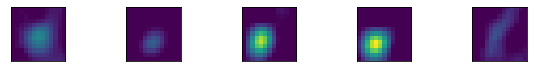

(845, 125)


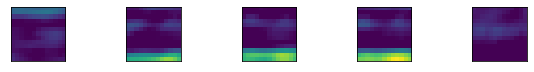

(845, 125)


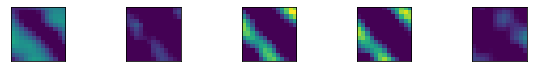

(845, 125)


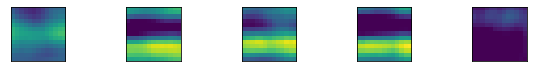

(845, 125)


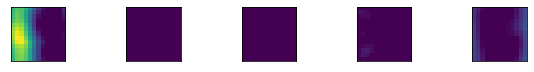

(845, 125)


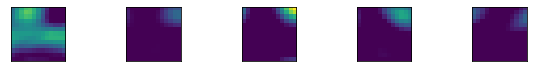

(845, 125)


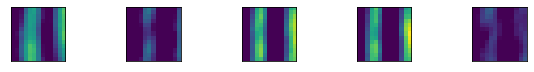

(845, 125)


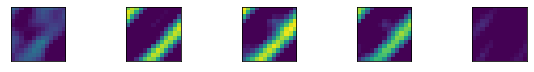

(845, 125)


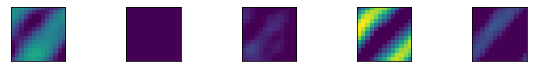

(845, 125)


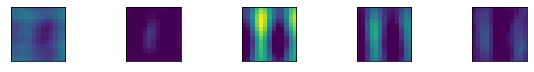

(845, 125)


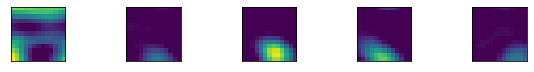

(845, 125)


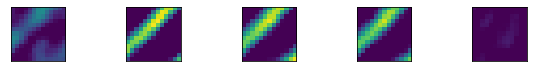

(845, 125)


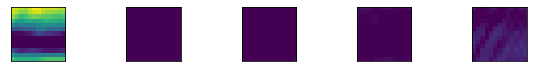

(845, 125)


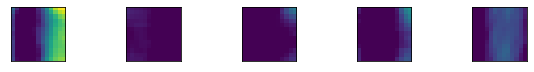

(845, 125)


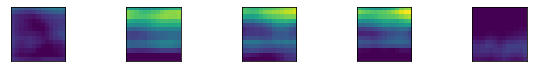

(845, 125)


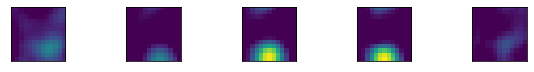

(845, 125)


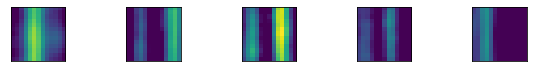

(845, 125)


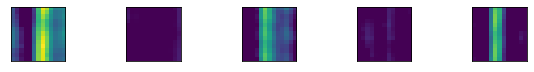

(845, 125)


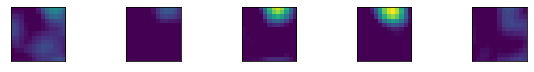

(845, 125)


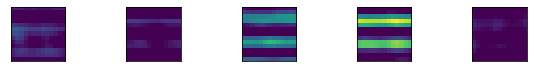

(845, 125)


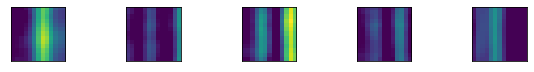

(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


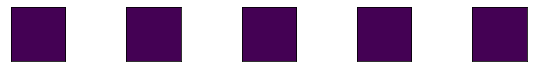

(845, 125)


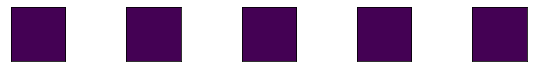

(845, 125)


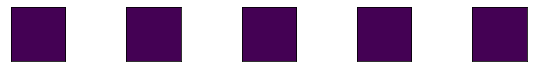

(845, 125)


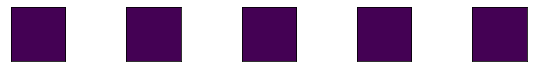

(845, 125)


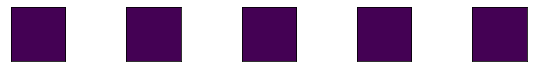

(845, 125)


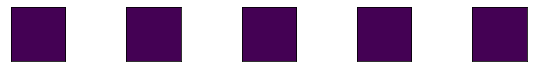

(845, 125)


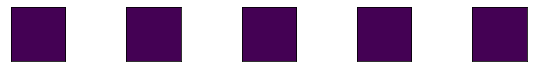

(845, 125)


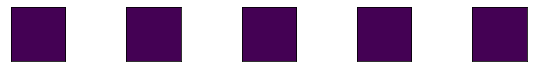

(845, 125)


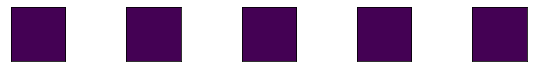

(845, 10)
(845,)
0 169
(845,)
1 169
(845,)
2 169
(845,)
3 169
(845,)
4 169


0 0
1 169
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=125, n_max_feature_maps=5, feature_map_side=13)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=5)

## For 3D epoch 16 max:

In [ ]:
N_epoch16_max.shape

(845, 20, 256)

In [ ]:
im_ind = 0
n_max_feature_maps = 5
feature_map_side = 13
# f_i, axes = plt.subplots(1,n_max_feature_maps,figsize=(10,1))
neuron_matrix = N_epoch16_max[:,im_ind,:]
for f_i in range(n_max_feature_maps):
  neuron_matrix_fi =  neuron_matrix[(f_i * feature_map_side ** 2): ((f_i+1) * feature_map_side ** 2),:]
  N_frames = 256
  feature_map_side = 13
  for t in range(N_frames):
    neuron_matrix_fi_t = neuron_matrix_fi[:, t].reshape((feature_map_side, feature_map_side))
    print(neuron_matrix_fi_t)
    vmin = neuron_matrix_fi_t.min()
    vmax = neuron_matrix_fi_t.max()
    plt.imshow(neuron_matrix_fi_t, vmin = vmin, vmax = vmax)
    # plt.set(xticks = [], yticks = [])
    plt.show()

[[0.46123421 0.5061967  0.58612501 0.73043329 0.81486219 0.8340931
  0.7671606  0.79021434 0.78226144 0.72742308 0.68295951 0.65820056
  0.66201341]
 [0.61931182 0.71164789 0.80159346 0.83567672 0.81756491 0.83266873
  0.84475609 0.86291725 0.85497655 0.79234212 0.69956309 0.71646109
  0.74953214]
 [0.72272093 0.83696412 0.86949383 0.82787433 0.86873996 0.89083138
  0.89051377 0.87235627 0.87857649 0.87098096 0.83497528 0.81767537
  0.85967649]
 [0.7975019  0.80988079 0.79801489 0.85549455 0.91717827 0.82856883
  0.839633   0.91500041 0.90019318 0.88326042 0.88347721 0.83201115
  0.83916685]
 [0.7438706  0.71614396 0.78968582 0.88502149 0.82623144 0.73785174
  0.82489247 0.94348574 0.90036157 0.87788295 0.85873532 0.80198168
  0.82707158]
 [0.61110493 0.68949088 0.82235564 0.86551056 0.68251524 0.63112365
  0.84199159 0.93241145 0.9502311  0.92914832 0.83098362 0.80001077
  0.8289621 ]
 [0.74542617 0.84511949 0.9304284  0.82950855 0.71249021 0.81010182
  0.93910544 0.94858783 0.9579137

[[0.38686056 0.46123421 0.5061967  0.58612501 0.73043329 0.81486219
  0.8340931  0.7671606  0.79021434 0.78226144 0.72742308 0.68295951
  0.65820056]
 [0.53533571 0.61931182 0.71164789 0.80159346 0.83567672 0.81756491
  0.83266873 0.84475609 0.86291725 0.85497655 0.79234212 0.69956309
  0.71646109]
 [0.73046273 0.72272093 0.83696412 0.86949383 0.82787433 0.86873996
  0.89083138 0.89051377 0.87235627 0.87857649 0.87098096 0.83497528
  0.81767537]
 [0.79250271 0.7975019  0.80988079 0.79801489 0.85549455 0.91717827
  0.82856883 0.839633   0.91500041 0.90019318 0.88326042 0.88347721
  0.83201115]
 [0.74620477 0.7438706  0.71614396 0.78968582 0.88502149 0.82623144
  0.73785174 0.82489247 0.94348574 0.90036157 0.87788295 0.85873532
  0.80198168]
 [0.71786329 0.61110493 0.68949088 0.82235564 0.86551056 0.68251524
  0.63112365 0.84199159 0.93241145 0.9502311  0.92914832 0.83098362
  0.80001077]
 [0.7032808  0.74542617 0.84511949 0.9304284  0.82950855 0.71249021
  0.81010182 0.93910544 0.948587

[[0.64328986 0.47408026 0.38686056 0.46123421 0.5061967  0.58612501
  0.73043329 0.81486219 0.8340931  0.7671606  0.79021434 0.78226144
  0.72742308]
 [0.68785348 0.58923054 0.53533571 0.61931182 0.71164789 0.80159346
  0.83567672 0.81756491 0.83266873 0.84475609 0.86291725 0.85497655
  0.79234212]
 [0.7774412  0.72461608 0.73046273 0.72272093 0.83696412 0.86949383
  0.82787433 0.86873996 0.89083138 0.89051377 0.87235627 0.87857649
  0.87098096]
 [0.8326643  0.81073144 0.79250271 0.7975019  0.80988079 0.79801489
  0.85549455 0.91717827 0.82856883 0.839633   0.91500041 0.90019318
  0.88326042]
 [0.82048874 0.79760788 0.74620477 0.7438706  0.71614396 0.78968582
  0.88502149 0.82623144 0.73785174 0.82489247 0.94348574 0.90036157
  0.87788295]
 [0.78897788 0.75067332 0.71786329 0.61110493 0.68949088 0.82235564
  0.86551056 0.68251524 0.63112365 0.84199159 0.93241145 0.9502311
  0.92914832]
 [0.79417182 0.71315502 0.7032808  0.74542617 0.84511949 0.9304284
  0.82950855 0.71249021 0.81010182

[[0.68295951 0.65820056 0.66201341 0.64328986 0.47408026 0.38686056
  0.46123421 0.5061967  0.58612501 0.73043329 0.81486219 0.8340931
  0.7671606 ]
 [0.69956309 0.71646109 0.74953214 0.68785348 0.58923054 0.53533571
  0.61931182 0.71164789 0.80159346 0.83567672 0.81756491 0.83266873
  0.84475609]
 [0.83497528 0.81767537 0.85967649 0.7774412  0.72461608 0.73046273
  0.72272093 0.83696412 0.86949383 0.82787433 0.86873996 0.89083138
  0.89051377]
 [0.88347721 0.83201115 0.83916685 0.8326643  0.81073144 0.79250271
  0.7975019  0.80988079 0.79801489 0.85549455 0.91717827 0.82856883
  0.839633  ]
 [0.85873532 0.80198168 0.82707158 0.82048874 0.79760788 0.74620477
  0.7438706  0.71614396 0.78968582 0.88502149 0.82623144 0.73785174
  0.82489247]
 [0.83098362 0.80001077 0.8289621  0.78897788 0.75067332 0.71786329
  0.61110493 0.68949088 0.82235564 0.86551056 0.68251524 0.63112365
  0.84199159]
 [0.88021948 0.8255194  0.75866955 0.79417182 0.71315502 0.7032808
  0.74542617 0.84511949 0.9304284 

[[0.77619113 0.79951624 0.79146973 0.73598585 0.69099888 0.66594849
  0.66980622 0.65086226 0.47966084 0.39141444 0.46666357 0.51215533
  0.5930245 ]
 [0.85470003 0.87307497 0.86504079 0.80166908 0.7077979  0.72489482
  0.75835516 0.69595046 0.59616659 0.54163735 0.62660197 0.72002496
  0.81102932]
 [0.90099633 0.8826251  0.88891854 0.8812336  0.84480408 0.82730053
  0.86979606 0.78659275 0.7331458  0.73906128 0.73122834 0.84681633
  0.87972897]
 [0.84951663 0.92577122 0.91078969 0.89365761 0.89387695 0.84180506
  0.84904499 0.8424659  0.82027486 0.80183156 0.80688959 0.8194142
  0.80740862]
 [0.83460258 0.95459186 0.91096006 0.88821684 0.86884381 0.8114221
  0.83680735 0.83014702 0.80699682 0.75498862 0.75262698 0.72457396
  0.79898151]
 [0.85190299 0.94338722 0.96141663 0.94008567 0.84076544 0.80942799
  0.83872013 0.79826523 0.75950977 0.72631353 0.61829847 0.69760713
  0.8320359 ]
 [0.95016    0.959754   0.96918973 0.96601838 0.89058086 0.83523689
  0.76760013 0.80352031 0.72154983

[[0.5061967  0.58612501 0.73043329 0.81486219 0.8340931  0.7671606
  0.79021434 0.78226144 0.72742308 0.68295951 0.65820056 0.66201341
  0.64328986]
 [0.71164789 0.80159346 0.83567672 0.81756491 0.83266873 0.84475609
  0.86291725 0.85497655 0.79234212 0.69956309 0.71646109 0.74953214
  0.68785348]
 [0.83696412 0.86949383 0.82787433 0.86873996 0.89083138 0.89051377
  0.87235627 0.87857649 0.87098096 0.83497528 0.81767537 0.85967649
  0.7774412 ]
 [0.80988079 0.79801489 0.85549455 0.91717827 0.82856883 0.839633
  0.91500041 0.90019318 0.88326042 0.88347721 0.83201115 0.83916685
  0.8326643 ]
 [0.71614396 0.78968582 0.88502149 0.82623144 0.73785174 0.82489247
  0.94348574 0.90036157 0.87788295 0.85873532 0.80198168 0.82707158
  0.82048874]
 [0.68949088 0.82235564 0.86551056 0.68251524 0.63112365 0.84199159
  0.93241145 0.9502311  0.92914832 0.83098362 0.80001077 0.8289621
  0.78897788]
 [0.84511949 0.9304284  0.82950855 0.71249021 0.81010182 0.93910544
  0.94858783 0.95791377 0.95477932 0

[[0.65820056 0.66201341 0.64328986 0.47408026 0.38686056 0.46123421
  0.5061967  0.58612501 0.73043329 0.81486219 0.8340931  0.7671606
  0.79021434]
 [0.71646109 0.74953214 0.68785348 0.58923054 0.53533571 0.61931182
  0.71164789 0.80159346 0.83567672 0.81756491 0.83266873 0.84475609
  0.86291725]
 [0.81767537 0.85967649 0.7774412  0.72461608 0.73046273 0.72272093
  0.83696412 0.86949383 0.82787433 0.86873996 0.89083138 0.89051377
  0.87235627]
 [0.83201115 0.83916685 0.8326643  0.81073144 0.79250271 0.7975019
  0.80988079 0.79801489 0.85549455 0.91717827 0.82856883 0.839633
  0.91500041]
 [0.80198168 0.82707158 0.82048874 0.79760788 0.74620477 0.7438706
  0.71614396 0.78968582 0.88502149 0.82623144 0.73785174 0.82489247
  0.94348574]
 [0.80001077 0.8289621  0.78897788 0.75067332 0.71786329 0.61110493
  0.68949088 0.82235564 0.86551056 0.68251524 0.63112365 0.84199159
  0.93241145]
 [0.8255194  0.75866955 0.79417182 0.71315502 0.7032808  0.74542617
  0.84511949 0.9304284  0.82950855 0.

[[0.82445424 0.84391152 0.77619113 0.79951624 0.79146973 0.73598585
  0.69099888 0.66594849 0.66980622 0.65086226 0.47966084 0.39141444
  0.46666357]
 [0.82718877 0.84247038 0.85470003 0.87307497 0.86504079 0.80166908
  0.7077979  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735
  0.62660197]
 [0.87896622 0.90131768 0.90099633 0.8826251  0.88891854 0.8812336
  0.84480408 0.82730053 0.86979606 0.78659275 0.7331458  0.73906128
  0.73122834]
 [0.92797472 0.83832222 0.84951663 0.92577122 0.91078969 0.89365761
  0.89387695 0.84180506 0.84904499 0.8424659  0.82027486 0.80183156
  0.80688959]
 [0.83595732 0.74653727 0.83460258 0.95459186 0.91096006 0.88821684
  0.86884381 0.8114221  0.83680735 0.83014702 0.80699682 0.75498862
  0.75262698]
 [0.69054938 0.63855284 0.85190299 0.94338722 0.96141663 0.94008567
  0.84076544 0.80942799 0.83872013 0.79826523 0.75950977 0.72631353
  0.61829847]
 [0.72087719 0.81963783 0.95016    0.959754   0.96918973 0.96601838
  0.89058086 0.83523689 0.7676001

[[0.66201341 0.64328986 0.47408026 0.38686056 0.46123421 0.5061967
  0.58612501 0.73043329 0.81486219 0.8340931  0.7671606  0.79021434
  0.78226144]
 [0.74953214 0.68785348 0.58923054 0.53533571 0.61931182 0.71164789
  0.80159346 0.83567672 0.81756491 0.83266873 0.84475609 0.86291725
  0.85497655]
 [0.85967649 0.7774412  0.72461608 0.73046273 0.72272093 0.83696412
  0.86949383 0.82787433 0.86873996 0.89083138 0.89051377 0.87235627
  0.87857649]
 [0.83916685 0.8326643  0.81073144 0.79250271 0.7975019  0.80988079
  0.79801489 0.85549455 0.91717827 0.82856883 0.839633   0.91500041
  0.90019318]
 [0.82707158 0.82048874 0.79760788 0.74620477 0.7438706  0.71614396
  0.78968582 0.88502149 0.82623144 0.73785174 0.82489247 0.94348574
  0.90036157]
 [0.8289621  0.78897788 0.75067332 0.71786329 0.61110493 0.68949088
  0.82235564 0.86551056 0.68251524 0.63112365 0.84199159 0.93241145
  0.9502311 ]
 [0.75866955 0.79417182 0.71315502 0.7032808  0.74542617 0.84511949
  0.9304284  0.82950855 0.7124902

[[0.73043329 0.81486219 0.8340931  0.7671606  0.79021434 0.78226144
  0.72742308 0.68295951 0.65820056 0.66201341 0.64328986 0.47408026
  0.38686056]
 [0.83567672 0.81756491 0.83266873 0.84475609 0.86291725 0.85497655
  0.79234212 0.69956309 0.71646109 0.74953214 0.68785348 0.58923054
  0.53533571]
 [0.82787433 0.86873996 0.89083138 0.89051377 0.87235627 0.87857649
  0.87098096 0.83497528 0.81767537 0.85967649 0.7774412  0.72461608
  0.73046273]
 [0.85549455 0.91717827 0.82856883 0.839633   0.91500041 0.90019318
  0.88326042 0.88347721 0.83201115 0.83916685 0.8326643  0.81073144
  0.79250271]
 [0.88502149 0.82623144 0.73785174 0.82489247 0.94348574 0.90036157
  0.87788295 0.85873532 0.80198168 0.82707158 0.82048874 0.79760788
  0.74620477]
 [0.86551056 0.68251524 0.63112365 0.84199159 0.93241145 0.9502311
  0.92914832 0.83098362 0.80001077 0.8289621  0.78897788 0.75067332
  0.71786329]
 [0.82950855 0.71249021 0.81010182 0.93910544 0.94858783 0.95791377
  0.95477932 0.88021948 0.8255194

[[0.72742308 0.68295951 0.65820056 0.66201341 0.64328986 0.47408026
  0.38686056 0.46123421 0.5061967  0.58612501 0.73043329 0.81486219
  0.8340931 ]
 [0.79234212 0.69956309 0.71646109 0.74953214 0.68785348 0.58923054
  0.53533571 0.61931182 0.71164789 0.80159346 0.83567672 0.81756491
  0.83266873]
 [0.87098096 0.83497528 0.81767537 0.85967649 0.7774412  0.72461608
  0.73046273 0.72272093 0.83696412 0.86949383 0.82787433 0.86873996
  0.89083138]
 [0.88326042 0.88347721 0.83201115 0.83916685 0.8326643  0.81073144
  0.79250271 0.7975019  0.80988079 0.79801489 0.85549455 0.91717827
  0.82856883]
 [0.87788295 0.85873532 0.80198168 0.82707158 0.82048874 0.79760788
  0.74620477 0.7438706  0.71614396 0.78968582 0.88502149 0.82623144
  0.73785174]
 [0.92914832 0.83098362 0.80001077 0.8289621  0.78897788 0.75067332
  0.71786329 0.61110493 0.68949088 0.82235564 0.86551056 0.68251524
  0.63112365]
 [0.95477932 0.88021948 0.8255194  0.75866955 0.79417182 0.71315502
  0.7032808  0.74542617 0.845119

[[0.47408026 0.38686056 0.46123421 0.5061967  0.58612501 0.73043329
  0.81486219 0.8340931  0.7671606  0.79021434 0.78226144 0.72742308
  0.68295951]
 [0.58923054 0.53533571 0.61931182 0.71164789 0.80159346 0.83567672
  0.81756491 0.83266873 0.84475609 0.86291725 0.85497655 0.79234212
  0.69956309]
 [0.72461608 0.73046273 0.72272093 0.83696412 0.86949383 0.82787433
  0.86873996 0.89083138 0.89051377 0.87235627 0.87857649 0.87098096
  0.83497528]
 [0.81073144 0.79250271 0.7975019  0.80988079 0.79801489 0.85549455
  0.91717827 0.82856883 0.839633   0.91500041 0.90019318 0.88326042
  0.88347721]
 [0.79760788 0.74620477 0.7438706  0.71614396 0.78968582 0.88502149
  0.82623144 0.73785174 0.82489247 0.94348574 0.90036157 0.87788295
  0.85873532]
 [0.75067332 0.71786329 0.61110493 0.68949088 0.82235564 0.86551056
  0.68251524 0.63112365 0.84199159 0.93241145 0.9502311  0.92914832
  0.83098362]
 [0.71315502 0.7032808  0.74542617 0.84511949 0.9304284  0.82950855
  0.71249021 0.81010182 0.939105

[[0.58612501 0.73043329 0.81486219 0.8340931  0.7671606  0.79021434
  0.78226144 0.72742308 0.68295951 0.65820056 0.66201341 0.64328986
  0.47408026]
 [0.80159346 0.83567672 0.81756491 0.83266873 0.84475609 0.86291725
  0.85497655 0.79234212 0.69956309 0.71646109 0.74953214 0.68785348
  0.58923054]
 [0.86949383 0.82787433 0.86873996 0.89083138 0.89051377 0.87235627
  0.87857649 0.87098096 0.83497528 0.81767537 0.85967649 0.7774412
  0.72461608]
 [0.79801489 0.85549455 0.91717827 0.82856883 0.839633   0.91500041
  0.90019318 0.88326042 0.88347721 0.83201115 0.83916685 0.8326643
  0.81073144]
 [0.78968582 0.88502149 0.82623144 0.73785174 0.82489247 0.94348574
  0.90036157 0.87788295 0.85873532 0.80198168 0.82707158 0.82048874
  0.79760788]
 [0.82235564 0.86551056 0.68251524 0.63112365 0.84199159 0.93241145
  0.9502311  0.92914832 0.83098362 0.80001077 0.8289621  0.78897788
  0.75067332]
 [0.9304284  0.82950855 0.71249021 0.81010182 0.93910544 0.94858783
  0.95791377 0.95477932 0.88021948

[[0.84391152 0.77619113 0.79951624 0.79146973 0.73598585 0.69099888
  0.66594849 0.66980622 0.65086226 0.47966084 0.39141444 0.46666357
  0.51215533]
 [0.84247038 0.85470003 0.87307497 0.86504079 0.80166908 0.7077979
  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735 0.62660197
  0.72002496]
 [0.90131768 0.90099633 0.8826251  0.88891854 0.8812336  0.84480408
  0.82730053 0.86979606 0.78659275 0.7331458  0.73906128 0.73122834
  0.84681633]
 [0.83832222 0.84951663 0.92577122 0.91078969 0.89365761 0.89387695
  0.84180506 0.84904499 0.8424659  0.82027486 0.80183156 0.80688959
  0.8194142 ]
 [0.74653727 0.83460258 0.95459186 0.91096006 0.88821684 0.86884381
  0.8114221  0.83680735 0.83014702 0.80699682 0.75498862 0.75262698
  0.72457396]
 [0.63855284 0.85190299 0.94338722 0.96141663 0.94008567 0.84076544
  0.80942799 0.83872013 0.79826523 0.75950977 0.72631353 0.61829847
  0.69760713]
 [0.81963783 0.95016    0.959754   0.96918973 0.96601838 0.89058086
  0.83523689 0.76760013 0.8035203

[[0.79021434 0.78226144 0.72742308 0.68295951 0.65820056 0.66201341
  0.64328986 0.47408026 0.38686056 0.46123421 0.5061967  0.58612501
  0.73043329]
 [0.86291725 0.85497655 0.79234212 0.69956309 0.71646109 0.74953214
  0.68785348 0.58923054 0.53533571 0.61931182 0.71164789 0.80159346
  0.83567672]
 [0.87235627 0.87857649 0.87098096 0.83497528 0.81767537 0.85967649
  0.7774412  0.72461608 0.73046273 0.72272093 0.83696412 0.86949383
  0.82787433]
 [0.91500041 0.90019318 0.88326042 0.88347721 0.83201115 0.83916685
  0.8326643  0.81073144 0.79250271 0.7975019  0.80988079 0.79801489
  0.85549455]
 [0.94348574 0.90036157 0.87788295 0.85873532 0.80198168 0.82707158
  0.82048874 0.79760788 0.74620477 0.7438706  0.71614396 0.78968582
  0.88502149]
 [0.93241145 0.9502311  0.92914832 0.83098362 0.80001077 0.8289621
  0.78897788 0.75067332 0.71786329 0.61110493 0.68949088 0.82235564
  0.86551056]
 [0.94858783 0.95791377 0.95477932 0.88021948 0.8255194  0.75866955
  0.79417182 0.71315502 0.7032808

[[0.78226144 0.72742308 0.68295951 0.65820056 0.66201341 0.64328986
  0.47408026 0.38686056 0.46123421 0.5061967  0.58612501 0.73043329
  0.81486219]
 [0.85497655 0.79234212 0.69956309 0.71646109 0.74953214 0.68785348
  0.58923054 0.53533571 0.61931182 0.71164789 0.80159346 0.83567672
  0.81756491]
 [0.87857649 0.87098096 0.83497528 0.81767537 0.85967649 0.7774412
  0.72461608 0.73046273 0.72272093 0.83696412 0.86949383 0.82787433
  0.86873996]
 [0.90019318 0.88326042 0.88347721 0.83201115 0.83916685 0.8326643
  0.81073144 0.79250271 0.7975019  0.80988079 0.79801489 0.85549455
  0.91717827]
 [0.90036157 0.87788295 0.85873532 0.80198168 0.82707158 0.82048874
  0.79760788 0.74620477 0.7438706  0.71614396 0.78968582 0.88502149
  0.82623144]
 [0.9502311  0.92914832 0.83098362 0.80001077 0.8289621  0.78897788
  0.75067332 0.71786329 0.61110493 0.68949088 0.82235564 0.86551056
  0.68251524]
 [0.95791377 0.95477932 0.88021948 0.8255194  0.75866955 0.79417182
  0.71315502 0.7032808  0.74542617

[[0.57095065 0.57247498 0.51696126 0.52545893 0.57934094 0.59033142
  0.37538746 0.2335211  0.22214274 0.28862053 0.31506091 0.28764486
  0.49427504]
 [0.79146973 0.73598585 0.69099888 0.66594849 0.66980622 0.65086226
  0.47966084 0.39141444 0.46666357 0.51215533 0.5930245  0.73903149
  0.82445424]
 [0.86504079 0.80166908 0.7077979  0.72489482 0.75835516 0.69595046
  0.59616659 0.54163735 0.62660197 0.72002496 0.81102932 0.84551378
  0.82718877]
 [0.88891854 0.8812336  0.84480408 0.82730053 0.86979606 0.78659275
  0.7331458  0.73906128 0.73122834 0.84681633 0.87972897 0.83761955
  0.87896622]
 [0.91078969 0.89365761 0.89387695 0.84180506 0.84904499 0.8424659
  0.82027486 0.80183156 0.80688959 0.8194142  0.80740862 0.8655649
  0.92797472]
 [0.91096006 0.88821684 0.86884381 0.8114221  0.83680735 0.83014702
  0.80699682 0.75498862 0.75262698 0.72457396 0.79898151 0.89543941
  0.83595732]
 [0.96141663 0.94008567 0.84076544 0.80942799 0.83872013 0.79826523
  0.75950977 0.72631353 0.61829847

[[0.54721719 0.57095065 0.57247498 0.51696126 0.52545893 0.57934094
  0.59033142 0.37538746 0.2335211  0.22214274 0.28862053 0.31506091
  0.28764486]
 [0.79951624 0.79146973 0.73598585 0.69099888 0.66594849 0.66980622
  0.65086226 0.47966084 0.39141444 0.46666357 0.51215533 0.5930245
  0.73903149]
 [0.87307497 0.86504079 0.80166908 0.7077979  0.72489482 0.75835516
  0.69595046 0.59616659 0.54163735 0.62660197 0.72002496 0.81102932
  0.84551378]
 [0.8826251  0.88891854 0.8812336  0.84480408 0.82730053 0.86979606
  0.78659275 0.7331458  0.73906128 0.73122834 0.84681633 0.87972897
  0.83761955]
 [0.92577122 0.91078969 0.89365761 0.89387695 0.84180506 0.84904499
  0.8424659  0.82027486 0.80183156 0.80688959 0.8194142  0.80740862
  0.8655649 ]
 [0.95459186 0.91096006 0.88821684 0.86884381 0.8114221  0.83680735
  0.83014702 0.80699682 0.75498862 0.75262698 0.72457396 0.79898151
  0.89543941]
 [0.94338722 0.96141663 0.94008567 0.84076544 0.80942799 0.83872013
  0.79826523 0.75950977 0.7263135

[[0.61891762 0.53641264 0.54721719 0.57095065 0.57247498 0.51696126
  0.52545893 0.57934094 0.59033142 0.37538746 0.2335211  0.22214274
  0.28862053]
 [0.84391152 0.77619113 0.79951624 0.79146973 0.73598585 0.69099888
  0.66594849 0.66980622 0.65086226 0.47966084 0.39141444 0.46666357
  0.51215533]
 [0.84247038 0.85470003 0.87307497 0.86504079 0.80166908 0.7077979
  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735 0.62660197
  0.72002496]
 [0.90131768 0.90099633 0.8826251  0.88891854 0.8812336  0.84480408
  0.82730053 0.86979606 0.78659275 0.7331458  0.73906128 0.73122834
  0.84681633]
 [0.83832222 0.84951663 0.92577122 0.91078969 0.89365761 0.89387695
  0.84180506 0.84904499 0.8424659  0.82027486 0.80183156 0.80688959
  0.8194142 ]
 [0.74653727 0.83460258 0.95459186 0.91096006 0.88821684 0.86884381
  0.8114221  0.83680735 0.83014702 0.80699682 0.75498862 0.75262698
  0.72457396]
 [0.63855284 0.85190299 0.94338722 0.96141663 0.94008567 0.84076544
  0.80942799 0.83872013 0.7982652

[[0.31506091 0.28764486 0.49427504 0.61891762 0.53641264 0.54721719
  0.57095065 0.57247498 0.51696126 0.52545893 0.57934094 0.59033142
  0.37538746]
 [0.5930245  0.73903149 0.82445424 0.84391152 0.77619113 0.79951624
  0.79146973 0.73598585 0.69099888 0.66594849 0.66980622 0.65086226
  0.47966084]
 [0.81102932 0.84551378 0.82718877 0.84247038 0.85470003 0.87307497
  0.86504079 0.80166908 0.7077979  0.72489482 0.75835516 0.69595046
  0.59616659]
 [0.87972897 0.83761955 0.87896622 0.90131768 0.90099633 0.8826251
  0.88891854 0.8812336  0.84480408 0.82730053 0.86979606 0.78659275
  0.7331458 ]
 [0.80740862 0.8655649  0.92797472 0.83832222 0.84951663 0.92577122
  0.91078969 0.89365761 0.89387695 0.84180506 0.84904499 0.8424659
  0.82027486]
 [0.79898151 0.89543941 0.83595732 0.74653727 0.83460258 0.95459186
  0.91096006 0.88821684 0.86884381 0.8114221  0.83680735 0.83014702
  0.80699682]
 [0.8320359  0.87569881 0.69054938 0.63855284 0.85190299 0.94338722
  0.96141663 0.94008567 0.84076544

[[0.37538746 0.2335211  0.22214274 0.28862053 0.31506091 0.28764486
  0.49427504 0.61891762 0.53641264 0.54721719 0.57095065 0.57247498
  0.51696126]
 [0.47966084 0.39141444 0.46666357 0.51215533 0.5930245  0.73903149
  0.82445424 0.84391152 0.77619113 0.79951624 0.79146973 0.73598585
  0.69099888]
 [0.59616659 0.54163735 0.62660197 0.72002496 0.81102932 0.84551378
  0.82718877 0.84247038 0.85470003 0.87307497 0.86504079 0.80166908
  0.7077979 ]
 [0.7331458  0.73906128 0.73122834 0.84681633 0.87972897 0.83761955
  0.87896622 0.90131768 0.90099633 0.8826251  0.88891854 0.8812336
  0.84480408]
 [0.82027486 0.80183156 0.80688959 0.8194142  0.80740862 0.8655649
  0.92797472 0.83832222 0.84951663 0.92577122 0.91078969 0.89365761
  0.89387695]
 [0.80699682 0.75498862 0.75262698 0.72457396 0.79898151 0.89543941
  0.83595732 0.74653727 0.83460258 0.95459186 0.91096006 0.88821684
  0.86884381]
 [0.75950977 0.72631353 0.61829847 0.69760713 0.8320359  0.87569881
  0.69054938 0.63855284 0.85190299

[[0.57247498 0.51696126 0.52545893 0.57934094 0.59033142 0.37538746
  0.2335211  0.22214274 0.28862053 0.31506091 0.28764486 0.49427504
  0.61891762]
 [0.73598585 0.69099888 0.66594849 0.66980622 0.65086226 0.47966084
  0.39141444 0.46666357 0.51215533 0.5930245  0.73903149 0.82445424
  0.84391152]
 [0.80166908 0.7077979  0.72489482 0.75835516 0.69595046 0.59616659
  0.54163735 0.62660197 0.72002496 0.81102932 0.84551378 0.82718877
  0.84247038]
 [0.8812336  0.84480408 0.82730053 0.86979606 0.78659275 0.7331458
  0.73906128 0.73122834 0.84681633 0.87972897 0.83761955 0.87896622
  0.90131768]
 [0.89365761 0.89387695 0.84180506 0.84904499 0.8424659  0.82027486
  0.80183156 0.80688959 0.8194142  0.80740862 0.8655649  0.92797472
  0.83832222]
 [0.88821684 0.86884381 0.8114221  0.83680735 0.83014702 0.80699682
  0.75498862 0.75262698 0.72457396 0.79898151 0.89543941 0.83595732
  0.74653727]
 [0.94008567 0.84076544 0.80942799 0.83872013 0.79826523 0.75950977
  0.72631353 0.61829847 0.6976071

[[0.28764486 0.49427504 0.61891762 0.53641264 0.54721719 0.57095065
  0.57247498 0.51696126 0.52545893 0.57934094 0.59033142 0.37538746
  0.2335211 ]
 [0.73903149 0.82445424 0.84391152 0.77619113 0.79951624 0.79146973
  0.73598585 0.69099888 0.66594849 0.66980622 0.65086226 0.47966084
  0.39141444]
 [0.84551378 0.82718877 0.84247038 0.85470003 0.87307497 0.86504079
  0.80166908 0.7077979  0.72489482 0.75835516 0.69595046 0.59616659
  0.54163735]
 [0.83761955 0.87896622 0.90131768 0.90099633 0.8826251  0.88891854
  0.8812336  0.84480408 0.82730053 0.86979606 0.78659275 0.7331458
  0.73906128]
 [0.8655649  0.92797472 0.83832222 0.84951663 0.92577122 0.91078969
  0.89365761 0.89387695 0.84180506 0.84904499 0.8424659  0.82027486
  0.80183156]
 [0.89543941 0.83595732 0.74653727 0.83460258 0.95459186 0.91096006
  0.88821684 0.86884381 0.8114221  0.83680735 0.83014702 0.80699682
  0.75498862]
 [0.87569881 0.69054938 0.63855284 0.85190299 0.94338722 0.96141663
  0.94008567 0.84076544 0.8094279

[[0.58956913 0.60075365 0.38201487 0.23764389 0.22606464 0.29371609
  0.32062327 0.29272319 0.5030014  0.62984453 0.54588294 0.55687824
  0.5810307 ]
 [0.68163156 0.66235315 0.48812919 0.39832481 0.47490245 0.52119737
  0.60349427 0.75207899 0.83900987 0.85881067 0.78989468 0.8136316
  0.80544302]
 [0.77174382 0.70823738 0.60669183 0.55119988 0.63766455 0.73273691
  0.82534793 0.86044121 0.84179267 0.85734409 0.86978965 0.888489
  0.88031298]
 [0.88515219 0.80047994 0.74608939 0.75210931 0.74413809 0.86176676
  0.89526047 0.85240761 0.89448425 0.91723033 0.91690331 0.89820773
  0.90461228]
 [0.86403477 0.85733952 0.83475671 0.81598779 0.82113512 0.83388085
  0.82166331 0.88084633 0.94435799 0.85312269 0.86451473 0.94211559
  0.92686956]
 [0.85158107 0.84480315 0.82124424 0.76831784 0.76591451 0.73736622
  0.81308742 0.91124827 0.85071603 0.75971729 0.84933738 0.97144506
  0.92704294]
 [0.85352762 0.8123585  0.77291882 0.7391365  0.62921445 0.7099233
  0.84672538 0.89115916 0.70274094 0

[[0.49427504 0.61891762 0.53641264 0.54721719 0.57095065 0.57247498
  0.51696126 0.52545893 0.57934094 0.59033142 0.37538746 0.2335211
  0.22214274]
 [0.82445424 0.84391152 0.77619113 0.79951624 0.79146973 0.73598585
  0.69099888 0.66594849 0.66980622 0.65086226 0.47966084 0.39141444
  0.46666357]
 [0.82718877 0.84247038 0.85470003 0.87307497 0.86504079 0.80166908
  0.7077979  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735
  0.62660197]
 [0.87896622 0.90131768 0.90099633 0.8826251  0.88891854 0.8812336
  0.84480408 0.82730053 0.86979606 0.78659275 0.7331458  0.73906128
  0.73122834]
 [0.92797472 0.83832222 0.84951663 0.92577122 0.91078969 0.89365761
  0.89387695 0.84180506 0.84904499 0.8424659  0.82027486 0.80183156
  0.80688959]
 [0.83595732 0.74653727 0.83460258 0.95459186 0.91096006 0.88821684
  0.86884381 0.8114221  0.83680735 0.83014702 0.80699682 0.75498862
  0.75262698]
 [0.69054938 0.63855284 0.85190299 0.94338722 0.96141663 0.94008567
  0.84076544 0.80942799 0.83872013

[[0.54275767 0.59841354 0.60976584 0.38774566 0.2412089  0.22945594
  0.29812227 0.3254331  0.29711447 0.51054716 0.63929313 0.55407199
  0.56523224]
 [0.68787231 0.69185704 0.67228943 0.49545185 0.40430028 0.48202669
  0.5290161  0.61254758 0.76336129 0.85159626 0.8716941  0.80174427
  0.82583728]
 [0.74875923 0.78332112 0.71886199 0.61579311 0.5594687  0.64723046
  0.74372905 0.83772937 0.8733491  0.85442081 0.87020552 0.88283778
  0.90181765]
 [0.85453626 0.89843079 0.81248833 0.75728184 0.76339206 0.75530126
  0.87469454 0.9086907  0.86519499 0.90790284 0.93099014 0.93065821
  0.91168217]
 [0.8695183  0.87699657 0.87020089 0.8472793  0.82822881 0.83345336
  0.8463903  0.83398948 0.89406033 0.95852476 0.86592079 0.87748373
  0.95624872]
 [0.83813509 0.86435605 0.85747645 0.83356412 0.77984375 0.77740436
  0.74842781 0.82528494 0.92491835 0.86347803 0.77111417 0.8620787
  0.98601817]
 [0.83607533 0.8663318  0.82454508 0.78451374 0.75022464 0.6386536
  0.7205732  0.85942752 0.90452787

[[0.28862053 0.31506091 0.28764486 0.49427504 0.61891762 0.53641264
  0.54721719 0.57095065 0.57247498 0.51696126 0.52545893 0.57934094
  0.59033142]
 [0.51215533 0.5930245  0.73903149 0.82445424 0.84391152 0.77619113
  0.79951624 0.79146973 0.73598585 0.69099888 0.66594849 0.66980622
  0.65086226]
 [0.72002496 0.81102932 0.84551378 0.82718877 0.84247038 0.85470003
  0.87307497 0.86504079 0.80166908 0.7077979  0.72489482 0.75835516
  0.69595046]
 [0.84681633 0.87972897 0.83761955 0.87896622 0.90131768 0.90099633
  0.8826251  0.88891854 0.8812336  0.84480408 0.82730053 0.86979606
  0.78659275]
 [0.8194142  0.80740862 0.8655649  0.92797472 0.83832222 0.84951663
  0.92577122 0.91078969 0.89365761 0.89387695 0.84180506 0.84904499
  0.8424659 ]
 [0.72457396 0.79898151 0.89543941 0.83595732 0.74653727 0.83460258
  0.95459186 0.91096006 0.88821684 0.86884381 0.8114221  0.83680735
  0.83014702]
 [0.69760713 0.8320359  0.87569881 0.69054938 0.63855284 0.85190299
  0.94338722 0.96141663 0.940085

[[0.53641264 0.54721719 0.57095065 0.57247498 0.51696126 0.52545893
  0.57934094 0.59033142 0.37538746 0.2335211  0.22214274 0.28862053
  0.31506091]
 [0.77619113 0.79951624 0.79146973 0.73598585 0.69099888 0.66594849
  0.66980622 0.65086226 0.47966084 0.39141444 0.46666357 0.51215533
  0.5930245 ]
 [0.85470003 0.87307497 0.86504079 0.80166908 0.7077979  0.72489482
  0.75835516 0.69595046 0.59616659 0.54163735 0.62660197 0.72002496
  0.81102932]
 [0.90099633 0.8826251  0.88891854 0.8812336  0.84480408 0.82730053
  0.86979606 0.78659275 0.7331458  0.73906128 0.73122834 0.84681633
  0.87972897]
 [0.84951663 0.92577122 0.91078969 0.89365761 0.89387695 0.84180506
  0.84904499 0.8424659  0.82027486 0.80183156 0.80688959 0.8194142
  0.80740862]
 [0.83460258 0.95459186 0.91096006 0.88821684 0.86884381 0.8114221
  0.83680735 0.83014702 0.80699682 0.75498862 0.75262698 0.72457396
  0.79898151]
 [0.85190299 0.94338722 0.96141663 0.94008567 0.84076544 0.80942799
  0.83872013 0.79826523 0.75950977

[[0.53398024 0.54275767 0.59841354 0.60976584 0.38774566 0.2412089
  0.22945594 0.29812227 0.3254331  0.29711447 0.51054716 0.63929313
  0.55407199]
 [0.71374739 0.68787231 0.69185704 0.67228943 0.49545185 0.40430028
  0.48202669 0.5290161  0.61254758 0.76336129 0.85159626 0.8716941
  0.80174427]
 [0.73109946 0.74875923 0.78332112 0.71886199 0.61579311 0.5594687
  0.64723046 0.74372905 0.83772937 0.8733491  0.85442081 0.87020552
  0.88283778]
 [0.87261604 0.85453626 0.89843079 0.81248833 0.75728184 0.76339206
  0.75530126 0.87469454 0.9086907  0.86519499 0.90790284 0.93099014
  0.93065821]
 [0.92330445 0.8695183  0.87699657 0.87020089 0.8472793  0.82822881
  0.83345336 0.8463903  0.83398948 0.89406033 0.95852476 0.86592079
  0.87748373]
 [0.8974472  0.83813509 0.86435605 0.85747645 0.83356412 0.77984375
  0.77740436 0.74842781 0.82528494 0.92491835 0.86347803 0.77111417
  0.8620787 ]
 [0.86844444 0.83607533 0.8663318  0.82454508 0.78451374 0.75022464
  0.6386536  0.7205732  0.85942752 

[[0.59033142 0.37538746 0.2335211  0.22214274 0.28862053 0.31506091
  0.28764486 0.49427504 0.61891762 0.53641264 0.54721719 0.57095065
  0.57247498]
 [0.65086226 0.47966084 0.39141444 0.46666357 0.51215533 0.5930245
  0.73903149 0.82445424 0.84391152 0.77619113 0.79951624 0.79146973
  0.73598585]
 [0.69595046 0.59616659 0.54163735 0.62660197 0.72002496 0.81102932
  0.84551378 0.82718877 0.84247038 0.85470003 0.87307497 0.86504079
  0.80166908]
 [0.78659275 0.7331458  0.73906128 0.73122834 0.84681633 0.87972897
  0.83761955 0.87896622 0.90131768 0.90099633 0.8826251  0.88891854
  0.8812336 ]
 [0.8424659  0.82027486 0.80183156 0.80688959 0.8194142  0.80740862
  0.8655649  0.92797472 0.83832222 0.84951663 0.92577122 0.91078969
  0.89365761]
 [0.83014702 0.80699682 0.75498862 0.75262698 0.72457396 0.79898151
  0.89543941 0.83595732 0.74653727 0.83460258 0.95459186 0.91096006
  0.88821684]
 [0.79826523 0.75950977 0.72631353 0.61829847 0.69760713 0.8320359
  0.87569881 0.69054938 0.63855284

[[0.2335211  0.22214274 0.28862053 0.31506091 0.28764486 0.49427504
  0.61891762 0.53641264 0.54721719 0.57095065 0.57247498 0.51696126
  0.52545893]
 [0.39141444 0.46666357 0.51215533 0.5930245  0.73903149 0.82445424
  0.84391152 0.77619113 0.79951624 0.79146973 0.73598585 0.69099888
  0.66594849]
 [0.54163735 0.62660197 0.72002496 0.81102932 0.84551378 0.82718877
  0.84247038 0.85470003 0.87307497 0.86504079 0.80166908 0.7077979
  0.72489482]
 [0.73906128 0.73122834 0.84681633 0.87972897 0.83761955 0.87896622
  0.90131768 0.90099633 0.8826251  0.88891854 0.8812336  0.84480408
  0.82730053]
 [0.80183156 0.80688959 0.8194142  0.80740862 0.8655649  0.92797472
  0.83832222 0.84951663 0.92577122 0.91078969 0.89365761 0.89387695
  0.84180506]
 [0.75498862 0.75262698 0.72457396 0.79898151 0.89543941 0.83595732
  0.74653727 0.83460258 0.95459186 0.91096006 0.88821684 0.86884381
  0.8114221 ]
 [0.72631353 0.61829847 0.69760713 0.8320359  0.87569881 0.69054938
  0.63855284 0.85190299 0.9433872

[[0.22214274 0.28862053 0.31506091 0.28764486 0.49427504 0.61891762
  0.53641264 0.54721719 0.57095065 0.57247498 0.51696126 0.52545893
  0.57934094]
 [0.46666357 0.51215533 0.5930245  0.73903149 0.82445424 0.84391152
  0.77619113 0.79951624 0.79146973 0.73598585 0.69099888 0.66594849
  0.66980622]
 [0.62660197 0.72002496 0.81102932 0.84551378 0.82718877 0.84247038
  0.85470003 0.87307497 0.86504079 0.80166908 0.7077979  0.72489482
  0.75835516]
 [0.73122834 0.84681633 0.87972897 0.83761955 0.87896622 0.90131768
  0.90099633 0.8826251  0.88891854 0.8812336  0.84480408 0.82730053
  0.86979606]
 [0.80688959 0.8194142  0.80740862 0.8655649  0.92797472 0.83832222
  0.84951663 0.92577122 0.91078969 0.89365761 0.89387695 0.84180506
  0.84904499]
 [0.75262698 0.72457396 0.79898151 0.89543941 0.83595732 0.74653727
  0.83460258 0.95459186 0.91096006 0.88821684 0.86884381 0.8114221
  0.83680735]
 [0.61829847 0.69760713 0.8320359  0.87569881 0.69054938 0.63855284
  0.85190299 0.94338722 0.9614166

[[0.85888491 0.91343328 1.         0.95590099 0.83204336 0.73652223
  0.75230461 0.87646674 0.97720297 0.92413974 0.77774224 0.78302071
  0.86151079]
 [0.58773191 0.69937335 0.71726898 0.65590688 0.74308145 0.75277505
  0.79707657 0.7763186  0.77423831 0.77150817 0.80124311 0.80744846
  0.83773891]
 [0.21917947 0.28477049 0.31085817 0.28380783 0.48768167 0.61066159
  0.52925719 0.53991761 0.56333447 0.56483846 0.51006527 0.51844959
  0.57161284]
 [0.46043852 0.50532345 0.58511387 0.7291732  0.81345646 0.83265419
  0.76583715 0.78885112 0.78091194 0.72616819 0.68178132 0.65706509
  0.66087136]
 [0.61824344 0.71042022 0.80021062 0.83423507 0.81615451 0.83123228
  0.84329879 0.86142862 0.85350161 0.79097524 0.69835626 0.71522511
  0.74823911]
 [0.72147415 0.83552025 0.86799385 0.82644615 0.86724128 0.88929458
  0.88897752 0.87085135 0.87706084 0.86947841 0.83353484 0.81626478
  0.85819344]
 [0.79612611 0.80848365 0.79663822 0.85401872 0.91559603 0.82713945
  0.83818453 0.91342192 0.898640

[[0.82171025 0.85888491 0.91343328 1.         0.95590099 0.83204336
  0.73652223 0.75230461 0.87646674 0.97720297 0.92413974 0.77774224
  0.78302071]
 [0.67997816 0.58773191 0.69937335 0.71726898 0.65590688 0.74308145
  0.75277505 0.79707657 0.7763186  0.77423831 0.77150817 0.80124311
  0.80744846]
 [0.23040606 0.21917947 0.28477049 0.31085817 0.28380783 0.48768167
  0.61066159 0.52925719 0.53991761 0.56333447 0.56483846 0.51006527
  0.51844959]
 [0.38619318 0.46043852 0.50532345 0.58511387 0.7291732  0.81345646
  0.83265419 0.76583715 0.78885112 0.78091194 0.72616819 0.68178132
  0.65706509]
 [0.53441219 0.61824344 0.71042022 0.80021062 0.83423507 0.81615451
  0.83123228 0.84329879 0.86142862 0.85350161 0.79097524 0.69835626
  0.71522511]
 [0.7292026  0.72147415 0.83552025 0.86799385 0.82644615 0.86724128
  0.88929458 0.88897752 0.87085135 0.87706084 0.86947841 0.83353484
  0.81626478]
 [0.79113555 0.79612611 0.80848365 0.79663822 0.85401872 0.91559603
  0.82713945 0.83818453 0.913421

[[0.85060457 0.85631109 0.82171025 0.85888491 0.91343328 1.
  0.95590099 0.83204336 0.73652223 0.75230461 0.87646674 0.97720297
  0.92413974]
 [0.85986237 0.79269218 0.67997816 0.58773191 0.69937335 0.71726898
  0.65590688 0.74308145 0.75277505 0.79707657 0.7763186  0.77423831
  0.77150817]
 [0.58245672 0.37037999 0.23040606 0.21917947 0.28477049 0.31085817
  0.28380783 0.48768167 0.61066159 0.52925719 0.53991761 0.56333447
  0.56483846]
 [0.6421801  0.47326242 0.38619318 0.46043852 0.50532345 0.58511387
  0.7291732  0.81345646 0.83265419 0.76583715 0.78885112 0.78091194
  0.72616819]
 [0.68666685 0.58821405 0.53441219 0.61824344 0.71042022 0.80021062
  0.83423507 0.81615451 0.83123228 0.84329879 0.86142862 0.85350161
  0.79097524]
 [0.77610002 0.72336603 0.7292026  0.72147415 0.83552025 0.86799385
  0.82644615 0.86724128 0.88929458 0.88897752 0.87085135 0.87706084
  0.86947841]
 [0.83122785 0.80933284 0.79113555 0.79612611 0.80848365 0.79663822
  0.85401872 0.91559603 0.82713945 0.838

[[0.77774224 0.78302071 0.86151079 0.85060457 0.85631109 0.82171025
  0.85888491 0.91343328 1.         0.95590099 0.83204336 0.73652223
  0.75230461]
 [0.80124311 0.80744846 0.83773891 0.85986237 0.79269218 0.67997816
  0.58773191 0.69937335 0.71726898 0.65590688 0.74308145 0.75277505
  0.79707657]
 [0.51006527 0.51844959 0.57161284 0.58245672 0.37037999 0.23040606
  0.21917947 0.28477049 0.31085817 0.28380783 0.48768167 0.61066159
  0.52925719]
 [0.68178132 0.65706509 0.66087136 0.6421801  0.47326242 0.38619318
  0.46043852 0.50532345 0.58511387 0.7291732  0.81345646 0.83265419
  0.76583715]
 [0.69835626 0.71522511 0.74823911 0.68666685 0.58821405 0.53441219
  0.61824344 0.71042022 0.80021062 0.83423507 0.81615451 0.83123228
  0.84329879]
 [0.83353484 0.81626478 0.85819344 0.77610002 0.72336603 0.7292026
  0.72147415 0.83552025 0.86799385 0.82644615 0.86724128 0.88929458
  0.88897752]
 [0.8819531  0.83057583 0.83771918 0.83122785 0.80933284 0.79113555
  0.79612611 0.80848365 0.7966382

[[0.75230461 0.87646674 0.97720297 0.92413974 0.77774224 0.78302071
  0.86151079 0.85060457 0.85631109 0.82171025 0.85888491 0.91343328
  1.        ]
 [0.79707657 0.7763186  0.77423831 0.77150817 0.80124311 0.80744846
  0.83773891 0.85986237 0.79269218 0.67997816 0.58773191 0.69937335
  0.71726898]
 [0.52925719 0.53991761 0.56333447 0.56483846 0.51006527 0.51844959
  0.57161284 0.58245672 0.37037999 0.23040606 0.21917947 0.28477049
  0.31085817]
 [0.76583715 0.78885112 0.78091194 0.72616819 0.68178132 0.65706509
  0.66087136 0.6421801  0.47326242 0.38619318 0.46043852 0.50532345
  0.58511387]
 [0.84329879 0.86142862 0.85350161 0.79097524 0.69835626 0.71522511
  0.74823911 0.68666685 0.58821405 0.53441219 0.61824344 0.71042022
  0.80021062]
 [0.88897752 0.87085135 0.87706084 0.86947841 0.83353484 0.81626478
  0.85819344 0.77610002 0.72336603 0.7292026  0.72147415 0.83552025
  0.86799385]
 [0.83818453 0.91342192 0.89864024 0.88173669 0.8819531  0.83057583
  0.83771918 0.83122785 0.809332

[[0.91343328 1.         0.95590099 0.83204336 0.73652223 0.75230461
  0.87646674 0.97720297 0.92413974 0.77774224 0.78302071 0.86151079
  0.85060457]
 [0.69937335 0.71726898 0.65590688 0.74308145 0.75277505 0.79707657
  0.7763186  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891
  0.85986237]
 [0.28477049 0.31085817 0.28380783 0.48768167 0.61066159 0.52925719
  0.53991761 0.56333447 0.56483846 0.51006527 0.51844959 0.57161284
  0.58245672]
 [0.50532345 0.58511387 0.7291732  0.81345646 0.83265419 0.76583715
  0.78885112 0.78091194 0.72616819 0.68178132 0.65706509 0.66087136
  0.6421801 ]
 [0.71042022 0.80021062 0.83423507 0.81615451 0.83123228 0.84329879
  0.86142862 0.85350161 0.79097524 0.69835626 0.71522511 0.74823911
  0.68666685]
 [0.83552025 0.86799385 0.82644615 0.86724128 0.88929458 0.88897752
  0.87085135 0.87706084 0.86947841 0.83353484 0.81626478 0.85819344
  0.77610002]
 [0.80848365 0.79663822 0.85401872 0.91559603 0.82713945 0.83818453
  0.91342192 0.89864024 0.881736

[[0.78302071 0.86151079 0.85060457 0.85631109 0.82171025 0.85888491
  0.91343328 1.         0.95590099 0.83204336 0.73652223 0.75230461
  0.87646674]
 [0.80744846 0.83773891 0.85986237 0.79269218 0.67997816 0.58773191
  0.69937335 0.71726898 0.65590688 0.74308145 0.75277505 0.79707657
  0.7763186 ]
 [0.51844959 0.57161284 0.58245672 0.37037999 0.23040606 0.21917947
  0.28477049 0.31085817 0.28380783 0.48768167 0.61066159 0.52925719
  0.53991761]
 [0.65706509 0.66087136 0.6421801  0.47326242 0.38619318 0.46043852
  0.50532345 0.58511387 0.7291732  0.81345646 0.83265419 0.76583715
  0.78885112]
 [0.71522511 0.74823911 0.68666685 0.58821405 0.53441219 0.61824344
  0.71042022 0.80021062 0.83423507 0.81615451 0.83123228 0.84329879
  0.86142862]
 [0.81626478 0.85819344 0.77610002 0.72336603 0.7292026  0.72147415
  0.83552025 0.86799385 0.82644615 0.86724128 0.88929458 0.88897752
  0.87085135]
 [0.83057583 0.83771918 0.83122785 0.80933284 0.79113555 0.79612611
  0.80848365 0.79663822 0.854018

[[0.85145398 0.75370446 0.76985502 0.89691371 1.         0.94569887
  0.79588608 0.80128769 0.88160886 0.8704482  0.87628785 0.84087981
  0.87892172]
 [0.76041669 0.77033644 0.81567146 0.79442922 0.79230041 0.78950657
  0.8199352  0.82628531 0.8572824  0.87992197 0.81118478 0.69584128
  0.60144302]
 [0.49905873 0.62490762 0.54160415 0.55251327 0.57647642 0.5780155
  0.52196451 0.53054442 0.58494792 0.59604477 0.37902053 0.23578117
  0.22429268]
 [0.83243347 0.85207907 0.78370326 0.80725412 0.79912972 0.74310887
  0.6976865  0.67239367 0.67628873 0.65716143 0.48430309 0.39520263
  0.47118003]
 [0.83519446 0.85062398 0.86297198 0.88152476 0.87341283 0.80942779
  0.71464811 0.73191049 0.76569467 0.70268601 0.60193641 0.54687942
  0.63266635]
 [0.88747303 0.91004081 0.90971635 0.89116731 0.89752166 0.88976235
  0.85298026 0.83530731 0.87821411 0.79420555 0.74024133 0.74621406
  0.73830532]
 [0.93695584 0.84643567 0.85773842 0.93473101 0.91960449 0.9023066
  0.90252806 0.84995222 0.85726222

[[0.86151079 0.85060457 0.85631109 0.82171025 0.85888491 0.91343328
  1.         0.95590099 0.83204336 0.73652223 0.75230461 0.87646674
  0.97720297]
 [0.83773891 0.85986237 0.79269218 0.67997816 0.58773191 0.69937335
  0.71726898 0.65590688 0.74308145 0.75277505 0.79707657 0.7763186
  0.77423831]
 [0.57161284 0.58245672 0.37037999 0.23040606 0.21917947 0.28477049
  0.31085817 0.28380783 0.48768167 0.61066159 0.52925719 0.53991761
  0.56333447]
 [0.66087136 0.6421801  0.47326242 0.38619318 0.46043852 0.50532345
  0.58511387 0.7291732  0.81345646 0.83265419 0.76583715 0.78885112
  0.78091194]
 [0.74823911 0.68666685 0.58821405 0.53441219 0.61824344 0.71042022
  0.80021062 0.83423507 0.81615451 0.83123228 0.84329879 0.86142862
  0.85350161]
 [0.85819344 0.77610002 0.72336603 0.7292026  0.72147415 0.83552025
  0.86799385 0.82644615 0.86724128 0.88929458 0.88897752 0.87085135
  0.87706084]
 [0.83771918 0.83122785 0.80933284 0.79113555 0.79612611 0.80848365
  0.79663822 0.85401872 0.9155960

[[0.97820107 0.85145398 0.75370446 0.76985502 0.89691371 1.
  0.94569887 0.79588608 0.80128769 0.88160886 0.8704482  0.87628785
  0.84087981]
 [0.67120844 0.76041669 0.77033644 0.81567146 0.79442922 0.79230041
  0.78950657 0.8199352  0.82628531 0.8572824  0.87992197 0.81118478
  0.69584128]
 [0.29042874 0.49905873 0.62490762 0.54160415 0.55251327 0.57647642
  0.5780155  0.52196451 0.53054442 0.58494792 0.59604477 0.37902053
  0.23578117]
 [0.74618398 0.83243347 0.85207907 0.78370326 0.80725412 0.79912972
  0.74310887 0.6976865  0.67239367 0.67628873 0.65716143 0.48430309
  0.39520263]
 [0.85369682 0.83519446 0.85062398 0.86297198 0.88152476 0.87341283
  0.80942779 0.71464811 0.73191049 0.76569467 0.70268601 0.60193641
  0.54687942]
 [0.84572619 0.88747303 0.91004081 0.90971635 0.89116731 0.89752166
  0.88976235 0.85298026 0.83530731 0.87821411 0.79420555 0.74024133
  0.74621406]
 [0.873942   0.93695584 0.84643567 0.85773842 0.93473101 0.91960449
  0.9023066  0.90252806 0.84995222 0.857

[[0.92413974 0.77774224 0.78302071 0.86151079 0.85060457 0.85631109
  0.82171025 0.85888491 0.91343328 1.         0.95590099 0.83204336
  0.73652223]
 [0.77150817 0.80124311 0.80744846 0.83773891 0.85986237 0.79269218
  0.67997816 0.58773191 0.69937335 0.71726898 0.65590688 0.74308145
  0.75277505]
 [0.56483846 0.51006527 0.51844959 0.57161284 0.58245672 0.37037999
  0.23040606 0.21917947 0.28477049 0.31085817 0.28380783 0.48768167
  0.61066159]
 [0.72616819 0.68178132 0.65706509 0.66087136 0.6421801  0.47326242
  0.38619318 0.46043852 0.50532345 0.58511387 0.7291732  0.81345646
  0.83265419]
 [0.79097524 0.69835626 0.71522511 0.74823911 0.68666685 0.58821405
  0.53441219 0.61824344 0.71042022 0.80021062 0.83423507 0.81615451
  0.83123228]
 [0.86947841 0.83353484 0.81626478 0.85819344 0.77610002 0.72336603
  0.7292026  0.72147415 0.83552025 0.86799385 0.82644615 0.86724128
  0.88929458]
 [0.88173669 0.8819531  0.83057583 0.83771918 0.83122785 0.80933284
  0.79113555 0.79612611 0.808483

[[0.85631109 0.82171025 0.85888491 0.91343328 1.         0.95590099
  0.83204336 0.73652223 0.75230461 0.87646674 0.97720297 0.92413974
  0.77774224]
 [0.79269218 0.67997816 0.58773191 0.69937335 0.71726898 0.65590688
  0.74308145 0.75277505 0.79707657 0.7763186  0.77423831 0.77150817
  0.80124311]
 [0.37037999 0.23040606 0.21917947 0.28477049 0.31085817 0.28380783
  0.48768167 0.61066159 0.52925719 0.53991761 0.56333447 0.56483846
  0.51006527]
 [0.47326242 0.38619318 0.46043852 0.50532345 0.58511387 0.7291732
  0.81345646 0.83265419 0.76583715 0.78885112 0.78091194 0.72616819
  0.68178132]
 [0.58821405 0.53441219 0.61824344 0.71042022 0.80021062 0.83423507
  0.81615451 0.83123228 0.84329879 0.86142862 0.85350161 0.79097524
  0.69835626]
 [0.72336603 0.7292026  0.72147415 0.83552025 0.86799385 0.82644615
  0.86724128 0.88929458 0.88897752 0.87085135 0.87706084 0.86947841
  0.83353484]
 [0.80933284 0.79113555 0.79612611 0.80848365 0.79663822 0.85401872
  0.91559603 0.82713945 0.8381845

[[1.         0.95590099 0.83204336 0.73652223 0.75230461 0.87646674
  0.97720297 0.92413974 0.77774224 0.78302071 0.86151079 0.85060457
  0.85631109]
 [0.71726898 0.65590688 0.74308145 0.75277505 0.79707657 0.7763186
  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891 0.85986237
  0.79269218]
 [0.31085817 0.28380783 0.48768167 0.61066159 0.52925719 0.53991761
  0.56333447 0.56483846 0.51006527 0.51844959 0.57161284 0.58245672
  0.37037999]
 [0.58511387 0.7291732  0.81345646 0.83265419 0.76583715 0.78885112
  0.78091194 0.72616819 0.68178132 0.65706509 0.66087136 0.6421801
  0.47326242]
 [0.80021062 0.83423507 0.81615451 0.83123228 0.84329879 0.86142862
  0.85350161 0.79097524 0.69835626 0.71522511 0.74823911 0.68666685
  0.58821405]
 [0.86799385 0.82644615 0.86724128 0.88929458 0.88897752 0.87085135
  0.87706084 0.86947841 0.83353484 0.81626478 0.85819344 0.77610002
  0.72336603]
 [0.79663822 0.85401872 0.91559603 0.82713945 0.83818453 0.91342192
  0.89864024 0.88173669 0.8819531 

[[0.75370446 0.76985502 0.89691371 1.         0.94569887 0.79588608
  0.80128769 0.88160886 0.8704482  0.87628785 0.84087981 0.87892172
  0.93474263]
 [0.77033644 0.81567146 0.79442922 0.79230041 0.78950657 0.8199352
  0.82628531 0.8572824  0.87992197 0.81118478 0.69584128 0.60144302
  0.71568894]
 [0.62490762 0.54160415 0.55251327 0.57647642 0.5780155  0.52196451
  0.53054442 0.58494792 0.59604477 0.37902053 0.23578117 0.22429268
  0.29141386]
 [0.85207907 0.78370326 0.80725412 0.79912972 0.74310887 0.6976865
  0.67239367 0.67628873 0.65716143 0.48430309 0.39520263 0.47118003
  0.51711207]
 [0.85062398 0.86297198 0.88152476 0.87341283 0.80942779 0.71464811
  0.73191049 0.76569467 0.70268601 0.60193641 0.54687942 0.63266635
  0.72699351]
 [0.91004081 0.90971635 0.89116731 0.89752166 0.88976235 0.85298026
  0.83530731 0.87821411 0.79420555 0.74024133 0.74621406 0.73830532
  0.85501199]
 [0.84643567 0.85773842 0.93473101 0.91960449 0.9023066  0.90252806
  0.84995222 0.85726222 0.85061945

[[0.87646674 0.97720297 0.92413974 0.77774224 0.78302071 0.86151079
  0.85060457 0.85631109 0.82171025 0.85888491 0.91343328 1.
  0.95590099]
 [0.7763186  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891
  0.85986237 0.79269218 0.67997816 0.58773191 0.69937335 0.71726898
  0.65590688]
 [0.53991761 0.56333447 0.56483846 0.51006527 0.51844959 0.57161284
  0.58245672 0.37037999 0.23040606 0.21917947 0.28477049 0.31085817
  0.28380783]
 [0.78885112 0.78091194 0.72616819 0.68178132 0.65706509 0.66087136
  0.6421801  0.47326242 0.38619318 0.46043852 0.50532345 0.58511387
  0.7291732 ]
 [0.86142862 0.85350161 0.79097524 0.69835626 0.71522511 0.74823911
  0.68666685 0.58821405 0.53441219 0.61824344 0.71042022 0.80021062
  0.83423507]
 [0.87085135 0.87706084 0.86947841 0.83353484 0.81626478 0.85819344
  0.77610002 0.72336603 0.7292026  0.72147415 0.83552025 0.86799385
  0.82644615]
 [0.91342192 0.89864024 0.88173669 0.8819531  0.83057583 0.83771918
  0.83122785 0.80933284 0.79113555 0.796

[[0.97720297 0.92413974 0.77774224 0.78302071 0.86151079 0.85060457
  0.85631109 0.82171025 0.85888491 0.91343328 1.         0.95590099
  0.83204336]
 [0.77423831 0.77150817 0.80124311 0.80744846 0.83773891 0.85986237
  0.79269218 0.67997816 0.58773191 0.69937335 0.71726898 0.65590688
  0.74308145]
 [0.56333447 0.56483846 0.51006527 0.51844959 0.57161284 0.58245672
  0.37037999 0.23040606 0.21917947 0.28477049 0.31085817 0.28380783
  0.48768167]
 [0.78091194 0.72616819 0.68178132 0.65706509 0.66087136 0.6421801
  0.47326242 0.38619318 0.46043852 0.50532345 0.58511387 0.7291732
  0.81345646]
 [0.85350161 0.79097524 0.69835626 0.71522511 0.74823911 0.68666685
  0.58821405 0.53441219 0.61824344 0.71042022 0.80021062 0.83423507
  0.81615451]
 [0.87706084 0.86947841 0.83353484 0.81626478 0.85819344 0.77610002
  0.72336603 0.7292026  0.72147415 0.83552025 0.86799385 0.82644615
  0.86724128]
 [0.89864024 0.88173669 0.8819531  0.83057583 0.83771918 0.83122785
  0.80933284 0.79113555 0.79612611

[[0.96954337 0.9646613  0.90578263 0.84442317 0.7873122  0.70432393
  0.7193559  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485
  0.69196914]
 [0.96082097 0.98666053 0.91943049 0.7549902  0.73553367 0.78272208
  0.66824613 0.77581197 0.80254272 0.86643809 0.88309135 0.89377453
  0.90919284]
 [0.96959427 0.9775055  0.8575802  0.74348983 0.75573998 0.88418831
  0.80065604 0.75008918 0.83723623 0.8470428  0.96353586 0.99827488
  0.89246038]
 [0.97720297 0.92413974 0.77774224 0.78302071 0.86151079 0.85060457
  0.85631109 0.82171025 0.85888491 0.91343328 1.         0.95590099
  0.83204336]
 [0.77423831 0.77150817 0.80124311 0.80744846 0.83773891 0.85986237
  0.79269218 0.67997816 0.58773191 0.69937335 0.71726898 0.65590688
  0.74308145]
 [0.56333447 0.56483846 0.51006527 0.51844959 0.57161284 0.58245672
  0.37037999 0.23040606 0.21917947 0.28477049 0.31085817 0.28380783
  0.48768167]
 [0.78091194 0.72616819 0.68178132 0.65706509 0.66087136 0.6421801
  0.47326242 0.38619318 0.4604385

[[0.76393556 0.96954337 0.9646613  0.90578263 0.84442317 0.7873122
  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951  0.82210342
  0.69436485]
 [0.86174799 0.96082097 0.98666053 0.91943049 0.7549902  0.73553367
  0.78272208 0.66824613 0.77581197 0.80254272 0.86643809 0.88309135
  0.89377453]
 [0.81605915 0.96959427 0.9775055  0.8575802  0.74348983 0.75573998
  0.88418831 0.80065604 0.75008918 0.83723623 0.8470428  0.96353586
  0.99827488]
 [0.87646674 0.97720297 0.92413974 0.77774224 0.78302071 0.86151079
  0.85060457 0.85631109 0.82171025 0.85888491 0.91343328 1.
  0.95590099]
 [0.7763186  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891
  0.85986237 0.79269218 0.67997816 0.58773191 0.69937335 0.71726898
  0.65590688]
 [0.53991761 0.56333447 0.56483846 0.51006527 0.51844959 0.57161284
  0.58245672 0.37037999 0.23040606 0.21917947 0.28477049 0.31085817
  0.28380783]
 [0.78885112 0.78091194 0.72616819 0.68178132 0.65706509 0.66087136
  0.6421801  0.47326242 0.38619318 0.4604

[[0.77854126 0.74323992 0.77426382 0.98265142 0.97770335 0.91802864
  0.85583962 0.79795651 0.71384626 0.72908146 0.79696999 0.87842797
  0.94702795]
 [0.80396723 0.79813913 0.87339866 0.97381109 1.         0.93186102
  0.76519753 0.74547795 0.79330433 0.6772807  0.78630081 0.81339295
  0.87815217]
 [0.76293868 0.73838572 0.82709212 0.98270301 0.99072119 0.86917452
  0.75354168 0.76595745 0.89614237 0.81148076 0.76023024 0.84855551
  0.85849466]
 [0.74647988 0.76247563 0.88831641 0.99041457 0.93663394 0.78825717
  0.793607   0.87315826 0.86210458 0.86788826 0.83281962 0.87049688
  0.92578273]
 [0.76295243 0.8078529  0.78681428 0.78470587 0.78193882 0.81207577
  0.81836502 0.84906499 0.87148755 0.80340923 0.68917134 0.59567794
  0.70882875]
 [0.61891762 0.53641264 0.54721719 0.57095065 0.57247498 0.51696126
  0.52545893 0.57934094 0.59033142 0.37538746 0.2335211  0.22214274
  0.28862053]
 [0.84391152 0.77619113 0.79951624 0.79146973 0.73598585 0.69099888
  0.66594849 0.66980622 0.650862

[[0.82210342 0.69436485 0.69196914 0.76815593 0.7333255  0.76393556
  0.96954337 0.9646613  0.90578263 0.84442317 0.7873122  0.70432393
  0.7193559 ]
 [0.88309135 0.89377453 0.90919284 0.79324273 0.78749238 0.86174799
  0.96082097 0.98666053 0.91943049 0.7549902  0.73553367 0.78272208
  0.66824613]
 [0.96353586 0.99827488 0.89246038 0.75276149 0.72853605 0.81605915
  0.96959427 0.9775055  0.8575802  0.74348983 0.75573998 0.88418831
  0.80065604]
 [1.         0.95590099 0.83204336 0.73652223 0.75230461 0.87646674
  0.97720297 0.92413974 0.77774224 0.78302071 0.86151079 0.85060457
  0.85631109]
 [0.71726898 0.65590688 0.74308145 0.75277505 0.79707657 0.7763186
  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891 0.85986237
  0.79269218]
 [0.31085817 0.28380783 0.48768167 0.61066159 0.52925719 0.53991761
  0.56333447 0.56483846 0.51006527 0.51844959 0.57161284 0.58245672
  0.37037999]
 [0.58511387 0.7291732  0.81345646 0.83265419 0.76583715 0.78885112
  0.78091194 0.72616819 0.6817813

[[0.7193559  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485
  0.69196914 0.76815593 0.7333255  0.76393556 0.96954337 0.9646613
  0.90578263]
 [0.66824613 0.77581197 0.80254272 0.86643809 0.88309135 0.89377453
  0.90919284 0.79324273 0.78749238 0.86174799 0.96082097 0.98666053
  0.91943049]
 [0.80065604 0.75008918 0.83723623 0.8470428  0.96353586 0.99827488
  0.89246038 0.75276149 0.72853605 0.81605915 0.96959427 0.9775055
  0.8575802 ]
 [0.85631109 0.82171025 0.85888491 0.91343328 1.         0.95590099
  0.83204336 0.73652223 0.75230461 0.87646674 0.97720297 0.92413974
  0.77774224]
 [0.79269218 0.67997816 0.58773191 0.69937335 0.71726898 0.65590688
  0.74308145 0.75277505 0.79707657 0.7763186  0.77423831 0.77150817
  0.80124311]
 [0.37037999 0.23040606 0.21917947 0.28477049 0.31085817 0.28380783
  0.48768167 0.61066159 0.52925719 0.53991761 0.56333447 0.56483846
  0.51006527]
 [0.47326242 0.38619318 0.46043852 0.50532345 0.58511387 0.7291732
  0.81345646 0.83265419 0.76583715 

[[0.9646613  0.90578263 0.84442317 0.7873122  0.70432393 0.7193559
  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485 0.69196914
  0.76815593]
 [0.98666053 0.91943049 0.7549902  0.73553367 0.78272208 0.66824613
  0.77581197 0.80254272 0.86643809 0.88309135 0.89377453 0.90919284
  0.79324273]
 [0.9775055  0.8575802  0.74348983 0.75573998 0.88418831 0.80065604
  0.75008918 0.83723623 0.8470428  0.96353586 0.99827488 0.89246038
  0.75276149]
 [0.92413974 0.77774224 0.78302071 0.86151079 0.85060457 0.85631109
  0.82171025 0.85888491 0.91343328 1.         0.95590099 0.83204336
  0.73652223]
 [0.77150817 0.80124311 0.80744846 0.83773891 0.85986237 0.79269218
  0.67997816 0.58773191 0.69937335 0.71726898 0.65590688 0.74308145
  0.75277505]
 [0.56483846 0.51006527 0.51844959 0.57161284 0.58245672 0.37037999
  0.23040606 0.21917947 0.28477049 0.31085817 0.28380783 0.48768167
  0.61066159]
 [0.72616819 0.68178132 0.65706509 0.66087136 0.6421801  0.47326242
  0.38619318 0.46043852 0.5053234

[[0.69556478 0.69316493 0.76948338 0.73459276 0.76525571 0.97121884
  0.96632834 0.90734791 0.84588242 0.78867275 0.70554108 0.72059902
  0.78769771]
 [0.89531906 0.91076401 0.79461353 0.78885324 0.86323718 0.96248136
  0.98836558 0.92101936 0.7562949  0.73680474 0.7840747  0.66940093
  0.77715265]
 [1.         0.89400265 0.75406233 0.72979503 0.81746938 0.97126983
  0.97919473 0.85906218 0.74477466 0.75704598 0.88571628 0.80203966
  0.75138541]
 [0.95755288 0.83348121 0.73779502 0.75360467 0.87798137 0.97889168
  0.92573675 0.77908626 0.78437385 0.86299957 0.8520745  0.85779088
  0.82313024]
 [0.65704035 0.74436557 0.75407593 0.798454   0.77766015 0.77557627
  0.77284141 0.80262774 0.80884382 0.83918661 0.8613483  0.79406203
  0.68115324]
 [0.28429828 0.48852443 0.61171687 0.5301718  0.54085064 0.56430797
  0.56581456 0.51094671 0.51934552 0.57260065 0.58346326 0.37102004
  0.23080422]
 [0.73043329 0.81486219 0.8340931  0.7671606  0.79021434 0.78226144
  0.72742308 0.68295951 0.658200

[[0.7873122  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951
  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255  0.76393556
  0.96954337]
 [0.73553367 0.78272208 0.66824613 0.77581197 0.80254272 0.86643809
  0.88309135 0.89377453 0.90919284 0.79324273 0.78749238 0.86174799
  0.96082097]
 [0.75573998 0.88418831 0.80065604 0.75008918 0.83723623 0.8470428
  0.96353586 0.99827488 0.89246038 0.75276149 0.72853605 0.81605915
  0.96959427]
 [0.86151079 0.85060457 0.85631109 0.82171025 0.85888491 0.91343328
  1.         0.95590099 0.83204336 0.73652223 0.75230461 0.87646674
  0.97720297]
 [0.83773891 0.85986237 0.79269218 0.67997816 0.58773191 0.69937335
  0.71726898 0.65590688 0.74308145 0.75277505 0.79707657 0.7763186
  0.77423831]
 [0.57161284 0.58245672 0.37037999 0.23040606 0.21917947 0.28477049
  0.31085817 0.28380783 0.48768167 0.61066159 0.52925719 0.53991761
  0.56333447]
 [0.66087136 0.6421801  0.47326242 0.38619318 0.46043852 0.50532345
  0.58511387 0.7291732  0.81345646 

[[0.70132443 0.77854126 0.74323992 0.77426382 0.98265142 0.97770335
  0.91802864 0.85583962 0.79795651 0.71384626 0.72908146 0.79696999
  0.87842797]
 [0.92148496 0.80396723 0.79813913 0.87339866 0.97381109 1.
  0.93186102 0.76519753 0.74547795 0.79330433 0.6772807  0.78630081
  0.81339295]
 [0.90452628 0.76293868 0.73838572 0.82709212 0.98270301 0.99072119
  0.86917452 0.75354168 0.76595745 0.89614237 0.81148076 0.76023024
  0.84855551]
 [0.84329243 0.74647988 0.76247563 0.88831641 0.99041457 0.93663394
  0.78825717 0.793607   0.87315826 0.86210458 0.86788826 0.83281962
  0.87049688]
 [0.75312778 0.76295243 0.8078529  0.78681428 0.78470587 0.78193882
  0.81207577 0.81836502 0.84906499 0.87148755 0.80340923 0.68917134
  0.59567794]
 [0.49427504 0.61891762 0.53641264 0.54721719 0.57095065 0.57247498
  0.51696126 0.52545893 0.57934094 0.59033142 0.37538746 0.2335211
  0.22214274]
 [0.82445424 0.84391152 0.77619113 0.79951624 0.79146973 0.73598585
  0.69099888 0.66594849 0.66980622 0.6508

[[0.84442317 0.7873122  0.70432393 0.7193559  0.78633883 0.86671021
  0.9343951  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255
  0.76393556]
 [0.7549902  0.73553367 0.78272208 0.66824613 0.77581197 0.80254272
  0.86643809 0.88309135 0.89377453 0.90919284 0.79324273 0.78749238
  0.86174799]
 [0.74348983 0.75573998 0.88418831 0.80065604 0.75008918 0.83723623
  0.8470428  0.96353586 0.99827488 0.89246038 0.75276149 0.72853605
  0.81605915]
 [0.78302071 0.86151079 0.85060457 0.85631109 0.82171025 0.85888491
  0.91343328 1.         0.95590099 0.83204336 0.73652223 0.75230461
  0.87646674]
 [0.80744846 0.83773891 0.85986237 0.79269218 0.67997816 0.58773191
  0.69937335 0.71726898 0.65590688 0.74308145 0.75277505 0.79707657
  0.7763186 ]
 [0.51844959 0.57161284 0.58245672 0.37037999 0.23040606 0.21917947
  0.28477049 0.31085817 0.28380783 0.48768167 0.61066159 0.52925719
  0.53991761]
 [0.65706509 0.66087136 0.6421801  0.47326242 0.38619318 0.46043852
  0.50532345 0.58511387 0.7291732

[[0.9343951  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255
  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317 0.7873122
  0.70432393]
 [0.86643809 0.88309135 0.89377453 0.90919284 0.79324273 0.78749238
  0.86174799 0.96082097 0.98666053 0.91943049 0.7549902  0.73553367
  0.78272208]
 [0.8470428  0.96353586 0.99827488 0.89246038 0.75276149 0.72853605
  0.81605915 0.96959427 0.9775055  0.8575802  0.74348983 0.75573998
  0.88418831]
 [0.91343328 1.         0.95590099 0.83204336 0.73652223 0.75230461
  0.87646674 0.97720297 0.92413974 0.77774224 0.78302071 0.86151079
  0.85060457]
 [0.69937335 0.71726898 0.65590688 0.74308145 0.75277505 0.79707657
  0.7763186  0.77423831 0.77150817 0.80124311 0.80744846 0.83773891
  0.85986237]
 [0.28477049 0.31085817 0.28380783 0.48768167 0.61066159 0.52925719
  0.53991761 0.56333447 0.56483846 0.51006527 0.51844959 0.57161284
  0.58245672]
 [0.50532345 0.58511387 0.7291732  0.81345646 0.83265419 0.76583715
  0.78885112 0.78091194 0.72616819

[[0.7333255  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317
  0.7873122  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951
  0.82210342]
 [0.78749238 0.86174799 0.96082097 0.98666053 0.91943049 0.7549902
  0.73553367 0.78272208 0.66824613 0.77581197 0.80254272 0.86643809
  0.88309135]
 [0.72853605 0.81605915 0.96959427 0.9775055  0.8575802  0.74348983
  0.75573998 0.88418831 0.80065604 0.75008918 0.83723623 0.8470428
  0.96353586]
 [0.75230461 0.87646674 0.97720297 0.92413974 0.77774224 0.78302071
  0.86151079 0.85060457 0.85631109 0.82171025 0.85888491 0.91343328
  1.        ]
 [0.79707657 0.7763186  0.77423831 0.77150817 0.80124311 0.80744846
  0.83773891 0.85986237 0.79269218 0.67997816 0.58773191 0.69937335
  0.71726898]
 [0.52925719 0.53991761 0.56333447 0.56483846 0.51006527 0.51844959
  0.57161284 0.58245672 0.37037999 0.23040606 0.21917947 0.28477049
  0.31085817]
 [0.76583715 0.78885112 0.78091194 0.72616819 0.68178132 0.65706509
  0.66087136 0.6421801  0.47326242 

[[0.90578263 0.84442317 0.7873122  0.70432393 0.7193559  0.78633883
  0.86671021 0.9343951  0.82210342 0.69436485 0.69196914 0.76815593
  0.7333255 ]
 [0.91943049 0.7549902  0.73553367 0.78272208 0.66824613 0.77581197
  0.80254272 0.86643809 0.88309135 0.89377453 0.90919284 0.79324273
  0.78749238]
 [0.8575802  0.74348983 0.75573998 0.88418831 0.80065604 0.75008918
  0.83723623 0.8470428  0.96353586 0.99827488 0.89246038 0.75276149
  0.72853605]
 [0.77774224 0.78302071 0.86151079 0.85060457 0.85631109 0.82171025
  0.85888491 0.91343328 1.         0.95590099 0.83204336 0.73652223
  0.75230461]
 [0.80124311 0.80744846 0.83773891 0.85986237 0.79269218 0.67997816
  0.58773191 0.69937335 0.71726898 0.65590688 0.74308145 0.75277505
  0.79707657]
 [0.51006527 0.51844959 0.57161284 0.58245672 0.37037999 0.23040606
  0.21917947 0.28477049 0.31085817 0.28380783 0.48768167 0.61066159
  0.52925719]
 [0.68178132 0.65706509 0.66087136 0.6421801  0.47326242 0.38619318
  0.46043852 0.50532345 0.585113

[[0.70432393 0.7193559  0.78633883 0.86671021 0.9343951  0.82210342
  0.69436485 0.69196914 0.76815593 0.7333255  0.76393556 0.96954337
  0.9646613 ]
 [0.78272208 0.66824613 0.77581197 0.80254272 0.86643809 0.88309135
  0.89377453 0.90919284 0.79324273 0.78749238 0.86174799 0.96082097
  0.98666053]
 [0.88418831 0.80065604 0.75008918 0.83723623 0.8470428  0.96353586
  0.99827488 0.89246038 0.75276149 0.72853605 0.81605915 0.96959427
  0.9775055 ]
 [0.85060457 0.85631109 0.82171025 0.85888491 0.91343328 1.
  0.95590099 0.83204336 0.73652223 0.75230461 0.87646674 0.97720297
  0.92413974]
 [0.85986237 0.79269218 0.67997816 0.58773191 0.69937335 0.71726898
  0.65590688 0.74308145 0.75277505 0.79707657 0.7763186  0.77423831
  0.77150817]
 [0.58245672 0.37037999 0.23040606 0.21917947 0.28477049 0.31085817
  0.28380783 0.48768167 0.61066159 0.52925719 0.53991761 0.56333447
  0.56483846]
 [0.6421801  0.47326242 0.38619318 0.46043852 0.50532345 0.58511387
  0.7291732  0.81345646 0.83265419 0.765

[[0.78633883 0.86671021 0.9343951  0.82210342 0.69436485 0.69196914
  0.76815593 0.7333255  0.76393556 0.96954337 0.9646613  0.90578263
  0.84442317]
 [0.77581197 0.80254272 0.86643809 0.88309135 0.89377453 0.90919284
  0.79324273 0.78749238 0.86174799 0.96082097 0.98666053 0.91943049
  0.7549902 ]
 [0.75008918 0.83723623 0.8470428  0.96353586 0.99827488 0.89246038
  0.75276149 0.72853605 0.81605915 0.96959427 0.9775055  0.8575802
  0.74348983]
 [0.82171025 0.85888491 0.91343328 1.         0.95590099 0.83204336
  0.73652223 0.75230461 0.87646674 0.97720297 0.92413974 0.77774224
  0.78302071]
 [0.67997816 0.58773191 0.69937335 0.71726898 0.65590688 0.74308145
  0.75277505 0.79707657 0.7763186  0.77423831 0.77150817 0.80124311
  0.80744846]
 [0.23040606 0.21917947 0.28477049 0.31085817 0.28380783 0.48768167
  0.61066159 0.52925719 0.53991761 0.56333447 0.56483846 0.51006527
  0.51844959]
 [0.38619318 0.46043852 0.50532345 0.58511387 0.7291732  0.81345646
  0.83265419 0.76583715 0.7888511

[[0.86671021 0.9343951  0.82210342 0.69436485 0.69196914 0.76815593
  0.7333255  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317
  0.7873122 ]
 [0.80254272 0.86643809 0.88309135 0.89377453 0.90919284 0.79324273
  0.78749238 0.86174799 0.96082097 0.98666053 0.91943049 0.7549902
  0.73553367]
 [0.83723623 0.8470428  0.96353586 0.99827488 0.89246038 0.75276149
  0.72853605 0.81605915 0.96959427 0.9775055  0.8575802  0.74348983
  0.75573998]
 [0.85888491 0.91343328 1.         0.95590099 0.83204336 0.73652223
  0.75230461 0.87646674 0.97720297 0.92413974 0.77774224 0.78302071
  0.86151079]
 [0.58773191 0.69937335 0.71726898 0.65590688 0.74308145 0.75277505
  0.79707657 0.7763186  0.77423831 0.77150817 0.80124311 0.80744846
  0.83773891]
 [0.21917947 0.28477049 0.31085817 0.28380783 0.48768167 0.61066159
  0.52925719 0.53991761 0.56333447 0.56483846 0.51006527 0.51844959
  0.57161284]
 [0.46043852 0.50532345 0.58511387 0.7291732  0.81345646 0.83265419
  0.76583715 0.78885112 0.7809119

[[0.74414022 0.84366155 0.9288233  0.82807754 0.71126108 0.80870429
  0.93748537 0.9469514  0.95626125 0.95313221 0.87870099 0.82409528
  0.75736075]
 [0.88826998 0.87370182 0.91297101 0.79869762 0.73062138 0.8624053
  0.92611562 0.89341474 0.91853791 0.9528419  0.84645621 0.78015797
  0.67902304]
 [0.81678748 0.86822104 0.85923392 0.74078769 0.70784062 0.82651909
  0.81878982 0.81487279 0.92465166 0.92098905 0.83468877 0.77763649
  0.75754901]
 [0.88855846 0.95521375 0.84399882 0.66884768 0.60662404 0.71818234
  0.64527532 0.73493356 0.9271741  0.92211979 0.86828137 0.81148298
  0.82068314]
 [0.86671021 0.9343951  0.82210342 0.69436485 0.69196914 0.76815593
  0.7333255  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317
  0.7873122 ]
 [0.80254272 0.86643809 0.88309135 0.89377453 0.90919284 0.79324273
  0.78749238 0.86174799 0.96082097 0.98666053 0.91943049 0.7549902
  0.73553367]
 [0.83723623 0.8470428  0.96353586 0.99827488 0.89246038 0.75276149
  0.72853605 0.81605915 0.96959427

[[0.70206756 0.74414022 0.84366155 0.9288233  0.82807754 0.71126108
  0.80870429 0.93748537 0.9469514  0.95626125 0.95313221 0.87870099
  0.82409528]
 [0.8539327  0.88826998 0.87370182 0.91297101 0.79869762 0.73062138
  0.8624053  0.92611562 0.89341474 0.91853791 0.9528419  0.84645621
  0.78015797]
 [0.80034668 0.81678748 0.86822104 0.85923392 0.74078769 0.70784062
  0.82651909 0.81878982 0.81487279 0.92465166 0.92098905 0.83468877
  0.77763649]
 [0.7715164  0.88855846 0.95521375 0.84399882 0.66884768 0.60662404
  0.71818234 0.64527532 0.73493356 0.9271741  0.92211979 0.86828137
  0.81148298]
 [0.78633883 0.86671021 0.9343951  0.82210342 0.69436485 0.69196914
  0.76815593 0.7333255  0.76393556 0.96954337 0.9646613  0.90578263
  0.84442317]
 [0.77581197 0.80254272 0.86643809 0.88309135 0.89377453 0.90919284
  0.79324273 0.78749238 0.86174799 0.96082097 0.98666053 0.91943049
  0.7549902 ]
 [0.75008918 0.83723623 0.8470428  0.96353586 0.99827488 0.89246038
  0.75276149 0.72853605 0.816059

[[0.79280178 0.71192474 0.70206756 0.74414022 0.84366155 0.9288233
  0.82807754 0.71126108 0.80870429 0.93748537 0.9469514  0.95626125
  0.95313221]
 [0.79620165 0.78965085 0.8539327  0.88826998 0.87370182 0.91297101
  0.79869762 0.73062138 0.8624053  0.92611562 0.89341474 0.91853791
  0.9528419 ]
 [0.77154955 0.82677177 0.80034668 0.81678748 0.86822104 0.85923392
  0.74078769 0.70784062 0.82651909 0.81878982 0.81487279 0.92465166
  0.92098905]
 [0.81951083 0.84860886 0.7715164  0.88855846 0.95521375 0.84399882
  0.66884768 0.60662404 0.71818234 0.64527532 0.73493356 0.9271741
  0.92211979]
 [0.70432393 0.7193559  0.78633883 0.86671021 0.9343951  0.82210342
  0.69436485 0.69196914 0.76815593 0.7333255  0.76393556 0.96954337
  0.9646613 ]
 [0.78272208 0.66824613 0.77581197 0.80254272 0.86643809 0.88309135
  0.89377453 0.90919284 0.79324273 0.78749238 0.86174799 0.96082097
  0.98666053]
 [0.88418831 0.80065604 0.75008918 0.83723623 0.8470428  0.96353586
  0.99827488 0.89246038 0.75276149

[[0.87870099 0.82409528 0.75736075 0.79280178 0.71192474 0.70206756
  0.74414022 0.84366155 0.9288233  0.82807754 0.71126108 0.80870429
  0.93748537]
 [0.84645621 0.78015797 0.67902304 0.79620165 0.78965085 0.8539327
  0.88826998 0.87370182 0.91297101 0.79869762 0.73062138 0.8624053
  0.92611562]
 [0.83468877 0.77763649 0.75754901 0.77154955 0.82677177 0.80034668
  0.81678748 0.86822104 0.85923392 0.74078769 0.70784062 0.82651909
  0.81878982]
 [0.86828137 0.81148298 0.82068314 0.81951083 0.84860886 0.7715164
  0.88855846 0.95521375 0.84399882 0.66884768 0.60662404 0.71818234
  0.64527532]
 [0.90578263 0.84442317 0.7873122  0.70432393 0.7193559  0.78633883
  0.86671021 0.9343951  0.82210342 0.69436485 0.69196914 0.76815593
  0.7333255 ]
 [0.91943049 0.7549902  0.73553367 0.78272208 0.66824613 0.77581197
  0.80254272 0.86643809 0.88309135 0.89377453 0.90919284 0.79324273
  0.78749238]
 [0.8575802  0.74348983 0.75573998 0.88418831 0.80065604 0.75008918
  0.83723623 0.8470428  0.96353586 

[[0.93748537 0.9469514  0.95626125 0.95313221 0.87870099 0.82409528
  0.75736075 0.79280178 0.71192474 0.70206756 0.74414022 0.84366155
  0.9288233 ]
 [0.92611562 0.89341474 0.91853791 0.9528419  0.84645621 0.78015797
  0.67902304 0.79620165 0.78965085 0.8539327  0.88826998 0.87370182
  0.91297101]
 [0.81878982 0.81487279 0.92465166 0.92098905 0.83468877 0.77763649
  0.75754901 0.77154955 0.82677177 0.80034668 0.81678748 0.86822104
  0.85923392]
 [0.64527532 0.73493356 0.9271741  0.92211979 0.86828137 0.81148298
  0.82068314 0.81951083 0.84860886 0.7715164  0.88855846 0.95521375
  0.84399882]
 [0.7333255  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317
  0.7873122  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951
  0.82210342]
 [0.78749238 0.86174799 0.96082097 0.98666053 0.91943049 0.7549902
  0.73553367 0.78272208 0.66824613 0.77581197 0.80254272 0.86643809
  0.88309135]
 [0.72853605 0.81605915 0.96959427 0.9775055  0.8575802  0.74348983
  0.75573998 0.88418831 0.80065604

[[0.84366155 0.9288233  0.82807754 0.71126108 0.80870429 0.93748537
  0.9469514  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075
  0.79280178]
 [0.87370182 0.91297101 0.79869762 0.73062138 0.8624053  0.92611562
  0.89341474 0.91853791 0.9528419  0.84645621 0.78015797 0.67902304
  0.79620165]
 [0.86822104 0.85923392 0.74078769 0.70784062 0.82651909 0.81878982
  0.81487279 0.92465166 0.92098905 0.83468877 0.77763649 0.75754901
  0.77154955]
 [0.95521375 0.84399882 0.66884768 0.60662404 0.71818234 0.64527532
  0.73493356 0.9271741  0.92211979 0.86828137 0.81148298 0.82068314
  0.81951083]
 [0.9343951  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255
  0.76393556 0.96954337 0.9646613  0.90578263 0.84442317 0.7873122
  0.70432393]
 [0.86643809 0.88309135 0.89377453 0.90919284 0.79324273 0.78749238
  0.86174799 0.96082097 0.98666053 0.91943049 0.7549902  0.73553367
  0.78272208]
 [0.8470428  0.96353586 0.99827488 0.89246038 0.75276149 0.72853605
  0.81605915 0.96959427 0.9775055 

[[0.82409528 0.75736075 0.79280178 0.71192474 0.70206756 0.74414022
  0.84366155 0.9288233  0.82807754 0.71126108 0.80870429 0.93748537
  0.9469514 ]
 [0.78015797 0.67902304 0.79620165 0.78965085 0.8539327  0.88826998
  0.87370182 0.91297101 0.79869762 0.73062138 0.8624053  0.92611562
  0.89341474]
 [0.77763649 0.75754901 0.77154955 0.82677177 0.80034668 0.81678748
  0.86822104 0.85923392 0.74078769 0.70784062 0.82651909 0.81878982
  0.81487279]
 [0.81148298 0.82068314 0.81951083 0.84860886 0.7715164  0.88855846
  0.95521375 0.84399882 0.66884768 0.60662404 0.71818234 0.64527532
  0.73493356]
 [0.84442317 0.7873122  0.70432393 0.7193559  0.78633883 0.86671021
  0.9343951  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255
  0.76393556]
 [0.7549902  0.73553367 0.78272208 0.66824613 0.77581197 0.80254272
  0.86643809 0.88309135 0.89377453 0.90919284 0.79324273 0.78749238
  0.86174799]
 [0.74348983 0.75573998 0.88418831 0.80065604 0.75008918 0.83723623
  0.8470428  0.96353586 0.9982748

[[0.72087719 0.81963783 0.95016    0.959754   0.96918973 0.96601838
  0.89058086 0.83523689 0.76760013 0.80352031 0.72154983 0.71155938
  0.75420085]
 [0.74049925 0.87406486 0.93863654 0.90549354 0.93095637 0.96572415
  0.85790015 0.79070556 0.6882033  0.80696615 0.80032678 0.86547771
  0.90027923]
 [0.71741049 0.83769347 0.82985971 0.82588972 0.93715278 0.93344065
  0.84597361 0.78814999 0.76779093 0.78198075 0.83794957 0.81116722
  0.82783029]
 [0.61482548 0.72789203 0.65399933 0.74486973 0.93970932 0.93458668
  0.88002038 0.82245408 0.83177862 0.83059047 0.8600819  0.78194715
  0.90057161]
 [0.70132443 0.77854126 0.74323992 0.77426382 0.98265142 0.97770335
  0.91802864 0.85583962 0.79795651 0.71384626 0.72908146 0.79696999
  0.87842797]
 [0.92148496 0.80396723 0.79813913 0.87339866 0.97381109 1.
  0.93186102 0.76519753 0.74547795 0.79330433 0.6772807  0.78630081
  0.81339295]
 [0.90452628 0.76293868 0.73838572 0.82709212 0.98270301 0.99072119
  0.86917452 0.75354168 0.76595745 0.896

[[0.75736075 0.79280178 0.71192474 0.70206756 0.74414022 0.84366155
  0.9288233  0.82807754 0.71126108 0.80870429 0.93748537 0.9469514
  0.95626125]
 [0.67902304 0.79620165 0.78965085 0.8539327  0.88826998 0.87370182
  0.91297101 0.79869762 0.73062138 0.8624053  0.92611562 0.89341474
  0.91853791]
 [0.75754901 0.77154955 0.82677177 0.80034668 0.81678748 0.86822104
  0.85923392 0.74078769 0.70784062 0.82651909 0.81878982 0.81487279
  0.92465166]
 [0.82068314 0.81951083 0.84860886 0.7715164  0.88855846 0.95521375
  0.84399882 0.66884768 0.60662404 0.71818234 0.64527532 0.73493356
  0.9271741 ]
 [0.7873122  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951
  0.82210342 0.69436485 0.69196914 0.76815593 0.7333255  0.76393556
  0.96954337]
 [0.73553367 0.78272208 0.66824613 0.77581197 0.80254272 0.86643809
  0.88309135 0.89377453 0.90919284 0.79324273 0.78749238 0.86174799
  0.96082097]
 [0.75573998 0.88418831 0.80065604 0.75008918 0.83723623 0.8470428
  0.96353586 0.99827488 0.89246038 

[[0.82950855 0.71249021 0.81010182 0.93910544 0.94858783 0.95791377
  0.95477932 0.88021948 0.8255194  0.75866955 0.79417182 0.71315502
  0.7032808 ]
 [0.80007786 0.73188397 0.86389563 0.92771605 0.89495865 0.92012524
  0.95448851 0.84791898 0.78150616 0.68019646 0.79757756 0.79101544
  0.85540838]
 [0.74206785 0.70906384 0.82794739 0.82020477 0.81628097 0.92624955
  0.92258061 0.8361312  0.77898033 0.75885813 0.77288286 0.82820052
  0.80172976]
 [0.67000352 0.60767234 0.71942343 0.64639042 0.7362036  0.92877635
  0.92371331 0.86978185 0.81288531 0.82210136 0.82092703 0.85007534
  0.77284965]
 [0.69556478 0.69316493 0.76948338 0.73459276 0.76525571 0.97121884
  0.96632834 0.90734791 0.84588242 0.78867275 0.70554108 0.72059902
  0.78769771]
 [0.89531906 0.91076401 0.79461353 0.78885324 0.86323718 0.96248136
  0.98836558 0.92101936 0.7562949  0.73680474 0.7840747  0.66940093
  0.77715265]
 [1.         0.89400265 0.75406233 0.72979503 0.81746938 0.97126983
  0.97919473 0.85906218 0.744774

[[0.95313221 0.87870099 0.82409528 0.75736075 0.79280178 0.71192474
  0.70206756 0.74414022 0.84366155 0.9288233  0.82807754 0.71126108
  0.80870429]
 [0.9528419  0.84645621 0.78015797 0.67902304 0.79620165 0.78965085
  0.8539327  0.88826998 0.87370182 0.91297101 0.79869762 0.73062138
  0.8624053 ]
 [0.92098905 0.83468877 0.77763649 0.75754901 0.77154955 0.82677177
  0.80034668 0.81678748 0.86822104 0.85923392 0.74078769 0.70784062
  0.82651909]
 [0.92211979 0.86828137 0.81148298 0.82068314 0.81951083 0.84860886
  0.7715164  0.88855846 0.95521375 0.84399882 0.66884768 0.60662404
  0.71818234]
 [0.9646613  0.90578263 0.84442317 0.7873122  0.70432393 0.7193559
  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485 0.69196914
  0.76815593]
 [0.98666053 0.91943049 0.7549902  0.73553367 0.78272208 0.66824613
  0.77581197 0.80254272 0.86643809 0.88309135 0.89377453 0.90919284
  0.79324273]
 [0.9775055  0.8575802  0.74348983 0.75573998 0.88418831 0.80065604
  0.75008918 0.83723623 0.8470428

[[0.71192474 0.70206756 0.74414022 0.84366155 0.9288233  0.82807754
  0.71126108 0.80870429 0.93748537 0.9469514  0.95626125 0.95313221
  0.87870099]
 [0.78965085 0.8539327  0.88826998 0.87370182 0.91297101 0.79869762
  0.73062138 0.8624053  0.92611562 0.89341474 0.91853791 0.9528419
  0.84645621]
 [0.82677177 0.80034668 0.81678748 0.86822104 0.85923392 0.74078769
  0.70784062 0.82651909 0.81878982 0.81487279 0.92465166 0.92098905
  0.83468877]
 [0.84860886 0.7715164  0.88855846 0.95521375 0.84399882 0.66884768
  0.60662404 0.71818234 0.64527532 0.73493356 0.9271741  0.92211979
  0.86828137]
 [0.7193559  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485
  0.69196914 0.76815593 0.7333255  0.76393556 0.96954337 0.9646613
  0.90578263]
 [0.66824613 0.77581197 0.80254272 0.86643809 0.88309135 0.89377453
  0.90919284 0.79324273 0.78749238 0.86174799 0.96082097 0.98666053
  0.91943049]
 [0.80065604 0.75008918 0.83723623 0.8470428  0.96353586 0.99827488
  0.89246038 0.75276149 0.72853605

[[0.9288233  0.82807754 0.71126108 0.80870429 0.93748537 0.9469514
  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075 0.79280178
  0.71192474]
 [0.91297101 0.79869762 0.73062138 0.8624053  0.92611562 0.89341474
  0.91853791 0.9528419  0.84645621 0.78015797 0.67902304 0.79620165
  0.78965085]
 [0.85923392 0.74078769 0.70784062 0.82651909 0.81878982 0.81487279
  0.92465166 0.92098905 0.83468877 0.77763649 0.75754901 0.77154955
  0.82677177]
 [0.84399882 0.66884768 0.60662404 0.71818234 0.64527532 0.73493356
  0.9271741  0.92211979 0.86828137 0.81148298 0.82068314 0.81951083
  0.84860886]
 [0.82210342 0.69436485 0.69196914 0.76815593 0.7333255  0.76393556
  0.96954337 0.9646613  0.90578263 0.84442317 0.7873122  0.70432393
  0.7193559 ]
 [0.88309135 0.89377453 0.90919284 0.79324273 0.78749238 0.86174799
  0.96082097 0.98666053 0.91943049 0.7549902  0.73553367 0.78272208
  0.66824613]
 [0.96353586 0.99827488 0.89246038 0.75276149 0.72853605 0.81605915
  0.96959427 0.9775055  0.8575802

[[0.81963783 0.95016    0.959754   0.96918973 0.96601838 0.89058086
  0.83523689 0.76760013 0.80352031 0.72154983 0.71155938 0.75420085
  0.8550677 ]
 [0.87406486 0.93863654 0.90549354 0.93095637 0.96572415 0.85790015
  0.79070556 0.6882033  0.80696615 0.80032678 0.86547771 0.90027923
  0.8855141 ]
 [0.83769347 0.82985971 0.82588972 0.93715278 0.93344065 0.84597361
  0.78814999 0.76779093 0.78198075 0.83794957 0.81116722 0.82783029
  0.87995923]
 [0.72789203 0.65399933 0.74486973 0.93970932 0.93458668 0.88002038
  0.82245408 0.83177862 0.83059047 0.8600819  0.78194715 0.90057161
  0.96812806]
 [0.77854126 0.74323992 0.77426382 0.98265142 0.97770335 0.91802864
  0.85583962 0.79795651 0.71384626 0.72908146 0.79696999 0.87842797
  0.94702795]
 [0.80396723 0.79813913 0.87339866 0.97381109 1.         0.93186102
  0.76519753 0.74547795 0.79330433 0.6772807  0.78630081 0.81339295
  0.87815217]
 [0.76293868 0.73838572 0.82709212 0.98270301 0.99072119 0.86917452
  0.75354168 0.76595745 0.896142

[[0.9469514  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075
  0.79280178 0.71192474 0.70206756 0.74414022 0.84366155 0.9288233
  0.82807754]
 [0.89341474 0.91853791 0.9528419  0.84645621 0.78015797 0.67902304
  0.79620165 0.78965085 0.8539327  0.88826998 0.87370182 0.91297101
  0.79869762]
 [0.81487279 0.92465166 0.92098905 0.83468877 0.77763649 0.75754901
  0.77154955 0.82677177 0.80034668 0.81678748 0.86822104 0.85923392
  0.74078769]
 [0.73493356 0.9271741  0.92211979 0.86828137 0.81148298 0.82068314
  0.81951083 0.84860886 0.7715164  0.88855846 0.95521375 0.84399882
  0.66884768]
 [0.76393556 0.96954337 0.9646613  0.90578263 0.84442317 0.7873122
  0.70432393 0.7193559  0.78633883 0.86671021 0.9343951  0.82210342
  0.69436485]
 [0.86174799 0.96082097 0.98666053 0.91943049 0.7549902  0.73553367
  0.78272208 0.66824613 0.77581197 0.80254272 0.86643809 0.88309135
  0.89377453]
 [0.81605915 0.96959427 0.9775055  0.8575802  0.74348983 0.75573998
  0.88418831 0.80065604 0.75008918

[[0.95626125 0.95313221 0.87870099 0.82409528 0.75736075 0.79280178
  0.71192474 0.70206756 0.74414022 0.84366155 0.9288233  0.82807754
  0.71126108]
 [0.91853791 0.9528419  0.84645621 0.78015797 0.67902304 0.79620165
  0.78965085 0.8539327  0.88826998 0.87370182 0.91297101 0.79869762
  0.73062138]
 [0.92465166 0.92098905 0.83468877 0.77763649 0.75754901 0.77154955
  0.82677177 0.80034668 0.81678748 0.86822104 0.85923392 0.74078769
  0.70784062]
 [0.9271741  0.92211979 0.86828137 0.81148298 0.82068314 0.81951083
  0.84860886 0.7715164  0.88855846 0.95521375 0.84399882 0.66884768
  0.60662404]
 [0.96954337 0.9646613  0.90578263 0.84442317 0.7873122  0.70432393
  0.7193559  0.78633883 0.86671021 0.9343951  0.82210342 0.69436485
  0.69196914]
 [0.96082097 0.98666053 0.91943049 0.7549902  0.73553367 0.78272208
  0.66824613 0.77581197 0.80254272 0.86643809 0.88309135 0.89377453
  0.90919284]
 [0.96959427 0.9775055  0.8575802  0.74348983 0.75573998 0.88418831
  0.80065604 0.75008918 0.837236

[[0.85350161 0.79097524 0.69835626 0.71522511 0.74823911 0.68666685
  0.58821405 0.53441219 0.61824344 0.71042022 0.80021062 0.83423507
  0.81615451]
 [0.87706084 0.86947841 0.83353484 0.81626478 0.85819344 0.77610002
  0.72336603 0.7292026  0.72147415 0.83552025 0.86799385 0.82644615
  0.86724128]
 [0.89864024 0.88173669 0.8819531  0.83057583 0.83771918 0.83122785
  0.80933284 0.79113555 0.79612611 0.80848365 0.79663822 0.85401872
  0.91559603]
 [0.89880834 0.8763685  0.8572539  0.80059816 0.82564479 0.8190733
  0.79623191 0.74491747 0.74258734 0.71490853 0.78832352 0.88349472
  0.82480609]
 [0.94859184 0.92754543 0.82955007 0.79863065 0.82753205 0.7876168
  0.74937831 0.71662489 0.6100507  0.68830143 0.82093698 0.86401745
  0.68133782]
 [0.95626125 0.95313221 0.87870099 0.82409528 0.75736075 0.79280178
  0.71192474 0.70206756 0.74414022 0.84366155 0.9288233  0.82807754
  0.71126108]
 [0.91853791 0.9528419  0.84645621 0.78015797 0.67902304 0.79620165
  0.78965085 0.8539327  0.88826998

[[0.86142862 0.85350161 0.79097524 0.69835626 0.71522511 0.74823911
  0.68666685 0.58821405 0.53441219 0.61824344 0.71042022 0.80021062
  0.83423507]
 [0.87085135 0.87706084 0.86947841 0.83353484 0.81626478 0.85819344
  0.77610002 0.72336603 0.7292026  0.72147415 0.83552025 0.86799385
  0.82644615]
 [0.91342192 0.89864024 0.88173669 0.8819531  0.83057583 0.83771918
  0.83122785 0.80933284 0.79113555 0.79612611 0.80848365 0.79663822
  0.85401872]
 [0.94185812 0.89880834 0.8763685  0.8572539  0.80059816 0.82564479
  0.8190733  0.79623191 0.74491747 0.74258734 0.71490853 0.78832352
  0.88349472]
 [0.93080293 0.94859184 0.92754543 0.82955007 0.79863065 0.82753205
  0.7876168  0.74937831 0.71662489 0.6100507  0.68830143 0.82093698
  0.86401745]
 [0.9469514  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075
  0.79280178 0.71192474 0.70206756 0.74414022 0.84366155 0.9288233
  0.82807754]
 [0.89341474 0.91853791 0.9528419  0.84645621 0.78015797 0.67902304
  0.79620165 0.78965085 0.8539327

[[0.84247038 0.85470003 0.87307497 0.86504079 0.80166908 0.7077979
  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735 0.62660197
  0.72002496]
 [0.90131768 0.90099633 0.8826251  0.88891854 0.8812336  0.84480408
  0.82730053 0.86979606 0.78659275 0.7331458  0.73906128 0.73122834
  0.84681633]
 [0.83832222 0.84951663 0.92577122 0.91078969 0.89365761 0.89387695
  0.84180506 0.84904499 0.8424659  0.82027486 0.80183156 0.80688959
  0.8194142 ]
 [0.74653727 0.83460258 0.95459186 0.91096006 0.88821684 0.86884381
  0.8114221  0.83680735 0.83014702 0.80699682 0.75498862 0.75262698
  0.72457396]
 [0.63855284 0.85190299 0.94338722 0.96141663 0.94008567 0.84076544
  0.80942799 0.83872013 0.79826523 0.75950977 0.72631353 0.61829847
  0.69760713]
 [0.81963783 0.95016    0.959754   0.96918973 0.96601838 0.89058086
  0.83523689 0.76760013 0.80352031 0.72154983 0.71155938 0.75420085
  0.8550677 ]
 [0.87406486 0.93863654 0.90549354 0.93095637 0.96572415 0.85790015
  0.79070556 0.6882033  0.8069661

[[0.80021062 0.83423507 0.81615451 0.83123228 0.84329879 0.86142862
  0.85350161 0.79097524 0.69835626 0.71522511 0.74823911 0.68666685
  0.58821405]
 [0.86799385 0.82644615 0.86724128 0.88929458 0.88897752 0.87085135
  0.87706084 0.86947841 0.83353484 0.81626478 0.85819344 0.77610002
  0.72336603]
 [0.79663822 0.85401872 0.91559603 0.82713945 0.83818453 0.91342192
  0.89864024 0.88173669 0.8819531  0.83057583 0.83771918 0.83122785
  0.80933284]
 [0.78832352 0.88349472 0.82480609 0.73657886 0.82346943 0.94185812
  0.89880834 0.8763685  0.8572539  0.80059816 0.82564479 0.8190733
  0.79623191]
 [0.82093698 0.86401745 0.68133782 0.63003488 0.84053906 0.93080293
  0.94859184 0.92754543 0.82955007 0.79863065 0.82753205 0.7876168
  0.74937831]
 [0.9288233  0.82807754 0.71126108 0.80870429 0.93748537 0.9469514
  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075 0.79280178
  0.71192474]
 [0.91297101 0.79869762 0.73062138 0.8624053  0.92611562 0.89341474
  0.91853791 0.9528419  0.84645621 

[[0.58821405 0.53441219 0.61824344 0.71042022 0.80021062 0.83423507
  0.81615451 0.83123228 0.84329879 0.86142862 0.85350161 0.79097524
  0.69835626]
 [0.72336603 0.7292026  0.72147415 0.83552025 0.86799385 0.82644615
  0.86724128 0.88929458 0.88897752 0.87085135 0.87706084 0.86947841
  0.83353484]
 [0.80933284 0.79113555 0.79612611 0.80848365 0.79663822 0.85401872
  0.91559603 0.82713945 0.83818453 0.91342192 0.89864024 0.88173669
  0.8819531 ]
 [0.79623191 0.74491747 0.74258734 0.71490853 0.78832352 0.88349472
  0.82480609 0.73657886 0.82346943 0.94185812 0.89880834 0.8763685
  0.8572539 ]
 [0.74937831 0.71662489 0.6100507  0.68830143 0.82093698 0.86401745
  0.68133782 0.63003488 0.84053906 0.93080293 0.94859184 0.92754543
  0.82955007]
 [0.71192474 0.70206756 0.74414022 0.84366155 0.9288233  0.82807754
  0.71126108 0.80870429 0.93748537 0.9469514  0.95626125 0.95313221
  0.87870099]
 [0.78965085 0.8539327  0.88826998 0.87370182 0.91297101 0.79869762
  0.73062138 0.8624053  0.9261156

[[0.79097524 0.69835626 0.71522511 0.74823911 0.68666685 0.58821405
  0.53441219 0.61824344 0.71042022 0.80021062 0.83423507 0.81615451
  0.83123228]
 [0.86947841 0.83353484 0.81626478 0.85819344 0.77610002 0.72336603
  0.7292026  0.72147415 0.83552025 0.86799385 0.82644615 0.86724128
  0.88929458]
 [0.88173669 0.8819531  0.83057583 0.83771918 0.83122785 0.80933284
  0.79113555 0.79612611 0.80848365 0.79663822 0.85401872 0.91559603
  0.82713945]
 [0.8763685  0.8572539  0.80059816 0.82564479 0.8190733  0.79623191
  0.74491747 0.74258734 0.71490853 0.78832352 0.88349472 0.82480609
  0.73657886]
 [0.92754543 0.82955007 0.79863065 0.82753205 0.7876168  0.74937831
  0.71662489 0.6100507  0.68830143 0.82093698 0.86401745 0.68133782
  0.63003488]
 [0.95313221 0.87870099 0.82409528 0.75736075 0.79280178 0.71192474
  0.70206756 0.74414022 0.84366155 0.9288233  0.82807754 0.71126108
  0.80870429]
 [0.9528419  0.84645621 0.78015797 0.67902304 0.79620165 0.78965085
  0.8539327  0.88826998 0.873701

[[0.83567672 0.81756491 0.83266873 0.84475609 0.86291725 0.85497655
  0.79234212 0.69956309 0.71646109 0.74953214 0.68785348 0.58923054
  0.53533571]
 [0.82787433 0.86873996 0.89083138 0.89051377 0.87235627 0.87857649
  0.87098096 0.83497528 0.81767537 0.85967649 0.7774412  0.72461608
  0.73046273]
 [0.85549455 0.91717827 0.82856883 0.839633   0.91500041 0.90019318
  0.88326042 0.88347721 0.83201115 0.83916685 0.8326643  0.81073144
  0.79250271]
 [0.88502149 0.82623144 0.73785174 0.82489247 0.94348574 0.90036157
  0.87788295 0.85873532 0.80198168 0.82707158 0.82048874 0.79760788
  0.74620477]
 [0.86551056 0.68251524 0.63112365 0.84199159 0.93241145 0.9502311
  0.92914832 0.83098362 0.80001077 0.8289621  0.78897788 0.75067332
  0.71786329]
 [0.82950855 0.71249021 0.81010182 0.93910544 0.94858783 0.95791377
  0.95477932 0.88021948 0.8255194  0.75866955 0.79417182 0.71315502
  0.7032808 ]
 [0.80007786 0.73188397 0.86389563 0.92771605 0.89495865 0.92012524
  0.95448851 0.84791898 0.7815061

[[0.74823911 0.68666685 0.58821405 0.53441219 0.61824344 0.71042022
  0.80021062 0.83423507 0.81615451 0.83123228 0.84329879 0.86142862
  0.85350161]
 [0.85819344 0.77610002 0.72336603 0.7292026  0.72147415 0.83552025
  0.86799385 0.82644615 0.86724128 0.88929458 0.88897752 0.87085135
  0.87706084]
 [0.83771918 0.83122785 0.80933284 0.79113555 0.79612611 0.80848365
  0.79663822 0.85401872 0.91559603 0.82713945 0.83818453 0.91342192
  0.89864024]
 [0.82564479 0.8190733  0.79623191 0.74491747 0.74258734 0.71490853
  0.78832352 0.88349472 0.82480609 0.73657886 0.82346943 0.94185812
  0.89880834]
 [0.82753205 0.7876168  0.74937831 0.71662489 0.6100507  0.68830143
  0.82093698 0.86401745 0.68133782 0.63003488 0.84053906 0.93080293
  0.94859184]
 [0.75736075 0.79280178 0.71192474 0.70206756 0.74414022 0.84366155
  0.9288233  0.82807754 0.71126108 0.80870429 0.93748537 0.9469514
  0.95626125]
 [0.67902304 0.79620165 0.78965085 0.8539327  0.88826998 0.87370182
  0.91297101 0.79869762 0.7306213

[[0.82718877 0.84247038 0.85470003 0.87307497 0.86504079 0.80166908
  0.7077979  0.72489482 0.75835516 0.69595046 0.59616659 0.54163735
  0.62660197]
 [0.87896622 0.90131768 0.90099633 0.8826251  0.88891854 0.8812336
  0.84480408 0.82730053 0.86979606 0.78659275 0.7331458  0.73906128
  0.73122834]
 [0.92797472 0.83832222 0.84951663 0.92577122 0.91078969 0.89365761
  0.89387695 0.84180506 0.84904499 0.8424659  0.82027486 0.80183156
  0.80688959]
 [0.83595732 0.74653727 0.83460258 0.95459186 0.91096006 0.88821684
  0.86884381 0.8114221  0.83680735 0.83014702 0.80699682 0.75498862
  0.75262698]
 [0.69054938 0.63855284 0.85190299 0.94338722 0.96141663 0.94008567
  0.84076544 0.80942799 0.83872013 0.79826523 0.75950977 0.72631353
  0.61829847]
 [0.72087719 0.81963783 0.95016    0.959754   0.96918973 0.96601838
  0.89058086 0.83523689 0.76760013 0.80352031 0.72154983 0.71155938
  0.75420085]
 [0.74049925 0.87406486 0.93863654 0.90549354 0.93095637 0.96572415
  0.85790015 0.79070556 0.6882033

[[0.71522511 0.74823911 0.68666685 0.58821405 0.53441219 0.61824344
  0.71042022 0.80021062 0.83423507 0.81615451 0.83123228 0.84329879
  0.86142862]
 [0.81626478 0.85819344 0.77610002 0.72336603 0.7292026  0.72147415
  0.83552025 0.86799385 0.82644615 0.86724128 0.88929458 0.88897752
  0.87085135]
 [0.83057583 0.83771918 0.83122785 0.80933284 0.79113555 0.79612611
  0.80848365 0.79663822 0.85401872 0.91559603 0.82713945 0.83818453
  0.91342192]
 [0.80059816 0.82564479 0.8190733  0.79623191 0.74491747 0.74258734
  0.71490853 0.78832352 0.88349472 0.82480609 0.73657886 0.82346943
  0.94185812]
 [0.79863065 0.82753205 0.7876168  0.74937831 0.71662489 0.6100507
  0.68830143 0.82093698 0.86401745 0.68133782 0.63003488 0.84053906
  0.93080293]
 [0.82409528 0.75736075 0.79280178 0.71192474 0.70206756 0.74414022
  0.84366155 0.9288233  0.82807754 0.71126108 0.80870429 0.93748537
  0.9469514 ]
 [0.78015797 0.67902304 0.79620165 0.78965085 0.8539327  0.88826998
  0.87370182 0.91297101 0.7986976

[[0.71042022 0.80021062 0.83423507 0.81615451 0.83123228 0.84329879
  0.86142862 0.85350161 0.79097524 0.69835626 0.71522511 0.74823911
  0.68666685]
 [0.83552025 0.86799385 0.82644615 0.86724128 0.88929458 0.88897752
  0.87085135 0.87706084 0.86947841 0.83353484 0.81626478 0.85819344
  0.77610002]
 [0.80848365 0.79663822 0.85401872 0.91559603 0.82713945 0.83818453
  0.91342192 0.89864024 0.88173669 0.8819531  0.83057583 0.83771918
  0.83122785]
 [0.71490853 0.78832352 0.88349472 0.82480609 0.73657886 0.82346943
  0.94185812 0.89880834 0.8763685  0.8572539  0.80059816 0.82564479
  0.8190733 ]
 [0.68830143 0.82093698 0.86401745 0.68133782 0.63003488 0.84053906
  0.93080293 0.94859184 0.92754543 0.82955007 0.79863065 0.82753205
  0.7876168 ]
 [0.84366155 0.9288233  0.82807754 0.71126108 0.80870429 0.93748537
  0.9469514  0.95626125 0.95313221 0.87870099 0.82409528 0.75736075
  0.79280178]
 [0.87370182 0.91297101 0.79869762 0.73062138 0.8624053  0.92611562
  0.89341474 0.91853791 0.952841

[[0.84329879 0.86142862 0.85350161 0.79097524 0.69835626 0.71522511
  0.74823911 0.68666685 0.58821405 0.53441219 0.61824344 0.71042022
  0.80021062]
 [0.88897752 0.87085135 0.87706084 0.86947841 0.83353484 0.81626478
  0.85819344 0.77610002 0.72336603 0.7292026  0.72147415 0.83552025
  0.86799385]
 [0.83818453 0.91342192 0.89864024 0.88173669 0.8819531  0.83057583
  0.83771918 0.83122785 0.80933284 0.79113555 0.79612611 0.80848365
  0.79663822]
 [0.82346943 0.94185812 0.89880834 0.8763685  0.8572539  0.80059816
  0.82564479 0.8190733  0.79623191 0.74491747 0.74258734 0.71490853
  0.78832352]
 [0.84053906 0.93080293 0.94859184 0.92754543 0.82955007 0.79863065
  0.82753205 0.7876168  0.74937831 0.71662489 0.6100507  0.68830143
  0.82093698]
 [0.93748537 0.9469514  0.95626125 0.95313221 0.87870099 0.82409528
  0.75736075 0.79280178 0.71192474 0.70206756 0.74414022 0.84366155
  0.9288233 ]
 [0.92611562 0.89341474 0.91853791 0.9528419  0.84645621 0.78015797
  0.67902304 0.79620165 0.789650

[[0.69835626 0.71522511 0.74823911 0.68666685 0.58821405 0.53441219
  0.61824344 0.71042022 0.80021062 0.83423507 0.81615451 0.83123228
  0.84329879]
 [0.83353484 0.81626478 0.85819344 0.77610002 0.72336603 0.7292026
  0.72147415 0.83552025 0.86799385 0.82644615 0.86724128 0.88929458
  0.88897752]
 [0.8819531  0.83057583 0.83771918 0.83122785 0.80933284 0.79113555
  0.79612611 0.80848365 0.79663822 0.85401872 0.91559603 0.82713945
  0.83818453]
 [0.8572539  0.80059816 0.82564479 0.8190733  0.79623191 0.74491747
  0.74258734 0.71490853 0.78832352 0.88349472 0.82480609 0.73657886
  0.82346943]
 [0.82955007 0.79863065 0.82753205 0.7876168  0.74937831 0.71662489
  0.6100507  0.68830143 0.82093698 0.86401745 0.68133782 0.63003488
  0.84053906]
 [0.87870099 0.82409528 0.75736075 0.79280178 0.71192474 0.70206756
  0.74414022 0.84366155 0.9288233  0.82807754 0.71126108 0.80870429
  0.93748537]
 [0.84645621 0.78015797 0.67902304 0.79620165 0.78965085 0.8539327
  0.88826998 0.87370182 0.91297101

KeyboardInterrupt: ignored

In [ ]:
ensembles_16 = get_tensor_factors(N_epoch16_max, ranks =  [50, 75,100,125])

Rank-50 models:  min obj, 0.34;  max obj, 0.34;  time to fit, 28.9s


Rank-75 models:  min obj, 0.32;  max obj, 0.32;  time to fit, 33.2s


Rank-100 models:  min obj, 0.31;  max obj, 0.31;  time to fit, 47.6s


Rank-125 models:  min obj, 0.30;  max obj, 0.30;  time to fit, 80.8s


[0.2993794885480724]
[0.33533209246712553, 0.3186439360583771, 0.30854070718758386, 0.2993794885480724]
[50, 75, 100, 125]


In [ ]:
from scipy.io import savemat
mdic = {"ensemble": ensembles_16}
mdic
savemat("ensembles_16.mat", mdic)

In [ ]:
rep = 0
ranks = [125]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_16['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


(845, 125)


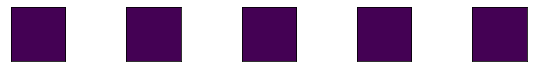

(845, 125)


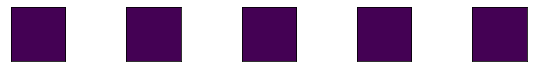

(845, 125)


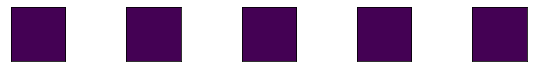

(845, 125)


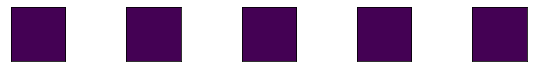

(845, 10)
(845,)
0 169
(845,)
1 169
(845,)
2 169
(845,)
3 169
(845,)
4 169


0 0
1 169
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=125, n_max_feature_maps=5, feature_map_side=13)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels,n_max_feature_maps=5)

## For 2D epoch 0 fix:

In [139]:
ensembles_2D = get_tensor_factors(N_epoch0_2D, dim =2, ranks=[1,2,3,4,5])

Rank-1 models:  min obj, 0.13;  max obj, 0.13;  time to fit, 0.0s


Rank-2 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.0s


Rank-3 models:  min obj, 0.04;  max obj, 0.04;  time to fit, 0.1s


Rank-4 models:  min obj, 0.03;  max obj, 0.03;  time to fit, 0.1s


Rank-5 models:  min obj, 0.02;  max obj, 0.02;  time to fit, 0.2s


[0.023144095099630065]
[0.12612751178985612, 0.06923840162243612, 0.040235371933765904, 0.028668247424066564, 0.023144095099630065]
[1, 2, 3, 4, 5]


In [140]:
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [101]:
ensembles_2D = get_tensor_factors(N_epoch1_2D, dim =2, ranks=[1,2,3,4,5])

Rank-1 models:  min obj, 0.40;  max obj, 0.40;  time to fit, 0.0s


Rank-2 models:  min obj, 0.21;  max obj, 0.21;  time to fit, 0.0s


Rank-3 models:  min obj, 0.12;  max obj, 0.12;  time to fit, 0.1s


Rank-4 models:  min obj, 0.09;  max obj, 0.09;  time to fit, 0.2s


Rank-5 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.2s


[0.07274940934590712]
[0.3995229322817368, 0.20904418883770037, 0.12433907365191017, 0.09378336238217896, 0.07274940934590712]
[1, 2, 3, 4, 5]


In [102]:
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [108]:
ensembles_2D = get_tensor_factors(N_epoch2_2D, dim =2, ranks=[1,2,3,4,5])

Rank-1 models:  min obj, 0.38;  max obj, 0.38;  time to fit, 0.0s


Rank-2 models:  min obj, 0.23;  max obj, 0.23;  time to fit, 0.0s


Rank-3 models:  min obj, 0.12;  max obj, 0.12;  time to fit, 0.1s


Rank-4 models:  min obj, 0.08;  max obj, 0.08;  time to fit, 0.1s


Rank-5 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.2s


[0.06580503327031843]
[0.3828707693360635, 0.2342435082594948, 0.12045508133902844, 0.08318043067536465, 0.06580503327031843]
[1, 2, 3, 4, 5]


In [109]:
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [113]:
ensembles_2D = get_tensor_factors(N_epoch3_2D, dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.41;  max obj, 0.41;  time to fit, 0.0s


Rank-2 models:  min obj, 0.25;  max obj, 0.25;  time to fit, 0.0s


Rank-3 models:  min obj, 0.13;  max obj, 0.13;  time to fit, 0.0s


Rank-4 models:  min obj, 0.10;  max obj, 0.10;  time to fit, 0.1s


Rank-5 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.2s


[0.07325621227360725]
[0.409871179611338, 0.24547392504232599, 0.1279698984627692, 0.0965575249854294, 0.07325621227360725]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [119]:
ensembles_2D = get_tensor_factors(N_epoch4_2D, dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.36;  max obj, 0.36;  time to fit, 0.0s


Rank-2 models:  min obj, 0.25;  max obj, 0.25;  time to fit, 0.0s


Rank-3 models:  min obj, 0.17;  max obj, 0.17;  time to fit, 0.0s


Rank-4 models:  min obj, 0.08;  max obj, 0.08;  time to fit, 0.0s


Rank-5 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.2s


[0.06500586192964021]
[0.3574715447827145, 0.25291108430727505, 0.16679495138386546, 0.08233361588263055, 0.06500586192964021]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



## For 2D epoch 5 fix:

In [120]:
ensembles_2D = get_tensor_factors(N_epoch5_2D, dim =2, ranks=[1,2,3,4,5])

Rank-1 models:  min obj, 0.29;  max obj, 0.29;  time to fit, 0.0s


Rank-2 models:  min obj, 0.16;  max obj, 0.16;  time to fit, 0.0s


Rank-3 models:  min obj, 0.11;  max obj, 0.11;  time to fit, 0.0s


Rank-4 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.0s


Rank-5 models:  min obj, 0.05;  max obj, 0.05;  time to fit, 0.1s


[0.05295186434575219]
[0.2904635591361651, 0.1555180533433477, 0.10551015529081721, 0.06670672512759504, 0.05295186434575219]
[1, 2, 3, 4, 5]


In [121]:
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



## For 2D epoch 7 fix: 

In [126]:
ensembles_2D = get_tensor_factors(N_epoch7_2D, dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.38;  max obj, 0.38;  time to fit, 0.0s


Rank-2 models:  min obj, 0.28;  max obj, 0.28;  time to fit, 0.0s


Rank-3 models:  min obj, 0.14;  max obj, 0.14;  time to fit, 0.0s


Rank-4 models:  min obj, 0.10;  max obj, 0.10;  time to fit, 0.0s


Rank-5 models:  min obj, 0.08;  max obj, 0.08;  time to fit, 0.2s


[0.07707809243717896]
[0.38270043686875194, 0.27760187385848606, 0.13932002689579634, 0.10054367491435771, 0.07707809243717896]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [132]:
ensembles_2D = get_tensor_factors(N_epoch8_2D, dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.39;  max obj, 0.39;  time to fit, 0.0s


Rank-2 models:  min obj, 0.27;  max obj, 0.27;  time to fit, 0.0s


Rank-3 models:  min obj, 0.17;  max obj, 0.17;  time to fit, 0.0s


Rank-4 models:  min obj, 0.10;  max obj, 0.10;  time to fit, 0.1s


Rank-5 models:  min obj, 0.08;  max obj, 0.08;  time to fit, 0.1s


[0.07631373688787864]
[0.38844441155979315, 0.2722133802403004, 0.169926174306609, 0.10472843328689743, 0.07631373688787864]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



## For 2D epoch 10:


In [92]:
ensembles_2D = get_tensor_factors(N_epoch10_2D , dim =2, ranks=[1,2,3,4,5])

Rank-1 models:  min obj, 0.27;  max obj, 0.27;  time to fit, 0.0s


Rank-2 models:  min obj, 0.13;  max obj, 0.13;  time to fit, 0.0s


Rank-3 models:  min obj, 0.09;  max obj, 0.09;  time to fit, 0.0s


Rank-4 models:  min obj, 0.06;  max obj, 0.06;  time to fit, 0.1s


Rank-5 models:  min obj, 0.05;  max obj, 0.05;  time to fit, 0.1s


[0.04899961233245239]
[0.2653271610795275, 0.12739945402411315, 0.09216462402757751, 0.06314487935856547, 0.04899961233245239]
[1, 2, 3, 4, 5]


In [93]:
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [153]:
ensembles_2D = get_tensor_factors(N_epoch15_2D_max , dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.27;  max obj, 0.27;  time to fit, 0.0s


Rank-2 models:  min obj, 0.13;  max obj, 0.13;  time to fit, 0.0s


Rank-3 models:  min obj, 0.09;  max obj, 0.09;  time to fit, 0.0s


Rank-4 models:  min obj, 0.06;  max obj, 0.06;  time to fit, 0.1s


Rank-5 models:  min obj, 0.05;  max obj, 0.05;  time to fit, 0.1s


[0.048969889533245985]
[0.26532717320306043, 0.12741447768723163, 0.09180386707949802, 0.06313845224227461, 0.048969889533245985]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [158]:
ensembles_2D = get_tensor_factors(N_epoch15_2D , dim =2, ranks=[1,2,3,4,5])
rep = 0
ranks=[2]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=10)
neuron_output_highest_with_shifts_PCA = get_embeddings_2D(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 2)
get_spatial_order_plot_2D(1, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps=10)

Rank-1 models:  min obj, 0.27;  max obj, 0.27;  time to fit, 0.0s


Rank-2 models:  min obj, 0.13;  max obj, 0.13;  time to fit, 0.0s


Rank-3 models:  min obj, 0.09;  max obj, 0.09;  time to fit, 0.1s


Rank-4 models:  min obj, 0.06;  max obj, 0.06;  time to fit, 0.0s


Rank-5 models:  min obj, 0.05;  max obj, 0.05;  time to fit, 0.1s


[0.049112888986936595]
[0.2653271800149687, 0.12740376669781203, 0.09185153389901907, 0.06306748094193985, 0.049112888986936595]
[1, 2, 3, 4, 5]


(1210, 2)


(1210, 2)


(1210, 2)
(1210,)
0 121
(1210,)
1 121
(1210,)
2 121
(1210,)
3 121
(1210,)
4 121
(1210,)
5 121
(1210,)
6 121
(1210,)
7 121
(1210,)
8 121
(1210,)
9 121


0 0
1 121
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
!pip install tensorly

     |████████████████████████████████| 198 kB 5.0 MB/s 
     |████████████████████████████████| 154 kB 34.4 MB/s 


In [ ]:
import numpy as np
import tensorly as tl
from tensorly.decomposition import non_negative_parafac, non_negative_parafac_hals
from tensorly.decomposition._nn_cp import initialize_nn_cp
from tensorly.cp_tensor import CPTensor
import time
from copy import deepcopy

In [ ]:
tic = time.time()
weights_init, factors_init = initialize_nn_cp(N_epoch16_max10_2D, init='random', rank=10)
cp_init = CPTensor((weights_init, factors_init))
tensor_hals, errors_hals = non_negative_parafac_hals(N_epoch16_max10_2D, rank=10, init=deepcopy(cp_init), return_errors=True)
cp_reconstruction_hals = tl.cp_to_tensor(tensor_hals)
time_hals = time.time()-tic

In [ ]:
import matplotlib.pyplot as plt
def each_iteration(a, title):
    fig=plt.figure()
    fig.set_size_inches(10, fig.get_figheight(), forward=True)
    plt.plot(a)
    plt.title(str(title))
    plt.legend(['HALS'], loc='upper left')

each_iteration(errors_hals, 'Error for each iteration')

In [ ]:
tic = time.time()
weights_init, factors_init = initialize_nn_cp(N_epoch16_max10, init='random', rank=10)
cp_init = CPTensor((weights_init, factors_init))
tensor_hals_3D, errors_hals_3D = non_negative_parafac_hals(N_epoch16_max10, rank=10, init=deepcopy(cp_init), return_errors=True)
cp_reconstruction_hals_3D = tl.cp_to_tensor(tensor_hals_3D)
time_hals = time.time()-tic

In [ ]:
import matplotlib.pyplot as plt
def each_iteration(a, title):
    fig=plt.figure()
    fig.set_size_inches(10, fig.get_figheight(), forward=True)
    plt.plot(a)
    plt.title(str(title))
    plt.legend(['HALS'], loc='upper left')

each_iteration(errors_hals_3D, 'Error for each iteration')

In [ ]:
N = N_epoch16_max10
N_filtered = np.empty(N.shape)
for i in range(N.shape[0]):
  for j in range(N.shape[1]):
    filtered = gaussian_filter(N[i,j,:].reshape((32,32)), sigma=1).reshape((1024,))
    N_filtered[i,j,:] = filtered[:]
tic = time.time()
weights_init, factors_init = initialize_nn_cp(N_filtered, init='random', rank=10)
cp_init = CPTensor((weights_init, factors_init))
tensor_hals_3D, errors_hals_3D = non_negative_parafac_hals(N_filtered, rank=10, init=deepcopy(cp_init), return_errors=True)
cp_reconstruction_hals_3D = tl.cp_to_tensor(tensor_hals_3D)
time_hals = time.time()-tic

In [ ]:
import matplotlib.pyplot as plt
def each_iteration(a, title):
    fig=plt.figure()
    fig.set_size_inches(10, fig.get_figheight(), forward=True)
    plt.plot(a)
    plt.title(str(title))
    plt.legend(['HALS'], loc='upper left')

each_iteration(errors_hals_3D, 'Error for each iteration')

# Get accuracy:

In [133]:
!pip install tqdm
import tqdm

In [134]:
# define function to calculate current accuracy with a given dataloader
def accuracy(net, dataloader, device='cpu'): #Get the accuracies
  net.eval()
  correct = 0
  count = 0
  for data, target in tqdm.tqdm(trainloader):
    data = data.to(device).float()
    target = target.to(device).long()
    data = data.type(torch.cuda.FloatTensor)
    target = target.type(torch.cuda.FloatTensor)

    prediction = net(data)
    _, predicted = torch.max(prediction, 1)
    count += target.size(0)
    correct += (predicted == target).sum().item()

  acc = 100 * correct / count
  return count, acc


# define function to evaluate and print training and test accuracy
def evaluate(net, device='cpu', title=""):
  net.eval()
  train_count, train_acc = accuracy(net, train_data, device=device)
  test_count, test_acc = accuracy(net, test_data, device=device)
  print(f'Accuracy on the {train_count} training samples {title}: {train_acc:0.2f}')
  print(f'Accuracy on the {test_count} testing samples {title}: {test_acc:0.2f}')

In [135]:
evaluate(AlexNet_Model_epoch10)

100%|██████████| 12500/12500 [01:52<00:00, 111.04it/s]

Accuracy on the 50000 training samples : 96.04
Accuracy on the 50000 testing samples : 96.04


In [ ]:
evaluate(AlexNet_Model_epoch10)

100%|██████████| 12500/12500 [01:41<00:00, 123.49it/s]

Accuracy on the 50000 training samples : 96.04
Accuracy on the 50000 testing samples : 96.04


In [ ]:
evaluate(AlexNet_Model_epoch12)

100%|██████████| 12500/12500 [01:35<00:00, 131.36it/s]

Accuracy on the 50000 training samples : 10.00
Accuracy on the 50000 testing samples : 10.00


In [ ]:
evaluate(AlexNet_Model_epoch14)

100%|██████████| 12500/12500 [01:38<00:00, 126.94it/s]

Accuracy on the 50000 training samples : 11.48
Accuracy on the 50000 testing samples : 11.48


In [ ]:
evaluate(AlexNet_Model_epoch16)

# Visualizing filters:

In [ ]:
def show_weights(layer, i=0):
    filters = layer[0].weight.cpu().data # [0] is to get the conv_2d layer

    # normalize filter values to 0-1 so we can visualize them
    f_min, f_max = filters.min(), filters.max()
    filters = (filters - f_min) / (f_max - f_min)
    print(filters.shape)

    fig, axs = plt.subplots(5, 5, figsize =(20, 10))
    for i , ax in enumerate(axs.flatten()):
        image = filters[i]
        ax.imshow(image.permute(1, 2, 0))
        ax.axis('off')
    plt.tight_layout
    # img = torchvision.utils.make_grid(filters)
    # npimg = img.numpy()
    # print(npimg.shape)
    # print(np.transpose(npimg, (1, 2, 0)).shape)
    # plt.imshow(np.transpose(npimg, (1, 2, 0)))
    # plt.show()

In [ ]:
show_weights(AlexNet_Model_epoch0.conv_layer3)

torch.Size([192, 96, 3, 3])


TypeError: ignored

In [ ]:
show_weights(AlexNet_Model_epoch1.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch10.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch0.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch1.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch2.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch3.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch4.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch5.conv_layer1)

torch.Size([32, 3, 11, 11])


In [ ]:
show_weights(AlexNet_Model_epoch10.conv_layer1)

torch.Size([32, 3, 11, 11])


# Visualizing outputs given an image: 

In [ ]:
dataiter = iter(trainloader)
images, labels = dataiter.next()

In [ ]:
imshow(images[2])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [ ]:
images = images.type(torch.cuda.FloatTensor)
im = images[0].unsqueeze(0)

In [ ]:
im.shape

torch.Size([1, 3, 128, 128])

In [ ]:
!pip install torch_intermediate_layer_getter

  Created wheel for torch-intermediate-layer-getter: filename=torch_intermediate_layer_getter-0.1.post1-py3-none-any.whl size=3726 sha256=413a0eb5dda8e008b9554acb528ffbf0ed4dad7c8b933b54912a197e77c0f9b8
  Stored in directory: /root/.cache/pip/wheels/59/53/37/8b81c4711686fbae03a35d8d1dac5edd9e4af9221fa8e17f6f
Successfully built torch-intermediate-layer-getter


In [ ]:
## DEBUG NOTE: https://discuss.pytorch.org/t/how-can-i-extract-intermediate-layer-output-from-loaded-cnn-model/77301/12
## The forward hook registered in model.fc returns the “pre-relu” activation, since negative values are shown.

import torchvision
from torchvision.models._utils import IntermediateLayerGetter
return_layers = {
    # "<name of layer in the AlexNet Class>" : "<key for the layer output in the returned dictionary>"
      'conv_layer1': 'conv_layer1',
      'conv_layer3': 'conv_layer3',
      'conv_layer5': 'conv_layer5',
  }
model_with_multuple_layer = IntermediateLayerGetter(AlexNet_Model_epoch7, return_layers=return_layers)
intermediate_output = model_with_multuple_layer(im)
intermediate_output

OrderedDict([('conv_layer1',
              tensor([[[[-0.0120,  0.0889,  0.0177,  ..., -0.2436, -0.2436, -0.6147],
                        [ 0.1577, -0.0120, -0.2683,  ..., -0.2708, -0.3270, -0.6649],
                        [ 0.1327, -0.2111, -0.1840,  ...,  0.0845, -0.5043, -0.3859],
                        ...,
                        [-0.0561, -0.0561,  0.1311,  ..., -0.3304,  0.8404,  0.6801],
                        [-0.3968, -0.2732, -0.0397,  ..., -0.3304,  0.8404,  0.0070],
                        [-0.4007, -0.5579, -0.3417,  ..., -0.0590,  1.6005, -0.0760]],
              
                       [[ 1.6084, -1.0132, -1.0132,  ..., -1.0132, -1.0132, -1.0132],
                        [ 1.7945, -1.0132, -1.0132,  ..., -1.0132, -1.0132, -1.0132],
                        [ 1.6400, -1.0132, -1.0132,  ..., -1.0132, -1.0132, -1.0132],
                        ...,
                        [-0.5556, -1.0132, -0.8300,  ..., -0.6844,  0.6897,  0.6897],
                        [ 0.1608, -0.

In [ ]:
# from torch_intermediate_layer_getter import IntermediateLayerGetter as LayerGetter
# return_layers = {
#     # "<name of layer in the AlexNet Class>" : "<key for the layer output in the returned dictionary>"
#       'conv_layer1': 'conv_layer1',
#       'conv_layer3': 'conv_layer3',
#       'conv_layer5': 'conv_layer5',
#   }
# net = AlexNet_Model_epoch7
# LayerGetter_ = LayerGetter(net, return_layers=return_layers)
# intermediate_output = LayerGetter_(im)
# print(intermediate_output['conv_layer1'].shape)
# intermediate_output['conv_layer1'].min()

TypeError: ignored

In [ ]:
fig, axs = plt.subplots(5, 5, figsize = (10,10))
for i , ax in enumerate(axs.flatten()):    
    ax.imshow(intermediate_output['conv_layer1'][1,i,:,:].cpu().data)
fig.suptitle('Visualizing Outputs for first 25 filters in conv_layer1', fontsize=20)

Text(0.5, 0.98, 'Visualizing Outputs for first 25 filters in conv_layer1')

# Visualizing embeddings (3D tensor):

In [18]:
!python3 -m pip install --upgrade pip
!python3 -m pip install --upgrade Pillow
from PIL import Image, ImageTk
img_array_starfish = np.load('imgnet_starfish.npy')
img_array_strawberry = np.load('imgnet_strawberry.npy')
img_array_husky = np.load('imgnet_husky.npy')
img_array_guitar = np.load('imgnet_guitar.npy')

def get_images_selected_classes(num_images, n_classes):
  images_selected_classes = []
  MAX_SIZE = 64
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_starfish[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_strawberry[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_husky[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_guitar[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  ##  (#images, #nrow, #ncol, #channels) 
  images_selected_classes = np.array(images_selected_classes)
  
  return images_selected_classes

num_images = 20
n_classes = 4
images_selected_classes = get_images_selected_classes(num_images, n_classes)
for i in range(20):
  plt.imshow(images_selected_classes[i])
  plt.show()

images_selected_classes = images_selected_classes.transpose((0,3,1,2))
print(images_selected_classes.shape)

     |████████████████████████████████| 2.1 MB 4.3 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 20.4 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


(20, 3, 64, 64)


In [19]:
def apply_all_shifts(im, shift_step):
    '''
    arg(s): 
        DEBUG NOTE: PYTORCH IS (#channels, rows, cols)!!
        im, an image of shape (3, im_size, im_size)
    return: 
        im_all_shifts, a list of all shifted images from the input image
        n_shifts, number of shifted images
    '''
    
    ## vertical size might not be the same as the horizontal, note that the channel for tf and pytorch are in different dimension
    im_size_vertical = im.shape[1]
    im_size_horizontal = im.shape[2]
    
    n_shifts_vertical = int(math.ceil(im_size_vertical/ shift_step))
    n_shifts_horizontal = int(math.ceil(im_size_horizontal/ shift_step))
    n_shifts = n_shifts_vertical * n_shifts_horizontal 

    im_all_shifts = []
    # start with the unshifted im
    im_shift = im
    # im_all_shifts.append(im)
    for i in range(n_shifts_vertical):
        ## for pytorch axis = 1, for tensorflow axis = 0
        im_shift = np.roll(im_shift, shift = shift_step, axis=1)
        im_all_shifts.append(im_shift)
        for j in range(n_shifts_horizontal):
            ## for pytorch axis = 2, for tensorflow axis = 1
            im_shift = np.roll(im_shift, shift = shift_step, axis=2)
            im_all_shifts.append(im_shift)
            
    im_all_shifts =  np.array(im_all_shifts)
    
    return im_all_shifts, n_shifts

In [20]:
AlexNet_Model_epoch0.conv_layer1[0].register_forward_hook(getActivation('conv_layer1'))

NameError: ignored

In [ ]:
# https://web.stanford.edu/~nanbhas/blog/forward-hooks-pytorch/ 

model = AlexNet_Model_epoch16
# a dict to store the activations
activation = {}

def getActivation(name):
  # the hook signature
  def hook(model, input, output):
    activation[name] = output.detach()
  return hook

# register forward hooks on the layers of choice
h1 = model.conv_layer1[0].register_forward_hook(getActivation('conv_layer1'))

conv_layer1_list = []
# go through all the batches in the dataset

# forward pass -- getting the outputs
im = torch.tensor(images_selected_classes[0])
out = model(im.unsqueeze(dim=0).to(device).float())
# collect the activations in the correct list
conv_layer1_list.append(activation['conv_layer1'])
  
# detach the hooks
h1.remove()

In [ ]:
conv_layer1_list[0][0].shape

In [ ]:
conv_layer1_list[0].shape

plt.imshow(conv_layer1_list[0][0,3,:,:].cpu().data)

In [ ]:
# https://web.stanford.edu/~nanbhas/blog/forward-hooks-pytorch/ 

model = AlexNet_Model_epoch16
# a dict to store the activations
activation = {}

def getActivation(name):
  # the hook signature
  def hook(model, input, output):
    activation[name] = output.detach()
  return hook

# register forward hooks on the layers of choice
h1 = model.conv_layer1[0].register_forward_hook(getActivation('conv_layer1'))

conv_layer1_list = []
# go through all the batches in the dataset
for i in range(20):
  # forward pass -- getting the outputs
  im = torch.tensor(images_selected_classes[i])
  out = model(im.unsqueeze(dim=0).to(device).float())
  # collect the activations in the correct list
  conv_layer1_list.append(activation['conv_layer1'])
  
# detach the hooks
h1.remove()

In [ ]:
len(conv_layer1_list)

In [ ]:
for i in range(20):
  plt.imshow(conv_layer1_list[i][0,3,:,:].cpu().data)
  plt.show()

In [ ]:
conv_layer1_list[1].shape

In [ ]:
A = np.random.randn(4,5)
A

array([[ 0.25635011, -0.15055348,  1.56926343,  0.07323531,  1.80868942],
       [ 0.24230565,  0.34338526,  0.9138252 , -1.67519323, -0.57316021],
       [ 0.13210251, -0.38192231,  0.70784465,  1.91714807, -0.59335816],
       [-0.32341471,  0.21585613, -0.26604045,  0.67111155,  0.74224816]])

In [ ]:
B = np.random.randn(4,5)
B

array([[ 0.86035687, -0.20898919,  0.60497564,  1.02607668, -1.98066417],
       [ 1.30135648,  0.478929  ,  0.36461786, -0.34397895,  0.13639092],
       [ 0.14676475, -1.02326124, -0.933925  ,  0.71720978, -0.35779265],
       [-0.24271025, -1.39495294,  0.62092043,  1.15012929, -0.28976494]])

In [ ]:
np.concatenate((A,B), axis = 1)

array([[ 0.25635011, -0.15055348,  1.56926343,  0.07323531,  1.80868942,
         0.86035687, -0.20898919,  0.60497564,  1.02607668, -1.98066417],
       [ 0.24230565,  0.34338526,  0.9138252 , -1.67519323, -0.57316021,
         1.30135648,  0.478929  ,  0.36461786, -0.34397895,  0.13639092],
       [ 0.13210251, -0.38192231,  0.70784465,  1.91714807, -0.59335816,
         0.14676475, -1.02326124, -0.933925  ,  0.71720978, -0.35779265],
       [-0.32341471,  0.21585613, -0.26604045,  0.67111155,  0.74224816,
        -0.24271025, -1.39495294,  0.62092043,  1.15012929, -0.28976494]])

In [23]:
def compute_neuron_output(model, layer_names, im_all_shifts,  max_indices = None, n_max_feature_maps = 10, plot_activity = False):

    '''
    arg(s):
        layer_names: list of strings indicating the names of the layers we want to take neuron outputs from
        im_all_shifts: all shifts of one particular image in the for loop
    return:
        
    '''
    print(im_all_shifts.shape)
    n_shifts = im_all_shifts.shape[0]
    n_layers = len(layer_names)
    neuron_output_highest = []
    all_fm_avg = []
    im_all_shifts = torch.tensor(np.array(im_all_shifts))
    im_all_shifts = im_all_shifts.type(torch.cuda.FloatTensor)
        
    is_first_layer = True
    for layer_name in layer_names:
        ## note: always take the images as inputs

        # a dict to store the activations
        activation = {}

        def getActivation(name):
          # the hook signature
          def hook(model, input, output):
            activation[name] = output.detach()
          return hook
        # register forward hooks on the layers of choice
        h1 = model.conv_layer1[0].register_forward_hook(getActivation('conv_layer1'))

        conv_layer1_list = []
        # go through all the batches in the dataset
        for i in range(n_shifts):
          # forward pass -- getting the outputs
          im = im_all_shifts[i]
          out = model(im.unsqueeze(dim=0))
          # collect the activations in the correct list
          conv_layer1_list.append(activation['conv_layer1'])
          
        # detach the hooks
        h1.remove()
        
        # return_layers = {layer_name: layer_name}
        # LayerGetter = torchvision.models._utils.IntermediateLayerGetter(model, return_layers=return_layers)
        # neuron_output = []
        # for i in range(n_shifts):
        #     im = im_all_shifts[i]
        #     im = torch.reshape(im, (1, im.shape[0],im.shape[1],im.shape[2]))
        #     output = LayerGetter(im)[layer_name] 
        #     relu = torch.nn.ReLU()
        #     output = relu(output)
        #     neuron_output.append(output)
        # neuron_output =  torch.stack(neuron_output)
        # neuron_output = neuron_output.reshape((neuron_output.shape[0], neuron_output.shape[2], neuron_output.shape[3], neuron_output.shape[4]))

        n_feature_maps, n_row, n_col = conv_layer1_list[0][0,:,:,:].shape[:]
        neuron_output = np.empty((n_shifts, n_feature_maps, n_row, n_col))

        for i in range(n_shifts):
          neuron_output[i,:,:,:] = conv_layer1_list[i][0,:,:,:].cpu().data

        print(neuron_output.shape)
        ## neuron_output has shape (n_shifts, n_feature_maps, nrow, ncol)
        neuron_output = np.transpose(neuron_output, (0, 2, 3, 1))
        ## after permuting, neuron_output has shape (n_shifts, nrow, ncol, n_feature_maps)
        # n_shifts, n_row, n_col, n_feature_maps = neuron_output.shape[:]

        ## remove the neurons at the edges

        # based on the AlexNet model structure:
        filter_size = 11
        shift_step = 4
        edge_neuron = math.floor(filter_size / shift_step)
        neuron_output = neuron_output[:, edge_neuron:(n_row - edge_neuron), edge_neuron:(n_col - edge_neuron),:]
        n_shifts, n_row, n_col, n_feature_maps = neuron_output.shape[:]
        neuron_output = neuron_output.reshape((n_shifts, n_row * n_col, n_feature_maps))
        
        ## number of neurons for each feature map is nrow * ncol
        n_neurons = n_row * n_col
        
        # neuron_index = np.empty((n_row,n_col),dtype=int)
        # index = 0
        # for i in range(n_row):
        #     for j in range(n_col):
        #         neuron_index[i, j] = index
        #         index += 1
                
        # ## obtain the index of the neurons at the edges
        # neuron_edge_index = np.hstack((neuron_index[[0,1,n_row-2,n_row-1],:].reshape((4*32,1)), neuron_index[:,[0,1,n_col-2,n_col-1]].reshape((4*32,1))))
        # neuron_edge_index = neuron_edge_index.reshape((256,1))
        

        # ## re-label the neurons at the edge with a different color
        # neuron_labels = []
        # for i in range(10):    
        #     neuron_labels = np.hstack((neuron_labels, [i] * n_neurons))
        #     neuron_labels = np.array(neuron_labels)
        #     neuron_labels[n_neurons * i + neuron_edge_index-1] = 15
        
        # neuron_output = neuron_output.reshape((n_shifts, n_neurons, n_feature_maps))
        
        ## transpose to organize by feature maps
        ## the shape of neuron_output_by_fm is (n_shifts, n_feature_maps, #neurons)
        neuron_output_by_fm = np.transpose(neuron_output, (0, 2, 1))

        ## compute avg neuron firing rate in each feature map
        ## fm_avg is of shape (n_shifts, n_feature_maps)
        fm_avg = neuron_output_by_fm.sum(axis=2) / neuron_output_by_fm.shape[2]
        
        if is_first_layer is True: 
            fm_avg_all_layers = fm_avg
            neuron_output_by_fm_all_layers = neuron_output_by_fm
        else:
            fm_avg_all_layers = np.hstack((fm_avg_all_layers, fm_avg))
            neuron_output_by_fm_all_layers = np.concatenate((neuron_output_by_fm_all_layers,neuron_output_by_fm), axis = 1)
            is_first_layer = False
        # if plot_activity == True:
        #     layer = model.layers[layer_index] 
        #     print("Current layer: " + layer.name)
        #     print("Indices of FM with highest average firing rate in response to each image: " )
        #     max_fm_ind = np.argmax(fm_avg,axis = 1)
        #     print(max_fm_ind)
        #     print("#neurons in the FM with highest average firing rate: " + str(n_row * n_col))
        #     print("Average activity for all feature maps in " + layer.name)
        #     plt.matshow(fm_avg)
        #     plt.show()
        #     print('----------------------------------------------------\n')

    neuron_output_highest = np.empty((n_shifts, n_max_feature_maps * n_neurons))
    feature_map_side = int(np.sqrt(n_neurons))
    for i in range(n_shifts):
        if max_indices is None:
            max_indices = np.argsort(-1*fm_avg_all_layers[i], axis = 0)[:n_max_feature_maps]
        temp = neuron_output_by_fm_all_layers[i, max_indices, :]
        neuron_output_highest[i] = neuron_output_by_fm_all_layers[i, max_indices, :].reshape((1, n_max_feature_maps * n_neurons))
        
        for f_i in range(n_max_feature_maps):
          normalizing_constant = temp[f_i, :].max()
          if normalizing_constant == 0:
            neuron_output_highest[i, (f_i*feature_map_side**2):((f_i+1)*feature_map_side**2)] = 0
          else:
            neuron_output_highest[i, (f_i*feature_map_side**2):((f_i+1)*feature_map_side**2)] /= normalizing_constant

    neuron_labels = []
    for i in range(n_max_feature_maps):
      neuron_labels += [i] * n_neurons
    neuron_labels = np.array(neuron_labels) 

    return neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons

In [24]:
def show_stimuli_3D(model, layer_names, images_selected_classes, shifts, max_indices, n_images_selected_classes, shift_step = 4, n_max_feature_maps = 10, plot_activity = False):
    '''
    arg(s): 
        layer_indices, interested layers
        images_selected_classes, all the selected images
        shifts = True/False
    return:
        neuron_output_shifts_avg, (n_images, n_neurons)
    '''

    if shifts is False:
        neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
            model, layer_names, images_selected_classes, max_indices, n_max_feature_maps, plot_activity)
  
    else: 
        # generate shifts for each selected image and then stack: 
        neuron_output_highest_with_shifts = []
        for i in range(n_images_selected_classes):
            im = images_selected_classes[i]
            im_all_shifts, n_shifts =  apply_all_shifts(im, shift_step)
            im_all_shifts = torch.Tensor(im_all_shifts)
            
            ## neuron_output_highest is of shape (n_shifts, n_neurons * n_max_feature_maps)
            neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
                model, layer_names, im_all_shifts, max_indices, n_max_feature_maps, plot_activity)
        
            ## instead of taking average, we create a dimension for all shifts (analogous to the time dimension)

            neuron_output_highest_with_shifts.append(neuron_output_highest)

            fm_shifts_avg = fm_avg_all_layers.sum(axis=0) / fm_avg_all_layers.shape[0]
            fm_shifts_avg = fm_shifts_avg.reshape((1,fm_shifts_avg.shape[0]))
            
            if i == 0:
                fm_avg_all_layers_with_shifts = fm_shifts_avg
            else:
                fm_avg_all_layers_with_shifts = np.vstack((fm_avg_all_layers_with_shifts, fm_shifts_avg))
        
        ## out of for loop!      
        ## neuron_output_highest_with_shifts is of shape (n_images_selected_classes, n_shifts, n_neurons * n_max_feature_maps)
        neuron_output_highest_with_shifts = np.array(neuron_output_highest_with_shifts)
        neuron_output_highest_final = neuron_output_highest_with_shifts
        fm_avg_all_layers = fm_avg_all_layers_with_shifts
 
    return neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices

In [ ]:
# def get_images_selected_classes():
#   airplane_indices, automobile_indices, cat_indices, dog_indices = [], [], [], []
#   airplane_idx, automobile_idx, cat_idx, dog_idx = train_data.class_to_idx['airplane'], train_data.class_to_idx['automobile'], train_data.class_to_idx['cat'], train_data.class_to_idx['dog']

#   i = 0
#   n_images_per_class = 5
#   while(len(airplane_indices) < n_images_per_class or len(automobile_indices) < n_images_per_class or len(cat_indices) < n_images_per_class or len(dog_indices) < n_images_per_class):
#       current_class = train_data[i][1]
#       if current_class == airplane_idx:
#           airplane_indices.append(i)
#       elif current_class == automobile_idx:
#           automobile_indices.append(i)
#       elif current_class == cat_idx:
#           cat_indices.append(i)
#       elif current_class == dog_idx:
#           dog_indices.append(i)
#       i += 1

#   airplane_indices = airplane_indices[0:n_images_per_class]
#   automobile_indices = automobile_indices[0:n_images_per_class]
#   cat_indices = cat_indices[0:n_images_per_class]
#   dog_indices = dog_indices[0:n_images_per_class]
#   selected_train_data = Subset(train_data, airplane_indices + automobile_indices + cat_indices + dog_indices)
#   n_images_selected_classes = n_images_per_class * 4

#   # get some random training images
#   trainloader_images_selected_classes = torch.utils.data.DataLoader(selected_train_data, batch_size=n_images, shuffle=False, num_workers=2)
#   dataiter_images_selected_classes = iter(trainloader_images_selected_classes)
#   images_selected_classes, labels_selected_classes = dataiter_images_selected_classes.next()
  
#   return images_selected_classes

## Save and load .mat data for TCA:

In [ ]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_3D(
    AlexNet_Model_epoch10, ['conv_layer4'], images_selected_classes, shifts = True,  max_indices = None, n_images_selected_classes = num_images, n_max_feature_maps=10, plot_activity = True)

torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)
torch.Size([272, 3, 64, 64])
(272, 32, 15, 15)


In [ ]:
data = np.transpose(neuron_output_highest_with_shifts, (2, 0, 1))
from scipy.io import savemat
mdic = {"neuron_output_3D": data}
mdic
savemat("neuron_output_3D_epoch10_conv4.mat", mdic)

In [ ]:
data.shape

(1210, 20, 272)

Note: 
output size = [(W−K+2P)/S]+1 = (128-11)/4+1 = ~30

-> after downsampling = 15 

-> minus edge neuron = 13

thus, 5 * 13 * 13 = 845

e.g. conv_layer
W is the input volume - 128
K is the Kernel size - 11
P is the padding - not sure (assuming 0)
S is the stride - 4

edge_neuron = floor(filter_size /stride) = floor(11/4) = 2

shifts = 16 * 16 = 256

In [ ]:
max_indices

array([13, 30,  7,  2,  3, 31,  0,  1, 20, 12])

In [ ]:
max_indices = [13, 30,  7, 31,  3,  2,  0,  1, 12, 26]

array([13, 30,  7, 31,  3,  2,  0,  1, 12, 26])

In [ ]:
data.min()

0.0

# Visualizing embeddings (2D tensor):

In [25]:
def show_stimuli_2D(model, layer_names, images_selected_classes, shifts, max_indices, n_images_selected_classes, shift_step = 3, n_max_feature_maps = 5, plot_activity = False):
    '''
    arg(s): 
        layer_indices, interested layers
        images_selected_classes, all the selected images
        shifts = True/False
    return:
        neuron_output_shifts_avg, (n_images, n_neurons)
    '''

    if shifts is False:
        neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
            model, layer_names, images_selected_classes, max_indices, n_max_feature_maps, plot_activity) 
  
  
    else: 
        # generate shifts for each selected image and then stack: 
        neuron_output_highest_with_shifts = []
        for i in range(n_images_selected_classes):
            im = images_selected_classes[i]
            im_all_shifts, n_shifts =  apply_all_shifts(im, shift_step)
            im_all_shifts = torch.Tensor(im_all_shifts)
            
            ## neuron_output_highest is of shape (n_shifts, n_neurons * n_max_feature_maps)
            neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
                model, layer_names, im_all_shifts, max_indices, n_max_feature_maps, plot_activity) 
  

            ## take the average over all shifts of im
            neuron_output_highest_shifts_avg = neuron_output_highest.sum(axis=0) / neuron_output_highest.shape[0] 
            neuron_output_highest_shifts_avg = neuron_output_highest_shifts_avg.reshape((1, neuron_output_highest_shifts_avg.shape[0]))


            fm_shifts_avg = fm_avg_all_layers.sum(axis=0) / fm_avg_all_layers.shape[0]
            fm_shifts_avg = fm_shifts_avg.reshape((1,fm_shifts_avg.shape[0]))
            
            if i == 0:
              neuron_output_highest_with_shifts = neuron_output_highest_shifts_avg 
              fm_avg_all_layers_with_shifts = fm_shifts_avg
            else:
              neuron_output_highest_with_shifts = np.vstack((neuron_output_highest_with_shifts, neuron_output_highest_shifts_avg))
              fm_avg_all_layers_with_shifts = np.vstack((fm_avg_all_layers_with_shifts, fm_shifts_avg))
        
        ## out of for loop!      
        ## neuron_output_highest_with_shifts is of shape (n_images_selected_classes, n_neurons * n_max_feature_maps)
        neuron_output_highest_with_shifts = np.array(neuron_output_highest_with_shifts)
        neuron_output_highest_final = neuron_output_highest_with_shifts
        fm_avg_all_layers = fm_avg_all_layers_with_shifts
 
    return neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices

In [154]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_2D(
    AlexNet_Model_epoch15, ['conv_layer1'], images_selected_classes, shifts = True,  max_indices = max_indices, n_images_selected_classes = num_images, n_max_feature_maps=10, plot_activity = True)

torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)
torch.Size([506, 3, 64, 64])
(506, 32, 15, 15)


In [155]:
neuron_output_highest_with_shifts.shape

(20, 1210)

In [156]:
data = np.transpose(neuron_output_highest_with_shifts, (1, 0))
from scipy.io import savemat
mdic = {"neuron_output_2D": data}
mdic
savemat("neuron_output_2D_epoch15_conv1.mat", mdic)

In [35]:
data.shape

(1210, 20)

In [36]:
data.min()

0.007827137185425744

In [48]:
max_indices

array([13, 30,  7,  2,  3, 31,  0,  1, 12, 26])